# Data Mining - TP (versión 1026)

Lic. Ricardo Gabriel Amarilla

Fecha: 23-05-2025

Comisión: 2

v1050: sin estimated_price

v1021: incorporado el textming cocheras

v1023_s_tp_r: modelos multiples por property_type y con la base de 1021

v1026: fillna(0) y expected_price [MEJOR]

v1027: ident anterior pero sin expected_price

v1031_s_tp_r: modelos multiples por property_type y con la base de 1021 y con fillna en 0

v1100: ident 1026 pero con el ajuste sobre textming, haciendo una mejor separacion entre cochera casa y depto que funciono bien en 1020

v1200: En base a 1026, pero con ln_price

v1300: En base a 1026, pero con filtro por sup total

v1400: En base a 1026, pero con filtro por sup total, rooms, bedrooms y bathrooms

v1410_s_tp_r:En base a 1026, pero con filtro por sup total, rooms, bedrooms y bathrooms. Con la particularidad de haberse hecho con modelos múltiples

v1510: En base a v1400 + filtro de ratios

v1520: En base a v1400  + (df_ent['sharpe_pm2']>2.5)

v1530: En base a v1400  + (df_ent['sharpe_pm2']>2)

v1540: En base a v1400  + price>3 mill

v1550: En base a v1400  + ((df_ent['price_X_room']<20000) & (df_ent['rooms']>1))

v1600: En base a v1400  + limpieza df_ap de casa


revisar 330083, 331958,419215 en df_ap


# **0. Lectura de datos**

In [ ]:
!pip install osmnx
import osmnx.features as oxf
from scipy.stats import zscore
import pandas as pd
import sklearn as sk
from sklearn import model_selection
from sklearn import ensemble
from sklearn import metrics
import csv
import re
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm
from sklearn.cluster import KMeans
from sklearn.ensemble import IsolationForest
from sklearn.model_selection import train_test_split
from numpy.linalg import pinv
from sklearn.neighbors import LocalOutlierFactor
import geopandas as gpd
from shapely.geometry import Point
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import BallTree
import unicodedata
import time
from sklearn.impute import KNNImputer
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
!python -m spacy download es_core_news_sm
import spacy
import locale
locale.getpreferredencoding = lambda: "UTF-8"
nlp = spacy.load("es_core_news_sm")
# Configuraciones para mostrar todo
pd.set_option('display.max_columns', None)     # muestra todas las columnas
pd.set_option('display.max_rows', 100)        # muestra todas las filas
pd.set_option('display.width', None)           # sin límite de ancho
pd.set_option('display.max_colwidth', None)    # muestra texto largo completo
pd.set_option('display.max_info_columns',200)


#https://data.buenosaires.gob.ar/dataset/barrios


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100.5/100.5 kB 1.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.9/12.9 MB 94.7 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('es_core_news_sm')
⚠ Restart to reload dependencies
If you are in a Jupyter or Colab notebook, you may need to restart Python in
order to load all the package's dependencies. You can do this by selecting the
'Restart kernel' or 'Restart runtime' option.


In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
DIR = "/content/drive/MyDrive/Maestría en Ciencia de Datos - UBA/FCEN DM/datos/properati"
print(DIR)

/content/drive/MyDrive/Maestría en Ciencia de Datos - UBA/FCEN DM/datos/properati


# **2.Limpiar y transformar los datos (MD)**

## **a)Limpieza y transformacion de df_ent**

In [ ]:
# entrenamiento.zip------------------------------------------------------------

df_ent = pd.read_csv(f"{DIR}/entrenamiento.zip", index_col="id")


# Guardás el índice original como columna temporal-----------------------------

df_ent['__original_index__'] = df_ent.index

#Algunas imputaciones-----------------------------------------------------------

df_ent.loc[992738,'rooms'] = 4

df_ent.loc[278721,'rooms'] = 5

df_ent.loc[842646,'rooms'] = 3

df_ent.loc[58110,'rooms'] = 4

df_ent.loc[279597,'rooms'] = 6

#Quitar Duplicados--------------------------------------------------------------

# Asegurarse de que la columna 'fecha' sea tipo datetime
df_ent['start_date'] = pd.to_datetime(df_ent['start_date'], errors='coerce')

# Ordenar por fecha descendente (más reciente primero)
df_ent = df_ent.sort_values(by='start_date', ascending=False)

# Obtener todas las columnas excepto 'fecha' y el índice original
columnas_para_comparar = df_ent.columns.difference(['start_date', '__original_index__'])

# Eliminar duplicados considerando solo esas columnas (ignora id y fecha)
df_ent = df_ent.drop_duplicates(subset=columnas_para_comparar, keep='first')



#===================================================================================
# Filtro 1--------------------------------------------------------------------------
#===================================================================================

#(df_ent["property_type"].isin(["Cochera", "Departamento", "Casa"]))]

df_ent = df_ent.loc[(df_ent["price"].notna()) & (df_ent["l2"] == "Capital Federal") & (df_ent["operation_type"] == 'Venta') &\
                    (df_ent["property_type"].isin(["Cochera", "Departamento", "Casa", "PH"]))]

df_ent.loc[df_ent['property_type']=='PH','property_type'] = 'Casa'

#Convertir los precios en ARG a USD -----------------------------------------------


PESOS_POR_DOLAR = 78.5

df_ent.loc[df_ent["currency"] == "ARS", "price"] = df_ent.loc[df_ent["currency"] == "ARS", "price"] / PESOS_POR_DOLAR


df_ent.loc[df_ent['property_type']=='Cochera',['rooms','bedrooms','bathrooms']] = 0

df_ent.loc[:, "bedrooms"] = df_ent["bedrooms"].fillna(df_ent["rooms"] - 1)

df_ent.loc[:, "rooms"] = df_ent["rooms"].fillna(df_ent["bedrooms"] + 1)

df_ent.loc[:, "bathrooms"] = df_ent["bathrooms"].fillna(df_ent["rooms"] - df_ent["bedrooms"])


df_ent["surface_total"] = df_ent["surface_total"].fillna(df_ent["surface_covered"])

df_ent = df_ent.loc[df_ent["surface_total"].notna()]


#Latitud y longitud Intercambiar columnas________________________________________

df_ent['lat'], df_ent['lon'] = df_ent['lon'], df_ent['lat'].copy()

# Geojson de barrio______________________________________________________________

# Convertir df_ent en GeoDataFrame
gdf_puntos = gpd.GeoDataFrame(df_ent.copy(),geometry=gpd.points_from_xy(df_ent['lon'], df_ent['lat']),crs='EPSG:4326')

# Leer el GeoJSON de barrios
geojson_url = 'https://cdn.buenosaires.gob.ar/datosabiertos/datasets/ministerio-de-educacion/barrios/barrios.geojson'
gdf_barrios = gpd.read_file(geojson_url)
gdf_barrios.columns = ['id','objeto','barrio','comuna','perimetro','area','geometry']

# Spatial join
gdf_resultado = gpd.sjoin(gdf_puntos, gdf_barrios, predicate='within', how='left')

# Extraer columnas necesarias junto al índice original
df_enriquecido = gdf_resultado[['__original_index__', 'barrio', 'comuna']]

# Merge seguro sin duplicar filas
df_ent = df_ent.merge(df_enriquecido, on='__original_index__', how='left')


# l3 y l4---------------------------------------------------------------------------

barrios_no_oficiales = ["Barrio Norte","Parque Centenario","Las Cañitas","Abasto","Once","Congreso","Centro / Microcentro","Tribunales"]

condicion = df_ent['l3'].isin(barrios_no_oficiales) & df_ent['l4'].isna()

df_ent.loc[condicion, 'l4'] = df_ent.loc[condicion, 'l3']


reemplazos = {
    #normalizar a barrios oficiales
    "Pompeya": "Nueva Pompeya",
    "Villa Pueyrredón": "Villa Pueyrredon",
    "Constitución": "Constitucion",
    "Agronomía": "Agronomia",
    "Villa General Mitre": "Villa Gral. Mitre",
    "Villa del Parque": "Villa Del Parque",
    #barrios no oficiales a barrios oficiales
    "Barrio Norte": "Recoleta",
    "Parque Centenario": "Caballito",
    "Las Cañitas": "Palermo",
    "Abasto": "Balvanera",
    "Once": "Balvanera",
    "Congreso": "Monserrat",
    "Centro / Microcentro": "San Nicolas",
    "Tribunales": "San Nicolas",
    "Distrito Audiovisual": "Chacarita",
    "Catalinas": "Retiro"
}

df_ent['l3'] = df_ent['l3'].replace(reemplazos)


df_ent.loc[:,'barrio'] = df_ent['barrio'].fillna(df_ent['l3'])

df_ent.loc[:, "l4"] = df_ent["l4"].fillna(df_ent["barrio"])

#comuna-----------------------------------------------------------------------------

df_ent['comuna'] = df_ent['comuna'].fillna(df_ent['barrio'].map(gdf_barrios.set_index('barrio')['comuna']))

#price_m2_x_surface_total----------------------------------------------------------

df_ent["price_m2"] = df_ent["price"] / (df_ent["surface_total"] + 0.001)

df_ent = df_ent[(df_ent["price_m2"] >= 500) & (df_ent["price_m2"] <= 10000)]

gb = df_ent.groupby(by=["property_type", "l4"])["price_m2"].mean().reset_index()

df_ent = df_ent[df_ent.columns.drop("price_m2")].merge(gb, on=["property_type", "l4"], how="left")

df_ent["price_m2_x_surface_total"] = df_ent["price_m2"] * df_ent["surface_total"]


p = (df_ent["price"] / (df_ent["surface_total"] + 0.001) - df_ent["price_m2"]) > 1000

df_ent = df_ent[~p]


# Centroides--------------------------------------------------------------------------

centroides = df_ent.groupby('l4')[['lat', 'lon']].mean().reset_index()

centroides.columns = ['l4','lat_centroide','lon_centroide']

df_ent = pd.merge(df_ent,centroides,on='l4',how='left').set_index(df_ent.index)

#distancia_al_centroide_km------------------------------------------------------------

def haversine(lat1, lon1, lat2, lon2):
    R = 6371  # radio de la Tierra en km
    lat1, lon1, lat2, lon2 = map(np.radians, [lat1, lon1, lat2, lon2])

    dlat = lat2 - lat1
    dlon = lon2 - lon1

    a = np.sin(dlat / 2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon / 2)**2
    c = 2 * np.arcsin(np.sqrt(a))

    return R * c

df_ent['distancia_al_centroide_km'] = haversine(df_ent['lat'], df_ent['lon'],df_ent['lat_centroide'], df_ent['lon_centroide'])

#pm2-----------------------------------------------------------------------------------------

df_ent["pm2"] = df_ent["price"] / (df_ent["surface_total"] + 0.001)


#STD de PM2 por barrio y por propiedad--------------------------------------------------------

std_de_barrios = df_ent.groupby(['property_type','l4'])['pm2'].std().reset_index().rename(columns={'pm2':'pm2_std_del_barrio'})

df_ent = pd.merge(df_ent,std_de_barrios, on = ['property_type','l4'],how="left").set_index(df_ent.index)

df_ent['sharpe_pm2'] = ((df_ent['pm2'] - df_ent["price_m2"]).abs())/df_ent['pm2_std_del_barrio']

#price_mean_X_rooms-------------------------------------------------------------

grouped = df_ent.groupby(["property_type", "l4", "rooms"])["price"].agg(['mean', 'std']).reset_index()

grouped.fillna(0, inplace=True)

grouped.rename(columns={"mean": "price_mean_X_rooms", "std": "price_std_X_rooms"}, inplace=True)

df_ent = df_ent.merge(grouped, on = ["property_type", "l4", "rooms"], how ='left')

df_ent['sharpe_similar'] = (df_ent['price']- df_ent['price_mean_X_rooms']).abs()/df_ent['price_std_X_rooms']

# Comuna - pm2 promedio por tipo de propiedad ----------------------------------

media_de_comuna = df_ent.groupby(['comuna','property_type'])['pm2'].mean().reset_index().rename(columns={'pm2':'pm2_media_X_comuna'})

df_ent = pd.merge(df_ent,media_de_comuna, on = ['comuna','property_type'],how="left").set_index(df_ent.index)



#Filtro------------------------------------------------------------------------------

mask_depto = (
    (df_ent['property_type'] == 'Departamento') &
    (df_ent['surface_total'] >= 14) &
    (df_ent['surface_total'] <= 800) &
    (df_ent['rooms'] <= 9) &
    (df_ent['bedrooms'] <= 8) &
    (df_ent['bathrooms'] <= 6)
)

mask_casa = (
    (df_ent['property_type'] == 'Casa') &
    (df_ent['surface_total'] >= 30) &
    (df_ent['surface_total'] <= 1800) &
    (df_ent['rooms'] <= 16) &
    (df_ent['bedrooms'] <= 12) &
    (df_ent['bathrooms'] <= 8)
)

mask_cochera = (
    (df_ent['property_type'] == 'Cochera') &
    (df_ent['surface_total'] >= 10) &
    (df_ent['surface_total'] <= 160)
)

df_ent = df_ent[mask_depto | mask_casa | mask_cochera]


ratio_sup_covered = (df_ent['surface_covered'] / df_ent['surface_total'])

df_ent.loc[(ratio_sup_covered >1) & (ratio_sup_covered > 50),'surface_covered'] = df_ent.loc[ratio_sup_covered >50,'surface_covered']/100

df_ent.loc[(ratio_sup_covered >1) & (ratio_sup_covered <50),'surface_covered'] = df_ent.loc[(ratio_sup_covered>1) & (ratio_sup_covered<50),'surface_covered']/10


mask_sup = df_ent['surface_total'] < df_ent['surface_covered']

df_ent.loc[mask_sup, ['surface_total', 'surface_covered']] = df_ent.loc[mask_sup, ['surface_covered', 'surface_total']].values



#===================================================================================

# Tipo de propiedad ----------------------------------------------------------------

pattern_monoambiente = r'mono\s*amb(?:i?ante?)?'

pattern_loft_studio = r'\b(?:loft)\b'

mask = df_ent['title'].str.lower().str.contains(pattern_monoambiente + '|' + pattern_loft_studio, na=False, regex=True)

df_ent.loc[mask, 'property_type'] = 'Departamento'

#textming y regex----------------------------------------------------------------

df_ent['description'] = df_ent['description'].str.lower()

df_ent['description_tok_text']= df_ent['description'].apply(lambda texto: [token.text for token in nlp(texto)])

m = {'amb': 'ambiente', 'un': '1', 'dos':'2','tres':'3','cuatro':'4','cinco':'5','seis':'6','siete':'7','ocho':'8','nueve':'9',
     'diez':'10','once':'11','doce':'12','trece':'13','1amb':'1 ambiente','2amb':'2 ambiente','3amb':'3 ambiente','4amb':'4 ambiente'}

df_ent['description_tok_text'] = df_ent['description_tok_text'].apply(lambda texto: [m.get(token, token) for token in texto])

simbolos_a_remover = {":", ",", ".", "!", "¡", "¿", "?", "--", "-", "", " "}

df_ent['description_tok_text'] = df_ent['description_tok_text'].apply(lambda texto: [token for token in texto if token not in simbolos_a_remover and token.strip() != ''])

stopwords = nlp.Defaults.stop_words

df_ent['description_tok_text'] = df_ent['description_tok_text'].apply(lambda texto: [token for token in texto if token not in stopwords])


df_ent['description_new'] = df_ent['description_tok_text'].str.join(' ')


#Departamento-------------------------------------------------------------------------------------

# Variables

ubicacion = {
    'al_frente':'al frente|frente',
    'contrafrente':'contrafrente',
    'vista':'vista al rio|vista panoramica',
    'zona_comercial':'zona comercial|centro comercial|excelente ubicacion|restaurantes|emblematicas|corazon|polo gastronomico|cultural',
    'zona_residencial':'zona residencial',
    'plaza_parque':'parque|plaza',
    'orientacion':'orientacion noreste|noreste|orientacion',
    'luminosidad':'luminosidad|luminoso|luminosos|luminosa|luz|muy luminoso'
}

calidad_construccion = {
    'boutique':'boutique',
    'edificio_de_categoria':'edificio de categoria|edificio categoria|categoria|frances|arquitectura clasica contemporanea',
    'palier':'palier',
}

ambientes = {
    'cocina':'cocina independiente|cocina separada|cocina amplia|amplia cocina|cocina',
    'living_comedor':'living comedor|living',
    'comedor':'comedor',
    'lavadero':'lavadero',
    'escritorio':'escritorio',
    'dependencia':'dependencias?|habitacion servicio',
    'suite':'suite',
    'toilette':'toilettes?',
    'vestidor':'vestidor'

}

disposicion_espacial = {
    'divisible':'divisible',
    'duplex':'duplex',
    'semipiso':'semipiso',
    'triplex':'triplex',
    'piso_alto':'piso alto',
    'planta_baja':'pb|planta baja',
    'planta_alta': 'planta alta',
    'entrepiso': 'entrepiso',
    'chalet':'chalet',
    'ph':'ph',
    'lote':'lote'
}


exterior = {
    'balcon':'balcon|bcon',
    'terraza':'terrazas?',
    'patio':'patio',
    'jardin':'jardin',
    'baulera':'baulera',
    'terreno':'terreno'
    }

amenities_comunes = {
    'gimnasio':'gimnasio|gym',
    'pileta':'pileta climatizada|pileta|piscina',
    'sauna':'sauna',
    'solarium':'solarium|solariumm',
    'parrilla':'parrilla',
    'quincho':'quincho',
    'sum':'sum',
    'laundry':'laundry',
    'playrooms':'playroom|playrooms'
}

instalaciones_interior = {
    'aire_acondicionado':'aires?\s+acondicionados?|split',
    'calefaccion': 'caldera|calefaccion central|calefaccion|losa radiante',
    'piso_especiales': 'pisos?\s+flotante|pisos?\s+parquet|pisos?\s+porcelanato|pisos?\s+ceramicos?|pisos?\s+pinotea',
    'placard': 'placards?',
    'amoblado': 'amoblado',
    'termotanque': 'termotanque',
    'alfombrado': 'alfombrado',
    'jacuzzi':'jacuzzi',
    'hidromasaje':'hidromasaje',
    'ducha_escocesa':'ducha escocesa'
}

financieras = {
    'apto_credito':'apto credito|financiacion',
    'fideicomiso_al_costo':'fideicomiso al costo',
    'pozo':'pozo'
}


seguridad = {
    'seguridad':'seguridad 24\s*(hs)?|seguridad|vigilancia',
    'portero':'portero',
    'camaras_de_seguridad':'camaras|camara aire|doble camara'
}

transporte = {'transporte_publico':'transporte publico|linea colectivos|colectivos|subte|transportes?|medios transportes?|ferrocarril|tren|estacion|metrobus'}

reciclado = {'reciclado':'reciclado|hecho nuevo|reciclar|reciclada|refaccionado'}

apto_profesional = {'apto_profesional':'apto profesional|apto prof'}

local_comercial = {'local_comercial':'local|local comercial|locales|apto comercial'}

venta_en_bloque = {'venta_en_bloque':'block|bloque'}

cochera = {'cochera':'cochera fija cubierta|cochera cubierta|cochera opcional|cocheras fijas|cocheras?|cochera descubierta|garage'}

lista_caracteristicas = ubicacion | calidad_construccion | ambientes | disposicion_espacial | exterior | amenities_comunes |\
instalaciones_interior | financieras | disposicion_espacial | seguridad | transporte | reciclado | apto_profesional | local_comercial | venta_en_bloque | cochera


for col_obj,feature in lista_caracteristicas.items():

  if col_obj not in ['venta_en_bloque', 'seguridad', 'zona_comercial']:

    df_ent[col_obj] = ((df_ent['property_type']!= 'Cochera') & (df_ent['description_new'].str.lower().str.contains(fr'{feature}', na=False))).astype(int)

  else:

    df_ent[col_obj] = (df_ent['description_new'].str.lower().str.contains(fr'{feature}', na=False)).astype(int)


#Cochera

#df_ent['cochera'] = ((df_ent['property_type']!= 'Cochera') & (df_ent['description_new'].str.lower().str.contains(r'cochera fija cubierta|cochera cubierta|cochera opcional|cocheras fijas|cocheras?|cochera descubierta|garage',na =False))).map({True: 'tiene_cochera', False: 'no_tiene_cochera'})

#pozo

#df_ent['pozo'] = ((df_ent['property_type']!= 'Cochera') & (df_ent['description_new'].str.lower().str.contains('pozo',na =False))).map({True: 'es_pozo', False: 'no_es_pozo'})

#A estrenar

df_ent['antiguedad'] = ((df_ent['description_new'].str.lower().str.contains('a estrenar|estrenar', na=False)).map({True: 'estrenar', False: 'usado'}))

#Expensas bajas

df_ent['expensas'] = ((df_ent['description_new'].str.lower().str.contains(r'bajas?\s+expensas?|expensas?\s+bajas?',na =False))).map({True: 'es_expensas_bajas', False: 'no_es_expensas_bajas'})


#Tipo de propiedad Cochera

cochera_features = {
    'cochera_individual': 'cochera',
    'cocheras': 'cocheras',
    'cochera_doble': 'doble',
    'fija': 'fijas?',
    'cubierta': 'cubiertas?',
    'descubierta': 'descubiertas?',
    'edificio_de_cocheras': 'edificio cochera|edificio cocheras',
    'elevador': 'elevador',
    'cochera_garage': 'garage',
    'estacionamiento': 'parking|estacionamiento',
    'cochera_en_pb': 'planta baja',
    'cochera_en_subsuelo': 'subsuelo',
    'plato_giratorio': 'plato giratorio',
    'porton_electrico': 'porton automatico|porton electrico|porton levadizo|cerraduras electronicas|control remoto',
    'rampa': 'rampas?',
    'acceso_directo': 'acceso directo',
    'ascensor': 'ascensor',
    'montacargas': 'montacargas',
    'camioneta': 'camioneta 4x4|camioneta'
}

for col_obj,feature in cochera_features.items():
    df_ent[col_obj] = ((df_ent['property_type']== 'Cochera') & (df_ent['description_new'].str.lower().str.contains(fr'{feature}', na=False))).astype(int)





# segmentacion_de_zonas----------------------------------------------------------------------------------------------

media_x_barrio = df_ent.groupby('l4')['pm2'].mean().rename('media_pm2_X_barrio')


segmentacion = pd.qcut(media_x_barrio, q=5, labels=['Estándar bajo', 'Estándar', 'Estándar medio-alto', 'Estándar Alto', 'Premium/Lujo']).rename('segmentacion_zonas')


df_ent = df_ent.join(segmentacion, on='l4')

#Discretización - Creación de clasificación dada la superficie de property_type---------------

df_ent["estimated_rooms"] = pd.cut(
    df_ent['surface_covered'],
    bins=[df_ent["surface_covered"].min()-1, 40, 60, 85, 180, df_ent["surface_covered"].max()],
    labels=["Monoambiente", "2 ambientes", "3 ambientes","4 ambientes","5+ ambientes"]
)


df_ent['estimated_rooms'] = df_ent['estimated_rooms'].cat.add_categories(['0 ambientes'])


df_ent.loc[df_ent['property_type'] == 'Cochera', 'estimated_rooms'] = '0 ambientes'


#Discretización - Casa por superficie cubierta-----------------------------------

df_ent.loc[df_ent['property_type'] == 'Casa','tipo_de_casa'] = pd.qcut(
    df_ent.loc[df_ent['property_type'] == 'Casa','surface_covered'],
    q=3,
    labels=['Casa chica', 'Casa mediana', 'Casa grande']
)

#Discretización - Casa por superficie cubierta-----------------------------------

df_ent.loc[df_ent['property_type'] == 'Cochera','tipo_de_cochera'] = pd.cut(
    df_ent.loc[df_ent['property_type'] == 'Cochera','surface_covered'],
    bins=[df_ent.loc[df_ent['property_type'] == 'Cochera','surface_covered'].min()-1, 15,35, df_ent.loc[df_ent['property_type'] == 'Cochera','surface_covered'].max()],
    labels=["Cochera individual",'Cochera doble', "Estacionamiento"]
)


#Indices de accesibilidad-------------------------------------------------------

#Servicios cercanos-------------------------------------------------------------

# Lugar a consultar
lugar = "Ciudad Autónoma de Buenos Aires, Argentina"

# Tipos de POIs
tags = {"amenity": ["bar", "hospital", "university", "school"]}

# Llamada correcta a la función (sin 'place=')
pois = oxf.features_from_place(lugar, tags)

# Procesamiento de los POIs de servicios (ya lo hicimos antes)
pois['geometry'] = pois['geometry'].centroid
pois['lat'] = pois.geometry.y
pois['lon'] = pois.geometry.x
pois['tipo'] = pois['amenity']  # o reemplazar si ya hiciste esto antes
pois = pois[['tipo', 'lat', 'lon']]

#Espacios verdes cercanos-------------------------------------------------------

# Espacios verdes: parques y plazas públicas
tags_parques = {"leisure": "park"}

parques = oxf.features_from_place("Ciudad Autónoma de Buenos Aires, Argentina", tags_parques)

# Procesamos: asegurarnos de tener puntos (si hay polígonos, usamos centroides)
parques['geometry'] = parques['geometry'].centroid
parques['lat'] = parques.geometry.y
parques['lon'] = parques.geometry.x
parques['tipo'] = 'espacio_verde'

parques = parques[['tipo', 'lat', 'lon']]

#Transportes--------------------------------------------------------------------
# Estaciones de tren y subte
tags_transporte = {
    "railway": "station",
    "public_transport": "station"
}

transporte = oxf.features_from_place("Ciudad Autónoma de Buenos Aires, Argentina", tags_transporte)

# Procesamos: puntos o centroides
transporte['geometry'] = transporte['geometry'].centroid
transporte['lat'] = transporte.geometry.y
transporte['lon'] = transporte.geometry.x
transporte['tipo'] = 'transporte'

transporte = transporte[['tipo', 'lat', 'lon']]

#pois_ampliado------------------------------------------------------------------

pois_ampliado = pd.concat([pois, transporte, parques], ignore_index=True)

# Clasificación manual
mapa_tipos = {
    'bar': 'servicio',
    'hospital': 'servicio',
    'university': 'servicio',
    'school': 'servicio',
    'transporte': 'transporte',
    'espacio_verde': 'espacio_verde'
}

pois_ampliado['grupo'] = pois_ampliado['tipo'].map(mapa_tipos)

#Creación de los indice_accesibilidad_transporte, indice_accesibilidad_servicios y indice_accesibilidad_espacios_verdes---------------------------------------

# Coordenadas de las propiedades
prop_coords = np.radians(df_ent[['lat', 'lon']].values)

def calcular_indice_por_grupo(df_pois, df_ent, grupo, radio_m=500):
    # Subset de los POIs del grupo deseado
    subset = df_pois[df_pois['grupo'] == grupo]

    if subset.empty:
        # Si no hay POIs del grupo, devolvemos NaNs
        return pd.Series(np.nan, index=df_ent.index)

    # Coordenadas en radianes de los POIs
    coords_pois = np.radians(subset[['lat', 'lon']].values)
    tree = BallTree(coords_pois, metric='haversine')
    radio_rad = radio_m / 6371000  # Radio en radianes

    # Identificar coordenadas válidas en df
    valid_mask = df_ent[['lat', 'lon']].notna().all(axis=1)

    # Inicializamos la serie de resultados con NaNs
    resultado = pd.Series(np.nan, index=df_ent.index)

    # Solo procesamos filas con lat/lon válidos
    prop_coords_ap_valid = np.radians(df_ent.loc[valid_mask, ['lat', 'lon']].values)

    # Conteo de vecinos dentro del radio
    conteo = tree.query_radius(prop_coords_ap_valid, r=radio_rad, count_only=True)

    # Asignamos los conteos a las posiciones válidas
    resultado.loc[valid_mask] = conteo

    return resultado

df_ent['indice_accesibilidad_transporte'] = calcular_indice_por_grupo(pois_ampliado,df_ent, 'transporte')
df_ent['indice_accesibilidad_servicios'] = calcular_indice_por_grupo(pois_ampliado, df_ent,'servicio')
df_ent['indice_accesibilidad_espacios_verdes'] = calcular_indice_por_grupo(pois_ampliado, df_ent,'espacio_verde')


#icc_data----------------------------------------------------

icc_data = [
    {'Año': 2019, 'Mes': 1, 'ICC': 595.3},{'Año': 2019, 'Mes': 2, 'ICC': 602.9},{'Año': 2019, 'Mes': 3, 'ICC': 627.4},{'Año': 2019, 'Mes': 4, 'ICC': 665.2},
    {'Año': 2019, 'Mes': 5, 'ICC': 689.2},{'Año': 2019, 'Mes': 6, 'ICC': 699.3},{'Año': 2019, 'Mes': 7, 'ICC': 715.3},{'Año': 2019, 'Mes': 8, 'ICC': 778.6},
    {'Año': 2019, 'Mes': 9, 'ICC': 807.6},{'Año': 2019, 'Mes': 10, 'ICC': 844.1},{'Año': 2019, 'Mes': 11, 'ICC': 884.6},{'Año': 2019, 'Mes': 12, 'ICC': 895.3},
    {'Año': 2020, 'Mes': 1, 'ICC': 978.1},{'Año': 2020, 'Mes': 2, 'ICC': 1025.8},{'Año': 2020, 'Mes': 3, 'ICC': 1033.1},{'Año': 2020, 'Mes': 4, 'ICC': 1046.2},
    {'Año': 2020, 'Mes': 5, 'ICC': 1066.8},{'Año': 2020, 'Mes': 6, 'ICC': 1087.9},{'Año': 2020, 'Mes': 7, 'ICC': 1106.2},{'Año': 2020, 'Mes': 8, 'ICC': 1141.9},
    {'Año': 2020, 'Mes': 9, 'ICC': 1177.8},{'Año': 2020, 'Mes': 10, 'ICC': 1227.2},{'Año': 2020, 'Mes': 11, 'ICC': 1335.4},{'Año': 2020, 'Mes': 12, 'ICC': 1383.1}
]

icc_df = pd.DataFrame(icc_data)

df_ent['start_date'] = pd.to_datetime(df_ent['start_date'], errors='coerce')

df_ent['Año'] = df_ent['start_date'].dt.year
df_ent['Mes'] = df_ent['start_date'].dt.month

df_ent = df_ent.merge(icc_df, on=['Año', 'Mes'], how='left')

df_ent.drop(columns=['Año', 'Mes'], inplace=True)


#indice de criminalidad---------------------------------------------------------------------------

# Lista compacta de datos: (barrio, impacto, proporcion, índice)
data = [
    ("Palermo", 129826, 7.403703, 1.000000),("Balvanera", 121599, 6.934534, 0.935119),("Flores", 94605, 5.395123, 0.722236),("Recoleta", 78521, 4.477887, 0.595393),
    ("Caballito", 77235, 4.404549, 0.585251),("Almagro", 73923, 4.215673, 0.559132),("San Nicolas", 68057, 3.881147, 0.512870),("Villa Lugano", 67413, 3.844421, 0.507792),
    ("Barracas", 65063, 3.710406, 0.489259),("Constitucion", 56946, 3.247510, 0.425246),("Belgrano", 54552, 3.110985, 0.406366),("Retiro", 52524, 2.995333, 0.390372),
    ("Villa Crespo", 47380, 2.701981, 0.349805),("Nueva Pompeya", 45253, 2.580683, 0.333031),("Mataderos", 41474, 2.365175, 0.303229),("Monserrat", 40679, 2.319837, 0.296959),
    ("Parque Chacabuco", 39543, 2.255054, 0.288000),("Villa Urquiza", 35450, 2.021639, 0.255722),("San Cristobal", 32912, 1.876902, 0.235706),("Parque Patricios", 32333, 1.843883, 0.231140),
    ("Villa Soldati", 32285, 1.841145, 0.230761),("Boca", 31758, 1.811092, 0.226605),("Parque Avellaneda", 30730, 1.752467, 0.218498),("Boedo", 28895, 1.647821, 0.204027),
    ("Liniers", 27619, 1.575053, 0.193964),("Villa Devoto", 26988, 1.539069, 0.188988),("Saavedra", 26519, 1.512323, 0.185289),("Nunez", 26071, 1.486774, 0.181756),
    ("Chacarita", 23674, 1.350078, 0.162852),("Floresta", 23333, 1.330632, 0.160163),("Colegiales", 21463, 1.223990, 0.145416),("San Telmo", 21053, 1.200608, 0.142182),
    ("Villa Del Parque", 20191, 1.151450, 0.135384),("Villa Gral. Mitre", 17133, 0.977059, 0.111268),("Villa Santa Rita", 16295, 0.929269, 0.104659),("Velez Sarsfield", 15977, 0.911135, 0.102151),
    ("Villa Pueyrredon", 14787, 0.843271, 0.092767),("Villa Luro", 14431, 0.822969, 0.089959),("Monte Castro", 13799, 0.786928, 0.084975),("Paternal", 11237, 0.640822, 0.064770),
    ("Villa Ortuzar", 10086, 0.575183, 0.055693),("Villa Riachuelo", 8376, 0.477666, 0.042208),("Coghlan", 7615, 0.434267, 0.036206),("Parque Chas", 6598, 0.376270, 0.028186),
    ("Versalles", 6343, 0.361728, 0.026175),("Agronomia", 6175, 0.352147, 0.024850),("Villa Real", 5785, 0.329906, 0.021774),("Puerto Madero", 3024, 0.172452, 0.000000)
]


indice_criminalidad = pd.DataFrame(data, columns=['barrio', 'impacto_ponderado_x_gravedad_total','proporcion_del_total', 'indice_de_criminalidad'])

df_ent = df_ent.merge(indice_criminalidad, on='barrio', how='left')


# Hogares NBI por comuna---------------------------------------------------------------------------

data = {
    'comuna': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15],
    'hogares_con_nbi': [15.9, 2, 11.9, 12.7, 6.1, 2.2, 8.6, 11.3, 4.2, 3.5, 2, 1.7, 1.9, 2.4, 4.3]
}

hogares_nbi_por_comuna = pd.DataFrame(data)

hogares_nbi_por_comuna['comuna'] = hogares_nbi_por_comuna['comuna'].astype(float)

df_ent = df_ent.merge(hogares_nbi_por_comuna, on='comuna', how='left')


# Promedio ITF por comuna---------------------------------------------------------------------------

data_itf = {
    'comuna': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15],
    'promedio_itf': [2688, 3045, 2191, 2166, 3045, 3121, 3045, 2013, 2408, 2841, 2790, 3057, 3605, 3146, 2701]
}

promedio_itf_por_comuna = pd.DataFrame(data_itf)

promedio_itf_por_comuna['comuna'] = promedio_itf_por_comuna['comuna'].astype(float)


df_ent = df_ent.merge(promedio_itf_por_comuna, on='comuna', how='left')





#Relacions de atributos---------------------------------------------------------

df_ent['ratio_surface_covered'] = df_ent['surface_covered'] / df_ent['surface_total']
df_ent['ratio_surface_total'] = df_ent['surface_total'] / df_ent['surface_covered']

df_ent['price_X_room'] = np.where(df_ent['rooms'] > 0, df_ent['price'] / df_ent['rooms'], np.nan)

df_ent['m2_cubiertos_X_room'] = np.where(df_ent['rooms'] > 0, df_ent['surface_covered'] / df_ent['rooms'], np.nan)
df_ent['m2_totales_X_room'] = np.where(df_ent['rooms'] > 0, df_ent['surface_total'] / df_ent['rooms'], np.nan)

df_ent['dormitorios_x_rooms'] = np.where(df_ent['rooms'] > 0, df_ent['bedrooms'] / df_ent['rooms'], np.nan)
df_ent['bathrooms_x_rooms'] = np.where(df_ent['rooms'] > 0, df_ent['bathrooms'] / df_ent['rooms'], np.nan)

df_ent['m2_cubiertos_X_bedrooms'] = np.where(df_ent['bedrooms'] > 0, df_ent['surface_covered'] / df_ent['bedrooms'], np.nan)
df_ent['m2_total_X_bedrooms'] = np.where(df_ent['bedrooms'] > 0, df_ent['surface_total'] / df_ent['bedrooms'], np.nan)

df_ent['m2_cubiertos_X_bathrooms'] = np.where(df_ent['bathrooms'] > 0, df_ent['surface_covered'] / df_ent['bathrooms'], np.nan)
df_ent['m2_total_X_bathrooms'] = np.where(df_ent['bathrooms'] > 0, df_ent['surface_total'] / df_ent['bathrooms'], np.nan)

df_ent['bathrooms_X_bedrooms'] = np.where(df_ent['bedrooms'] > 0, df_ent['bathrooms'] / df_ent['bedrooms'], np.nan)

#surface_descubierta------------------------------------------------------------

df_ent['surface_descubierta'] = df_ent['surface_total'] - df_ent['surface_covered']

#====================================================================================
#Filtro 8 ---------------------------------------------------------------------------

#Outliers-----------------------------------------------------------------------

df_entF = df_ent.select_dtypes(include='number')
df_entF = df_entF.loc[:, df_entF.std() > 0]
df_entF = df_entF.dropna()
X_raw = df_entF

df_ent['outlier_isolation'] = 1
df_ent['isolation_score'] = np.nan

# Isolation Forest

scaler = StandardScaler()
X = scaler.fit_transform(X_raw)

clf_iso = IsolationForest(max_samples=0.7, contamination=0.01, random_state=42)
clf_iso.fit(X)

y_pred_iso = clf_iso.predict(X)
iso_scores = clf_iso.decision_function(X)

df_ent.loc[X_raw.index, 'outlier_isolation'] = y_pred_iso
df_ent.loc[X_raw.index, 'isolation_score'] = iso_scores



barrios_caros = ['Puerto Madero', 'Las Cañitas','Palermo', 'Belgrano', 'Nunez', 'Retiro', 'Recoleta','Barrio Norte']
barrios_baratos = ['Villa Lugano', 'Villa Soldati', 'Pompeya', 'Boca','Constitución'
                   'Constitucion', 'Parque Avellaneda', 'Villa Riachuelo']


fila_total_con_outliers = len(df_ent)

df_ent = df_ent[(df_ent['outlier_isolation'] == 1) | (df_ent['l4'].isin(barrios_caros + barrios_baratos))].copy()

fila_total_sin_outliers = len(df_ent)

total_obs = len(df_ent)
n_outliers_iso = (df_ent['outlier_isolation'] == -1).sum()

print(f"[Isolation Forest] Se detectaron {n_outliers_iso:,} outliers sobre un total de {total_obs:,} observaciones.")
print(f"[Isolation Forest] Proporción de outliers: {n_outliers_iso / total_obs:.05%}")

print("\n[Resumen final]")
print(f"Observaciones originales: {fila_total_con_outliers:,}")
print(f"Observaciones restantes tras limpieza: {fila_total_sin_outliers:,}")
print(f"Outliers eliminados (por al menos un método): {fila_total_con_outliers - fila_total_sin_outliers:,}")

#Filtro parte II
"""
mask_depto_2 = (
    (df_ent['property_type'] == 'Departamento') &
    (df_ent['ratio_surface_covered'] >= 0.39)
)

mask_casa_2 = (
    (df_ent['property_type'] == 'Casa') &
    (df_ent['ratio_surface_covered'] >= 0.40) &
    (df_ent['m2_cubiertos_X_room'] <= 260) &
    (df_ent['m2_totales_X_room'] <= 550)

)

mask_cochera_2 = (
    (df_ent['property_type'] == 'Cochera') &
    (df_ent['ratio_surface_covered'] >= 0.92)
)

df_ent = df_ent[mask_depto_2 | mask_casa_2 | mask_cochera_2]
"""
"""

q = ((df_ent['price_X_room']<20000) & (df_ent['rooms']>1))

df_ent = df_ent[~q]



mask_ss = (df_ent['sharpe_similar']>2)

df_ent = df_ent.loc[~mask_ss]


r = (df_ent['sharpe_pm2']>2)

df_ent = df_ent[~r]

df_ent = df_ent[~(df_ent['price'] > 3000000)]
"""
#=====================================================================================

#lnprice------------------------------------------------------------------------


df_ent["ln_price_m2"] = np.log(df_ent["price"]) / (df_ent["surface_total"] + 0.001)

ln_gb = df_ent.groupby(by=["property_type", "l4"])["ln_price_m2"].mean().reset_index()

df_ent = df_ent[df_ent.columns.drop("ln_price_m2")].merge(ln_gb, on=["property_type", "l4"], how="left")

df_ent["ln_price_m2_x_surface_total"] = df_ent["ln_price_m2"] * df_ent["surface_total"]


#Variables Dummies-------------------------------------------------------------------

#a)Dummies para 'property_type'

df_ent = pd.get_dummies(df_ent, columns=["property_type"], dtype=int)

#b) Dummies para 'antiguedad'

df_ent = pd.get_dummies(df_ent, columns=["antiguedad"],dtype=int)

#c) Dummies para 'l4'

df_ent = pd.get_dummies(df_ent, columns=["l4"],dtype=int)

#d)segmentacion_zonas

df_ent = pd.get_dummies(df_ent, columns=["segmentacion_zonas"],dtype=int)

#e)pozo

#df_ent = pd.get_dummies(df_ent, columns=["pozo"],dtype=int)

#f)cochera

#df_ent = pd.get_dummies(df_ent, columns=["cochera"],dtype=int)

#g)comuna

df_ent = pd.get_dummies(df_ent, columns=["comuna"],dtype=int)

#h)estimated_rooms

df_ent = pd.get_dummies(df_ent, columns=["estimated_rooms"],dtype=int)

#i)tipo_de_casa

df_ent = pd.get_dummies(df_ent, columns=["tipo_de_casa"],dtype=int)

#j)expensas

df_ent = pd.get_dummies(df_ent, columns=["expensas"],dtype=int)

#k)tipo_de_cochera

df_ent = pd.get_dummies(df_ent, columns=["tipo_de_cochera"],dtype=int)

#Cochera------------------------------------------------------------------------

cols_a_cero_para_cocheras = ['estimated_rooms_Monoambiente', 'estimated_rooms_2 ambientes','estimated_rooms_3 ambientes',
                             'estimated_rooms_4 ambientes','estimated_rooms_5+ ambientes','price_mean_X_rooms', 'price_std_X_rooms',
                             'price_X_room', 'm2_cubiertos_X_room', 'm2_totales_X_room','m2_cubiertos_X_bedrooms', 'm2_total_X_bedrooms',
                             'm2_cubiertos_X_bathrooms', 'm2_total_X_bathrooms','bathrooms_X_bedrooms', 'dormitorios_x_rooms', 'bathrooms_x_rooms']

# Asignar 0 a esas columnas donde property_type_Cochera == 1
df_ent.loc[df_ent['property_type_Cochera'] == 1, cols_a_cero_para_cocheras] = 0

#Drops de columnas--------------------------------------------------------------

columnas_outliers = ['isolation_score','outlier_isolation']

columnas_originales= ['ad_type', 'end_date','created_on','l5','l6','l1','l2', 'price_period', 'operation_type','description_new']

df_ent.drop(columns =columnas_outliers + columnas_originales, inplace=True, errors='ignore')






#Indice-------------------------------------------------------------------------

df_ent = df_ent.fillna(0)

df_ent.set_index('__original_index__', inplace=True)




/tmp/ipython-input-7-2846333184.py:66: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_ent["surface_total"] = df_ent["surface_total"].fillna(df_ent["surface_covered"])
/tmp/ipython-input-7-2846333184.py:73: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_ent['lat'], df_ent['lon'] = df_ent['lon'], df_ent['lat'].copy()
/tmp/ipython-input-7-2846333184.py:408: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  df_ent[col_obj] 

[Isolation Forest] Se detectaron 286 outliers sobre un total de 77,948 observaciones.
[Isolation Forest] Proporción de outliers: 0.36691%

[Resumen final]
Observaciones originales: 78,267
Observaciones restantes tras limpieza: 77,948
Outliers eliminados (por al menos un método): 319


## **b)Limpieza y transformación de a_predecir**

In [ ]:
# a_predecir.csv---------------------------------------------------------------

df_ap = pd.read_csv(f"{DIR}/a_predecir.csv", index_col="id")


df_ap['__original_index__'] = df_ap.index

imputaciones = {
    'surface_covered': {229429: 60, 958215: 30, 177919: 60, 328188: 58, 180680: 24, 180208: 15, 524666: 10},
    'surface_total': {524666: 10},
    'rooms': {229429: 3, 958215: 1, 177919: 3},
    'bedrooms': {229429: 2, 958215: 1, 177919: 2, 180680: 1},
    'bathrooms': {958215: 1, 177919: 1},
    'property_type': {413623: "Cochera", 31798: "Cochera", 330083: "Departamento", 419215: "Lote"},
    'lat': {744025: -34.5492357, 127612: -34.52042856115225},
    'lon': {744025: -58.5588195, 127612: -58.54500203729305},
    'l3': {172269: "Boca", 381755: "Boca", 161005: "Villa Luro", 200179: "Villa del Parque", 301516: "Las Cañitas", 957343: "Villa Urquiza"}
}


# Aplicar todas las imputaciones en un solo bucle
for columna, asignaciones in imputaciones.items():
    for idx, valor in asignaciones.items():
        df_ap.loc[idx, columna] = valor

df_ap.loc[744025,'l2'] = "Bs.As. G.B.A. Zona Norte"

df_ap.loc[744025,'l3'] = "General San Martín"

df_ap.loc[744025,'l4'] = "Villa Ballester"

df_ap.loc[127612,'l2'] = "Bs.As. G.B.A. Zona Norte"

df_ap.loc[127612,'l3'] = "San Isidro"

df_ap.loc[127612,'l4'] = "Villa Adelina"

df_ap.loc[467425,'l3'] = "Balvanera"

df_ap.loc[467425,'l4'] = "Congreso"

df_ap.loc[64597,'l3'] = "Palermo"

df_ap.loc[200712,'l3'] = "Recoleta"

df_ap.loc[200713,'l3'] = "Recoleta"

df_ap.loc[200715,'l3'] = "Recoleta"

df_ap.loc[200712,'l3'] = "Recoleta"

df_ap.loc[226968,'l4'] = "Palermo Soho"

df_ap.loc[231013,'l3'] = "Recoleta"

df_ap.loc[272766,'l3'] = "Barrio Norte"

df_ap.loc[272796,'l3'] = "Nuñez"

df_ap.loc[272887,'l3'] = "Palermo"

df_ap.loc[273374,'l3'] = "Palermo"

df_ap.loc[284730,'l3'] = "Recoleta"

df_ap.loc[330701,'l3'] = "San Nicolás"

df_ap.loc[330703,'l3'] = "San Nicolás"

df_ap.loc[332730,'l3'] = "Palermo"

df_ap.loc[345803,'l3'] = "Recoleta"

df_ap.loc[406951,'l3'] = "Belgrano"

df_ap.loc[419002,'l3'] = "Palermo"

df_ap.loc[516590,'l3'] = "Colegiales"

df_ap.loc[957577,'l3'] = "San Nicolás"

df_ap.loc[957577,'l4'] = "Centro / Microcentro"

df_ap.loc[232097,'surface_total'] = 94
df_ap.loc[259962,'surface_total'] = 100
df_ap.loc[259975,'surface_total'] = 305
df_ap.loc[259975,'surface_covered'] = 235
df_ap.loc[315772,'surface_covered'] = 105
df_ap.loc[316101,'surface_covered'] = 340
df_ap.loc[121331,'surface_covered'] = 62
df_ap.loc[161005,'surface_covered'] = 40
df_ap.loc[293365,'surface_covered'] = 51.45
df_ap.loc[293365,'surface_covered'] = 56.15

# Latitud y longitud-----------------------------------------------------------

df_ap['lat'], df_ap['lon'] = df_ap['lon'], df_ap['lat'].copy()

# Geojson---------------------------------------------------------------------------------------

gdf_ap = gpd.GeoDataFrame(df_ap.copy(),geometry=gpd.points_from_xy(df_ap['lon'], df_ap['lat']),crs='EPSG:4326')

geojson_url = 'https://cdn.buenosaires.gob.ar/datosabiertos/datasets/ministerio-de-educacion/barrios/barrios.geojson'

gdf_barrios = gpd.read_file(geojson_url)

gdf_barrios.columns = ['id', 'objeto', 'barrio', 'comuna', 'perimetro', 'area', 'geometry']

gdf_resultado = gpd.sjoin(gdf_ap, gdf_barrios[['barrio', 'comuna', 'geometry']], predicate='within', how='left')

df_ap['barrio'] = gdf_resultado['barrio'].values

df_ap['comuna'] = gdf_resultado['comuna'].values

df_ap.drop(columns='geometry', inplace=True, errors='ignore')


# l3 y l4---------------------------------------------------------------------------

barrios_no_oficiales = ["Barrio Norte","Parque Centenario","Las Cañitas","Abasto","Once","Congreso","Centro / Microcentro","Tribunales"]

condicion = df_ap['l3'].isin(barrios_no_oficiales) & df_ap['l4'].isna()

df_ap.loc[condicion, 'l4'] = df_ap.loc[condicion, 'l3']


reemplazos = {
    #normalizar a barrios oficiales
    "Pompeya": "Nueva Pompeya",
    "Villa Pueyrredón": "Villa Pueyrredon",
    "Constitución": "Constitucion",
    "Agronomía": "Agronomia",
    "Villa General Mitre": "Villa Gral. Mitre",
    "Villa del Parque": "Villa Del Parque",
    "San Nicolás": "San Nicolas",
    #barrios no oficiales a barrios oficiales
    "Barrio Norte": "Recoleta",
    "Parque Centenario": "Caballito",
    "Las Cañitas": "Palermo",
    "Abasto": "Balvanera",
    "Once": "Balvanera",
    "Congreso": "Monserrat",
    "Centro / Microcentro": "San Nicolás",
    "Tribunales": "San Nicolás",
    "Distrito Audiovisual": "Chacarita",
    "Catalinas": "Retiro"
}

df_ap['l3'] = df_ap['l3'].replace(reemplazos)

df_ap.loc[:,'barrio'] = df_ap['barrio'].fillna(df_ap['l3'])

df_ap.loc[:, "l4"] = df_ap["l4"].fillna(df_ap["barrio"])

#comuna-----------------------------------------------------------------------------

df_ap['comuna'] = df_ap['comuna'].fillna(df_ap['barrio'].map(gdf_barrios.set_index('barrio')['comuna']))

#centroides-------------------------------------------------------------------------

df_ap = pd.merge(df_ap,centroides,on='l4',how='left').set_index(df_ap.index)

#distancia_al_centroide_km------------------------------------------------------------

df_ap['distancia_al_centroide_km'] = haversine(df_ap['lat'], df_ap['lon'],df_ap['lat_centroide'], df_ap['lon_centroide'])


# Monoambiente y loft/studio también como 'Departamento'------------------

pattern_monoambiente = r'mono\s*amb(?:i?ante?)?'

pattern_loft_studio = r'\b(?:loft)\b'

mono_mask = ((df_ap['property_type'].isna()) & (df_ap['title'].str.lower().str.contains(pattern_monoambiente, na=False, regex=True)))
loft_mask =( (df_ap['property_type'].isna()) & (df_ap['title'].str.lower().str.contains(pattern_loft_studio, na=False, regex=True)))

df_ap.loc[mono_mask | loft_mask, 'property_type'] = 'Departamento'


#Imputaciones-------------------------------------------------------------------

df_ap.loc[df_ap['property_type']=='Cochera',['rooms','bedrooms','bathrooms']] = 0


df_ap.loc[:, "bedrooms"] = df_ap["bedrooms"].fillna(df_ap["rooms"] - 1)


df_ap.loc[:, "rooms"] = df_ap["rooms"].fillna((df_ap["bedrooms"] + 1))


df_ap.loc[df_ap['rooms']==1, ['bedrooms']] = 0

df_ap.loc[df_ap['rooms']==1,['bathrooms']] = 1


df_ap.loc[:, "bathrooms"] = df_ap["bathrooms"].fillna(df_ap["rooms"] - df_ap["bedrooms"])

#textmining y regex-----------------------------------------------------------------------

df_ap['description'] = df_ap['description'].str.lower()

df_ap['title'] = df_ap['title'].str.lower()

cond = df_ap['property_type']!='Cochera'

df_ap.loc[cond,'title_tok_lema']= df_ap.loc[cond,'title'].apply(lambda texto: [token.lemma_ for token in nlp(texto)])

m = {'amb': 'ambiente', 'un': '1', 'dos':'2','tres':'3','cuatro':'4','cinco':'5','seis':'6','siete':'7','ocho':'8','nueve':'9',
     'diez':'10','once':'11','doce':'12','trece':'13','1amb':'1 ambiente','2amb':'2 ambiente','3amb':'3 ambiente','4amb':'4 ambiente'}

df_ap.loc[cond,'title_tok_lema'] = df_ap.loc[cond,'title_tok_lema'].apply(lambda texto: [m.get(token, token) for token in texto])

simbolos_a_remover = {":", ",", ".", "!", "¡", "¿", "?", "--", "-", "", " "}

df_ap.loc[cond,'title_tok_lema'] = df_ap.loc[cond,'title_tok_lema'].apply(lambda texto: [token for token in texto if token not in simbolos_a_remover and token.strip() != ''])

stopwords = nlp.Defaults.stop_words

df_ap.loc[cond,'title_tok_lema'] = df_ap.loc[cond,'title_tok_lema'].apply(lambda texto: [token for token in texto if token not in stopwords])


df_ap.loc[cond,'title_new'] = df_ap.loc[cond,'title_tok_lema'].str.join(' ')


cantidad_ambientes = range(1,21)

for cantidad_ambiente in cantidad_ambientes:
    df_ap.loc[(cond & df_ap['rooms'].isna() & df_ap["title_new"].str.contains(fr'\b{cantidad_ambiente}\s+ambientes?\b',regex = True,na=False)), "rooms"] = cantidad_ambiente


df_ap.loc[cond,'description_tok_lema']= df_ap.loc[cond,'description'].apply(lambda texto: [token.lemma_ for token in nlp(texto)])


df_ap.loc[cond,'description_tok_lema'] = df_ap.loc[cond,'description_tok_lema'].apply(lambda texto: [m.get(token, token) for token in texto])


df_ap.loc[cond,'description_tok_lema'] = df_ap.loc[cond,'description_tok_lema'].apply(lambda texto: [token for token in texto if token not in simbolos_a_remover and token.strip() != ''])


df_ap.loc[cond,'description_tok_lema'] = df_ap.loc[cond,'description_tok_lema'].apply(lambda texto: [token for token in texto if token not in stopwords])


df_ap.loc[cond,'description_new'] = df_ap.loc[cond,'description_tok_lema'].str.join(' ')

def extraer_ambiente(texto):
    if re.search(r'\b\d(?:[\s,\/\-oyya]+)\d(?:[\s,\/\-oyya]+\d+)?\s+ambientes?\b', texto):
        return None
    elif re.search(r'mono\s*amb(?:i?ante?)?|\b(?:loft)\b', texto):
        return 1

    match = re.search(r'\b([1-9][0-9]?)\s+ambientes?\d?\b', texto)
    return float(match.group(1)) if match else None

df_ap.loc[cond & df_ap['rooms'].isna(), 'rooms'] = df_ap.loc[cond & df_ap['rooms'].isna(), 'description_new'].apply(extraer_ambiente)

df_ap.drop(['description_tok_lema','description_new','title_tok_lema','title_new'],axis=1,inplace=True)


# surface_total---------------------------------------------------------------------------

df_ap.loc[df_ap['surface_covered'] > df_ap['surface_total'], ['surface_total', 'surface_covered']] = df_ap.loc[df_ap['surface_covered'] > df_ap['surface_total'], ['surface_covered', 'surface_total']].values

df_ap['surface_covered'] = df_ap['surface_covered'].fillna(df_ap['surface_total'])

df_ap["surface_total"] = df_ap["surface_total"].fillna(df_ap["surface_covered"])

#MICE------------------------------------------------------------------------

cols = ['surface_total','surface_covered', 'rooms', 'bedrooms', 'bathrooms']

imp = IterativeImputer(max_iter=10, random_state=42)

imputed_array = imp.fit_transform(df_ap[cols])

df_imputed = pd.DataFrame(imputed_array, columns=cols, index=df_ap.index)

df_ap['rooms'] = df_ap['rooms'].where(df_ap['rooms'].notna(), df_imputed['rooms'].round())
df_ap['bedrooms'] = df_ap['bedrooms'].where(df_ap['bedrooms'].notna(), df_imputed['bedrooms'].round())
df_ap['bathrooms'] = df_ap['bathrooms'].where(df_ap['bathrooms'].notna(), df_imputed['bathrooms'].round())


#Mediana de PM2 por barrio y por propiedad--------------------------------------------------------

df_ap = pd.merge(df_ap,gb, on = ['property_type','l4'],how="left").set_index(df_ap.index)

df_ap["price_m2_x_surface_total"] = df_ap["price_m2"] * df_ap["surface_total"]

#ln_price------------------------------------------------------------------------------------------

df_ap = pd.merge(df_ap,ln_gb, on = ['property_type','l4'],how="left").set_index(df_ap.index)

df_ap["ln_price_m2_x_surface_total"] = df_ap["ln_price_m2"] * df_ap["surface_total"]

#std_de_barrios------------------------------------------------------------------------------------

df_ap = pd.merge(df_ap,std_de_barrios, on = ['property_type','l4'],how="left").set_index(df_ap.index)

#price_mean_X_rooms-------------------------------------------------------------

df_ap = df_ap.merge(grouped, on = ["property_type", "l4", "rooms"], how ='left').set_index(df_ap.index)

# Comuna - pm2 promedio por tipo de propiedad ----------------------------------

df_ap = pd.merge(df_ap,media_de_comuna, on = ['comuna','property_type'],how="left").set_index(df_ap.index)

#===================================================================================
#textming y regex----------------------------------------------------------------

df_ap['description'] = df_ap['description'].str.lower()

df_ap['description_tok_text']= df_ap['description'].apply(lambda texto: [token.text for token in nlp(texto)])

m = {'amb': 'ambiente', 'un': '1', 'dos':'2','tres':'3','cuatro':'4','cinco':'5','seis':'6','siete':'7','ocho':'8','nueve':'9',
     'diez':'10','once':'11','doce':'12','trece':'13','1amb':'1 ambiente','2amb':'2 ambiente','3amb':'3 ambiente','4amb':'4 ambiente'}

df_ap['description_tok_text'] = df_ap['description_tok_text'].apply(lambda texto: [m.get(token, token) for token in texto])

simbolos_a_remover = {":", ",", ".", "!", "¡", "¿", "?", "--", "-", "", " "}

df_ap['description_tok_text'] = df_ap['description_tok_text'].apply(lambda texto: [token for token in texto if token not in simbolos_a_remover and token.strip() != ''])

stopwords = nlp.Defaults.stop_words

df_ap['description_tok_text'] = df_ap['description_tok_text'].apply(lambda texto: [token for token in texto if token not in stopwords])


df_ap['description_new'] = df_ap['description_tok_text'].str.join(' ')

# Variables binarias --------------------------------------------------------------------------------------


for col_obj,feature in lista_caracteristicas.items():

  if col_obj not in ['venta_en_bloque', 'seguridad', 'zona_comercial']:

    df_ap[col_obj] = ((df_ap['property_type']!= 'Cochera') & (df_ap['description_new'].str.lower().str.contains(fr'{feature}', na=False))).astype(int)

  else:

    df_ap[col_obj] = (df_ap['description_new'].str.lower().str.contains(fr'{feature}', na=False)).astype(int)


#Cochera

#df_ap['cochera'] = ((df_ap['property_type']!= 'Cochera') & (df_ap['description_new'].str.lower().str.contains(r'cochera fija cubierta|cochera cubierta|cochera opcional|cocheras fijas|cocheras?|cochera descubierta|garage',na =False))).map({True: 'tiene_cochera', False: 'no_tiene_cochera'})

#pozo

#df_ap['pozo'] = ((df_ap['property_type']!= 'Cochera') & (df_ap['description_new'].str.lower().str.contains('pozo',na =False))).map({True: 'es_pozo', False: 'no_es_pozo'})

#A estrenar

df_ap['antiguedad'] = ((df_ap['description_new'].str.lower().str.contains('a estrenar|estrenar', na=False)).map({True: 'estrenar', False: 'usado'}))

#Expensas bajas

df_ap['expensas'] = ((df_ap['description_new'].str.lower().str.contains(r'bajas?\s+expensas?|expensas?\s+bajas?',na =False))).map({True: 'es_expensas_bajas', False: 'no_es_expensas_bajas'})

#Tipo de propiedad Cochera

for col_obj,feature in cochera_features.items():
    df_ap[col_obj] = ((df_ap['property_type']== 'Cochera') & (df_ap['description_new'].str.lower().str.contains(fr'{feature}', na=False))).astype(int)


#Indices de accesibilidad------------------------------------------------------------------------------

# Coordenadas de las propiedades de df_ap
prop_coords_ap = np.radians(df_ap[['lat', 'lon']].values)


def calcular_indice_por_grupo_ap(df_pois, df_ap, grupo, radio_m=500):
    # Subset de los POIs del grupo deseado
    subset = df_pois[df_pois['grupo'] == grupo]

    if subset.empty:
        # Si no hay POIs del grupo, devolvemos NaNs
        return pd.Series(np.nan, index=df_ap.index)

    # Coordenadas en radianes de los POIs
    coords_pois = np.radians(subset[['lat', 'lon']].values)
    tree = BallTree(coords_pois, metric='haversine')
    radio_rad = radio_m / 6371000  # Radio en radianes

    # Identificar coordenadas válidas en df_ap
    valid_mask = df_ap[['lat', 'lon']].notna().all(axis=1)

    # Inicializamos la serie de resultados con NaNs
    resultado = pd.Series(np.nan, index=df_ap.index)

    # Solo procesamos filas con lat/lon válidos
    prop_coords_ap_valid = np.radians(df_ap.loc[valid_mask, ['lat', 'lon']].values)

    # Conteo de vecinos dentro del radio
    conteo = tree.query_radius(prop_coords_ap_valid, r=radio_rad, count_only=True)

    # Asignamos los conteos a las posiciones válidas
    resultado.loc[valid_mask] = conteo

    return resultado


# Aplicar para cada grupo
df_ap['indice_accesibilidad_transporte'] = calcular_indice_por_grupo_ap(pois_ampliado,df_ap, 'transporte')
df_ap['indice_accesibilidad_servicios'] = calcular_indice_por_grupo_ap(pois_ampliado, df_ap,'servicio')
df_ap['indice_accesibilidad_espacios_verdes'] = calcular_indice_por_grupo_ap(pois_ampliado,df_ap, 'espacio_verde')


#icc_data----------------------------------------------------
df_ap['start_date'] = pd.to_datetime(df_ap['start_date'])
df_ap['Año'] = df_ap['start_date'].dt.year
df_ap['Mes'] = df_ap['start_date'].dt.month

df_ap = df_ap.merge(icc_df, on=['Año', 'Mes'], how='left')

df_ap.drop(columns=['Año', 'Mes'], inplace=True)


#Indice de criminalidad------------------------------------------------------------------------------

df_ap = df_ap.merge(indice_criminalidad, on='barrio', how='left')


# Hogares NBI por comuna---------------------------------------------------------------------------

df_ap = df_ap.merge(hogares_nbi_por_comuna, on ='comuna',how = 'left')

# Promedio ITF por comuna---------------------------------------------------------------------------

df_ap = df_ap.merge(promedio_itf_por_comuna, on='comuna', how='left')


#segmentacion---------------------------------------------------------------------------------

df_ap = df_ap.join(segmentacion, on='l4')


#Discretización - Creación de clasificación dada la superficie de property_type---------------

df_ap["estimated_rooms"] = pd.cut(
    df_ap['surface_covered'],
    bins=[df_ap["surface_covered"].min()-1, 40, 60, 85, 180, df_ap["surface_covered"].max()],
    labels=["Monoambiente", "2 ambientes", "3 ambientes","4 ambientes","5+ ambientes"]
)

df_ap['estimated_rooms'] = df_ap['estimated_rooms'].cat.add_categories(['0 ambientes'])

df_ap.loc[df_ap['property_type']=='Cochera',"estimated_rooms"] = "0 ambientes"

#Discretización - Casa por superficie cubierta-----------------------------------

df_ap.loc[df_ap['property_type'] == 'Casa','tipo_de_casa'] = pd.qcut(
    df_ap.loc[df_ap['property_type'] == 'Casa','surface_covered'],
    q=3,
    labels=['Casa chica', 'Casa mediana', 'Casa grande']
)

#Discretización - Cochera por superficie cubierta-----------------------------------

df_ap.loc[df_ap['property_type'] == 'Cochera','tipo_de_cochera'] = pd.cut(

    df_ap.loc[df_ap['property_type'] == 'Cochera','surface_covered'],

    bins=[df_ap.loc[df_ap['property_type'] == 'Cochera','surface_covered'].min()-1, 15,35, df_ap.loc[df_ap['property_type'] == 'Cochera','surface_covered'].max()],

    labels=["Cochera individual",'Cochera doble', "Estacionamiento"]
)



#Relacions de atributos---------------------------------------------------------

df_ap['ratio_surface_covered'] = df_ap['surface_covered'] / df_ap['surface_total']
df_ap['ratio_surface_total'] = df_ap['surface_total'] / df_ap['surface_covered']

df_ap['m2_cubiertos_X_room'] = np.where(df_ap['rooms'] > 0, df_ap['surface_covered'] / df_ap['rooms'], np.nan)
df_ap['m2_totales_X_room'] = np.where(df_ap['rooms'] > 0, df_ap['surface_total'] / df_ap['rooms'], np.nan)

df_ap['dormitorios_x_rooms'] = np.where(df_ap['rooms'] > 0, df_ap['bedrooms'] / df_ap['rooms'], np.nan)
df_ap['bathrooms_x_rooms'] = np.where(df_ap['rooms'] > 0, df_ap['bathrooms'] / df_ap['rooms'], np.nan)

df_ap['m2_cubiertos_X_bedrooms'] = np.where(df_ap['bedrooms'] > 0, df_ap['surface_covered'] / df_ap['bedrooms'], np.nan)
df_ap['m2_total_X_bedrooms'] = np.where(df_ap['bedrooms'] > 0, df_ap['surface_total'] / df_ap['bedrooms'], np.nan)

df_ap['m2_cubiertos_X_bathrooms'] = np.where(df_ap['bathrooms'] > 0, df_ap['surface_covered'] / df_ap['bathrooms'], np.nan)
df_ap['m2_total_X_bathrooms'] = np.where(df_ap['bathrooms'] > 0, df_ap['surface_total'] / df_ap['bathrooms'], np.nan)

df_ap['bathrooms_X_bedrooms'] = np.where(df_ap['bedrooms'] > 0, df_ap['bathrooms'] / df_ap['bedrooms'], np.nan)

#surface_descubierta------------------------------------------------------------

df_ap['surface_descubierta'] = df_ap['surface_total'] - df_ap['surface_covered']


df_ap.loc[df_ap['property_type']=='Cochera',["indice_accesibilidad_transporte","indice_accesibilidad_servicios","indice_accesibilidad_espacios_verdes"]] = 0



#Variables dummies----------------------------------------------------------------------------


#a)Dummies para 'property_type'

df_ap = pd.get_dummies(df_ap, columns=["property_type"],dtype=int)

#b) Dummies para 'antiguedad'

df_ap = pd.get_dummies(df_ap, columns=["antiguedad"],dtype=int)

#c) Dummies para 'l4'

df_ap = pd.get_dummies(df_ap, columns=["l4"],dtype=int)

#d)segmentacion_zonas

df_ap = pd.get_dummies(df_ap, columns=["segmentacion_zonas"],dtype=int)

#e)pozo

#df_ap = pd.get_dummies(df_ap, columns=["pozo"],dtype=int)

#f)cochera

#df_ap = pd.get_dummies(df_ap, columns=["cochera"],dtype=int)

#g)comuna

df_ap = pd.get_dummies(df_ap, columns=["comuna"],dtype=int)

#h)estimated_rooms

df_ap = pd.get_dummies(df_ap, columns=["estimated_rooms"],dtype=int)

#i)tipo_de_casa

df_ap = pd.get_dummies(df_ap, columns=["tipo_de_casa"],dtype=int)

#j)expensas

df_ap = pd.get_dummies(df_ap, columns=["expensas"],dtype=int)

#k)tipo_de_cochera

df_ap = pd.get_dummies(df_ap, columns=["tipo_de_cochera"],dtype=int)

df_ap['l4_Villa Riachuelo'] = 0
df_ap['l4_Villa Soldati'] = 0

#Cochera------------------------------------------------------------------------

cols_a_cero_para_cocheras = [
    'estimated_rooms_Monoambiente', 'estimated_rooms_2 ambientes',
    'estimated_rooms_3 ambientes', 'estimated_rooms_4 ambientes',
    'estimated_rooms_5+ ambientes',
    'price_mean_X_rooms', 'price_std_X_rooms',
    'price_X_room', 'm2_cubiertos_X_room', 'm2_totales_X_room',
    'm2_cubiertos_X_bedrooms', 'm2_total_X_bedrooms',
    'm2_cubiertos_X_bathrooms', 'm2_total_X_bathrooms',
    'bathrooms_X_bedrooms', 'dormitorios_x_rooms', 'bathrooms_x_rooms'
]

# Asignar 0 a esas columnas donde property_type_Cochera == 1
df_ap.loc[df_ap['property_type_Cochera'] == 1, cols_a_cero_para_cocheras] = 0



#Drops de columnas------------------------------------------------------------------------------------

columnas_originales_ap= ['ad_type', 'end_date','created_on','l5','l6','l1','l2', 'price_period', 'operation_type','description_new']

df_ent.drop(columns = columnas_originales_ap, inplace=True, errors='ignore')



#Indice-------------------------------------------------------------------------

df_ap.set_index('__original_index__', inplace=True)

df_ap = df_ap.reindex(columns = df_ent.columns, fill_value=0)

df_ap = df_ap.fillna(0)


/tmp/ipython-input-8-3721927976.py:340: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  df_ap[col_obj] = (df_ap['description_new'].str.lower().str.contains(fr'{feature}', na=False)).astype(int)
/tmp/ipython-input-8-3721927976.py:410: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_ap['Año'] = df_ap['start_date'].dt.year
/tmp/ipython-input-8-3721927976.py:411: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df_ap['Mes'] = df_ap['start_date'].dt.

# **3. Version y backup**

In [ ]:
#Version---------------------------------------------------------------------
version = 2000

#Guardar en .csv------------------------------------------------------------------------------------

df_ent.to_csv(f"{DIR}/versiones/v{version}_entrenamiento.csv", index=True, index_label="id", sep=';', encoding='utf-8', lineterminator='\n',quoting=csv.QUOTE_NONNUMERIC)

df_ap.to_csv(f"{DIR}/versiones/v{version}_a_predecir.csv", index=True, index_label="id", sep=';', encoding='utf-8', lineterminator='\n',quoting=csv.QUOTE_NONNUMERIC)

# **4. Features Selection**

## a)Importación de datos de df_ent y df_ap de una versión determinada

In [ ]:
version = 1400

df_ent = pd.read_csv(f"{DIR}/versiones/v{version}_entrenamiento.csv", index_col="id",  sep=';',encoding='utf-8',quoting=csv.QUOTE_NONNUMERIC)
df_ap = pd.read_csv(f"{DIR}/versiones/v{version}_a_predecir.csv", index_col="id",  sep=';',encoding='utf-8',quoting=csv.QUOTE_NONNUMERIC)

df_ap.index = df_ap.index.astype(int).astype('Int32')

df_ent = df_ent.fillna(0)

df_ap = df_ap.fillna(0)

In [ ]:
df_ent.shape

(79235, 238)

## b)Filtro

In [ ]:
mask_depto_2 = (
    (df_ent['property_type_Departamento'] == 1) &
    (df_ent['ratio_surface_covered'] >= 0.39)
)

mask_casa_2 = (
    (df_ent['property_type_Casa'] == 1) &
    (df_ent['ratio_surface_covered'] >= 0.40) &
    (df_ent['m2_cubiertos_X_room'] <= 260) &
    (df_ent['m2_totales_X_room'] <= 550)

)

mask_cochera_2 = (
    (df_ent['property_type_Cochera'] == 1) &
    (df_ent['ratio_surface_covered'] >= 0.92)
)

df_ent = df_ent[mask_depto_2 | mask_casa_2 | mask_cochera_2]

In [ ]:
#r = (df_ent['sharpe_pm2']>2.5)

r = (df_ent['sharpe_pm2']>2)

#r = (df_ent['sharpe_pm2']>1.5)

#r = (df_ent['sharpe_pm2']>1)

df_ent = df_ent[~r]

In [ ]:
df_ent = df_ent[~(df_ent['price'] > 3000000)]


In [ ]:
q = ((df_ent['price_X_room']<20000) & (df_ent['rooms']>1))

df_ent = df_ent[~q]

## c) price

In [ ]:
#price_m2_x_surface_total,
features_a_excluir = ['ln_price_m2_x_surface_total','ln_price_m2','lon','lat','price','price_X_room','pm2','sharpe_similar','sharpe_pm2','impacto_ponderado_x_gravedad_total','proporcion_del_total',
                      'tc_blue','has_amenities','has_comfort_features',"price_mean_X_rooms","price_std_X_rooms","pm2_media_X_comuna","pm2_std_del_barrio"]

selected_features = df_ent.select_dtypes(include = [np.number]).columns.drop(features_a_excluir, errors='ignore').tolist()

df_ap_analisis = df_ap.copy()

## d)ln_price

In [ ]:
features_a_excluir = ['price_m2_x_surface_total','price_m2','lon','lat','price','price_X_room','pm2','sharpe_similar','sharpe_pm2','impacto_ponderado_x_gravedad_total','proporcion_del_total',
                      'tc_blue','has_amenities','has_comfort_features',"price_mean_X_rooms","price_std_X_rooms","pm2_media_X_comuna","pm2_std_del_barrio"]

selected_features = df_ent.select_dtypes(include = [np.number]).columns.drop(features_a_excluir, errors='ignore').tolist()

df_ap_analisis = df_ap.copy()

# **5.Entrenamiento del modelos (AA)**


## **a) Versión sin cross validation**

In [ ]:

### Versión con train/test split
X_train, X_test, y_train, y_test = sk.model_selection.train_test_split(X, y, test_size=0.2, random_state=42)

best_score_test = 1000000

### Usar sólo RandomForestRegressor o GradientBoostingRegressor, no otros
### Pueden cambiar los hiperparámetros
for n_estimators in [10, 50, 100, 300, 500, 700, 1000]:

    # for max_depth in [3, 5, 8, 10, 12]:
    # 	reg = sk.ensemble.GradientBoostingRegressor(n_estimators=n_estimators, max_depth=max_depth, random_state=42)

    for max_depth in [5, 10, 20, 30, 50, None]:
        reg = sk.ensemble.RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, n_jobs=-1, random_state=42)

        # Entrenamos el modelo
        _ = reg.fit(X_train, y_train)

        # Cálculo del error en entrenamiento (train)
        y_pred = reg.predict(X_train)
        score_train = sk.metrics.root_mean_squared_error(y_train, y_pred)

        # Cálculo del error en prueba (test)
        y_pred = reg.predict(X_test)
        score_test  = sk.metrics.root_mean_squared_error(y_test,  y_pred)

        best_score_test = min(best_score_test, score_test)

        print(f"{n_estimators=} -- {max_depth=} --> {score_train=:.2f} - {score_test=:.2f} - {best_score_test=:.2f}")



## **b) Versión con cross validation**

In [ ]:
### Versión con cross validation
y = df_ent['price']
best_score = 1000000

### Usar sólo RandomForestRegressor o GradientBoostingRegressor, no otros
### Pueden cambiar los hiperparámetros
for n_estimators in [10, 50, 100, 300, 500]:

    # for max_depth in [3, 5, 8, 10, 12]:
    # 	reg = sk.ensemble.GradientBoostingRegressor(n_estimators=n_estimators, max_depth=max_depth, random_state=42)

    for max_depth in [5, 10, 20, 30, 50, None]:
        reg = sk.ensemble.RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, n_jobs=-1, random_state=42)

        # Entrenamos el modelo (cross validation en 5 partes)
        scores = sk.model_selection.cross_val_score(reg, X, y, cv=5, scoring="neg_root_mean_squared_error")

        # Cambiar el signo para obtener RMSE real (positivo)
        scores = -scores

        scores_mean = scores.mean()
        scores_std = scores.std()

        best_score = min(best_score, scores_mean)

        print(f"{n_estimators=} -- {max_depth=} --> {scores_mean=:.2f} - {scores_std=:.2f} - {best_score=:.2f}")

        """scores_mean = scores.mean()
        scores_std = scores.std()

        best_score = min(best_score, scores_mean)

        print(f"{n_estimators=} -- {max_depth=} --> {scores_mean=:.2f} - {scores_std=:.2f} - {best_score=:.2f}")"""

n_estimators=10 -- max_depth=5 --> scores_mean=75754.25 - scores_std=8373.05 - best_score=75754.25
n_estimators=10 -- max_depth=10 --> scores_mean=66130.81 - scores_std=7599.51 - best_score=66130.81
n_estimators=10 -- max_depth=20 --> scores_mean=61090.73 - scores_std=7814.77 - best_score=61090.73
n_estimators=10 -- max_depth=30 --> scores_mean=61463.82 - scores_std=8120.98 - best_score=61090.73
n_estimators=10 -- max_depth=50 --> scores_mean=64381.25 - scores_std=7861.33 - best_score=61090.73
n_estimators=10 -- max_depth=None --> scores_mean=64539.52 - scores_std=7744.58 - best_score=61090.73
n_estimators=50 -- max_depth=5 --> scores_mean=75808.82 - scores_std=6908.53 - best_score=61090.73


KeyboardInterrupt: 

# **6. Modelo con PCA**

In [ ]:
version = 1026

df_ent = pd.read_csv(f"{DIR}/versiones/v{version}_entrenamiento.csv", index_col="id",  sep=';',encoding='utf-8',quoting=csv.QUOTE_NONNUMERIC)
df_ap = pd.read_csv(f"{DIR}/versiones/v{version}_a_predecir.csv", index_col="id",  sep=';',encoding='utf-8',quoting=csv.QUOTE_NONNUMERIC)

df_ap.index = df_ap.index.astype(int).astype('Int32')

df_ent = df_ent.fillna(0)

df_ap = df_ap.fillna(0)

#selected_features

features_a_excluir = ['lon','lat','price','price_X_room','pm2','sharpe_similar','sharpe_pm2','impacto_ponderado_x_gravedad_total','proporcion_del_total',
                      'tc_blue','has_amenities','has_comfort_features',"price_mean_X_rooms","price_std_X_rooms","pm2_media_X_comuna","pm2_std_del_barrio"]

selected_features = df_ent.select_dtypes(include = [np.number]).columns.drop(features_a_excluir, errors='ignore').tolist()

In [ ]:
#df_ent-------------------------------------------------------------------------

# Variables

X = df_ent[selected_features]


y = df_ent['price']

#y = np.log(df_ent['price'])

#df_ap--------------------------------------------------------------------------

"""num_cols_ap = df_ap.select_dtypes(include=[np.number]).columns
df_ap[num_cols_ap] = df_ap[num_cols_ap].fillna(df_ap[num_cols_ap].median())"""

X_ap = df_ap[selected_features]

In [ ]:
n_estimators = 1000
max_depth = 25
max_features='sqrt'
min_samples_leaf=1
#min_samples_leaf=10
min_samples_split=2
#min_samples_split=20

reg = sk.ensemble.RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, max_features=max_features,min_samples_leaf=min_samples_leaf,
                                        min_samples_split=min_samples_split, n_jobs=-1, random_state=42)

reg.fit(X, y)

# 2. Calcular importancias y ordenarlas
importancias = pd.Series(reg.feature_importances_, index=X.columns).sort_values(ascending=False)
importancia_acumulada = importancias.cumsum()

# 3. Seleccionar features hasta alcanzar el umbral acumulado deseado
umbral = 0.995
top_features = importancia_acumulada[importancia_acumulada <= umbral].index

print(f"Se seleccionaron {len(top_features)} variables que explican el {umbral*100:.0f}% de la importancia.")

# 4. Crear datasets reducidos
X = X[top_features]
X_ap = X_ap[top_features]

#PCA

X_columns = X.columns

scaler = StandardScaler()

X_scaled = scaler.fit_transform(X)

pca = PCA()

X_pca = pca.fit_transform(X_scaled)

n_components = np.argmax(np.cumsum(pca.explained_variance_ratio_) >= 0.95) + 1

component_labels = [f'PC{i+1}' for i in range(n_components)]

X_pca_df = pd.DataFrame(X_pca[:, :n_components], columns=component_labels, index=X.index)

X = X_pca_df

X_ap_scaled = scaler.transform(X_ap)

X_ap_pca = pca.transform(X_ap_scaled)

X_ap_pca_df = pd.DataFrame(X_ap_pca[:, :n_components],columns=component_labels,index=X_ap.index)

X_ap = X_ap_pca_df

# 5. Entrenar nuevo modelo con variables seleccionadas
reg_reducido = sk.ensemble.RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, max_features=max_features,min_samples_leaf=min_samples_leaf,
                                        min_samples_split=min_samples_split, n_jobs=-1, random_state=42)


reg_reducido.fit(X, y)

# 6. Predicción
y_pred = reg_reducido.predict(X_ap)

# 7. Gráfico de importancias
importancias_seleccionadas = pd.Series(reg_reducido.feature_importances_, index=X.columns).sort_values()

plt.figure(figsize=(10, max(5, len(X.columns)) * 0.3))


plt.figure(figsize=(10, max(5, len(X.columns)) * 0.3))
importancias_seleccionadas.plot(kind='barh', color='steelblue')
plt.xlabel('Importancia')
plt.title('Importancia de variables seleccionadas (hasta 99.5% acumulado)')
plt.grid(True, axis='x', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

In [ ]:
y_pred_ap = y_pred
#y_pred_ap = np.exp(y_pred)
df_ap["price"] = y_pred_ap
#df_ap_analisis['price'] = y_pred_ap

In [ ]:
# Grabo el df_ap en un archivov para subir a Kaggle
df_ap["price"].to_csv(f"{DIR}/v{version}_pca_solucion.csv", index=True, index_label="id")
df_ap["price"].to_csv(f"{DIR}/versiones/v{version}_pca_solucion.csv", index=True, index_label="id")

# **7. Modelo Sin PCA**

In [ ]:
#df_ent-------------------------------------------------------------------------

# Variables

X = df_ent[selected_features]

y = df_ent['price']

#y = np.log(df_ent['price'])

#df_ap--------------------------------------------------------------------------

X_ap = df_ap[selected_features]

Se seleccionaron 119 variables que explican el 100% de la importancia.


<Figure size 1000x3570 with 0 Axes>

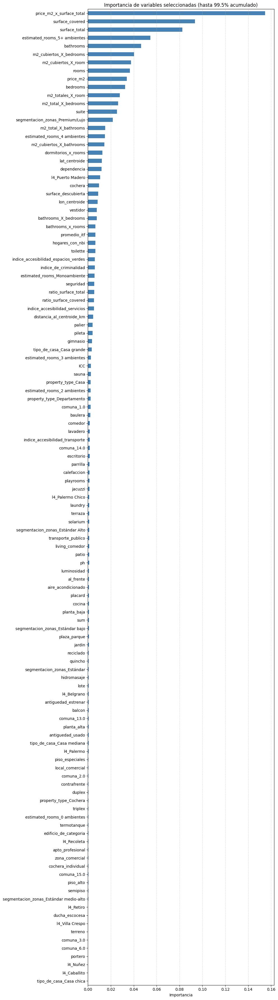

In [ ]:
n_estimators = 1000
max_depth = 25
max_features='sqrt'
min_samples_leaf=1
#min_samples_leaf=10
min_samples_split=2
#min_samples_split=20

reg = sk.ensemble.RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, max_features=max_features,min_samples_leaf=min_samples_leaf,
                                        min_samples_split=min_samples_split, n_jobs=-1, random_state=42)

reg.fit(X, y)

# 2. Calcular importancias y ordenarlas
importancias = pd.Series(reg.feature_importances_, index=X.columns).sort_values(ascending=False)
importancia_acumulada = importancias.cumsum()

# 3. Seleccionar features hasta alcanzar el umbral acumulado deseado
umbral = 0.995
top_features = importancia_acumulada[importancia_acumulada <= umbral].index

print(f"Se seleccionaron {len(top_features)} variables que explican el {umbral*100:.0f}% de la importancia.")

# 4. Crear datasets reducidos
X = X[top_features]
X_ap = X_ap[top_features]

# 5. Entrenar nuevo modelo con variables seleccionadas
reg_reducido = sk.ensemble.RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, max_features=max_features,min_samples_leaf=min_samples_leaf,
                                        min_samples_split=min_samples_split, n_jobs=-1, random_state=42)


reg_reducido.fit(X, y)

# 6. Predicción
y_pred = reg_reducido.predict(X_ap)

# 7. Gráfico de importancias
importancias_seleccionadas = pd.Series(reg_reducido.feature_importances_, index=top_features).sort_values()

plt.figure(figsize=(10, max(5, len(top_features) * 0.3)))


plt.figure(figsize=(10, max(5, len(top_features) * 0.3)))
importancias_seleccionadas.plot(kind='barh', color='steelblue')
plt.xlabel('Importancia')
plt.title('Importancia de variables seleccionadas (hasta 99.5% acumulado)')
plt.grid(True, axis='x', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

In [ ]:
n_estimators = 1000
max_depth = 15
reg = sk.ensemble.RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, max_features='sqrt',min_samples_leaf=10, min_samples_split=20, n_jobs=-1, random_state=42)

reg.fit(X, y)

# 6. Predicción
y_pred = reg.predict(X_ap)

In [ ]:
# Predecimos los precios del dataset a predecir
y_pred_ap = y_pred
#y_pred_ap = np.exp(y_pred)

# Lleno el precio de df_ap con las predicciones
df_ap["price"] = y_pred_ap

df_ap_analisis['price'] = y_pred_ap

In [ ]:
# Grabo el df_ap en un archivo csv para subir a Kaggle
df_ap["price"].to_csv(f"{DIR}/v{version}_solucion.csv", index=True, index_label="id")
df_ap["price"].to_csv(f"{DIR}/versiones/v{version}_solucion.csv", index=True, index_label="id")

# **8. Importancia de las columnas**

In [ ]:
# Desactivar notación científica globalmente
pd.options.display.float_format = '{:.4f}'.format

# Importancia de las columnas
pd.DataFrame({"importance": reg.feature_importances_}, index=X.columns).sort_values(by="importance", ascending=False)

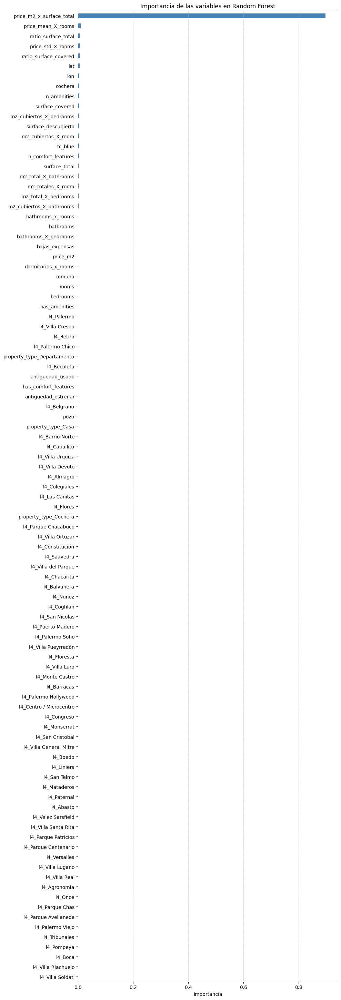

In [ ]:
# Importancia de las variables
importancias = pd.Series(reg.feature_importances_, index=X.columns).sort_values()

# Gráfico de barras horizontales
plt.figure(figsize=(10, max(5, len(X.columns) * 0.3)))
importancias.plot(kind='barh', color='steelblue')
plt.xlabel('Importancia')
plt.title('Importancia de las variables en Random Forest')
plt.grid(True, axis='x', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


# **9. Análisis de errores**

## **1 - Error price**

In [ ]:
X_train, X_test, y_train, y_test = sk.model_selection.train_test_split(X, y, test_size=0.2, random_state=42)

n_estimators = 1000
max_depth = 15

reg = sk.ensemble.RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, max_features='sqrt',min_samples_leaf=10, min_samples_split=20, n_jobs=-1, random_state=42)
reg.fit(X_train, y_train)

# Cálculo del error en entrenamiento (train)
y_pred = reg.predict(X_train)
score_train = sk.metrics.root_mean_squared_error(y_train, y_pred)

# Cálculo del error en prueba (test)
y_pred = reg.predict(X_test)

score_test  = sk.metrics.root_mean_squared_error(y_test,  y_pred)

print(f"{n_estimators=} -- {max_depth=} --> {score_train=:.2f} - {score_test=:.2f}")


n_estimators=1000 -- max_depth=15 --> score_train=50533.20 - score_test=88123.96


## **2- Error Ln price**

In [ ]:
X_train, X_test, y_train, y_test = sk.model_selection.train_test_split(X, y, test_size=0.2, random_state=42)

#n_estimators = 300
#max_depth = 20

n_estimators = 50
max_depth = 50
reg = sk.ensemble.RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_leaf=10, min_samples_split=20, n_jobs=-1, random_state=42)

#reg = sk.ensemble.RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, n_jobs=-1, random_state=42)
reg.fit(X_train, y_train)

# Cálculo del error en entrenamiento (train)
y_pred = reg.predict(X_train)
score_train = sk.metrics.root_mean_squared_error(np.exp(y_train), np.exp(y_pred))

# Cálculo del error en prueba (test)
y_pred = reg.predict(X_test)
score_test  = sk.metrics.root_mean_squared_error(np.exp(y_test), np.exp(y_pred))

print(f"{n_estimators=} -- {max_depth=} --> {score_train=:.2f} - {score_test=:.2f}")

# Volver a escala original (USD)
y_pred_real = np.exp(y_pred)
y_test_real = np.exp(y_test)

# Calcular métricas en USD
mae_real = sk.metrics.mean_absolute_error(y_test_real, y_pred_real)
# Cálculo manual del RMSE
rmse_real = np.sqrt(sk.metrics.mean_squared_error(np.exp(y_test), np.exp(y_pred)))
# Cálculo manual del R2
r2_real = sk.metrics.r2_score(y_test_real, y_pred_real)

print(f"MAE (USD): {mae_real:,.2f}")
print(f"RMSE (USD): {rmse_real:,.2f}")
print(f"R² (USD): {r2_real:.3f}")


## **3- Error Relativo**

In [ ]:
y_pred_real = y_pred
y_test_real = y_test
X_test['y_pred'] = y_pred_real
X_test['y_test'] = y_test_real
X_test['error_absoluto'] = abs(X_test['y_pred'] - X_test['y_test'])

# Acá estaba el problema: 'error' no existe. Usamos 'error_absoluto' correctamente.
X_test['error_relativo'] = X_test['error_absoluto'] / X_test['y_test']

# Asignamos al df_ent
df_ent.loc[X_test.index, ['y_pred', 'y_test', 'error_absoluto', 'error_relativo']] = X_test[['y_pred', 'y_test', 'error_absoluto', 'error_relativo']]


In [ ]:
# Aseguramos que no haya NaNs
error_relativo = X_test["error_relativo"].dropna()

# Paso 1: estadísticas estándar
stats_dict = {
    'Min': error_relativo.min(),
    'Max': error_relativo.max(),
    'Mediana': error_relativo.median(),
    'Media': error_relativo.mean(),
    'Desvío estándar': error_relativo.std()
}

# Paso 2: percentiles
percentiles = {
    'Percentil 5%': error_relativo.quantile(0.05),
    'Percentil 10%': error_relativo.quantile(0.10),
    'Percentil 20%': error_relativo.quantile(0.20),
    'Percentil 25%': error_relativo.quantile(0.25),
    'Percentil 50%': error_relativo.quantile(0.50),
    'Percentil 75%': error_relativo.quantile(0.75),
    'Percentil 90%': error_relativo.quantile(0.90),
    'Percentil 95%': error_relativo.quantile(0.95),
    'Percentil 99%': error_relativo.quantile(0.99),
    'Percentil 99.99%': error_relativo.quantile(0.9999)
}

# Unimos todo
stats_dict.update(percentiles)

# Convertimos a DataFrame y pasamos a porcentaje
stats_df = pd.DataFrame.from_dict(stats_dict, orient='index', columns=['Error relativo (%)'])
stats_df['Error relativo (%)'] = (stats_df['Error relativo (%)'] * 100).round(2)

# Mostrar tabla con formato elegante
display(stats_df.style.format("{:.2f}%"))



,Error relativo (%)
Min,0.00%
Max,100.35%
Mediana,7.72%
Media,10.75%
Desvío estándar,10.91%
Percentil 5%,0.53%
Percentil 10%,1.07%
Percentil 20%,2.28%
Percentil 25%,2.98%
Percentil 50%,7.72%


In [ ]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np

# Supongamos que ya tenés
# y_test: valores reales
# y_pred: predicciones del modelo


# MAE
mae = mean_absolute_error(y_test_real, y_pred_real)

# RMSE
rmse = np.sqrt(mean_squared_error(y_test_real, y_pred_real))

# R²
r2 = r2_score(y_test_real,y_pred_real)


# Evitar división por cero (filtramos valores muy pequeños o igual a 0)
mask = y_test_real > 0
mape = np.mean(np.abs((y_test_real[mask] - y_pred_real[mask]) / y_test_real[mask])) * 100

print(f"MAE: {mae:.2f}")
print(f"RMSE: {rmse:.2f}")
print(f"R²: {r2:.3f}")
print(f"MAPE: {mape:.2f}%")

MAE: 19739.35
RMSE: 33855.15
R²: 0.954
MAPE: 10.75%


<Axes: >

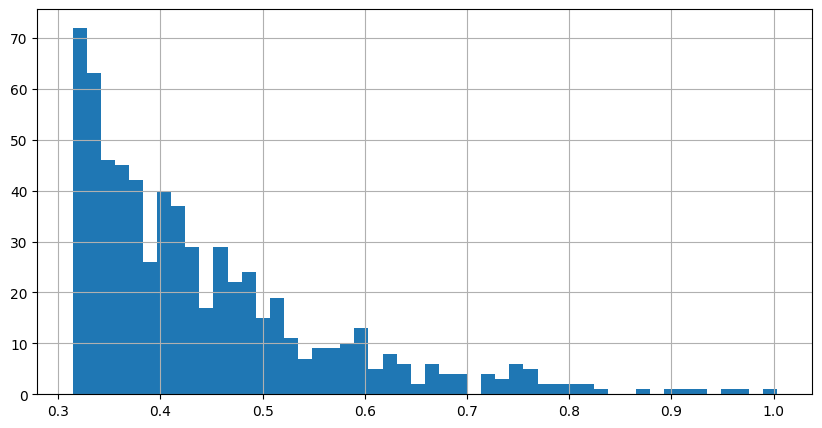

In [ ]:
X_test.loc[X_test['error_relativo'] > X_test['error_relativo'].quantile(0.95),'error_relativo'].hist(figsize=(10,5),bins=50)

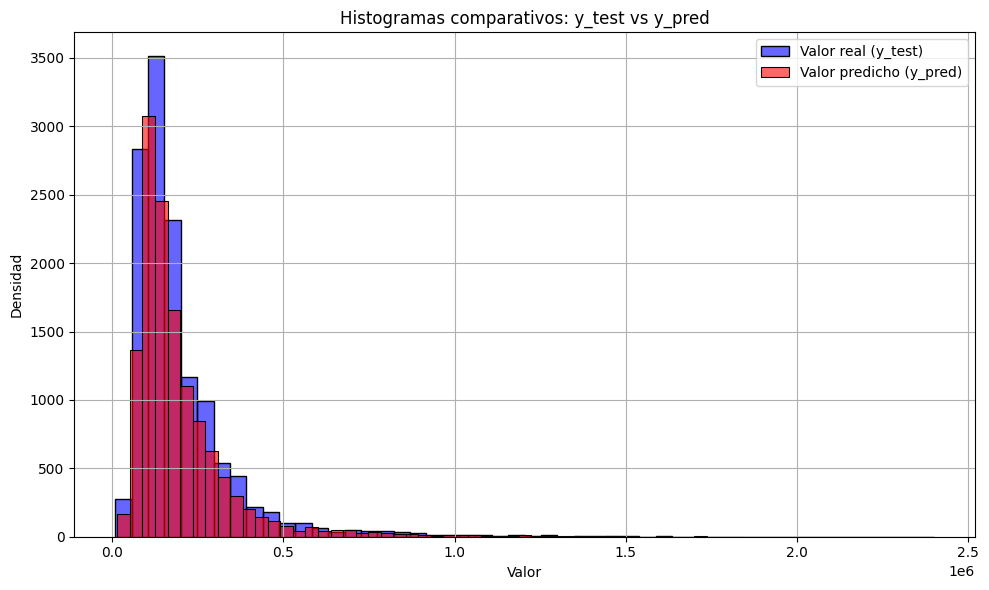

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

y_test = df_ent['y_test']

y_pred = df_ent['y_pred']


# Configurar figura
plt.figure(figsize=(10, 6))

# Histograma de y_test
sns.histplot(y_test, bins=50, color='blue', label='Valor real (y_test)',  alpha=0.6)

# Histograma de y_pred
sns.histplot(y_pred, bins=50, color='red', label='Valor predicho (y_pred)', alpha=0.6)

# Opcional: leyenda y títulos
plt.title('Histogramas comparativos: y_test vs y_pred')
plt.xlabel('Valor')
plt.ylabel('Densidad')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()



In [ ]:
# Filtrar el top 1% de mayor error relativo
df_top_error = df_ent.loc[df_ent['error_relativo'] >= df_ent['error_relativo'].quantile(0.99),['title','description','currency','l3','barrio','pm2','price_m2','surface_total','rooms','y_pred', 'y_test', 'error_relativo']].sort_values('error_relativo', ascending=False)

# Mostrar con formato
df_top_error.style.format({
    'pm2': '{:,.2f}',
    'surface_total': '{:,.2f}',
    'rooms': '{:,.0f}',
    'y_test': '{:,.2f}',
    'y_pred': '{:,.2f}',
    'y_test': '{:,.2f}',
    'error_relativo': '{:.2%}'
})


,title,description,currency,l3,barrio,pm2,price_m2,surface_total,rooms,y_pred,y_test,error_relativo
__original_index__,,,,,,,,,,,,
68147,GARAGE/COCHERA EN MICROCENTRO CON AUTOELEVADOR Y VALET PARKING,"Corredor Responsable: Daniel Acosta - CUCICBA 2406Contacto: Rosana Pereira - MLS ID # 420151124-24Excelente oportunidad!Cochera con auto elevador. Abierta los 7 días de la semana las 24 hs. Con Valet parking.Ubicada a una cuadra de Corrientes y tres de Avda. 9 de Julio.Expensas septiembre 2019 .-DANIEL ACOSTA CUCICBA 2406 / CSI 5953""En cumplimiento de la Ley 2340 CUCICBA, Ley 10.973 de la Prov.Bs.As., Ley Nacional 25.028, Ley 22.802 de Lealtad Comercial, Ley 24.240 de Defensa al Consumidor, las normas del Código Civil y Comercial de la Nación y Constitucionales, los agentes NO ejercen el corretaje inmobiliario. Todas las operaciones inmobiliarias son objeto de intermediacion y conclusión por parte de los martilleros y corredores colegiados, cuyos datos se exhiben debajo del nombre de la inmobiliaria. \n\n Comprá la casa que querés! No la que podés. Accedé a un préstamo por hasta el 30% del valor de esta propiedad. Simulá tu cuota en Lendar",USD,San Nicolás,San Nicolas,899.92,1500.205228,11.00,0,"19,787.25","9,900.00",99.87%
417966,Cochera CABA venta. Oportunidad Inversor,"Corredor Responsable: GRACIELA Y. MENAZZI - CPI 6344Contacto: Romina Canova - MLS ID # 420141126-16Se trata de una cochera en primer piso de 12,50 metros cuadrados ,unidad funcional 134 .ubicada en Talcahuano y Rivadavia CABA..Es un edificio de solo 6 pisos de los cuales 3 pisos son de cocheras y 3 pisos oficinas.la misma abona expensas de Aysa ABL *SI TIENES QUE VENDER PARA COMPRAR, PODEMOS AYUDARTE Y REALIZAR LA OPERACIÓN SIMULTÁNEA*BENEFICIO PARA CLIENTESSi te falta hasta un 30% del valor de esta propiedad, te ofrecemos solicitar un préstamo a través de Lendar, servicio exclusivo para clientes RE/MAX. Hace la simulación de tu cuota a través del simulador https:// Las medidas, superficies y expensas consignadas en la presente son aproximadas; y al solo efecto orientativo. Los datos definitivos son los que surgirán del título de la propiedad y de los comprobantes respaldatorios.""Venta supeditada al cumplimiento por parte del propietario de los requisitos de la resolución general Nº 2371 de la AFIP (pedido de COTI). \n\n Comprá la casa que querés! No la que podés. Accedé a un préstamo por hasta el 30% del valor de esta propiedad. Simulá tu cuota en Lendar",USD,San Nicolas,San Nicolas,749.94,1552.002658,12.00,0,"17,865.73","9,000.00",98.51%
356571,Venta Pre-pozo Deptos 1 y 2 amb,Departamentos a estrenar. No pierda esta oportunidad. Detalles de categoria,USD,Mataderos,Mataderos,999.98,1946.818953,40.00,1,"79,102.55","40,000.00",97.76%
405510,Rivadavia 9800 - - Tipo casa PH en Venta,"Excelente oportunidad de inversión. PROPIEDAD A REFACCIONAR Casa de 6 ambientes, 1 baño y 1 toilette , terraza con escalera interna, lavadero, balcón. Excelente ubicación sobre Av Rivadavia a dos cuadras de estación de tren Villa Luro. Sin expensas. Primero piso por escalera. Momentáneamente sin gas natural por falta de pago. LE BRIQUE Información adicional:Permite mascotasLuminosidad: Muy luminoso",USD,Villa Luro,Villa Luro,848.21,1669.692635,112.00,4,"187,738.36","95,000.00",97.62%
3314,ANTICIPO SALDO CUOTAS DEPARTAMENTO MIRALLA 1064 MATADEROS CABA VP TB,"MONOAMBIENTE DIVIDIDO CON BALCON 33M2 CONTRAFRENTE LUNINOSOFINANCIADO, ANTICIPO 38., SALDO A CANCELAR DESDE 25 MESES EN DOLARES FIJOS O PESOS VARIABLES, TOTAL 88.CONTADO, CONSULTARPERMUTA, CONSULTARLEASING, CONSULTARALQUILER, CONSULTAR191015 1 60 181222 1 35ANTICIPO SALDO CUOTAS DEPARTAMENTO MIRALLA 1064 MATADEROS CABA VP TB",USD,Mataderos,Mataderos,"1,151.48",1946.818953,33.00,1,"74,822.02","38,000.00",96.90%
451325,Riestra 1700 - - Tipo casa PH en Venta,"PH o Tipo Casa 3 amb. c/ Tza.Av. Riestra al 1700Esquina MonPH o Departamento Tipo Casa en Primer Piso por escalera.Excelente PH de 3 ambientes de 75 m2 cubiertos aprox. Living-C

# **10-Regresion Mútiple**

## **1- ML - PCA**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm

df_entF = df_ent.select_dtypes('number').copy()

X = df_entF[df_entF.columns.drop('price')].copy()

scaler = StandardScaler()

X_scaled = scaler.fit_transform(X)

y = np.log(df_ent['price'])

# 3. PCA
pca = PCA()
X_pca = pca.fit_transform(X_scaled)

# 4. Determinar número mínimo de componentes que explican el 95% de la varianza
n_components = np.argmax(np.cumsum(pca.explained_variance_ratio_) >= 0.95) + 1
component_labels = [f'PC{i+1}' for i in range(n_components)]

# 5. Crear DataFrame con nombres e índice alineado
X_pca_df = pd.DataFrame(X_pca[:, :n_components], columns=component_labels, index=X.index)
X_pca_df = sm.add_constant(X_pca_df)

# 6. Ajustar el modelo
modelo = sm.OLS(y, X_pca_df).fit()

# 7. Calcular importancia relativa
X_no_const = X_pca_df.drop(columns='const')
impacto = (X_no_const.std() * modelo.params[X_no_const.columns]).abs()
importancia = impacto.sort_values(ascending=False).to_frame(name='impacto')
importancia['relativo (%)'] = 100 * importancia['impacto'] / importancia['impacto'].sum()

# 8. Resultado
print("\n📄 Resumen del modelo con componentes principales:")
print(modelo.summary())
print(f"\n📄 R² ajustado: {modelo.rsquared_adj:.4f}")
print("\n📊 Importancia relativa de los componentes principales:")
print(importancia)


In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Varianza acumulada
var_acumulada = np.cumsum(pca.explained_variance_ratio_)

# Gráfico de la curva acumulada
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(var_acumulada) + 1), var_acumulada, marker='o', linestyle='-')
plt.axhline(0.95, color='red', linestyle='--', label='95% de varianza acumulada')

# Punto donde se alcanza el 95%
n_95 = np.argmax(var_acumulada >= 0.95) + 1
plt.axvline(n_95, color='gray', linestyle='--')
plt.text(n_95 + 0.5, 0.90, f'{n_95} componentes', color='gray')

# Estética
plt.title('Varianza acumulada explicada por PCA')
plt.xlabel('Número de componentes principales')
plt.ylabel('Varianza acumulada')
plt.ylim(0, 1.05)
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()



In [ ]:
for i, v in enumerate(var_acumulada):
    print(f"PC1 a PC{i+1}: {v:.2%} varianza acumulada")


## **2- ML**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor


X = df_ent[selected_features].copy()


X = sm.add_constant(X)

#y = np.log(df_ent['price'])

y = df_ent['price']

modelo = sm.OLS(y, X).fit()

print("\n📄 Resumen del modelo:")
print(modelo.summary())

print(f"\n📄 R² ajustado: {modelo.rsquared_adj:.4f}")




📄 Resumen del modelo:
                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.928
Model:                            OLS   Adj. R-squared:                  0.928
Method:                 Least Squares   F-statistic:                 1.849e+04
Date:                Sat, 17 May 2025   Prob (F-statistic):               0.00
Time:                        21:42:22   Log-Likelihood:            -8.1085e+05
No. Observations:               66103   AIC:                         1.622e+06
Df Residuals:                   66056   BIC:                         1.622e+06
Df Model:                          46                                         
Covariance Type:            nonrobust                                         
                                              coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------

In [ ]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif = pd.DataFrame()
vif["variable"] = X.columns
vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
print(vif.sort_values("VIF", ascending=False))


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm

# 1. Obtener valores ajustados (predichos) y residuos
fitted_vals = modelo.fittedvalues     # log(price) estimado
residuals = modelo.resid              # residuos en escala logarítmica

# 2. Gráfico de residuos
plt.figure(figsize=(10, 6))
sns.residplot(x=fitted_vals, y=residuals, lowess=True,
              line_kws={'color': 'red', 'lw': 2},
              scatter_kws={'alpha': 0.5})

plt.axhline(0, color='gray', linestyle='--', linewidth=1)
plt.xlabel("Valores predichos (log(price))")
plt.ylabel("Residuos (log(price) - predicho)")
plt.title("Gráfico de residuos vs. valores predichos")
plt.tight_layout()
plt.show()



# Histograma de residuos
plt.figure(figsize=(8, 4))
sns.histplot(residuals, kde=True, bins=50)
plt.title("Distribución de los residuos (log)")
plt.xlabel("Residuos")
plt.ylabel("Frecuencia")
plt.tight_layout()
plt.show()

# QQ plot
sm.qqplot(residuals, line='45', fit=True)
plt.title("QQ plot de residuos")
plt.tight_layout()
plt.show()


# **11-Normalidad**

In [ ]:
df_ent['ln_price'] = np.log(df_ent['price'])

from scipy.stats import zscore

df_ent['z_ln_price'] = zscore(df_ent['ln_price'], nan_policy='omit')


In [ ]:
stats = df_ent['ln_price'].agg([
    'min',
    'max',
    'median',
    'mean',
    'std',
    lambda x: x.quantile(0.05),
    lambda x: x.quantile(0.10),
    lambda x: x.quantile(0.20),
    lambda x: x.quantile(0.25),
    lambda x: x.quantile(0.50),
    lambda x: x.quantile(0.75),
    lambda x: x.quantile(0.90),
    lambda x: x.quantile(0.95),
    lambda x: x.quantile(0.99),
    lambda x: x.quantile(0.9999)
])

# Renombrar los índices
stats.index = [
    'min', 'max', 'median', 'mean', 'std','q_0.05', 'q_0.10',
    'q_0.20', 'q_0.25', 'q_0.50', 'q_0.75',
    'q_0.90', 'q_0.95', 'q_0.99', 'q_0.9999'
]

# Resultado: estadísticas como filas, columnas como columnas (ya están una al lado de la otra)
stats

In [ ]:
import numpy as np
import pandas as pd
from scipy.stats import skew, kurtosis, mode
import matplotlib.pyplot as plt

# Crear una muestra log-normal (asimetría positiva)
np.random.seed(42)
data = df_ent['ln_price']

# Calcular medidas estadísticas
media = np.mean(data)
moda = mode(data, keepdims=True).mode[0]
mediana = np.median(data)
asimetria = skew(data)
curtosis_valor = kurtosis(data, fisher=False)      # Curtosis normal
curtosis_exceso = kurtosis(data)                   # Curtosis por exceso

# Mostrar histograma con media y moda
plt.hist(data, bins=30, edgecolor='black', alpha=0.7)
plt.axvline(media, color='blue', linestyle='--', label=f'Media = {media:.2f}')
plt.axvline(moda, color='green', linestyle='-', label=f'Moda = {moda:.2f}')
plt.axvline(mediana, color='red', linestyle='-', label=f'Mediana = {mediana:.2f}')
plt.title("Distribución de datos (log-normal)")
plt.legend()
plt.xlabel("Valor")
plt.ylabel("Frecuencia")
plt.show()

# Imprimir resultados
print(f"Media: {media:.2f}")
print(f"Moda: {moda:.2f}")
print(f"Mediana: {mediana:.2f}")
print(f"Asimetría (Skewness): {asimetria:.2f}")
print(f"Curtosis (normal): {curtosis_valor:.2f}")
print(f"Curtosis de exceso: {curtosis_exceso:.2f}")


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats as stats


data = df_ent['ln_price']

# QQ plot
stats.probplot(data, dist="norm", plot=plt)
plt.title("QQ Plot - Comparación con distribución normal")
plt.grid(True)
plt.show()


In [ ]:
# Histograma + curva normal teórica
# ==============================================================================

# Valores de la media (mu) y desviación típica (sigma) de los datos
mu, sigma = stats.norm.fit(data)

# Valores teóricos de la normal en el rango observado
x_hat = np.linspace(min(data), max(data), num=100)
y_hat = stats.norm.pdf(x_hat, mu, sigma)

# Gráfico
fig, ax = plt.subplots(figsize=(7,4))
ax.plot(x_hat, y_hat, linewidth=2, label='normal')
ax.hist(x=data, density=True, bins=30, color="#3182bd", alpha=0.5)
ax.plot(data, np.full_like(data, -0.01), '|k', markeredgewidth=1)
ax.set_title('Distribución ln de precios')
ax.set_xlabel('ln_price')
ax.set_ylabel('Densidad de probabilidad')
ax.legend();



In [ ]:
from scipy.stats import shapiro


# Test de Shapiro-Wilk
stat, p_value = shapiro(data)

print(f"Estadístico de Shapiro-Wilk: {stat:.4f}")
print(f"P-valor: {p_value:.4f}")

if p_value < 0.05:
    print("Rechazamos H0: la muestra **no sigue** una distribución normal.")
else:
    print("No se rechaza H0: la muestra **podría seguir** una distribución normal.")


# **Kmeans - Clustering**

In [ ]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

inertias = []
k_values = range(1, 200)

for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_clustering)  # X_cluster es el dataset preprocesado
    inertias.append(kmeans.inertia_)

plt.figure(figsize=(8, 5))
plt.plot(k_values, inertias, marker='o')
plt.xlabel('Número de clusters (k)')
plt.ylabel('Inercia (SSE)')
plt.title('Método del Codo')
plt.grid(True)
plt.show()

# **Datos Faltantes**

## 1-Limpieza inicial

In [ ]:
#Version---------------------------------------------------------------------

version = 35

# Librerias -----------------------------------------------------------------
from scipy.stats import zscore
import pandas as pd
import sklearn as sk
from sklearn import model_selection
from sklearn import ensemble
from sklearn import metrics
import csv
import re
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm
from sklearn.cluster import KMeans
from sklearn.ensemble import IsolationForest
from sklearn.model_selection import train_test_split
from numpy.linalg import pinv
from sklearn.neighbors import LocalOutlierFactor
# DIR ------------------------------------------------------------------------

DIR = "/content/drive/MyDrive/Maestría en Ciencia de Datos - UBA/FCEN DM/datos/properati"

#DIR = "/home/economatica/MCD-DM/properati"

# entrenamiento.zip------------------------------------------------------------

df_ent = pd.read_csv(f"{DIR}/entrenamiento.zip", index_col="id")

# a_predecir.csv---------------------------------------------------------------

df_ap = pd.read_csv(f"{DIR}/a_predecir.csv", index_col="id")

# Tipo de cambio ---------------------------------------------------------------

tipo_de_cambio = pd.read_excel(f"{DIR}/tc_informal.xlsx")

tipo_de_cambio = tipo_de_cambio.drop(index = range(0,3))

tipo_de_cambio.columns = ['Fecha','tc_blue']

tipo_de_cambio['Fecha'] = pd.to_datetime(tipo_de_cambio['Fecha'])

tipo_de_cambio = tipo_de_cambio.loc[tipo_de_cambio['tc_blue']!='-']

tipo_de_cambio['tc_blue'] = pd.to_numeric(tipo_de_cambio['tc_blue'])

tipo_de_cambio = tipo_de_cambio.reset_index(drop=True)


# 1. Crear un rango de fechas completo
rango_fechas = pd.date_range(
    start=tipo_de_cambio['Fecha'].min(),
    end=tipo_de_cambio['Fecha'].max(),
    freq='D'  # frecuencia diaria (incluye sábados y domingos)
)

# 2. Reindexar tipo_de_cambio para tener todas las fechas
tipo_de_cambio = tipo_de_cambio.set_index('Fecha').reindex(rango_fechas)

# 3. Hacer forward fill para llenar fines de semana y feriados
tipo_de_cambio['tc_blue'] = tipo_de_cambio['tc_blue'].ffill()

# 4. Resetear el índice para volver a tener 'Fecha' como columna
tipo_de_cambio = tipo_de_cambio.reset_index().rename(columns={'index': 'Fecha'})


# Guardás el índice original como columna temporal-----------------------------

df_ent['__original_index__'] = df_ent.index


# Primer filtro ---------------------------------------------------------------

df_ent = df_ent.loc[(df_ent.l1 == "Argentina")  & (df_ent.operation_type == "Venta") & (df_ent.price.notna() & (df_ent.price != 0)) & (df_ent.l2 == 'Capital Federal')]


# Latitud y longitud-----------------------------------------------------------

# Intercambiar columnas

df_ent['lat'], df_ent['lon'] = df_ent['lon'], df_ent['lat'].copy()

# Latitud y longitud: ratamiento de NAs-----------------------------------------------------------------

"""
promedios_lat = df_ent.groupby('l3')['lat'].mean()

promedios_lon = df_ent.groupby('l3')['lon'].mean()

df_ent['lat'] = df_ent['lat'].fillna(df_ent['l3'].map(promedios_lat))

df_ent['lon'] = df_ent['lon'].fillna(df_ent['l3'].map(promedios_lon))
"""


# Definir los rangos de CABA

lat_min, lat_max = -34.70, -34.50
lon_min, lon_max = -58.53, -58.35


df_ent = df_ent[
    (df_ent['lat'] >= lat_min) & (df_ent['lat'] <= lat_max) &
    (df_ent['lon'] >= lon_min) & (df_ent['lon'] <= lon_max)
]

#Filtro: Duplicados----------------------------------------------------------------

df_ent['start_date'] = pd.to_datetime(df_ent['start_date'], errors='coerce')

df_ent = df_ent.sort_values(by='start_date', ascending=False)

df_ent = df_ent.drop_duplicates(subset=['price', 'title','description'], keep='first')




# Centroides

centroides = df_ent.groupby('l3')[['lat', 'lon']].mean().reset_index()

centroides.columns = ['l3','lat_centroide','lon_centroide']

df_ent = pd.merge(df_ent,centroides,on='l3',how='left').set_index(df_ent.index)

#distancia_al_centroide_km

def haversine(lat1, lon1, lat2, lon2):
    R = 6371  # radio de la Tierra en km
    lat1, lon1, lat2, lon2 = map(np.radians, [lat1, lon1, lat2, lon2])

    dlat = lat2 - lat1
    dlon = lon2 - lon1

    a = np.sin(dlat / 2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon / 2)**2
    c = 2 * np.arcsin(np.sqrt(a))

    return R * c

df_ent['distancia_al_centroide_km'] = haversine(
    df_ent['lat'], df_ent['lon'],
    df_ent['lat_centroide'], df_ent['lon_centroide']
)

#Tiempo de venta----------------------------------------------------------------

#df_ent['end_date'] = pd.to_datetime(df_ent['end_date'], errors='coerce')

#df_ent['tiempo_de_venta'] = df_ent['end_date']-df_ent['start_date']



# Barrios---------------------------------------------------------------------------


#Surdividir el barrio de 'Palermo' en 'l3' en base a 'l4'

def ajuste_de_l3(fila):

  if (fila['l3']=='Palermo') and pd.notna(fila['l4']):
    return fila['l4']
  else:
    return fila['l3']

df_ent['l3'] = df_ent.apply(ajuste_de_l3, axis=1)


df_ent.drop(columns = ['l6','l5','l4','operation_type','created_on','ad_type','price_period',"end_date"],inplace = True)

# Tipo de propiedad ----------------------------------------------------------------

nnn = ['PH', 'P.H.','p.h']

for b in nnn:
    pattern = re.escape(b.lower())
    #df_ent.loc[df_ent['description'].str.lower().str.contains(pattern, case=False, regex=True, na=False),'property_type'] = 'PH'
    df_ent.loc[df_ent['title'].str.lower().str.contains(pattern, case=False, regex=True, na=False),'property_type'] = 'PH'


nnn = {'Local comercial': r'Local comercial',
       'Oficina': r'Oficina',
       'Depósito': r'dep[oó]sito',
       'Departamento': r'departamento|depto',
       'Casa de campo': r'casa de campo',
       'Lote': r'venta lote'
       }

for b, pattern in nnn.items():
    df_ent.loc[df_ent['title'].str.lower().str.contains(pattern, case=False, regex=True, na=False),'property_type'] = b

# Segundo filtro--------------------------------------------------------------------------

f2 = (df_ent.property_type == "Casa") | ((df_ent.property_type == "Cochera")) | (df_ent.property_type == "Departamento") | (df_ent.property_type == "PH")

df_ent = df_ent.loc[f2]


# Cocheras -----------------------------------------------------------------------

df_ent.loc[df_ent['property_type']=='Cochera',['rooms','bedrooms','bathrooms']] = 0

mask_cochera = ((df_ent['property_type']=='Cochera') & (df_ent['surface_covered'].isna()) & (df_ent['surface_total'].notna()))

df_ent.loc[mask_cochera,'surface_covered'] = df_ent.loc[mask_cochera,'surface_total']

mask_cochera2 = ((df_ent['property_type']=='Cochera') & (df_ent['surface_covered'].notna()) & (df_ent['surface_total'].isna()))

df_ent.loc[mask_cochera2,'surface_total'] = df_ent.loc[mask_cochera2,'surface_covered']




## 2-Resumen

In [ ]:
# Función para contar % nulos y no nulos por columna
def resumen_nulos(df):
    resumen = pd.DataFrame()
    for col in df.columns:
        total = len(df[col])
        nulos = df[col].isna().sum()
        no_nulos = total - nulos
        resumen[col] = {
            'nulo': (nulos / total) * 100,
            'no nulo': (no_nulos / total) * 100
        }
    return resumen.T

resumen = resumen_nulos(df_ent)


## 3- Analisis gráfico

In [ ]:
fig, ax = plt.subplots(figsize=(8, 10))  # alto mayor que ancho
resumen.plot(kind='barh', stacked=True, color=['salmon', 'skyblue'], ax=ax)

ax.set_title('Porcentaje de Nulos y No Nulos por columna')
ax.set_xlabel('%')  # Cambia el eje X porque ahora es horizontal
ax.set_xlim(0, 100)
ax.legend(loc='lower right')
ax.grid(axis='x', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


In [ ]:
# Ordenar de mayor a menor
nulos_ordenados = resumen.loc[resumen['nulo']>0,'nulo'].sort_values(ascending=True)

# Crear figura
fig, ax = plt.subplots(figsize=(10, 8))  # más alto para que quepan todas las etiquetas

# Graficar barras horizontales
nulos_ordenados.plot(kind='barh', color='salmon', ax=ax)

# Título y etiquetas
ax.set_title('Porcentaje de Nulos por Columna', fontsize=14)
ax.set_xlabel('% de valores nulos', fontsize=12)
ax.set_xlim(0, 100)

# Agregar etiquetas de porcentaje al final de cada barra
for i, val in enumerate(nulos_ordenados):
    ax.text(val + 1, i, f'{val:.1f}%', va='center', fontsize=10)

# Estilo
ax.grid(axis='x', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

## 4- Textmining

In [ ]:
n_map = {'un':1,'uno':1,'dos':2,'tres':3,'cuatro':4,'cinco':5,'seis':6}

# Baños---------------------------------------------------------------------------------


for b in [1,2,3,4,5]:
    df_ent.loc[(df_ent.bathrooms.isna() & df_ent["description"].str.lower().str.contains(fr'\b{b} baños?\b',regex = True)), "bathrooms"] = b

for b,c in n_map.items():
    df_ent.loc[(df_ent.bathrooms.isna() & df_ent["description"].str.lower().str.contains(fr'\b{b} baños?\b',regex = True)), "bathrooms"] = c

# Habitaciones---------------------------------------------------------------------------


for b in [1,2,3,4,5]:
    df_ent.loc[(df_ent.bedrooms.isna() & df_ent["description"].str.lower().str.contains(fr'\b{b} (?:dormitorios?|habitaci[oó]n(?:es)?)\b',regex = True)), "bedrooms"] = b


for b,c in n_map.items():
    df_ent.loc[(df_ent.bedrooms.isna() & df_ent["description"].str.lower().str.contains(fr'\b{b} (?:dormitorios?|habitaci[oó]n(?:es)?)\b',regex = True)), "bedrooms"] = c

# Ambientes -----------------------------------------------------------------------------

#1)NAS

# Primero: buscar ambientes numéricos en title y description
for b in [1, 2, 3, 4, 5, 6,7,8]:
    # Buscar en el title
    mask_title = (df_ent['rooms'].isna() & df_ent['title'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_title, 'rooms'] = b

    # Buscar en la description
    mask_description = (df_ent['rooms'].isna() & df_ent['description'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_description, 'rooms'] = b

# Segundo: buscar ambientes mapeados en title y description
for b, c in n_map.items():
    # Buscar en el title
    mask_title = (df_ent['rooms'].isna() & df_ent['title'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_title, 'rooms'] = c

    # Buscar en la description
    mask_description = (df_ent['rooms'].isna() & df_ent['description'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_description, 'rooms'] = c

# Tercero: buscar monoambiente en title y description
pattern_monoambiente = r'mono\s*amb(?:i?ante?)?'

# Buscar en title
mask_mono_title = (df_ent['rooms'].isna() & df_ent['title'].str.lower().str.contains(pattern_monoambiente, regex=True, na=False))
df_ent.loc[mask_mono_title, 'rooms'] = 1

# Buscar en description
mask_mono_description = (df_ent['rooms'].isna() & df_ent['description'].str.lower().str.contains(pattern_monoambiente, regex=True, na=False))
df_ent.loc[mask_mono_description, 'rooms'] = 1


# Cuarto: buscar loft o studio en title y description
pattern_loft_studio = r'\b(?:loft)\b'

# Buscar en title
mask_loft_title = (df_ent['rooms'].isna() & df_ent['title'].str.lower().str.contains(pattern_loft_studio, regex=True, na=False))
df_ent.loc[mask_loft_title, 'rooms'] = 1

# Buscar en description
mask_loft_description = (df_ent['rooms'].isna() & df_ent['description'].str.lower().str.contains(pattern_loft_studio, regex=True, na=False))
df_ent.loc[mask_loft_description, 'rooms'] = 1


#2) Correcion de errores

# Primero: detectar ambientes numéricos en title y description
for b in [1, 2, 3, 4, 5, 6]:
    # Buscar en title
    mask_title = (df_ent['title'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_title & (df_ent['rooms'] != b), 'rooms'] = b

    # Buscar en description
    mask_description = (df_ent['description'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_description & (df_ent['rooms'] != b), 'rooms'] = b

# Segundo: detectar ambientes mapeados en title y description
for b, c in n_map.items():
    # Buscar en title
    mask_title = (df_ent['title'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_title & (df_ent['rooms'] != c), 'rooms'] = c

    # Buscar en description
    mask_description = (df_ent['description'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_description & (df_ent['rooms'] != c), 'rooms'] = c

# Tercero: detectar monoambiente en title y description
pattern_monoambiente = r'mono\s*amb(?:i?ante?)?'

# Buscar en title
mask_mono_title = df_ent['title'].str.lower().str.contains(pattern_monoambiente, regex=True, na=False)
df_ent.loc[mask_mono_title & (df_ent['rooms'] != 1), 'rooms'] = 1

# Buscar en description
mask_mono_description = df_ent['description'].str.lower().str.contains(pattern_monoambiente, regex=True, na=False)
df_ent.loc[mask_mono_description & (df_ent['rooms'] != 1), 'rooms'] = 1

# Cuarto: detectar loft o studio en title y description
pattern_loft_studio = r'\b(?:loft)\b'

# Buscar en title
mask_loft_title = df_ent['title'].str.lower().str.contains(pattern_loft_studio, regex=True, na=False)
df_ent.loc[mask_loft_title & (df_ent['rooms'] != 1), 'rooms'] = 1

# Buscar en description
mask_loft_description = df_ent['description'].str.lower().str.contains(pattern_loft_studio, regex=True, na=False)
df_ent.loc[mask_loft_description & (df_ent['rooms'] != 1), 'rooms'] = 1

## 5- Rooms

In [ ]:
def rooms_nas(fila):
  if pd.isna(fila['rooms']) and pd.notna(fila['bedrooms']) and fila['property_type']=='Departamento':
    return fila['bedrooms']+1
  elif pd.notna(fila['rooms']):
    return fila['rooms']
df_ent['rooms'] = df_ent.apply(rooms_nas,axis = 1)

medias_de_barrios_por_ambiente = df_ent.loc[df_ent['currency']=='USD'].groupby(['l3','property_type','rooms'])['price'].median().reset_index().rename(columns={'price':'rooms_mediana_del_barrio'})

def imputar_rooms_por_precio_rowwise(fila, tabla_referencia):

    if pd.notna(fila['rooms']):
        return fila['rooms']

    if pd.isna(fila['price']) or pd.isna(fila['l3']) or pd.isna(fila['property_type']):
        return np.nan  # no hay suficiente información

    # Filtrar tabla de referencia para el barrio y tipo
    candidatos = tabla_referencia[
        (tabla_referencia['l3'] == fila['l3']) &
        (tabla_referencia['property_type'] == fila['property_type'])
    ]

    if candidatos.empty:
        return np.nan  # no hay datos de referencia

    # Buscar el rooms cuya mediana esté más cerca del precio real
    candidatos = candidatos.copy()
    candidatos['abs_diff'] = (candidatos['rooms_mediana_del_barrio'] - fila['price']).abs()
    mejor_match = candidatos.sort_values('abs_diff').iloc[0]

    return mejor_match['rooms']

df_ent['rooms'] = df_ent.apply(lambda fila: imputar_rooms_por_precio_rowwise(fila, medias_de_barrios_por_ambiente), axis=1)


## 6- Dormitorios y baños

In [ ]:
def dormitorios_nas(fila):

  if pd.isna(fila['bedrooms']):

    if fila['rooms'] == 1:
      return 1
    elif fila['rooms']<=4:
      return fila['rooms'] -1

  elif pd.notna(fila['bedrooms']):
    return fila['bedrooms']

df_ent['bedrooms'] = df_ent.apply(dormitorios_nas,axis=1)

# bedrooms--------------------------------------------------------------------

#Creacion de la columna bedrooms_mediana

medianas_de_bedrooms = df_ent.groupby(['rooms'])['bedrooms'].median()

medianas_de_bedrooms = medianas_de_bedrooms.reset_index()

medianas_de_bedrooms = medianas_de_bedrooms.rename(columns={'bedrooms':'bedrooms_mediana'})

df_ent = pd.merge(df_ent,medianas_de_bedrooms, on = ['rooms'],how="left").set_index(df_ent.index)

#Reemplazos de NAs por la mediana de bedrooms

df_ent['bedrooms'] = df_ent['bedrooms'].fillna(df_ent['bedrooms_mediana'])

# bathrooms-----------------------------------------------------------------------

#Creacion de la columna bathrooms_mediana
medianas_de_bathrooms = df_ent.groupby(['rooms'])['bathrooms'].median()
medianas_de_bathrooms = medianas_de_bathrooms.reset_index()
medianas_de_bathrooms = medianas_de_bathrooms.rename(columns={'bathrooms':'bathrooms_mediana'})
df_ent = pd.merge(df_ent,medianas_de_bathrooms, on = ['rooms'],how="left").set_index(df_ent.index)

#Reemplazos de NAs por la mediana de bedrooms

df_ent['bathrooms'] = df_ent['bathrooms'].fillna(df_ent['bathrooms_mediana'])


df_ent['bathrooms'] = df_ent['bathrooms'].fillna(1)

df_ent.drop(columns=['bedrooms_mediana','bathrooms_mediana'],inplace=True)

## 7 - Sup total y cub.

In [ ]:
#superficie cubierta----------------------------------------------------------------------

#sup_cub_median_x_barrios_x_ambiente

sup_cub_median_x_barrios_x_ambiente = df_ent.groupby(['l3','property_type','rooms'])['surface_covered'].median().reset_index().rename(columns={'surface_covered':'sup_cub_median_x_barrios_x_ambiente'})

df_ent= pd.merge(df_ent,sup_cub_median_x_barrios_x_ambiente, on = ['l3','property_type','rooms'],how="left").set_index(df_ent.index)


#Reemplazos NAs

df_ent['surface_covered'] = df_ent['surface_covered'].fillna(df_ent['sup_cub_median_x_barrios_x_ambiente'])


# surface_total---------------------------------------------------------------------------


#Diferencias negativas

df_ent['superficie_diferencia'] = df_ent['surface_total']-df_ent['surface_covered']


surface_covered_ent = df_ent.loc[df_ent['superficie_diferencia'] < 0, 'surface_covered']

surface_total_ent = df_ent.loc[df_ent['superficie_diferencia'] < 0, 'surface_total']

df_ent.loc[df_ent['superficie_diferencia'] < 0, 'surface_total'] = surface_covered_ent

df_ent.loc[df_ent['superficie_diferencia'] < 0, 'surface_covered'] = surface_total_ent

#Textming


def limpieza_superficie_total(fila):

    surface_total = fila['surface_total']

    descripcion = fila['description']

    patron = r"(\d{1,3}(?:[.,]?\d{3})*(?:[.,]\d{1,2})?)\s*(?:m\s*2|m2|m²|mts2|mts/2|mtros2|metros\s*2|metros2|mtr2)"

    if pd.notna(descripcion):

        if pd.isna(surface_total):

            coincidencias = re.findall(patron, descripcion, flags=re.IGNORECASE)

            if coincidencias:

                valor = coincidencias[0].replace('.', '').replace(',', '.')

                return float(valor)

            return surface_total
        else:
           return surface_total
    else:
       return surface_total

df_ent['surface_total'] = df_ent.apply(limpieza_superficie_total,axis = 1)


#sup_median_x_barrios_x_ambiente--------------------------------------------------------

sup_median_x_barrios_x_ambiente = df_ent.groupby(['l3','property_type','rooms'])['surface_total'].median().reset_index().rename(columns={'surface_total':'sup_median_x_barrios_x_ambiente'})

df_ent= pd.merge(df_ent,sup_median_x_barrios_x_ambiente, on = ['l3','property_type','rooms'],how="left").set_index(df_ent.index)


#sup_mad_x_barrios_x_ambiente-----------------------------------------------------------


def mad(series):
    med = series.median()
    mad = (series - med).abs().median()
    return mad


sup_mad_x_barrios_x_ambiente = df_ent.groupby(['l3', 'property_type', 'rooms'])['surface_total'].apply(mad).reset_index().rename(columns={'surface_total': 'sup_mad_x_barrios_x_ambiente'})

df_ent = pd.merge(df_ent,sup_mad_x_barrios_x_ambiente,on=['l3', 'property_type', 'rooms'],how='left').set_index(df_ent.index)

#k_mad_95-----------------------------------------------------------------------------------

k_mad_95 = 1

#umbral_sup_total----------------------------------------------------------------------------

df_ent['umbral_sup_total'] = df_ent['sup_median_x_barrios_x_ambiente'] + k_mad_95 * df_ent['sup_mad_x_barrios_x_ambiente']

df_ent["relacion_sup_vs_mediana"] = df_ent['surface_total']/ df_ent['umbral_sup_total']

#Reemplazos NAs------------------------------------------------------------------------------


# Filtrar filas con surface_total nula
mask_total_na = df_ent['surface_total'].isna()
has_umbral = df_ent['umbral_sup_total'].notna()
has_covered = df_ent['surface_covered'].notna()

# Caso 1: ambas columnas existen
cond_both = mask_total_na & has_umbral & has_covered

cond1 = cond_both & (df_ent['umbral_sup_total'] >= df_ent['surface_covered'])  # usar umbral
cond2 = cond_both & (df_ent['umbral_sup_total'] < df_ent['surface_covered'])   # usar covered

# Caso 2: solo una disponible
cond3 = mask_total_na & has_umbral & ~has_covered  # usar umbral
cond4 = mask_total_na & ~has_umbral & has_covered  # usar covered

# Asignaciones

df_ent.loc[cond1, 'surface_total'] = df_ent.loc[cond1, 'umbral_sup_total']
df_ent.loc[cond2, 'surface_total'] = df_ent.loc[cond2, 'surface_covered']
df_ent.loc[cond3, 'surface_total'] = df_ent.loc[cond3, 'umbral_sup_total']
df_ent.loc[cond4, 'surface_total'] = df_ent.loc[cond4, 'surface_covered']


df_ent.drop(columns=['superficie_diferencia','sup_cub_median_x_barrios_x_ambiente','umbral_sup_total','relacion_sup_vs_mediana','sup_mad_x_barrios_x_ambiente','sup_median_x_barrios_x_ambiente'],inplace=True)




# **Outliers - Univariado**

## **1-Precio**

In [ ]:
from scipy.stats import zscore

def modified_z_score(series):
    median = series.median()
    mad = np.median(np.abs(series - median))
    return 0.6745 * (series - median) / mad

df_ent['ln_price'] = np.log(df_ent['price'])

df_ent['z_ln_price'] = zscore(df_ent['ln_price'], nan_policy='omit')

df_ent['zmod_ln_price'] = modified_z_score(df_ent['ln_price'])


In [ ]:
import matplotlib.pyplot as plt

# Tu gráfico, por ejemplo:
df_ent.boxplot(column='ln_price')
plt.title('ln_price')  # Opcional, si querés personalizar el título
plt.suptitle('')       # Para eliminar el título automático si usás `.boxplot(by=...)`
plt.xlabel('property_type')
plt.ylabel('ln_price')

plt.show()

In [ ]:
import matplotlib.pyplot as plt

# Tu gráfico, por ejemplo:
df_ent.boxplot(column='ln_price', by='property_type')
plt.title('ln_price')  # Opcional, si querés personalizar el título
plt.suptitle('')       # Para eliminar el título automático si usás `.boxplot(by=...)`
plt.xlabel('property_type')
plt.ylabel('ln_price')

plt.show()  # <- Esto es lo que probablemente falta


In [ ]:
pd.set_option('display.max_rows',100)

outliers = df_ent.loc[(df_ent['property_type']=='Cochera') & (df_ent['zmod_ln_price'].abs() > 3),['z_ln_price','title','description','l3','price','ln_price','surface_total','rooms']]

columnas = ['title','l3','price','surface_total','description']

display(
    outliers[columnas]
    .style
    .format({
        'price': '{:,.2f}',
        'surface_total': '{:,.1f}'
    })
    .hide(axis='index')  # oculta el índice
)



In [ ]:
def atipico_iqr(x):
    q1, q3 = np.percentile(x, [25, 75])
    iqr = q3 - q1
    lim_inf = q1 - (iqr * 1.5)
    lim_sup = q3 + (iqr * 1.5)
    return (x < lim_inf) | (x > lim_sup)

atipico_iqr(df_ent['ln_price']).sum()

## **2-PM2**

In [ ]:
df_ent = df_ent[df_ent['pm2']!=0]

stats = df_ent['pm2'].agg([
    'min',
    'max',
    'median',
    'mean',
    'std',
    lambda x: x.quantile(0.001),
    lambda x: x.quantile(0.01),
    lambda x: x.quantile(0.05),
    lambda x: x.quantile(0.10),
    lambda x: x.quantile(0.20),
    lambda x: x.quantile(0.25),
    lambda x: x.quantile(0.50),
    lambda x: x.quantile(0.75),
    lambda x: x.quantile(0.90),
    lambda x: x.quantile(0.95),
    lambda x: x.quantile(0.99),
    lambda x: x.quantile(0.9999)
])

# Renombrar los índices
stats.index = [
    'min', 'max', 'median', 'mean', 'std',
    'q_0.001', 'q_0.01', 'q_0.05', 'q_0.10',
    'q_0.20', 'q_0.25', 'q_0.50', 'q_0.75',
    'q_0.90', 'q_0.95', 'q_0.99', 'q_0.9999'
]

# Resultado: estadísticas como filas, columnas como columnas (ya están una al lado de la otra)
stats


In [ ]:
df_ent['ln_pm2'] = np.log(df_ent['pm2'])

df_ent['z_ln_pm2'] = zscore(df_ent['ln_pm2'], nan_policy='omit')

df_ent['zmod_ln_pm2'] = modified_z_score(df_ent['ln_pm2'])

In [ ]:
import matplotlib.pyplot as plt

df_ent['ln_pm2'].hist(figsize=(10, 5))
plt.title('Distribución de pm2')
plt.xlabel('pm2')
plt.ylabel('Frecuencia')
plt.grid(True)

plt.show()  # <- clave en VS Code fuera de notebooks


In [ ]:
len(outliers)

In [ ]:
pd.set_option('display.max_rows',100)

outliers = df_ent.loc[(df_ent['property_type']=='Cochera') & (df_ent['zmod_ln_price'].abs() > 3),['z_ln_price','title','description','l3','price','pm2','ln_price','surface_total','rooms']]

columnas = ['title','l3','price','surface_total','pm2','description']

display(
    outliers[columnas]
    .style
    .format({
        'price': '{:,.2f}',
        'pm2': '{:,.2f}',
        'surface_total': '{:,.1f}'
    })
    .hide(axis='index')  # oculta el índice
)


# **Outliers Multivariados**

## **Distancia de Mahalanobis**

In [ ]:
import numpy as np
from numpy.linalg import pinv

#Mahalanobis--------------------------------------------------------------------

def mahalanobis(X):
    x_menos_mu = X - np.mean(X)
    cov = np.cov(X.T) # matriz de covarianza
    inv_cov = np.linalg.inv(cov) # inversa de la matriz de covarianza (S^-1)
    mahal = np.dot(np.dot(x_menos_mu, inv_cov), x_menos_mu.T)
    return mahal.diagonal()

# Preprocesamiento
df_entF = df_ent.select_dtypes(include='number')
df_entF = df_entF.loc[:, df_entF.std() > 0]
df_entF = df_entF.dropna()

X_raw = df_entF

mahalanobis_scores  = mahalanobis(X_raw)

df_ent.loc[X_raw.index, 'mahalanobis'] = mahalanobis_scores

threshold = df_ent.loc[X_raw.index, 'mahalanobis'].mean() + 3 * df_ent.loc[X_raw.index, 'mahalanobis'].std()

df_ent.loc[X_raw.index, 'outlier_mahal'] = (df_ent.loc[X_raw.index, 'mahalanobis'] > threshold).astype(int)



## **Local Outliers Factors**

In [ ]:
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import numpy as np
from sklearn.neighbors import LocalOutlierFactor

#Local Outliers Factors-------------------------------------------------------

# Preprocesamiento
df_entF = df_ent.select_dtypes(include='number')
df_entF = df_entF.loc[:, df_entF.std() > 0]  # quitar columnas constantes
df_entF = df_entF.dropna()

X_raw = df_entF

# Estandarizar

scaler = StandardScaler()

X = scaler.fit_transform(X_raw)

clf = LocalOutlierFactor(n_neighbors=50, contamination=0.02)

y_pred = clf.fit_predict(X)

n_errors = (y_pred != 1).sum()

print(f"{n_errors=}")

X_scores = -1*clf.negative_outlier_factor_

print(f"{X_scores[:10]=}")

df_ent.loc[X_raw.index, 'outlier_lof'] = y_pred
df_ent.loc[X_raw.index, 'lof_score'] = X_scores

print(df_ent['outlier_lof'].value_counts())


In [ ]:
# Radius proporcional al score
radius = (X_scores.max() - X_scores) / (X_scores.max() - X_scores.min())

# Gráfico
plt.figure(figsize=(10, 6))
plt.title("🔍 Local Outlier Factor (LOF) - Visualización 2D", fontsize=14, fontweight="bold")

# Puntos normales
plt.scatter(X[:, 0], X[:, 1], color="gray", s=10, alpha=0.6, label="Datos normales")

# Outlier scores con círculos rojos
plt.scatter(
    X[:, 0], X[:, 1],
    s=300 * radius,
    edgecolors="red",
    facecolors="none",
    linewidths=1.5,
    label="Outlier scores"
)

plt.xlabel(X[:,0], fontsize=12)
plt.ylabel(X[:,1], fontsize=12)
plt.grid(True, linestyle="--", alpha=0.3)
plt.legend(loc="upper right", fontsize=10)
plt.tight_layout()
plt.show()

print(f"Outliers detectados: {n_errors}")


## **Isolation Forest**

In [ ]:
from sklearn.ensemble import IsolationForest
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

#Isolation Forest----------------------------------------------------------------

# Preprocesamiento
df_entF = df_ent.select_dtypes(include='number')
df_entF = df_entF.loc[:, df_entF.std() > 0]  # quitar columnas constantes
df_entF = df_entF.dropna()

X_raw = df_entF

# 2. Estandarización
scaler = StandardScaler()
X = scaler.fit_transform(X_raw)

# 1. Entrenamos el modelo con TODOS los datos
clf = IsolationForest(max_samples=0.7, random_state=42)
clf.fit(X)

# 2. Predecimos si cada observación es normal (1) o outlier (-1)
y_pred = clf.predict(X)

X_scores = clf.decision_function(X)

# 3. Agregamos la predicción al DataFrame
df_ent.loc[X_raw.index, 'outlier_isolation'] = y_pred

df_ent.loc[X_raw.index, 'isolation_score'] = X_scores


# 4. Resumen
print(df_ent['outlier_isolation'].value_counts())

#Eliminar outliers

df_ent = df_ent[df_ent['outlier_isolation'] == 1]





# **Modelos múltiples**

## **1.Modelo múltiple por tipo de propiedad**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import cross_val_score
from sklearn.metrics import mean_squared_error
import joblib  # para guardar modelos si querés
"""
version = 1020

df_ent = pd.read_csv(f"{DIR}/versiones/v{version}_entrenamiento.csv", index_col="id",  sep=';',encoding='utf-8',quoting=csv.QUOTE_NONNUMERIC)
df_ap = pd.read_csv(f"{DIR}/versiones/v{version}_a_predecir.csv", index_col="id",  sep=';',encoding='utf-8',quoting=csv.QUOTE_NONNUMERIC)

df_ap.index = df_ap.index.astype(int).astype('Int32')


#selected_features

features_a_excluir = ['lon','lat','price','price_X_room','pm2','sharpe_similar','sharpe_pm2','impacto_ponderado_x_gravedad_total','proporcion_del_total',
                      'tc_blue','has_amenities','has_comfort_features',"price_mean_X_rooms","price_std_X_rooms","pm2_media_X_comuna","pm2_std_del_barrio"]

selected_features = df_ent.select_dtypes(include = [np.number]).columns.drop(features_a_excluir, errors='ignore').tolist()
"""

TARGET = 'price'
PROPERTY_TYPE = ['property_type_Departamento','property_type_Casa','property_type_Cochera']

n_estimators = 1000
max_depth = 25
max_features='sqrt'
min_samples_leaf=1

min_samples_split=2


for prop_type in PROPERTY_TYPE:
    print(f'Entrenando modelo para tipo de propiedad: {prop_type}')

    df_p_ent = df_ent[df_ent[prop_type]==1]
    df_p_ap = df_ap[df_ap[prop_type]==1]

    X = df_p_ent[selected_features]
    y = df_p_ent[TARGET]
    X_ap = df_p_ap[selected_features]

    reg = sk.ensemble.RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, max_features=max_features,min_samples_leaf=min_samples_leaf,
                                        min_samples_split=min_samples_split, n_jobs=-1, random_state=42)

    reg.fit(X, y)

    # 2. Calcular importancias y ordenarlas
    importancias = pd.Series(reg.feature_importances_, index=X.columns).sort_values(ascending=False)
    importancia_acumulada = importancias.cumsum()

    # 3. Seleccionar features hasta alcanzar el umbral acumulado deseado
    umbral = 0.995
    top_features = importancia_acumulada[importancia_acumulada <= umbral].index

    print(f"Se seleccionaron {len(top_features)} variables que explican el {umbral*100:.0f}% de la importancia.")

    # 4. Crear datasets reducidos
    X = X[top_features]
    X_ap = X_ap[top_features]

    # 5. Entrenar nuevo modelo con variables seleccionadas
    reg_reducido = sk.ensemble.RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, max_features=max_features,min_samples_leaf=min_samples_leaf,
                                          min_samples_split=min_samples_split, n_jobs=-1, random_state=42)

    reg_reducido.fit(X, y)

    # 6. Predicción
    y_pred = reg_reducido.predict(X_ap)
    y_pred_ap = y_pred
    df_ap.loc[df_ap[prop_type]==1 , TARGET] = y_pred_ap

# Grabo el df_ap en un archivo csv para subir a Kaggle
df_ap["price"].to_csv(f"{DIR}/v{version+10}_s_tp_r_solucion.csv", index=True, index_label="id")
df_ap["price"].to_csv(f"{DIR}/versiones/v{version+10}_s_tp_r_solucion.csv", index=True, index_label="id")


Entrenando modelo para tipo de propiedad: property_type_Departamento
Se seleccionaron 102 variables que explican el 100% de la importancia.
Entrenando modelo para tipo de propiedad: property_type_Casa
Se seleccionaron 120 variables que explican el 100% de la importancia.
Entrenando modelo para tipo de propiedad: property_type_Cochera
Se seleccionaron 81 variables que explican el 100% de la importancia.


## **2- Modelo múltiple por barrio**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import cross_val_score
from sklearn.metrics import mean_squared_error
import joblib  # para guardar modelos si querés

# 1. Copias de seguridad
df_entF = df_ent.copy()
df_apF = df_ap.copy()
# Asegurar que df_apF tenga las mismas columnas que df_entF
df_apF = df_apF.reindex(columns=df_entF.columns, fill_value=0)


# 2. Variables clave
TARGET = 'price'
BARRIO = 'barrio'

# 3. Features: todas las numéricas menos el target
features = df_entF.select_dtypes(include='number').columns.drop(TARGET).tolist()

# 5. Lista de barrios a procesar
barrios = df_entF[BARRIO].unique()

# 6. Hiperparámetros ya encontrados con GridSearch sobre todo el dataset
best_params = {
    'n_estimators': 500,
    'max_depth': 30,
    'max_features': 'sqrt',
    'min_samples_split': 5
}
# Acumuladores para el RMSE general
total_rmse = 0
total_registros = 0

# 7. Entrenar un modelo por barrio usando hiperparámetros fijos y evaluar con CV
for barrio in barrios:
    print(f'\n🏘️ Entrenando modelo para barrio: {barrio}')

    # Subset de datos
    df_b_ent = df_entF[df_entF[BARRIO] == barrio]
    df_b_ap = df_apF[df_apF[BARRIO] == barrio]

    # Evitar barrios con pocos datos
    if len(df_b_ent) < 100:
        print(f'⚠️ Barrio {barrio} tiene pocos datos. Se salta.')
        continue

    # Preparar datos de entrenamiento
    X_train = df_b_ent[features]
    y_train = df_b_ent[TARGET]

    # Datos a predecir
    X_ap = df_b_ap[features]

    # Definir el modelo
    model = RandomForestRegressor(**best_params, random_state=42, n_jobs=-1)

    # Validación cruzada (5 folds)
    scores = cross_val_score(
        model,
        X_train,
        y_train,
        scoring='neg_root_mean_squared_error',
        cv=5,
        n_jobs=-1
    )

    rmse_cv = -scores.mean()

    n_barrio = len(df_b_ent)
    total_rmse += rmse_cv * n_barrio
    total_registros += n_barrio
    print(f"✔️ RMSE promedio (CV) para barrio {barrio}: {rmse_cv:.2f}")

    # Entrenar el modelo final
    model.fit(X_train, y_train)

    # Predecir sobre df_ap
    if not X_ap.empty:
        y_pred_ap = model.predict(X_ap)
        df_apF.loc[df_apF[BARRIO] == barrio, 'price'] = y_pred_ap

    # Guardar modelo (opcional)
    # joblib.dump(model, f'modelo_{barrio}.pkl')

# 8. Reportar cobertura
predichos = df_apF['price'].notna().sum()
print(f"\n🔍 Valores predichos: {predichos} de {len(df_ap)} propiedades")

# RMSE general (ponderado por cantidad de registros por barrio)
rmse_general = total_rmse / total_registros
print(f"\n📊 RMSE general ponderado por barrio: {rmse_general:.2f}")

# Grabo el df_ap en un archivo csv para subir a Kaggle
df_apF["price"].to_csv(f"{DIR}/v{version}_s_tp_r_solucion.csv", index=True, index_label="id")
df_apF["price"].to_csv(f"{DIR}/versiones/v{version}_s_tp_r_solucion.csv", index=True, index_label="id")

## **3 - Modelo múltiple por barrio y tipo de propiedad**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error

# Copias de seguridad
df_entF = df_ent.copy()
df_apF = df_ap.copy()
df_apF = df_apF.reindex(columns=df_entF.columns, fill_value=0)

# Variables clave
TARGET = 'price'
BARRIO = 'barrio'
TIPO = 'property_type'
features = df_entF.select_dtypes(include='number').columns.drop(TARGET).tolist()

# Tipos que usarán log(price)
tipos_log = ['Casa', 'Departamento']

# Hiperparámetros
best_params = {
    'n_estimators': 500,
    'max_depth': 30,
    'max_features': 'sqrt',
    'min_samples_split': 5
}

# Acumuladores
total_rmse = 0
total_registros = 0

# Combinaciones únicas de barrio y tipo
combinaciones = df_entF[[BARRIO, TIPO]].drop_duplicates()

for _, fila in combinaciones.iterrows():
    barrio = fila[BARRIO]
    tipo = fila[TIPO]
    print(f"\n🏘️🏷️ Entrenando modelo para barrio: {barrio} | tipo: {tipo}")

    df_bt_ent = df_entF[(df_entF[BARRIO] == barrio) & (df_entF[TIPO] == tipo)]
    df_bt_ap = df_apF[(df_apF[BARRIO] == barrio) & (df_apF[TIPO] == tipo)]

    if len(df_bt_ent) < 100:
        print(f"⚠️ Combinación {barrio}-{tipo} tiene pocos datos. Se salta.")
        continue

    X_train = df_bt_ent[features]
    y_train = df_bt_ent[TARGET]
    X_ap = df_bt_ap[features]

    usar_log = tipo in tipos_log
    if usar_log:
        y_train_model = np.log(y_train)
    else:
        y_train_model = y_train.copy()

    # Validación cruzada manual con RMSE en escala real
    kf = KFold(n_splits=5, shuffle=True, random_state=42)
    preds = np.zeros(len(y_train))

    for train_idx, val_idx in kf.split(X_train):
        X_tr, X_val = X_train.iloc[train_idx], X_train.iloc[val_idx]
        y_tr = y_train_model.iloc[train_idx]

        model = RandomForestRegressor(**best_params, random_state=42, n_jobs=-1)
        model.fit(X_tr, y_tr)

        y_val_pred = model.predict(X_val)

        if usar_log:
            y_val_pred = np.exp(y_val_pred)  # volver a pesos reales

        preds[val_idx] = y_val_pred

    rmse_cv = np.sqrt(mean_squared_error(y_train, preds))
    n_comb = len(df_bt_ent)
    total_rmse += rmse_cv * n_comb
    total_registros += n_comb

    print(f"✔️ RMSE (CV en escala real) para {barrio}-{tipo}: {rmse_cv:.2f}")

    # Entrenar modelo final
    final_model = RandomForestRegressor(**best_params, random_state=42, n_jobs=-1)
    final_model.fit(X_train, y_train_model)

    if not X_ap.empty:
        y_pred_ap = final_model.predict(X_ap)
        if usar_log:
            y_pred_ap = np.exp(y_pred_ap)
        df_apF.loc[
            (df_apF[BARRIO] == barrio) & (df_apF[TIPO] == tipo),
            'price'
        ] = y_pred_ap

# Resultados finales
predichos = df_apF['price'].notna().sum()
print(f"\n🔍 Valores predichos: {predichos} de {len(df_ap)} propiedades")
rmse_general = total_rmse / total_registros
print(f"\n📊 RMSE general ponderado por barrio-tipo: {rmse_general:.2f}")

# Grabo el df_ap en un archivo csv para subir a Kaggle
df_apF["price"].to_csv(f"{DIR}/v{version}_s_tp_r_solucion.csv", index=True, index_label="id")
df_apF["price"].to_csv(f"{DIR}/versiones/v{version}_s_tp_r_solucion.csv", index=True, index_label="id")


## **4- Modelo múltiple por subzona_kmeans**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import cross_val_score
from sklearn.metrics import mean_squared_error
import joblib  # para guardar modelos si querés

# 1. Copias de seguridad
df_entF = df_ent.copy()
df_apF = df_ap.copy()
# Asegurar que df_apF tenga las mismas columnas que df_entF
df_apF = df_apF.reindex(columns=df_entF.columns, fill_value=0)


# 2. Variables clave
TARGET = 'price'
BARRIO = 'subzona_kmeans'

# 3. Features: todas las numéricas menos el target
features = df_entF.select_dtypes(include='number').columns.drop(TARGET).tolist()

# 5. Lista de barrios a procesar
barrios = df_entF[BARRIO].unique()

# 6. Hiperparámetros ya encontrados con GridSearch sobre todo el dataset
best_params = {
    'n_estimators': 500,
    'max_depth': 30,
    'max_features': 'sqrt',
    'min_samples_split': 5
}
# Acumuladores para el RMSE general
total_rmse = 0
total_registros = 0

# 7. Entrenar un modelo por barrio usando hiperparámetros fijos y evaluar con CV
for barrio in barrios:
    print(f'\n🏘️ Entrenando modelo para barrio: {barrio}')

    # Subset de datos
    df_b_ent = df_entF[df_entF[BARRIO] == barrio]
    df_b_ap = df_apF[df_apF[BARRIO] == barrio]

    # Evitar barrios con pocos datos
    if len(df_b_ent) < 100:
        print(f'⚠️ Barrio {barrio} tiene pocos datos. Se salta.')
        continue

    # Preparar datos de entrenamiento
    X_train = df_b_ent[features]
    y_train = df_b_ent[TARGET]

    # Datos a predecir
    X_ap = df_b_ap[features]

    # Definir el modelo
    model = RandomForestRegressor(**best_params, random_state=42, n_jobs=-1)

    # Validación cruzada (5 folds)
    scores = cross_val_score(
        model,
        X_train,
        y_train,
        scoring='neg_root_mean_squared_error',
        cv=5,
        n_jobs=-1
    )

    rmse_cv = -scores.mean()

    n_barrio = len(df_b_ent)
    total_rmse += rmse_cv * n_barrio
    total_registros += n_barrio
    print(f"✔️ RMSE promedio (CV) para barrio {barrio}: {rmse_cv:.2f}")

    # Entrenar el modelo final
    model.fit(X_train, y_train)

    # Predecir sobre df_ap
    if not X_ap.empty:
        y_pred_ap = model.predict(X_ap)
        df_apF.loc[df_apF[BARRIO] == barrio, 'price'] = y_pred_ap

    # Guardar modelo (opcional)
    # joblib.dump(model, f'modelo_{barrio}.pkl')

# 8. Reportar cobertura
predichos = df_apF['price'].notna().sum()
print(f"\n🔍 Valores predichos: {predichos} de {len(df_ap)} propiedades")

# RMSE general (ponderado por cantidad de registros por barrio)
rmse_general = total_rmse / total_registros
print(f"\n📊 RMSE general ponderado por barrio: {rmse_general:.2f}")

# Grabo el df_ap en un archivo csv para subir a Kaggle
df_apF["price"].to_csv(f"{DIR}/v{version}_s_tp_r_solucion.csv", index=True, index_label="id")
df_apF["price"].to_csv(f"{DIR}/versiones/v{version}_s_tp_r_solucion.csv", index=True, index_label="id")

## **5- Modelo múltiple por subzona y por tipo de propiedad**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error

# Copias de seguridad
df_entF = df_ent.copy()
df_apF = df_ap.copy()
df_apF = df_apF.reindex(columns=df_entF.columns, fill_value=0)

# Variables clave
TARGET = 'price'
BARRIO = 'subzona_kmeans'
TIPO = 'property_type'
features = df_entF.select_dtypes(include='number').columns.drop(TARGET).tolist()

# Tipos que usarán log(price)
tipos_log = ['Casa', 'Departamento']

# Hiperparámetros
best_params = {
    'n_estimators': 500,
    'max_depth': 30,
    'max_features': 'sqrt',
    'min_samples_split': 5
}

# Acumuladores
total_rmse = 0
total_registros = 0

# Combinaciones únicas de barrio y tipo
combinaciones = df_entF[[BARRIO, TIPO]].drop_duplicates()

for _, fila in combinaciones.iterrows():
    barrio = fila[BARRIO]
    tipo = fila[TIPO]
    print(f"\n🏘️🏷️ Entrenando modelo para barrio: {barrio} | tipo: {tipo}")

    df_bt_ent = df_entF[(df_entF[BARRIO] == barrio) & (df_entF[TIPO] == tipo)]
    df_bt_ap = df_apF[(df_apF[BARRIO] == barrio) & (df_apF[TIPO] == tipo)]

    if len(df_bt_ent) < 100:
        print(f"⚠️ Combinación {barrio}-{tipo} tiene pocos datos. Se salta.")
        continue

    X_train = df_bt_ent[features]
    y_train = df_bt_ent[TARGET]
    X_ap = df_bt_ap[features]

    usar_log = tipo in tipos_log
    if usar_log:
        y_train_model = np.log(y_train)
    else:
        y_train_model = y_train.copy()

    # Validación cruzada manual con RMSE en escala real
    kf = KFold(n_splits=5, shuffle=True, random_state=42)
    preds = np.zeros(len(y_train))

    for train_idx, val_idx in kf.split(X_train):
        X_tr, X_val = X_train.iloc[train_idx], X_train.iloc[val_idx]
        y_tr = y_train_model.iloc[train_idx]

        model = RandomForestRegressor(**best_params, random_state=42, n_jobs=-1)
        model.fit(X_tr, y_tr)

        y_val_pred = model.predict(X_val)

        if usar_log:
            y_val_pred = np.exp(y_val_pred)

        preds[val_idx] = y_val_pred

    rmse_cv = np.sqrt(mean_squared_error(y_train, preds))
    n_comb = len(df_bt_ent)
    total_rmse += rmse_cv * n_comb
    total_registros += n_comb

    print(f"✔️ RMSE (CV en escala real) para {barrio}-{tipo}: {rmse_cv:.2f}")

    # Entrenar modelo final
    final_model = RandomForestRegressor(**best_params, random_state=42, n_jobs=-1)
    final_model.fit(X_train, y_train_model)

    if not X_ap.empty:
        y_pred_ap = final_model.predict(X_ap)
        if usar_log:
            y_pred_ap = np.exp(y_pred_ap)
        df_apF.loc[
            (df_apF[BARRIO] == barrio) & (df_apF[TIPO] == tipo),
            'price'
        ] = y_pred_ap

# Resultados finales
predichos = df_apF['price'].notna().sum()
print(f"\n🔍 Valores predichos: {predichos} de {len(df_ap)} propiedades")
rmse_general = total_rmse / total_registros
print(f"\n📊 RMSE general ponderado por barrio-tipo: {rmse_general:.2f}")

# Grabo el df_ap en un archivo csv para subir a Kaggle
df_apF["price"].to_csv(f"{DIR}/v{version}_s_tp_r_solucion.csv", index=True, index_label="id")
df_apF["price"].to_csv(f"{DIR}/versiones/v{version}_s_tp_r_solucion.csv", index=True, index_label="id")



🏘️🏷️ Entrenando modelo para barrio: Balvanera Cluster 0 | tipo: Departamento
✔️ RMSE (CV en escala real) para Balvanera Cluster 0-Departamento: 7521.51

🏘️🏷️ Entrenando modelo para barrio: Recoleta Cluster 2 | tipo: Departamento
✔️ RMSE (CV en escala real) para Recoleta Cluster 2-Departamento: 24556.60

🏘️🏷️ Entrenando modelo para barrio: Palermo Cluster 0 | tipo: Departamento
✔️ RMSE (CV en escala real) para Palermo Cluster 0-Departamento: 30013.12

🏘️🏷️ Entrenando modelo para barrio: Palermo Cluster 1 | tipo: Departamento
✔️ RMSE (CV en escala real) para Palermo Cluster 1-Departamento: 25062.11

🏘️🏷️ Entrenando modelo para barrio: Almagro Cluster 1 | tipo: Departamento
✔️ RMSE (CV en escala real) para Almagro Cluster 1-Departamento: 19016.34

🏘️🏷️ Entrenando modelo para barrio: Almagro Cluster 0 | tipo: Departamento
✔️ RMSE (CV en escala real) para Almagro Cluster 0-Departamento: 15284.91

🏘️🏷️ Entrenando modelo para barrio: Villa Del Parque Cluster 1 | tipo: Departamento
✔️ RMSE (C

## **6- Modelo múltiple por subzona, por tipo de propiedad y por rooms**

In [ ]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error

# Copias de seguridad
df_entF = df_ent.copy()
df_apF = df_ap.copy()
df_apF = df_apF.reindex(columns=df_entF.columns, fill_value=0)

# Variables clave
TARGET = 'price'
BARRIO = 'subzona_kmeans'
TIPO = 'property_type'
ROOMS = 'rooms'
features = df_entF.select_dtypes(include='number').columns.drop(TARGET).tolist()

# Tipos que usarán log(price)
tipos_log = ['Casa', 'Departamento']

# Hiperparámetros
best_params = {
    'n_estimators': 500,
    'max_depth': 30,
    'max_features': 'sqrt',
    'min_samples_split': 5
}

# Acumuladores
total_rmse = 0
total_registros = 0

# Combinaciones únicas de barrio, tipo y rooms
combinaciones = df_entF[[BARRIO, TIPO, ROOMS]].drop_duplicates()

for _, fila in combinaciones.iterrows():
    barrio = fila[BARRIO]
    tipo = fila[TIPO]
    rooms = fila[ROOMS]
    print(f"\n🏘️🏷️ Entrenando modelo para barrio: {barrio} | tipo: {tipo} | rooms: {rooms}")

    df_bt_ent = df_entF[(df_entF[BARRIO] == barrio) & (df_entF[TIPO] == tipo) & (df_entF[ROOMS] == rooms)]
    df_bt_ap = df_apF[(df_apF[BARRIO] == barrio) & (df_apF[TIPO] == tipo) & (df_apF[ROOMS] == rooms)]

    if len(df_bt_ent) < 10:
        print(f"⚠️ Combinación {barrio}-{tipo}-{rooms} tiene pocos datos. Se salta.")
        continue

    X_train = df_bt_ent[features]
    y_train = df_bt_ent[TARGET]
    X_ap = df_bt_ap[features]

    usar_log = tipo in tipos_log
    if usar_log:
        y_train_model = np.log(y_train)
    else:
        y_train_model = y_train.copy()

    # Validación cruzada
    kf = KFold(n_splits=5, shuffle=True, random_state=42)
    preds = np.zeros(len(y_train))

    for train_idx, val_idx in kf.split(X_train):
        X_tr, X_val = X_train.iloc[train_idx], X_train.iloc[val_idx]
        y_tr = y_train_model.iloc[train_idx]

        model = RandomForestRegressor(**best_params, random_state=42, n_jobs=-1)
        model.fit(X_tr, y_tr)

        y_val_pred = model.predict(X_val)
        if usar_log:
            y_val_pred = np.exp(y_val_pred)
        preds[val_idx] = y_val_pred

    rmse_cv = np.sqrt(mean_squared_error(y_train, preds))
    n_comb = len(df_bt_ent)
    total_rmse += rmse_cv * n_comb
    total_registros += n_comb

    print(f"✔️ RMSE (CV real) para {barrio}-{tipo}-{rooms}: {rmse_cv:.2f}")

    # Modelo final
    final_model = RandomForestRegressor(**best_params, random_state=42, n_jobs=-1)
    final_model.fit(X_train, y_train_model)

    if not X_ap.empty:
        y_pred_ap = final_model.predict(X_ap)
        if usar_log:
            y_pred_ap = np.exp(y_pred_ap)
        df_apF.loc[
            (df_apF[BARRIO] == barrio) & (df_apF[TIPO] == tipo) & (df_apF[ROOMS] == rooms),
            'price'
        ] = y_pred_ap

# Resultados finales
predichos = df_apF['price'].notna().sum()
print(f"\n🔍 Valores predichos: {predichos} de {len(df_ap)} propiedades")
rmse_general = total_rmse / total_registros
print(f"\n📊 RMSE general ponderado por barrio-tipo-rooms: {rmse_general:.2f}")

# Grabo el df_ap en un archivo csv para subir a Kaggle
df_apF["price"].to_csv(f"{DIR}/v{version}_s_tp_r_solucion.csv", index=True, index_label="id")
df_apF["price"].to_csv(f"{DIR}/versiones/v{version}_s_tp_r_solucion.csv", index=True, index_label="id")



🏘️🏷️ Entrenando modelo para barrio: Balvanera Cluster 0 | tipo: Departamento | rooms: 1.0
✔️ RMSE (CV real) para Balvanera Cluster 0-Departamento-1.0: 8474.47

🏘️🏷️ Entrenando modelo para barrio: Recoleta Cluster 2 | tipo: Departamento | rooms: 1.0
✔️ RMSE (CV real) para Recoleta Cluster 2-Departamento-1.0: 28085.86

🏘️🏷️ Entrenando modelo para barrio: Palermo Cluster 0 | tipo: Departamento | rooms: 1.0
✔️ RMSE (CV real) para Palermo Cluster 0-Departamento-1.0: 20417.06

🏘️🏷️ Entrenando modelo para barrio: Palermo Cluster 0 | tipo: Departamento | rooms: 2.0
✔️ RMSE (CV real) para Palermo Cluster 0-Departamento-2.0: 23727.82

🏘️🏷️ Entrenando modelo para barrio: Palermo Cluster 1 | tipo: Departamento | rooms: 2.0
✔️ RMSE (CV real) para Palermo Cluster 1-Departamento-2.0: 23063.68

🏘️🏷️ Entrenando modelo para barrio: Almagro Cluster 1 | tipo: Departamento | rooms: 2.0
✔️ RMSE (CV real) para Almagro Cluster 1-Departamento-2.0: 12687.71

🏘️🏷️ Entrenando modelo para barrio: Almagro Cluster 

## **7- Guardar archivo**

In [ ]:
# Grabo el df_ap en un archivo csv para subir a Kaggle
df_apF["price"].to_csv(f"{DIR}/v{version}_s_tp_r_solucion.csv", index=True, index_label="id")
df_apF["price"].to_csv(f"{DIR}/versiones/v{version}_s_tp_r_solucion.csv", index=True, index_label="id")

NameError: name 'df_apF' is not defined

# **GeoJson**

In [ ]:
# Librerias -----------------------------------------------------------------
from scipy.stats import zscore
import pandas as pd
import sklearn as sk
from sklearn import model_selection
from sklearn import ensemble
from sklearn import metrics
import csv
import re
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm
from sklearn.cluster import KMeans
from sklearn.ensemble import IsolationForest
from sklearn.model_selection import train_test_split
from numpy.linalg import pinv
from sklearn.neighbors import LocalOutlierFactor
# DIR ------------------------------------------------------------------------

#DIR = "/content/drive/MyDrive/Maestría en Ciencia de Datos - UBA/FCEN DM/datos/properati"

DIR = "/home/economatica/MCD-DM/properati"

# entrenamiento.zip------------------------------------------------------------

df_ent = pd.read_csv(f"{DIR}/entrenamiento.zip", index_col="id")


# Guardás el índice original como columna temporal-----------------------------

df_ent['__original_index__'] = df_ent.index


# Filtro 1 ---------------------------------------------------------------

df_ent = df_ent.loc[(df_ent.l1 == "Argentina")  & (df_ent.operation_type == "Venta") & (df_ent.price.notna() & (df_ent.price != 0)) & (df_ent.l2 == 'Capital Federal')]


# Latitud y longitud-----------------------------------------------------------

# Intercambiar columnas

df_ent['lat'], df_ent['lon'] = df_ent['lon'], df_ent['lat'].copy()


# Definir los rangos de CABA

lat_min, lat_max = -34.70, -34.50
lon_min, lon_max = -58.53, -58.35


df_ent = df_ent[
    (df_ent['lat'] >= lat_min) & (df_ent['lat'] <= lat_max) &
    (df_ent['lon'] >= lon_min) & (df_ent['lon'] <= lon_max)
]




In [ ]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point

#Geojson de barrios-----------------------------------------------------------------------------

# Paso 1: Convertir df_ent en GeoDataFrame
gdf_puntos = gpd.GeoDataFrame(
    df_ent.copy(),
    geometry=gpd.points_from_xy(df_ent['lon'], df_ent['lat']),
    crs='EPSG:4326'
)

# Paso 2: Leer el GeoJSON de barrios
geojson_url = 'https://cdn.buenosaires.gob.ar/datosabiertos/datasets/ministerio-de-educacion/barrios/barrios.geojson'
gdf_barrios = gpd.read_file(geojson_url)
gdf_barrios.columns = ['id','objeto','barrio','comuna','perimetro','area','geometry']

# Paso 3: Spatial join
gdf_resultado = gpd.sjoin(gdf_puntos, gdf_barrios, predicate='within', how='left')

# Paso 4: Extraer columnas necesarias junto al índice original
df_enriquecido = gdf_resultado[
    ['__original_index__', 'barrio', 'comuna']
]

# Paso 5: Merge seguro sin duplicar filas
df_ent = df_ent.merge(df_enriquecido, on='__original_index__', how='left')



In [ ]:
# Paso 2: Leer el GeoJSON de barrios
geojson_url = 'https://cdn.buenosaires.gob.ar/datosabiertos/datasets/ministerio-de-educacion/barrios/barrios.geojson'
gdf_barrios = gpd.read_file(geojson_url)
gdf_barrios.columns = ['id','objeto','barrio','comuna','perimetro','area','geometry']


In [ ]:
gdf_barrios[['comuna','barrio']]

In [ ]:
df_ent['barrio'].value_counts()

# **Hogares NBI por comuna**

In [ ]:
# Hogares NBI por comuna---------------------------------------------------------------------------

hogares_nbi_por_comuna = pd.read_csv(f"{DIR}/NBI-por-comuna.csv")

hogares_nbi_por_comuna.columns = ['comuna','hogares_con_nbi']

df_ent['comuna'] = pd.to_numeric(df_ent['comuna'], errors='coerce').astype('Int64').astype(str)

df_ent = df_ent.merge(hogares_nbi_por_comuna, on ='comuna',how = 'left')


# **Conversion de ARG a USD**

In [ ]:
#Version---------------------------------------------------------------------

version = 38

# Librerias -----------------------------------------------------------------
from scipy.stats import zscore
import pandas as pd
import sklearn as sk
from sklearn import model_selection
from sklearn import ensemble
from sklearn import metrics
import csv
import re
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm
from sklearn.cluster import KMeans
from sklearn.ensemble import IsolationForest
from sklearn.model_selection import train_test_split
from numpy.linalg import pinv
from sklearn.neighbors import LocalOutlierFactor
import geopandas as gpd
from shapely.geometry import Point
# DIR ------------------------------------------------------------------------

#DIR = "/content/drive/MyDrive/Maestría en Ciencia de Datos - UBA/FCEN DM/datos/properati"

DIR = "/home/economatica/MCD-DM/properati"

# entrenamiento.zip------------------------------------------------------------

df_ent = pd.read_csv(f"{DIR}/entrenamiento.zip", index_col="id")

# a_predecir.csv---------------------------------------------------------------

df_ap = pd.read_csv(f"{DIR}/a_predecir.csv", index_col="id")

# Tipo de cambio ---------------------------------------------------------------

tipo_de_cambio = pd.read_excel(f"{DIR}/tc_informal.xlsx")

tipo_de_cambio = tipo_de_cambio.drop(index = range(0,3))

tipo_de_cambio.columns = ['Fecha','tc_blue']

tipo_de_cambio['Fecha'] = pd.to_datetime(tipo_de_cambio['Fecha'])

tipo_de_cambio = tipo_de_cambio.loc[tipo_de_cambio['tc_blue']!='-']

tipo_de_cambio['tc_blue'] = pd.to_numeric(tipo_de_cambio['tc_blue'])

tipo_de_cambio = tipo_de_cambio.reset_index(drop=True)


# 1. Crear un rango de fechas completo
rango_fechas = pd.date_range(
    start=tipo_de_cambio['Fecha'].min(),
    end=tipo_de_cambio['Fecha'].max(),
    freq='D'  # frecuencia diaria (incluye sábados y domingos)
)

# 2. Reindexar tipo_de_cambio para tener todas las fechas
tipo_de_cambio = tipo_de_cambio.set_index('Fecha').reindex(rango_fechas)

# 3. Hacer forward fill para llenar fines de semana y feriados
tipo_de_cambio['tc_blue'] = tipo_de_cambio['tc_blue'].ffill()

# 4. Resetear el índice para volver a tener 'Fecha' como columna
tipo_de_cambio = tipo_de_cambio.reset_index().rename(columns={'index': 'Fecha'})


# Guardás el índice original como columna temporal-----------------------------

df_ent['__original_index__'] = df_ent.index


# Filtro 1 ---------------------------------------------------------------------

#General_________________________________________________________________________

df_ent = df_ent.loc[(df_ent.l1 == "Argentina")  & (df_ent.operation_type == "Venta") & (df_ent.price.notna() & (df_ent.price != 0)) & (df_ent.l2 == 'Capital Federal')]


#Latitud y longitud Intercambiar columnas________________________________________

df_ent['lat'], df_ent['lon'] = df_ent['lon'], df_ent['lat'].copy()

# Definir los rangos de CABA______________________________________________________

lat_min, lat_max = -34.70, -34.50
lon_min, lon_max = -58.53, -58.35


df_ent = df_ent[
    (df_ent['lat'] >= lat_min) & (df_ent['lat'] <= lat_max) &
    (df_ent['lon'] >= lon_min) & (df_ent['lon'] <= lon_max)
]

# Geojson de barrio______________________________________________________________

# Convertir df_ent en GeoDataFrame
gdf_puntos = gpd.GeoDataFrame(
    df_ent.copy(),
    geometry=gpd.points_from_xy(df_ent['lon'], df_ent['lat']),
    crs='EPSG:4326'
)

# Leer el GeoJSON de barrios
geojson_url = 'https://cdn.buenosaires.gob.ar/datosabiertos/datasets/ministerio-de-educacion/barrios/barrios.geojson'
gdf_barrios = gpd.read_file(geojson_url)
gdf_barrios.columns = ['id','objeto','barrio','comuna','perimetro','area','geometry']

# Spatial join
gdf_resultado = gpd.sjoin(gdf_puntos, gdf_barrios, predicate='within', how='left')

# Extraer columnas necesarias junto al índice original
df_enriquecido = gdf_resultado[
    ['__original_index__', 'barrio', 'comuna']
]

# Merge seguro sin duplicar filas
df_ent = df_ent.merge(df_enriquecido, on='__original_index__', how='left')

#Duplicados________________________________________________________________________

df_ent['start_date'] = pd.to_datetime(df_ent['start_date'], errors='coerce')

df_ent = df_ent.sort_values(by='start_date', ascending=False)

df_ent = df_ent.drop_duplicates(subset=['price', 'title','description'], keep='first')


#promedios_lat y promedios_lon------------------------------------------------------

promedios_lat = df_ent.groupby('l3')['lat'].mean()

promedios_lon = df_ent.groupby('l3')['lon'].mean()


# Centroides--------------------------------------------------------------------------

centroides = df_ent.groupby('l3')[['lat', 'lon']].mean().reset_index()

centroides.columns = ['l3','lat_centroide','lon_centroide']

df_ent = pd.merge(df_ent,centroides,on='l3',how='left').set_index(df_ent.index)

#distancia_al_centroide_km------------------------------------------------------------

def haversine(lat1, lon1, lat2, lon2):
    R = 6371  # radio de la Tierra en km
    lat1, lon1, lat2, lon2 = map(np.radians, [lat1, lon1, lat2, lon2])

    dlat = lat2 - lat1
    dlon = lon2 - lon1

    a = np.sin(dlat / 2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon / 2)**2
    c = 2 * np.arcsin(np.sqrt(a))

    return R * c

df_ent['distancia_al_centroide_km'] = haversine(
    df_ent['lat'], df_ent['lon'],
    df_ent['lat_centroide'], df_ent['lon_centroide']
)


# TEXMINING-------------------------------------------------------------------------

# Barrios---------------------------------------------------------------------------

nnn = df_ap['l3'].dropna().unique()

for b in nnn:
    df_ent.loc[df_ent['l3'].isna() & df_ent['title'].str.lower().str.contains(fr'\b{b.lower()}\b', regex=True),'l3'] = b

#Surdividir el barrio de 'Palermo' en 'l3' en base a 'l4'

def ajuste_de_l3(fila):

  if (fila['l3']=='Palermo') and pd.notna(fila['l4']):
    return fila['l4']
  else:
    return fila['l3']

df_ent['l3'] = df_ent.apply(ajuste_de_l3, axis=1)

#Drops de columnas-------------------------------------------------------------------


df_ent.drop(columns = ['l6','l5','l4','operation_type','created_on','ad_type','price_period',"end_date"],inplace = True)



n_map = {'un':1,'uno':1,'dos':2,'tres':3,'cuatro':4,'cinco':5,'seis':6}

# Baños---------------------------------------------------------------------------------


for b in [1,2,3,4,5]:
    df_ent.loc[(df_ent.bathrooms.isna() & df_ent["description"].str.lower().str.contains(fr'\b{b} baños?\b',regex = True)), "bathrooms"] = b

for b,c in n_map.items():
    df_ent.loc[(df_ent.bathrooms.isna() & df_ent["description"].str.lower().str.contains(fr'\b{b} baños?\b',regex = True)), "bathrooms"] = c

# Habitaciones---------------------------------------------------------------------------


for b in [1,2,3,4,5]:
    df_ent.loc[(df_ent.bedrooms.isna() & df_ent["description"].str.lower().str.contains(fr'\b{b} (?:dormitorios?|habitaci[oó]n(?:es)?)\b',regex = True)), "bedrooms"] = b


for b,c in n_map.items():
    df_ent.loc[(df_ent.bedrooms.isna() & df_ent["description"].str.lower().str.contains(fr'\b{b} (?:dormitorios?|habitaci[oó]n(?:es)?)\b',regex = True)), "bedrooms"] = c

# Ambientes -----------------------------------------------------------------------------

#1)NAS

# Primero: buscar ambientes numéricos en title y description
for b in [1, 2, 3, 4, 5, 6,7,8]:
    # Buscar en el title
    mask_title = (df_ent['rooms'].isna() & df_ent['title'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_title, 'rooms'] = b

    # Buscar en la description
    mask_description = (df_ent['rooms'].isna() & df_ent['description'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_description, 'rooms'] = b

# Segundo: buscar ambientes mapeados en title y description
for b, c in n_map.items():
    # Buscar en el title
    mask_title = (df_ent['rooms'].isna() & df_ent['title'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_title, 'rooms'] = c

    # Buscar en la description
    mask_description = (df_ent['rooms'].isna() & df_ent['description'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_description, 'rooms'] = c

# Tercero: buscar monoambiente en title y description
pattern_monoambiente = r'mono\s*amb(?:i?ante?)?'

# Buscar en title
mask_mono_title = (df_ent['rooms'].isna() & df_ent['title'].str.lower().str.contains(pattern_monoambiente, regex=True, na=False))
df_ent.loc[mask_mono_title, 'rooms'] = 1

# Buscar en description
mask_mono_description = (df_ent['rooms'].isna() & df_ent['description'].str.lower().str.contains(pattern_monoambiente, regex=True, na=False))
df_ent.loc[mask_mono_description, 'rooms'] = 1


# Cuarto: buscar loft o studio en title y description
pattern_loft_studio = r'\b(?:loft)\b'

# Buscar en title
mask_loft_title = (df_ent['rooms'].isna() & df_ent['title'].str.lower().str.contains(pattern_loft_studio, regex=True, na=False))
df_ent.loc[mask_loft_title, 'rooms'] = 1

# Buscar en description
mask_loft_description = (df_ent['rooms'].isna() & df_ent['description'].str.lower().str.contains(pattern_loft_studio, regex=True, na=False))
df_ent.loc[mask_loft_description, 'rooms'] = 1


#2) Correcion de errores

# Primero: detectar ambientes numéricos en title y description
for b in [1, 2, 3, 4, 5, 6]:
    # Buscar en title
    mask_title = (df_ent['title'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_title & (df_ent['rooms'] != b), 'rooms'] = b

    # Buscar en description
    mask_description = (df_ent['description'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_description & (df_ent['rooms'] != b), 'rooms'] = b

# Segundo: detectar ambientes mapeados en title y description
for b, c in n_map.items():
    # Buscar en title
    mask_title = (df_ent['title'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_title & (df_ent['rooms'] != c), 'rooms'] = c

    # Buscar en description
    mask_description = (df_ent['description'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_description & (df_ent['rooms'] != c), 'rooms'] = c

# Tercero: detectar monoambiente en title y description
pattern_monoambiente = r'mono\s*amb(?:i?ante?)?'

# Buscar en title
mask_mono_title = df_ent['title'].str.lower().str.contains(pattern_monoambiente, regex=True, na=False)
df_ent.loc[mask_mono_title & (df_ent['rooms'] != 1), 'rooms'] = 1

# Buscar en description
mask_mono_description = df_ent['description'].str.lower().str.contains(pattern_monoambiente, regex=True, na=False)
df_ent.loc[mask_mono_description & (df_ent['rooms'] != 1), 'rooms'] = 1

# Cuarto: detectar loft o studio en title y description
pattern_loft_studio = r'\b(?:loft)\b'

# Buscar en title
mask_loft_title = df_ent['title'].str.lower().str.contains(pattern_loft_studio, regex=True, na=False)
df_ent.loc[mask_loft_title & (df_ent['rooms'] != 1), 'rooms'] = 1

# Buscar en description
mask_loft_description = df_ent['description'].str.lower().str.contains(pattern_loft_studio, regex=True, na=False)
df_ent.loc[mask_loft_description & (df_ent['rooms'] != 1), 'rooms'] = 1




# Tipo de propiedad ----------------------------------------------------------------

nnn = ['PH', 'P.H.','p.h']

for b in nnn:
    pattern = re.escape(b.lower())
    #df_ent.loc[df_ent['description'].str.lower().str.contains(pattern, case=False, regex=True, na=False),'property_type'] = 'PH'
    df_ent.loc[df_ent['title'].str.lower().str.contains(pattern, case=False, regex=True, na=False),'property_type'] = 'PH'

"""

nnn = {'Local comercial': r'Local comercial',
       'Oficina': r'Oficina',
       'Depósito': r'dep[oó]sito',
       'Departamento': r'departamento|depto',
       'Casa de campo': r'casa de campo',
       'Lote': r'venta lote'
       }

for b, pattern in nnn.items():
    df_ent.loc[df_ent['title'].str.lower().str.contains(pattern, case=False, regex=True, na=False),'property_type'] = b


"""


# Filtro 3--------------------------------------------------------------------------

f2 = (df_ent.property_type == "Casa") | ((df_ent.property_type == "Cochera")) | (df_ent.property_type == "Departamento") | (df_ent.property_type == "PH")

df_ent = df_ent.loc[f2]

df_ent.loc[df_ent['property_type'] == "PH",'property_type'] = 'Departamento'


# Cocheras -----------------------------------------------------------------------

df_ent.loc[df_ent['property_type']=='Cochera',['rooms','bedrooms','bathrooms']] = 0

mask_cochera = ((df_ent['property_type']=='Cochera') & (df_ent['surface_covered'].isna()) & (df_ent['surface_total'].notna()))

df_ent.loc[mask_cochera,'surface_covered'] = df_ent.loc[mask_cochera,'surface_total']

mask_cochera2 = ((df_ent['property_type']=='Cochera') & (df_ent['surface_covered'].notna()) & (df_ent['surface_total'].isna()))

df_ent.loc[mask_cochera2,'surface_total'] = df_ent.loc[mask_cochera2,'surface_covered']


#rooms------------------------------------------------------------------------------------

def rooms_nas(fila):
  if pd.isna(fila['rooms']) and pd.notna(fila['bedrooms']) and fila['property_type']=='Departamento':
    return fila['bedrooms']+1
  elif pd.notna(fila['rooms']):
    return fila['rooms']
df_ent['rooms'] = df_ent.apply(rooms_nas,axis = 1)

medias_de_barrios_por_ambiente = df_ent.loc[df_ent['currency']=='USD'].groupby(['l3','property_type','rooms'])['price'].median().reset_index().rename(columns={'price':'rooms_mediana_del_barrio'})

def imputar_rooms_por_precio_rowwise(fila, tabla_referencia):

    if pd.notna(fila['rooms']):
        return fila['rooms']

    if pd.isna(fila['price']) or pd.isna(fila['l3']) or pd.isna(fila['property_type']):
        return np.nan  # no hay suficiente información

    # Filtrar tabla de referencia para el barrio y tipo
    candidatos = tabla_referencia[
        (tabla_referencia['l3'] == fila['l3']) &
        (tabla_referencia['property_type'] == fila['property_type'])
    ]

    if candidatos.empty:
        return np.nan  # no hay datos de referencia

    # Buscar el rooms cuya mediana esté más cerca del precio real
    candidatos = candidatos.copy()
    candidatos['abs_diff'] = (candidatos['rooms_mediana_del_barrio'] - fila['price']).abs()
    mejor_match = candidatos.sort_values('abs_diff').iloc[0]

    return mejor_match['rooms']

df_ent['rooms'] = df_ent.apply(lambda fila: imputar_rooms_por_precio_rowwise(fila, medias_de_barrios_por_ambiente), axis=1)


#bedrooms and bathrooms-------------------------------------------------------------------

def dormitorios_nas(fila):

  if pd.isna(fila['bedrooms']):

    if fila['rooms'] == 1:
      return 1
    elif fila['rooms']<=4:
      return fila['rooms'] -1

  elif pd.notna(fila['bedrooms']):
    return fila['bedrooms']

df_ent['bedrooms'] = df_ent.apply(dormitorios_nas,axis=1)

# bedrooms--------------------------------------------------------------------

#Creacion de la columna bedrooms_mediana

medianas_de_bedrooms = df_ent.groupby(['rooms'])['bedrooms'].median()

medianas_de_bedrooms = medianas_de_bedrooms.reset_index()

medianas_de_bedrooms = medianas_de_bedrooms.rename(columns={'bedrooms':'bedrooms_mediana'})

df_ent = pd.merge(df_ent,medianas_de_bedrooms, on = ['rooms'],how="left").set_index(df_ent.index)

#Reemplazos de NAs por la mediana de bedrooms

df_ent['bedrooms'] = df_ent['bedrooms'].fillna(df_ent['bedrooms_mediana'])

# bathrooms-----------------------------------------------------------------------

#Creacion de la columna bathrooms_mediana
medianas_de_bathrooms = df_ent.groupby(['rooms'])['bathrooms'].median()
medianas_de_bathrooms = medianas_de_bathrooms.reset_index()
medianas_de_bathrooms = medianas_de_bathrooms.rename(columns={'bathrooms':'bathrooms_mediana'})
df_ent = pd.merge(df_ent,medianas_de_bathrooms, on = ['rooms'],how="left").set_index(df_ent.index)

#Reemplazos de NAs por la mediana de bedrooms

df_ent['bathrooms'] = df_ent['bathrooms'].fillna(df_ent['bathrooms_mediana'])


df_ent['bathrooms'] = df_ent['bathrooms'].fillna(1)

df_ent.drop(columns=['bedrooms_mediana','bathrooms_mediana'],inplace=True)


#superficie cubierta----------------------------------------------------------------------

#sup_cub_median_x_barrios_x_ambiente

sup_cub_median_x_barrios_x_ambiente = df_ent.groupby(['l3','property_type','rooms'])['surface_covered'].median().reset_index().rename(columns={'surface_covered':'sup_cub_median_x_barrios_x_ambiente'})

df_ent= pd.merge(df_ent,sup_cub_median_x_barrios_x_ambiente, on = ['l3','property_type','rooms'],how="left").set_index(df_ent.index)


#Reemplazos NAs

df_ent['surface_covered'] = df_ent['surface_covered'].fillna(df_ent['sup_cub_median_x_barrios_x_ambiente'])


# surface_total---------------------------------------------------------------------------


#Diferencias negativas

df_ent['superficie_diferencia'] = df_ent['surface_total']-df_ent['surface_covered']


surface_covered_ent = df_ent.loc[df_ent['superficie_diferencia'] < 0, 'surface_covered']

surface_total_ent = df_ent.loc[df_ent['superficie_diferencia'] < 0, 'surface_total']

df_ent.loc[df_ent['superficie_diferencia'] < 0, 'surface_total'] = surface_covered_ent

df_ent.loc[df_ent['superficie_diferencia'] < 0, 'surface_covered'] = surface_total_ent

#Textming


def limpieza_superficie_total(fila):

    surface_total = fila['surface_total']

    descripcion = fila['description']

    patron = r"(\d{1,3}(?:[.,]?\d{3})*(?:[.,]\d{1,2})?)\s*(?:m\s*2|m2|m²|mts2|mts/2|mtros2|metros\s*2|metros2|mtr2)"

    if pd.notna(descripcion):

        if pd.isna(surface_total):

            coincidencias = re.findall(patron, descripcion, flags=re.IGNORECASE)

            if coincidencias:

                valor = coincidencias[0].replace('.', '').replace(',', '.')

                return float(valor)

            return surface_total
        else:
           return surface_total
    else:
       return surface_total

df_ent['surface_total'] = df_ent.apply(limpieza_superficie_total,axis = 1)


#sup_median_x_barrios_x_ambiente--------------------------------------------------------

sup_median_x_barrios_x_ambiente = df_ent.groupby(['l3','property_type','rooms'])['surface_total'].median().reset_index().rename(columns={'surface_total':'sup_median_x_barrios_x_ambiente'})

df_ent= pd.merge(df_ent,sup_median_x_barrios_x_ambiente, on = ['l3','property_type','rooms'],how="left").set_index(df_ent.index)


#Reemplazos NAs------------------------------------------------------------------------------


# Filtrar filas con surface_total nula
mask_total_na = df_ent['surface_total'].isna()
has_umbral = df_ent['sup_median_x_barrios_x_ambiente'].notna()
has_covered = df_ent['surface_covered'].notna()

# Caso 1: ambas columnas existen
cond_both = mask_total_na & has_umbral & has_covered

cond1 = cond_both & (df_ent['sup_median_x_barrios_x_ambiente'] >= df_ent['surface_covered'])  # usar umbral
cond2 = cond_both & (df_ent['sup_median_x_barrios_x_ambiente'] < df_ent['surface_covered'])   # usar covered

# Caso 2: solo una disponible
cond3 = mask_total_na & has_umbral & ~has_covered  # usar umbral
cond4 = mask_total_na & ~has_umbral & has_covered  # usar covered

# Asignaciones

df_ent.loc[cond1, 'surface_total'] = df_ent.loc[cond1, 'sup_median_x_barrios_x_ambiente']
df_ent.loc[cond2, 'surface_total'] = df_ent.loc[cond2, 'surface_covered']
df_ent.loc[cond3, 'surface_total'] = df_ent.loc[cond3, 'sup_median_x_barrios_x_ambiente']
df_ent.loc[cond4, 'surface_total'] = df_ent.loc[cond4, 'surface_covered']


df_ent.drop(columns=['superficie_diferencia','sup_cub_median_x_barrios_x_ambiente','sup_median_x_barrios_x_ambiente'],inplace=True)

#Convertir los precios en ARG a USD -----------------------------------------------

#Tipo de cambio blue---------------------------------------------------------------

df_ent = pd.merge(df_ent,tipo_de_cambio, left_on='start_date', right_on='Fecha' ,how="left").set_index(df_ent.index)

df_ent = df_ent.drop(columns=['Fecha'])



## **1 - Tratamiento de ARS**

In [ ]:
df_ent.loc[df_ent['currency']=='ARS','price'].hist(figsize = (10,5),bins=30)

In [ ]:
def convertir_a_usd(row):
    if row['currency'] == 'USD':
        return row['price']
    elif row['currency'] == 'ARS':
        valor = row['price'] / row['tc_blue']
        if row['property_type']!='Cochera':
            if valor >= 20000:
                return valor
            elif valor < 20000:
                return row['price']
        elif row['property_type']=='Cochera':
            return valor

    else:
        return None  # o np.nan si prefieres

df_ent['price'] = df_ent.apply(convertir_a_usd, axis=1)

In [ ]:
import numpy as np
import pandas as pd

# Filtrar filas válidas
df_filtered = df_ent.loc[
    (df_ent['property_type'] == 'Cochera') &
    (df_ent['currency'] == 'ARS'),
    ['price', 'price_usd_2']
].dropna()

# Calcular percentiles del 0% al 100%
percentiles = np.arange(0, 1.01, 0.01)
percentile_index = (percentiles * 100).astype(int).astype(str) + '%'

# Quantiles para cada columna
price_q = df_filtered['price'].quantile(percentiles)
usd_q = df_filtered['price_usd_2'].quantile(percentiles)

# Crear DataFrame de percentiles
percentile_df = pd.DataFrame({
    'price': price_q.values,
    'price_usd_2': usd_q.values
}, index=percentile_index)

# Calcular estadísticas adicionales
extras = {
    'min': df_filtered[['price', 'price_usd_2']].min(),
    'max': df_filtered[['price', 'price_usd_2']].max(),
    'mean': df_filtered[['price', 'price_usd_2']].mean(),
    'std': df_filtered[['price', 'price_usd_2']].std(),
    'median': df_filtered[['price', 'price_usd_2']].median()
}
extras_df = pd.DataFrame(extras).T

# Unir todo: primero extras, luego percentiles
final_df = pd.concat([extras_df, percentile_df])

# Opcional: redondear y mostrar
final_df = final_df.round(2)
display(final_df)



# **Pruebas**

In [ ]:
#Version---------------------------------------------------------------------

version = 38

# Librerias -----------------------------------------------------------------
from scipy.stats import zscore
import pandas as pd
import sklearn as sk
from sklearn import model_selection
from sklearn import ensemble
from sklearn import metrics
import csv
import re
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm
from sklearn.cluster import KMeans
from sklearn.ensemble import IsolationForest
from sklearn.model_selection import train_test_split
from numpy.linalg import pinv
from sklearn.neighbors import LocalOutlierFactor
import geopandas as gpd
from shapely.geometry import Point
# DIR ------------------------------------------------------------------------

#DIR = "/content/drive/MyDrive/Maestría en Ciencia de Datos - UBA/FCEN DM/datos/properati"

DIR = "/home/economatica/MCD-DM/properati"

# entrenamiento.zip------------------------------------------------------------

df_ent = pd.read_csv(f"{DIR}/entrenamiento.zip", index_col="id")

# a_predecir.csv---------------------------------------------------------------

df_ap = pd.read_csv(f"{DIR}/a_predecir.csv", index_col="id")

# Tipo de cambio ---------------------------------------------------------------

tipo_de_cambio = pd.read_excel(f"{DIR}/tc_informal.xlsx")

tipo_de_cambio = tipo_de_cambio.drop(index = range(0,3))

tipo_de_cambio.columns = ['Fecha','tc_blue']

tipo_de_cambio['Fecha'] = pd.to_datetime(tipo_de_cambio['Fecha'])

tipo_de_cambio = tipo_de_cambio.loc[tipo_de_cambio['tc_blue']!='-']

tipo_de_cambio['tc_blue'] = pd.to_numeric(tipo_de_cambio['tc_blue'])

tipo_de_cambio = tipo_de_cambio.reset_index(drop=True)


# 1. Crear un rango de fechas completo
rango_fechas = pd.date_range(
    start=tipo_de_cambio['Fecha'].min(),
    end=tipo_de_cambio['Fecha'].max(),
    freq='D'  # frecuencia diaria (incluye sábados y domingos)
)

# 2. Reindexar tipo_de_cambio para tener todas las fechas
tipo_de_cambio = tipo_de_cambio.set_index('Fecha').reindex(rango_fechas)

# 3. Hacer forward fill para llenar fines de semana y feriados
tipo_de_cambio['tc_blue'] = tipo_de_cambio['tc_blue'].ffill()

# 4. Resetear el índice para volver a tener 'Fecha' como columna
tipo_de_cambio = tipo_de_cambio.reset_index().rename(columns={'index': 'Fecha'})


# Guardás el índice original como columna temporal-----------------------------

df_ent['__original_index__'] = df_ent.index


# Filtro 1 ---------------------------------------------------------------------

#General_________________________________________________________________________

df_ent = df_ent.loc[(df_ent.l1 == "Argentina")  & (df_ent.operation_type == "Venta") & (df_ent.price.notna() & (df_ent.price != 0)) & (df_ent.l2 == 'Capital Federal')]


#Latitud y longitud Intercambiar columnas________________________________________

df_ent['lat'], df_ent['lon'] = df_ent['lon'], df_ent['lat'].copy()

# Definir los rangos de CABA______________________________________________________

lat_min, lat_max = -34.70, -34.50
lon_min, lon_max = -58.53, -58.35


df_ent = df_ent[
    (df_ent['lat'] >= lat_min) & (df_ent['lat'] <= lat_max) &
    (df_ent['lon'] >= lon_min) & (df_ent['lon'] <= lon_max)
]

# Geojson de barrio______________________________________________________________

# Convertir df_ent en GeoDataFrame
gdf_puntos = gpd.GeoDataFrame(
    df_ent.copy(),
    geometry=gpd.points_from_xy(df_ent['lon'], df_ent['lat']),
    crs='EPSG:4326'
)

# Leer el GeoJSON de barrios
geojson_url = 'https://cdn.buenosaires.gob.ar/datosabiertos/datasets/ministerio-de-educacion/barrios/barrios.geojson'
gdf_barrios = gpd.read_file(geojson_url)
gdf_barrios.columns = ['id','objeto','barrio','comuna','perimetro','area','geometry']

# Spatial join
gdf_resultado = gpd.sjoin(gdf_puntos, gdf_barrios, predicate='within', how='left')

# Extraer columnas necesarias junto al índice original
df_enriquecido = gdf_resultado[
    ['__original_index__', 'barrio', 'comuna']
]

# Merge seguro sin duplicar filas
df_ent = df_ent.merge(df_enriquecido, on='__original_index__', how='left')

#Duplicados________________________________________________________________________

df_ent['start_date'] = pd.to_datetime(df_ent['start_date'], errors='coerce')

df_ent = df_ent.sort_values(by='start_date', ascending=False)

df_ent = df_ent.drop_duplicates(subset=['price', 'title','description'], keep='first')


#promedios_lat y promedios_lon------------------------------------------------------

promedios_lat = df_ent.groupby('l3')['lat'].mean()

promedios_lon = df_ent.groupby('l3')['lon'].mean()


# Centroides--------------------------------------------------------------------------

centroides = df_ent.groupby('l3')[['lat', 'lon']].mean().reset_index()

centroides.columns = ['l3','lat_centroide','lon_centroide']

df_ent = pd.merge(df_ent,centroides,on='l3',how='left').set_index(df_ent.index)

#distancia_al_centroide_km------------------------------------------------------------

def haversine(lat1, lon1, lat2, lon2):
    R = 6371  # radio de la Tierra en km
    lat1, lon1, lat2, lon2 = map(np.radians, [lat1, lon1, lat2, lon2])

    dlat = lat2 - lat1
    dlon = lon2 - lon1

    a = np.sin(dlat / 2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon / 2)**2
    c = 2 * np.arcsin(np.sqrt(a))

    return R * c

df_ent['distancia_al_centroide_km'] = haversine(
    df_ent['lat'], df_ent['lon'],
    df_ent['lat_centroide'], df_ent['lon_centroide']
)


# TEXMINING-------------------------------------------------------------------------

# Barrios---------------------------------------------------------------------------

nnn = df_ap['l3'].dropna().unique()

for b in nnn:
    df_ent.loc[df_ent['l3'].isna() & df_ent['title'].str.lower().str.contains(fr'\b{b.lower()}\b', regex=True),'l3'] = b

#Surdividir el barrio de 'Palermo' en 'l3' en base a 'l4'

def ajuste_de_l3(fila):

  if (fila['l3']=='Palermo') and pd.notna(fila['l4']):
    return fila['l4']
  else:
    return fila['l3']

df_ent['l3'] = df_ent.apply(ajuste_de_l3, axis=1)

#Drops de columnas-------------------------------------------------------------------


df_ent.drop(columns = ['l6','l5','l4','operation_type','created_on','ad_type','price_period',"end_date"],inplace = True)



n_map = {'un':1,'uno':1,'dos':2,'tres':3,'cuatro':4,'cinco':5,'seis':6}

# Baños---------------------------------------------------------------------------------


for b in [1,2,3,4,5]:
    df_ent.loc[(df_ent.bathrooms.isna() & df_ent["description"].str.lower().str.contains(fr'\b{b} baños?\b',regex = True)), "bathrooms"] = b

for b,c in n_map.items():
    df_ent.loc[(df_ent.bathrooms.isna() & df_ent["description"].str.lower().str.contains(fr'\b{b} baños?\b',regex = True)), "bathrooms"] = c

# Habitaciones---------------------------------------------------------------------------


for b in [1,2,3,4,5]:
    df_ent.loc[(df_ent.bedrooms.isna() & df_ent["description"].str.lower().str.contains(fr'\b{b} (?:dormitorios?|habitaci[oó]n(?:es)?)\b',regex = True)), "bedrooms"] = b


for b,c in n_map.items():
    df_ent.loc[(df_ent.bedrooms.isna() & df_ent["description"].str.lower().str.contains(fr'\b{b} (?:dormitorios?|habitaci[oó]n(?:es)?)\b',regex = True)), "bedrooms"] = c

# Ambientes -----------------------------------------------------------------------------

#1)NAS

# Primero: buscar ambientes numéricos en title y description
for b in [1, 2, 3, 4, 5, 6,7,8]:
    # Buscar en el title
    mask_title = (df_ent['rooms'].isna() & df_ent['title'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_title, 'rooms'] = b

    # Buscar en la description
    mask_description = (df_ent['rooms'].isna() & df_ent['description'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_description, 'rooms'] = b

# Segundo: buscar ambientes mapeados en title y description
for b, c in n_map.items():
    # Buscar en el title
    mask_title = (df_ent['rooms'].isna() & df_ent['title'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_title, 'rooms'] = c

    # Buscar en la description
    mask_description = (df_ent['rooms'].isna() & df_ent['description'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_description, 'rooms'] = c

# Tercero: buscar monoambiente en title y description
pattern_monoambiente = r'mono\s*amb(?:i?ante?)?'

# Buscar en title
mask_mono_title = (df_ent['rooms'].isna() & df_ent['title'].str.lower().str.contains(pattern_monoambiente, regex=True, na=False))
df_ent.loc[mask_mono_title, 'rooms'] = 1

# Buscar en description
mask_mono_description = (df_ent['rooms'].isna() & df_ent['description'].str.lower().str.contains(pattern_monoambiente, regex=True, na=False))
df_ent.loc[mask_mono_description, 'rooms'] = 1


# Cuarto: buscar loft o studio en title y description
pattern_loft_studio = r'\b(?:loft)\b'

# Buscar en title
mask_loft_title = (df_ent['rooms'].isna() & df_ent['title'].str.lower().str.contains(pattern_loft_studio, regex=True, na=False))
df_ent.loc[mask_loft_title, 'rooms'] = 1

# Buscar en description
mask_loft_description = (df_ent['rooms'].isna() & df_ent['description'].str.lower().str.contains(pattern_loft_studio, regex=True, na=False))
df_ent.loc[mask_loft_description, 'rooms'] = 1


#2) Correcion de errores

# Primero: detectar ambientes numéricos en title y description
for b in [1, 2, 3, 4, 5, 6]:
    # Buscar en title
    mask_title = (df_ent['title'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_title & (df_ent['rooms'] != b), 'rooms'] = b

    # Buscar en description
    mask_description = (df_ent['description'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_description & (df_ent['rooms'] != b), 'rooms'] = b

# Segundo: detectar ambientes mapeados en title y description
for b, c in n_map.items():
    # Buscar en title
    mask_title = (df_ent['title'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_title & (df_ent['rooms'] != c), 'rooms'] = c

    # Buscar en description
    mask_description = (df_ent['description'].str.lower().str.contains(fr'\b{b}\s*(?:ambientes?|ambs?|amb\.)\b', regex=True, na=False))
    df_ent.loc[mask_description & (df_ent['rooms'] != c), 'rooms'] = c

# Tercero: detectar monoambiente en title y description
pattern_monoambiente = r'mono\s*amb(?:i?ante?)?'

# Buscar en title
mask_mono_title = df_ent['title'].str.lower().str.contains(pattern_monoambiente, regex=True, na=False)
df_ent.loc[mask_mono_title & (df_ent['rooms'] != 1), 'rooms'] = 1

# Buscar en description
mask_mono_description = df_ent['description'].str.lower().str.contains(pattern_monoambiente, regex=True, na=False)
df_ent.loc[mask_mono_description & (df_ent['rooms'] != 1), 'rooms'] = 1

# Cuarto: detectar loft o studio en title y description
pattern_loft_studio = r'\b(?:loft)\b'

# Buscar en title
mask_loft_title = df_ent['title'].str.lower().str.contains(pattern_loft_studio, regex=True, na=False)
df_ent.loc[mask_loft_title & (df_ent['rooms'] != 1), 'rooms'] = 1

# Buscar en description
mask_loft_description = df_ent['description'].str.lower().str.contains(pattern_loft_studio, regex=True, na=False)
df_ent.loc[mask_loft_description & (df_ent['rooms'] != 1), 'rooms'] = 1




# Tipo de propiedad ----------------------------------------------------------------

nnn = ['PH', 'P.H.','p.h']

for b in nnn:
    pattern = re.escape(b.lower())
    #df_ent.loc[df_ent['description'].str.lower().str.contains(pattern, case=False, regex=True, na=False),'property_type'] = 'PH'
    df_ent.loc[df_ent['title'].str.lower().str.contains(pattern, case=False, regex=True, na=False),'property_type'] = 'PH'

"""

nnn = {'Local comercial': r'Local comercial',
       'Oficina': r'Oficina',
       'Depósito': r'dep[oó]sito',
       'Departamento': r'departamento|depto',
       'Casa de campo': r'casa de campo',
       'Lote': r'venta lote'
       }

for b, pattern in nnn.items():
    df_ent.loc[df_ent['title'].str.lower().str.contains(pattern, case=False, regex=True, na=False),'property_type'] = b


"""


# Filtro 3--------------------------------------------------------------------------

f2 = (df_ent.property_type == "Casa") | ((df_ent.property_type == "Cochera")) | (df_ent.property_type == "Departamento") | (df_ent.property_type == "PH")

df_ent = df_ent.loc[f2]

df_ent.loc[df_ent['property_type'] == "PH",'property_type'] = 'Departamento'


# Cocheras -----------------------------------------------------------------------

df_ent.loc[df_ent['property_type']=='Cochera',['rooms','bedrooms','bathrooms']] = 0

mask_cochera = ((df_ent['property_type']=='Cochera') & (df_ent['surface_covered'].isna()) & (df_ent['surface_total'].notna()))

df_ent.loc[mask_cochera,'surface_covered'] = df_ent.loc[mask_cochera,'surface_total']

mask_cochera2 = ((df_ent['property_type']=='Cochera') & (df_ent['surface_covered'].notna()) & (df_ent['surface_total'].isna()))

df_ent.loc[mask_cochera2,'surface_total'] = df_ent.loc[mask_cochera2,'surface_covered']


#rooms------------------------------------------------------------------------------------

def rooms_nas(fila):
  if pd.isna(fila['rooms']) and pd.notna(fila['bedrooms']) and fila['property_type']=='Departamento':
    return fila['bedrooms']+1
  elif pd.notna(fila['rooms']):
    return fila['rooms']
df_ent['rooms'] = df_ent.apply(rooms_nas,axis = 1)

medias_de_barrios_por_ambiente = df_ent.loc[df_ent['currency']=='USD'].groupby(['l3','property_type','rooms'])['price'].median().reset_index().rename(columns={'price':'rooms_mediana_del_barrio'})

def imputar_rooms_por_precio_rowwise(fila, tabla_referencia):

    if pd.notna(fila['rooms']):
        return fila['rooms']

    if pd.isna(fila['price']) or pd.isna(fila['l3']) or pd.isna(fila['property_type']):
        return np.nan  # no hay suficiente información

    # Filtrar tabla de referencia para el barrio y tipo
    candidatos = tabla_referencia[
        (tabla_referencia['l3'] == fila['l3']) &
        (tabla_referencia['property_type'] == fila['property_type'])
    ]

    if candidatos.empty:
        return np.nan  # no hay datos de referencia

    # Buscar el rooms cuya mediana esté más cerca del precio real
    candidatos = candidatos.copy()
    candidatos['abs_diff'] = (candidatos['rooms_mediana_del_barrio'] - fila['price']).abs()
    mejor_match = candidatos.sort_values('abs_diff').iloc[0]

    return mejor_match['rooms']

df_ent['rooms'] = df_ent.apply(lambda fila: imputar_rooms_por_precio_rowwise(fila, medias_de_barrios_por_ambiente), axis=1)


#bedrooms and bathrooms-------------------------------------------------------------------

def dormitorios_nas(fila):

  if pd.isna(fila['bedrooms']):

    if fila['rooms'] == 1:
      return 1
    elif fila['rooms']<=4:
      return fila['rooms'] -1

  elif pd.notna(fila['bedrooms']):
    return fila['bedrooms']

df_ent['bedrooms'] = df_ent.apply(dormitorios_nas,axis=1)

# bedrooms--------------------------------------------------------------------

#Creacion de la columna bedrooms_mediana

medianas_de_bedrooms = df_ent.groupby(['rooms'])['bedrooms'].median()

medianas_de_bedrooms = medianas_de_bedrooms.reset_index()

medianas_de_bedrooms = medianas_de_bedrooms.rename(columns={'bedrooms':'bedrooms_mediana'})

df_ent = pd.merge(df_ent,medianas_de_bedrooms, on = ['rooms'],how="left").set_index(df_ent.index)

#Reemplazos de NAs por la mediana de bedrooms

df_ent['bedrooms'] = df_ent['bedrooms'].fillna(df_ent['bedrooms_mediana'])

# bathrooms-----------------------------------------------------------------------

#Creacion de la columna bathrooms_mediana
medianas_de_bathrooms = df_ent.groupby(['rooms'])['bathrooms'].median()
medianas_de_bathrooms = medianas_de_bathrooms.reset_index()
medianas_de_bathrooms = medianas_de_bathrooms.rename(columns={'bathrooms':'bathrooms_mediana'})
df_ent = pd.merge(df_ent,medianas_de_bathrooms, on = ['rooms'],how="left").set_index(df_ent.index)

#Reemplazos de NAs por la mediana de bedrooms

df_ent['bathrooms'] = df_ent['bathrooms'].fillna(df_ent['bathrooms_mediana'])


df_ent['bathrooms'] = df_ent['bathrooms'].fillna(1)

df_ent.drop(columns=['bedrooms_mediana','bathrooms_mediana'],inplace=True)


#superficie cubierta----------------------------------------------------------------------

#sup_cub_median_x_barrios_x_ambiente

sup_cub_median_x_barrios_x_ambiente = df_ent.groupby(['l3','property_type','rooms'])['surface_covered'].median().reset_index().rename(columns={'surface_covered':'sup_cub_median_x_barrios_x_ambiente'})

df_ent= pd.merge(df_ent,sup_cub_median_x_barrios_x_ambiente, on = ['l3','property_type','rooms'],how="left").set_index(df_ent.index)


#Reemplazos NAs

df_ent['surface_covered'] = df_ent['surface_covered'].fillna(df_ent['sup_cub_median_x_barrios_x_ambiente'])


# surface_total---------------------------------------------------------------------------


#Diferencias negativas

df_ent['superficie_diferencia'] = df_ent['surface_total']-df_ent['surface_covered']


surface_covered_ent = df_ent.loc[df_ent['superficie_diferencia'] < 0, 'surface_covered']

surface_total_ent = df_ent.loc[df_ent['superficie_diferencia'] < 0, 'surface_total']

df_ent.loc[df_ent['superficie_diferencia'] < 0, 'surface_total'] = surface_covered_ent

df_ent.loc[df_ent['superficie_diferencia'] < 0, 'surface_covered'] = surface_total_ent

#Textming


def limpieza_superficie_total(fila):

    surface_total = fila['surface_total']

    descripcion = fila['description']

    patron = r"(\d{1,3}(?:[.,]?\d{3})*(?:[.,]\d{1,2})?)\s*(?:m\s*2|m2|m²|mts2|mts/2|mtros2|metros\s*2|metros2|mtr2)"

    if pd.notna(descripcion):

        if pd.isna(surface_total):

            coincidencias = re.findall(patron, descripcion, flags=re.IGNORECASE)

            if coincidencias:

                valor = coincidencias[0].replace('.', '').replace(',', '.')

                return float(valor)

            return surface_total
        else:
           return surface_total
    else:
       return surface_total

df_ent['surface_total'] = df_ent.apply(limpieza_superficie_total,axis = 1)


#sup_median_x_barrios_x_ambiente--------------------------------------------------------

sup_median_x_barrios_x_ambiente = df_ent.groupby(['l3','property_type','rooms'])['surface_total'].median().reset_index().rename(columns={'surface_total':'sup_median_x_barrios_x_ambiente'})

df_ent= pd.merge(df_ent,sup_median_x_barrios_x_ambiente, on = ['l3','property_type','rooms'],how="left").set_index(df_ent.index)


#Reemplazos NAs------------------------------------------------------------------------------


# Filtrar filas con surface_total nula
mask_total_na = df_ent['surface_total'].isna()
has_umbral = df_ent['sup_median_x_barrios_x_ambiente'].notna()
has_covered = df_ent['surface_covered'].notna()

# Caso 1: ambas columnas existen
cond_both = mask_total_na & has_umbral & has_covered

cond1 = cond_both & (df_ent['sup_median_x_barrios_x_ambiente'] >= df_ent['surface_covered'])  # usar umbral
cond2 = cond_both & (df_ent['sup_median_x_barrios_x_ambiente'] < df_ent['surface_covered'])   # usar covered

# Caso 2: solo una disponible
cond3 = mask_total_na & has_umbral & ~has_covered  # usar umbral
cond4 = mask_total_na & ~has_umbral & has_covered  # usar covered

# Asignaciones

df_ent.loc[cond1, 'surface_total'] = df_ent.loc[cond1, 'sup_median_x_barrios_x_ambiente']
df_ent.loc[cond2, 'surface_total'] = df_ent.loc[cond2, 'surface_covered']
df_ent.loc[cond3, 'surface_total'] = df_ent.loc[cond3, 'sup_median_x_barrios_x_ambiente']
df_ent.loc[cond4, 'surface_total'] = df_ent.loc[cond4, 'surface_covered']


df_ent.drop(columns=['superficie_diferencia','sup_cub_median_x_barrios_x_ambiente','sup_median_x_barrios_x_ambiente'],inplace=True)

#Filtro 4: ----------------------------------------------------------------------------

#Outliers de surface_total

q0_01 = df_ent['surface_total'].quantile(0.01)

q0_99 = df_ent['surface_total'].quantile(0.99)

df_ent = df_ent.loc[~((df_ent['surface_total'] < q0_01 )| (df_ent['surface_total'] > q0_99))]


filtro_condicional = (df_ent['property_type']!='Departamento') | ((df_ent['property_type']=='Departamento') & ((df_ent['currency']=='ARG') | ((df_ent['currency']=='USD') & (df_ent['price'] > 25000))))

df_ent = df_ent.loc[filtro_condicional]


df_ent = df_ent[(df_ent['rooms'].notna()) & (df_ent['rooms'] <=8)]

df_ent = df_ent[(df_ent['bedrooms']<=5)]

df_ent = df_ent[(df_ent['bathrooms']<=5)]



#Convertir los precios en ARG a USD -----------------------------------------------

#Tipo de cambio blue---------------------------------------------------------------

df_ent = pd.merge(df_ent,tipo_de_cambio, left_on='start_date', right_on='Fecha' ,how="left").set_index(df_ent.index)

df_ent = df_ent.drop(columns=['Fecha'])


"""
#medias_de_barrios_por_ambiente----------------------------------------------------

medias_de_barrios_por_ambiente = df_ent.loc[df_ent['currency']=='USD'].groupby(['l3','property_type','rooms'])['price'].median().reset_index().rename(columns={'price':'rooms_mediana_del_barrio'})

df_ent= pd.merge(df_ent,medias_de_barrios_por_ambiente, on = ['l3','property_type','rooms'],how="left").set_index(df_ent.index)

df_ent["relacion_1"] = df_ent['price']/ df_ent["rooms_mediana_del_barrio"]


#Mediana de PM2 por barrio y por propiedad--------------------------------------------------------

df_ent["pm2"] = df_ent['price']/df_ent['surface_total']

medias_de_barrios = df_ent.groupby(['l3','property_type'])['pm2'].median().reset_index().rename(columns={'pm2':'pm2_mediana_del_barrio'})

df_ent = pd.merge(df_ent,medias_de_barrios, on = ['l3','property_type'],how="left").set_index(df_ent.index)

df_ent["price_m2_median_x_surface_total"] = df_ent["pm2_mediana_del_barrio"] * df_ent["surface_total"]

df_ent["p_relacion_1"] = df_ent["price"] / df_ent["price_m2_median_x_surface_total"]"""

"""
#limpieza_currency

def limpieza_currency(fila):

    price = fila['price']

    price_usd = fila['price']/fila['tc_blue']

    price_m2_median_x_surface_total = fila['price_m2_median_x_surface_total']

    mediana_por_tipo_de_ambiente = fila['rooms_mediana_del_barrio']


    if pd.notna(mediana_por_tipo_de_ambiente) and mediana_por_tipo_de_ambiente!= 0:

        relacion_1 = price / mediana_por_tipo_de_ambiente

        relacion_2 = price_usd / mediana_por_tipo_de_ambiente

        relacion_3 = (price_usd* 10) / mediana_por_tipo_de_ambiente

        relacion_4 = (price_usd* 100) / mediana_por_tipo_de_ambiente
    else:
        relacion_1 = relacion_2 = relacion_3 = relacion_4 = np.nan



    if  pd.notna(price_m2_median_x_surface_total)and price_m2_median_x_surface_total!=0:

         p_relacion_1 = price / price_m2_median_x_surface_total

         p_relacion_2 = price_usd/ price_m2_median_x_surface_total

         p_relacion_3 = (price_usd* 10) / price_m2_median_x_surface_total

         p_relacion_4 = (price_usd* 100) / price_m2_median_x_surface_total

    else:
        p_relacion_1 = p_relacion_2 = p_relacion_2 = p_relacion_4 = np.nan



    if fila['property_type']!= 'Cochera':

        if pd.notna(fila['rooms']):

            if relacion_1 > 4 and relacion_2 > 0.4:

                return price_usd

            elif relacion_1 > 4 and relacion_2 < 0.4 and (relacion_3 > 0.5 and relacion_3 < 3):

                return price_usd*10

            elif relacion_1 > 4 and relacion_2 < 0.4 and (relacion_4 > 0.5 and relacion_4 < 3):

                return price_usd*100

            else:
                return price

        elif pd.isna(fila['rooms']):

            if pd.notna(fila['surface_total']):

                if p_relacion_1 > 4 and p_relacion_2 > 0.4:

                    return price_usd

                elif relacion_1 > 4 and relacion_2 < 0.4 and (p_relacion_3 > 0.5 and relacion_3 < 1.5):

                    return price_usd*10

                elif p_relacion_1 > 4 and p_relacion_2 < 0.4 and (p_relacion_4 > 0.5 and p_relacion_4 < 1.5):

                    return price_usd*100

                else:
                    return price

            elif pd.isna(fila['surface_total']):

                if price_usd < 25000:

                    return price

    elif fila['property_type']== 'Cochera':
        if fila['currency']=='ARS':
            return price_usd

        elif fila['currency']=='USD':
            return price
"""

def limpieza_currency(row):
    if row['currency'] == 'USD':
        return row['price']
    elif row['currency'] == 'ARS':
        valor = row['price'] / row['tc_blue']
        if row['property_type']!='Cochera':
            if valor >= 20000:
                return valor
            elif valor < 20000:
                return row['price']
        elif row['property_type']=='Cochera':
            return valor

    else:
        return None  # o np.nan si prefieres


df_ent['price'] = df_ent.apply(limpieza_currency,axis = 1)

#Filtro 5--------------------------------------------------------------------------------------

#filtro_condicional_2 = (df_ent['property_type']!='Departamento') | ((df_ent['property_type']=='Departamento') & ((df_ent['currency']=='USD') | ((df_ent['currency']=='ARS') & (df_ent['price'] > 25000))))


#df_ent = df_ent.loc[filtro_condicional_2]


#Colocar USD en lugar ARS-----------------------------------------------------------------------


def ajuste_de_currency(fila):

  if fila['currency']=='ARS':
    return 'USD'
  else:
    return fila['currency']

df_ent['currency'] = df_ent.apply(ajuste_de_currency,axis = 1)



#medias_de_barrios_por_ambiente----------------------------------------------------

#df_ent = df_ent.drop('rooms_mediana_del_barrio', axis =1)

medias_de_barrios_por_ambiente = df_ent.groupby(['l3','property_type','rooms'])['price'].median().reset_index().rename(columns={'price':'rooms_mediana_del_barrio'})

df_ent= pd.merge(df_ent,medias_de_barrios_por_ambiente, on = ['l3','property_type','rooms'],how="left").set_index(df_ent.index)


#Creación de la columna precio por metro cuadrado------------------------------------------------

#df_ent = df_ent.drop('pm2_mediana_del_barrio', axis =1)

#df_ent = df_ent.drop('pm2', axis =1)

df_ent["pm2"] = df_ent['price']/df_ent['surface_total']


#Mediana de PM2 por barrio y por propiedad--------------------------------------------------------

medias_de_barrios = df_ent.groupby(['l3','property_type'])['pm2'].median().reset_index().rename(columns={'pm2':'pm2_mediana_del_barrio'})

df_ent = pd.merge(df_ent,medias_de_barrios, on = ['l3','property_type'],how="left").set_index(df_ent.index)

df_ent["price_m2_median_x_surface_total"] = df_ent["pm2_mediana_del_barrio"] * df_ent["surface_total"]




In [ ]:
stats = df_ent['pm2'].agg([
    'min',
    'max',
    'median',
    'mean',
    'std',
    lambda x: x.quantile(0.001),
    lambda x: x.quantile(0.01),
    lambda x: x.quantile(0.05),
    lambda x: x.quantile(0.10),
    lambda x: x.quantile(0.20),
    lambda x: x.quantile(0.25),
    lambda x: x.quantile(0.50),
    lambda x: x.quantile(0.75),
    lambda x: x.quantile(0.90),
    lambda x: x.quantile(0.95),
    lambda x: x.quantile(0.99),
    lambda x: x.quantile(0.9999)
])

# Renombrar los índices
stats.index = [
    'min', 'max', 'median', 'mean', 'std',
    'q_0.001', 'q_0.01', 'q_0.05', 'q_0.10',
    'q_0.20', 'q_0.25', 'q_0.50', 'q_0.75',
    'q_0.90', 'q_0.95', 'q_0.99', 'q_0.9999'
]

# Resultado: estadísticas como filas, columnas como columnas (ya están una al lado de la otra)
stats


In [ ]:
df_ent = df_ent.loc[(df_ent['pm2'] >= 500) & (df_ent['pm2'] <= 10000)]


# **Barrios**

In [ ]:
import pandas as pd
import numpy as np
import unidecode

# 1. Función para normalizar nombres (borrar acentos, bajar a minúsculas, quitar espacios)
def normalizar(texto):
    if pd.isna(texto):
        return texto
    texto = str(texto).strip().lower()
    texto = unidecode.unidecode(texto)  # elimina acentos
    return texto

# 2. Lista de barrios oficiales de CABA (fuente GCBA)
barrios_oficiales = [
    'Agronomía', 'Almagro', 'Balvanera', 'Barracas', 'Belgrano',
    'Boedo', 'Caballito', 'Chacarita', 'Coghlan', 'Colegiales',
    'Constitución', 'Flores', 'Floresta', 'La Boca', 'Liniers',
    'Mataderos', 'Monte Castro', 'Monserrat', 'Nueva Pompeya',
    'Núñez', 'Palermo', 'Parque Avellaneda', 'Parque Chacabuco',
    'Parque Chas', 'Parque Patricios', 'Paternal', 'Puerto Madero',
    'Recoleta', 'Retiro', 'Saavedra', 'San Cristóbal', 'San Nicolás',
    'San Telmo', 'Vélez Sársfield', 'Versalles', 'Villa Crespo',
    'Villa del Parque', 'Villa Devoto', 'Villa Gral. Mitre',
    'Villa Lugano', 'Villa Luro', 'Villa Ortúzar', 'Villa Pueyrredón',
    'Villa Real', 'Villa Riachuelo', 'Villa Santa Rita', 'Villa Soldati',
    'Villa Urquiza'
]

# 3. Normalizar barrios oficiales
barrios_oficiales_normalizados = set(normalizar(b) for b in barrios_oficiales)

# 4. Crear nueva columna con barrio normalizado
df_ent['barrio_normalizado'] = df_ent['l3'].apply(normalizar)

# 5. Ver qué barrios no están en la lista oficial
barrios_no_oficiales = df_ent.loc[
    ~df_ent['barrio_normalizado'].isin(barrios_oficiales_normalizados),
    'l3'
].dropna().unique()

# 6. Mostrar el resultado
print("⚠️ Barrios no oficiales detectados:")
for b in sorted(barrios_no_oficiales):
    print("-", b)



In [ ]:
#Version---------------------------------------------------------------------

version = 38

# Librerias -----------------------------------------------------------------
from scipy.stats import zscore
import pandas as pd
import sklearn as sk
from sklearn import model_selection
from sklearn import ensemble
from sklearn import metrics
import csv
import re
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm
from sklearn.cluster import KMeans
from sklearn.ensemble import IsolationForest
from sklearn.model_selection import train_test_split
from numpy.linalg import pinv
from sklearn.neighbors import LocalOutlierFactor
import geopandas as gpd
from shapely.geometry import Point
# DIR ------------------------------------------------------------------------

#DIR = "/content/drive/MyDrive/Maestría en Ciencia de Datos - UBA/FCEN DM/datos/properati"

DIR = "/home/economatica/MCD-DM/properati"

# entrenamiento.zip------------------------------------------------------------

df_ent = pd.read_csv(f"{DIR}/entrenamiento.zip", index_col="id")

# a_predecir.csv---------------------------------------------------------------

df_ap = pd.read_csv(f"{DIR}/a_predecir.csv", index_col="id")

# Tipo de cambio ---------------------------------------------------------------

tipo_de_cambio = pd.read_excel(f"{DIR}/tc_informal.xlsx")

tipo_de_cambio = tipo_de_cambio.drop(index = range(0,3))

tipo_de_cambio.columns = ['Fecha','tc_blue']

tipo_de_cambio['Fecha'] = pd.to_datetime(tipo_de_cambio['Fecha'])

tipo_de_cambio = tipo_de_cambio.loc[tipo_de_cambio['tc_blue']!='-']

tipo_de_cambio['tc_blue'] = pd.to_numeric(tipo_de_cambio['tc_blue'])

tipo_de_cambio = tipo_de_cambio.reset_index(drop=True)


# 1. Crear un rango de fechas completo
rango_fechas = pd.date_range(
    start=tipo_de_cambio['Fecha'].min(),
    end=tipo_de_cambio['Fecha'].max(),
    freq='D'  # frecuencia diaria (incluye sábados y domingos)
)

# 2. Reindexar tipo_de_cambio para tener todas las fechas
tipo_de_cambio = tipo_de_cambio.set_index('Fecha').reindex(rango_fechas)

# 3. Hacer forward fill para llenar fines de semana y feriados
tipo_de_cambio['tc_blue'] = tipo_de_cambio['tc_blue'].ffill()

# 4. Resetear el índice para volver a tener 'Fecha' como columna
tipo_de_cambio = tipo_de_cambio.reset_index().rename(columns={'index': 'Fecha'})


# Guardás el índice original como columna temporal-----------------------------

df_ent['__original_index__'] = df_ent.index


# Filtro 1 ---------------------------------------------------------------------

#General_________________________________________________________________________

df_ent = df_ent.loc[(df_ent.l1 == "Argentina")  & (df_ent.operation_type == "Venta") & (df_ent.price.notna() & (df_ent.price != 0)) & (df_ent.l2 == 'Capital Federal')]


#Latitud y longitud Intercambiar columnas________________________________________

df_ent['lat'], df_ent['lon'] = df_ent['lon'], df_ent['lat'].copy()

# Definir los rangos de CABA______________________________________________________

lat_min, lat_max = -34.70, -34.50
lon_min, lon_max = -58.53, -58.35


df_ent = df_ent[
    (df_ent['lat'] >= lat_min) & (df_ent['lat'] <= lat_max) &
    (df_ent['lon'] >= lon_min) & (df_ent['lon'] <= lon_max)
]

# Geojson de barrio______________________________________________________________

# Convertir df_ent en GeoDataFrame
gdf_puntos = gpd.GeoDataFrame(
    df_ent.copy(),
    geometry=gpd.points_from_xy(df_ent['lon'], df_ent['lat']),
    crs='EPSG:4326'
)

# Leer el GeoJSON de barrios
geojson_url = 'https://cdn.buenosaires.gob.ar/datosabiertos/datasets/ministerio-de-educacion/barrios/barrios.geojson'
gdf_barrios = gpd.read_file(geojson_url)
gdf_barrios.columns = ['id','objeto','barrio','comuna','perimetro','area','geometry']

# Spatial join
gdf_resultado = gpd.sjoin(gdf_puntos, gdf_barrios, predicate='within', how='left')

# Extraer columnas necesarias junto al índice original
df_enriquecido = gdf_resultado[
    ['__original_index__', 'barrio', 'comuna']
]

# Merge seguro sin duplicar filas
df_ent = df_ent.merge(df_enriquecido, on='__original_index__', how='left')

#Duplicados________________________________________________________________________

df_ent['start_date'] = pd.to_datetime(df_ent['start_date'], errors='coerce')

df_ent = df_ent.sort_values(by='start_date', ascending=False)

df_ent = df_ent.drop_duplicates(subset=['price', 'title','description'], keep='first')


#promedios_lat y promedios_lon------------------------------------------------------

promedios_lat = df_ent.groupby('l3')['lat'].mean()

promedios_lon = df_ent.groupby('l3')['lon'].mean()


# Centroides--------------------------------------------------------------------------

centroides = df_ent.groupby('l3')[['lat', 'lon']].mean().reset_index()

centroides.columns = ['l3','lat_centroide','lon_centroide']

df_ent = pd.merge(df_ent,centroides,on='l3',how='left').set_index(df_ent.index)

#distancia_al_centroide_km------------------------------------------------------------

def haversine(lat1, lon1, lat2, lon2):
    R = 6371  # radio de la Tierra en km
    lat1, lon1, lat2, lon2 = map(np.radians, [lat1, lon1, lat2, lon2])

    dlat = lat2 - lat1
    dlon = lon2 - lon1

    a = np.sin(dlat / 2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon / 2)**2
    c = 2 * np.arcsin(np.sqrt(a))

    return R * c

df_ent['distancia_al_centroide_km'] = haversine(
    df_ent['lat'], df_ent['lon'],
    df_ent['lat_centroide'], df_ent['lon_centroide']
)



In [ ]:
df_ent['l3'].value_counts()

In [ ]:
df_ent['l4'].value_counts()

In [ ]:
# Diccionario: subzona (mal en l3) → barrio oficial
subzona_a_barrio = {
    'Barrio Norte': 'Recoleta',
    'Las Cañitas': 'Palermo',
    'Congreso': 'Monserrat',
    'Once': 'Balvanera',
    'Tribunales': 'San Nicolás',
    'Abasto': 'Balvanera',
    'Centro / Microcentro': 'San Nicolás',
    'Pompeya': 'Nueva Pompeya',
    'Catalinas': 'Retiro',
    'Distrito Audiovisual': 'Chacarita',
    'Parque Centenario': 'Caballito'
}

# Paso 1: Guardar el valor original de l3
df_ent['l3_original'] = df_ent['l3']

# Paso 2: Reemplazar l3 con el barrio oficial si corresponde
df_ent['l3'] = df_ent['l3_original'].apply(
    lambda x: subzona_a_barrio[x] if x in subzona_a_barrio else x
)

# Paso 3: Rellenar l4 con la subzona si estaba mal en l3 y l4 está vacío
df_ent['l4'] = df_ent.apply(
    lambda row: row['l3_original'] if pd.isna(row['l4']) and row['l3_original'] in subzona_a_barrio else row['l4'],
    axis=1
)

# Paso 4: Rellenar los que siguen vacíos con "Sin subzona"
df_ent['l4'] = df_ent['l4'].fillna('Sin subzona')

df_ent = df_ent.drop(columns='l3_original')



In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# Inicializar columna
df_ent['subzona_kmeans'] = None

# Parámetros
min_muestras = 100
clusters_por_barrio = 3  # podés ajustar o automatizar

# Iterar por cada barrio oficial
for barrio in df_ent['barrio'].dropna().unique():
    df_barrio = df_ent[df_ent['barrio'] == barrio]

    if len(df_barrio) < min_muestras:
        continue  # no clusterizar barrios con pocos datos

    datos = df_barrio[['lat', 'lon', 'price']].dropna()
    idx = datos.index  # para asignar después

    # Escalar
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(datos)

    # KMeans
    kmeans = KMeans(n_clusters=clusters_por_barrio, random_state=42)
    clusters = kmeans.fit_predict(X_scaled)

    # Crear nombre de subzona
    etiquetas = [f"{barrio} Cluster {i}" for i in clusters]
    df_ent.loc[idx, 'subzona_kmeans'] = etiquetas

print("✅ Columna `subzona_kmeans` creada con clustering por barrio.")



In [ ]:
# Asegurarse de no incluir valores nulos
cluster_counts = df_ent['subzona_kmeans'].value_counts().sort_values(ascending=False)

# Mostrar todos en formato vertical
print(cluster_counts.to_string())



In [ ]:
# Extraer barrio desde la subzona
df_ent['barrio_cluster'] = df_ent['subzona_kmeans'].str.extract(r'^(.+?) Cluster \d+')

# Contar por subzona
conteo = df_ent['subzona_kmeans'].value_counts()

# Convertir a DataFrame
conteo_df = conteo.reset_index()
conteo_df.columns = ['subzona_kmeans', 'cantidad']

# Extraer barrio como columna
conteo_df['barrio'] = conteo_df['subzona_kmeans'].str.extract(r'^(.+?) Cluster')

# Ordenar por barrio y cantidad dentro del barrio
conteo_df_sorted = conteo_df.sort_values(by=['barrio', 'cantidad'], ascending=[True, False])

# Mostrar uno abajo del otro
for barrio, grupo in conteo_df_sorted.groupby('barrio'):
    print(f"\n{barrio.upper()}")
    for _, row in grupo.iterrows():
        print(f"  {row['subzona_kmeans']:<35} {row['cantidad']}")


# **Zonapro index caba**

In [ ]:
# Filtrar solo departamentos
df_filtrado = df_ent[df_ent['property_type'] == 'Departamento'].copy()

# Tabla cruzada: proporciones por barrio y antigüedad
tabla_antiguedad = pd.crosstab(
    df_filtrado['barrio'],
    df_filtrado['antiguedad'],
    normalize='index'
)

# Tabla cruzada: proporciones por barrio y si está en pozo (1) o no (0)
tabla_pozo = pd.crosstab(
    df_filtrado['barrio'],
    df_filtrado['pozo'],
    normalize='index'
).rename(columns={0: 'index', 1: 'pozo'})

# Unimos ambas tablas horizontalmente
tabla_final = pd.concat([tabla_antiguedad, tabla_pozo], axis=1).fillna(0)

# Mostrar con formato porcentual
tabla_final.style.format('{:.1%}')




,estrenar,usado,index,pozo
barrio,,,,
Agronomia,9.4%,90.6%,99.4%,0.6%
Almagro,2.9%,97.1%,99.9%,0.1%
Balvanera,1.6%,98.4%,98.5%,1.5%
Barracas,5.1%,94.9%,100.0%,0.0%
Belgrano,11.8%,88.2%,97.7%,2.3%
Boca,4.0%,96.0%,100.0%,0.0%
Boedo,10.4%,89.6%,99.2%,0.8%
Caballito,6.9%,93.1%,98.7%,1.3%
Chacarita,5.4%,94.6%,99.3%,0.7%


In [ ]:
# Aplicar filtro para quedarnos solo con 'Departamento'
df_filtrado = df_ent[df_ent['property_type'] == 'Departamento'].copy()

# Paso 1: contar cuántos registros hay por barrio
conteo = df_filtrado['l4'].value_counts()

# Paso 2: calcular el porcentaje sobre el total
porcentaje = (conteo / conteo.sum() * 100).rename('%')

# Con pozo
pozo_1 = df_filtrado[df_filtrado['pozo'] == 1].groupby('l4')['pm2'].mean().rename('pozo')

# Sin pozo
pozo_0 = df_filtrado[df_filtrado['pozo'] == 0].groupby('l4')['pm2'].mean().rename('index')

# A estrenar
estrenar = df_filtrado[df_filtrado['antiguedad'] == 'estrenar'].groupby('l4')['pm2'].mean().rename('estrenar')

# Usado
usado = df_filtrado[df_filtrado['antiguedad'] == 'usado'].groupby('l4')['pm2'].mean().rename('usado')

# Unimos todos los resultados en un solo DataFrame
tabla = pd.concat([estrenar, pozo_1, pozo_0, usado, porcentaje], axis=1).sort_values('index', ascending=False)

# Formato de salida
tabla.style.format('{:,.2f}', na_rep='-').set_caption("Promedio de precio por m² por barrio y categoría")


,estrenar,pozo,index,usado,%
l4,,,,,
Puerto Madero,"5,980.88","6,725.47","5,765.48","5,797.78",1.87
Palermo Chico,"4,826.47","3,797.92","4,340.95","4,316.13",1.36
Las Cañitas,"4,098.60","3,782.08","3,825.74","3,798.44",0.62
Palermo Hollywood,"3,540.01","3,226.89","3,482.36","3,464.92",1.99
Belgrano,"3,553.81","3,032.06","3,285.46","3,246.96",9.56
Palermo,"3,462.44","3,052.13","3,276.37","3,261.01",13.14
Recoleta,"3,493.15","3,589.99","3,272.93","3,268.85",6.56
Palermo Soho,"3,557.46","3,122.50","3,248.16","3,212.64",1.51
Nuñez,"3,317.93","3,331.25","3,204.41","3,193.68",2.86


In [ ]:

# Aplicar filtro para quedarnos solo con 'Departamento'
df_filtrado = df_ent[df_ent['property_type'] == 'Departamento'].copy()

# Paso 1: contar cuántos registros hay por barrio
conteo = df_filtrado['l4'].value_counts()

# Paso 2: calcular el porcentaje sobre el total
porcentaje = (conteo / conteo.sum() * 100).rename('%')

mediana_x_barrio = df_filtrado.groupby('l4')['pm2'].mean().rename('media_pm2_X_barrio')

std_x_barrio = df_filtrado.groupby('l4')['pm2'].std().rename('std_pm2_X_barrio')

tabla = pd.concat([mediana_x_barrio, std_x_barrio,porcentaje], axis=1).sort_values('media_pm2_X_barrio', ascending=False)


# Formato de salida
tabla.style.format('{:,.2f}', na_rep='-').set_caption("Promedio de precio por m² por barrio y categoría")

,media_pm2_X_barrio,std_pm2_X_barrio,%
l4,,,
Puerto Madero,"5,805.16",762.41,1.87
Palermo Chico,"4,337.96",686.15,1.36
Las Cañitas,"3,824.14",576.84,0.62
Palermo Hollywood,"3,472.72",520.11,1.99
Belgrano,"3,281.62",515.63,9.56
Recoleta,"3,276.39",477.55,6.56
Palermo,"3,274.22",517.12,13.14
Palermo Soho,"3,247.38",490.27,1.51
Nuñez,"3,207.75",473.11,2.86


In [ ]:
datos = [
    {"Barrio": "Puerto Madero", "Estrenar": 6897, "Pozo": 7164, "Index": 6153, "Usado": 5836},
    {"Barrio": "Palermo", "Estrenar": 3803, "Pozo": 4011, "Index": 3363, "Usado": 3079},
    {"Barrio": "Núñez", "Estrenar": 3363, "Pozo": 3914, "Index": 3182, "Usado": 2859},
    {"Barrio": "Belgrano", "Estrenar": 3670, "Pozo": 3584, "Index": 3111, "Usado": 2779},
    {"Barrio": "Colegiales", "Estrenar": 3408, "Pozo": 3444, "Index": 2995, "Usado": 2597},
    {"Barrio": "Recoleta", "Estrenar": 3467, "Pozo": 3628, "Index": 2728, "Usado": 2628},
    {"Barrio": "Coghlan", "Estrenar": 2893, "Pozo": 2918, "Index": 2690, "Usado": 2503},
    {"Barrio": "Chacarita", "Estrenar": 2944, "Pozo": 2881, "Index": 2685, "Usado": 2413},
    {"Barrio": "Villa Urquiza", "Estrenar": 2830, "Pozo": 2963, "Index": 2672, "Usado": 2514},
    {"Barrio": "Villa Devoto", "Estrenar": 2772, "Pozo": 2919, "Index": 2626, "Usado": 2417},
    {"Barrio": "Retiro", "Estrenar": 3422, "Pozo": 3261, "Index": 2609, "Usado": 2514},
    {"Barrio": "Saavedra", "Estrenar": 2682, "Pozo": 2684, "Index": 2562, "Usado": 2426},
    {"Barrio": "Villa Ortúzar", "Estrenar": 2542, "Pozo": 2815, "Index": 2509, "Usado": 2482},
    {"Barrio": "Villa Crespo", "Estrenar": 2710, "Pozo": 2754, "Index": 2435, "Usado": 2202},
    {"Barrio": "Caballito", "Estrenar": 2908, "Pozo": 2978, "Index": 2424, "Usado": 2162},
    {"Barrio": "Parque Chas", "Estrenar": 2418, "Pozo": 2416, "Index": 2351, "Usado": 2286},
    {"Barrio": "Almagro", "Estrenar": 2629, "Pozo": 2687, "Index": 2238, "Usado": 2052},
    {"Barrio": "Villa Pueyrredón", "Estrenar": 2402, "Pozo": 2266, "Index": 2225, "Usado": 2166},
    {"Barrio": "Villa del Parque", "Estrenar": 2424, "Pozo": 2433, "Index": 2203, "Usado": 2081},
    {"Barrio": "Parque Chacabuco", "Estrenar": 2496, "Pozo": 2377, "Index": 2188, "Usado": 2030},
    {"Barrio": "Villa Luro", "Estrenar": 2337, "Pozo": 2042, "Index": 2160, "Usado": 1955},
    {"Barrio": "Monserrat", "Estrenar": 3050, "Pozo": 3520, "Index": 2160, "Usado": 1780},
    {"Barrio": "Agronomía", "Estrenar": 2276, "Pozo": 2470, "Index": 2106, "Usado": 2014},
    {"Barrio": "La Paternal", "Estrenar": 2289, "Pozo": None, "Index": 2093, "Usado": 1954},
    {"Barrio": "San Telmo", "Estrenar": 2631, "Pozo": 3519, "Index": 2091, "Usado": 1920},
    {"Barrio": "Liniers", "Estrenar": 2273, "Pozo": 2293, "Index": 2077, "Usado": 1863},
    {"Barrio": "Barracas", "Estrenar": 2350, "Pozo": 2644, "Index": 2056, "Usado": 1861},
    {"Barrio": "Boedo", "Estrenar": 2333, "Pozo": 2357, "Index": 2051, "Usado": 1874},
    {"Barrio": "Monte Castro", "Estrenar": 2123, "Pozo": 2309, "Index": 2011, "Usado": 1954},
    {"Barrio": "Flores", "Estrenar": 2438, "Pozo": 2388, "Index": 2007, "Usado": 1803},
    {"Barrio": "Villa Santa Rita", "Estrenar": 2164, "Pozo": 2226, "Index": 2007, "Usado": 1897},
    {"Barrio": "Villa Gral Mitre", "Estrenar": 2213, "Pozo": 2206, "Index": 1949, "Usado": 1792},
    {"Barrio": "Mataderos", "Estrenar": 2161, "Pozo": 2261, "Index": 1939, "Usado": 1735},
    {"Barrio": "Constitución", "Estrenar": 2257, "Pozo": 2429, "Index": 1937, "Usado": 1786},
    {"Barrio": "San Nicolás", "Estrenar": 2325, "Pozo": 3285, "Index": 1873, "Usado": 1806},
    {"Barrio": "Villa Real", "Estrenar": 2548, "Pozo": None, "Index": 1858, "Usado": 1730},
    {"Barrio": "San Cristóbal", "Estrenar": 2105, "Pozo": 2215, "Index": 1831, "Usado": 1665},
    {"Barrio": "Vélez Sarsfield", "Estrenar": 2083, "Pozo": 2032, "Index": 1790, "Usado": 1662},
    {"Barrio": "Balvanera", "Estrenar": 2389, "Pozo": 2663, "Index": 1784, "Usado": 1684},
    {"Barrio": "Parque Patricios", "Estrenar": 2227, "Pozo": 2672, "Index": 1754, "Usado": 1589},
    {"Barrio": "Versalles", "Estrenar": 2057, "Pozo": None, "Index": 1722, "Usado": 1668},
    {"Barrio": "Floresta", "Estrenar": 1966, "Pozo": 1834, "Index": 1624, "Usado": 1556},
    {"Barrio": "La Boca", "Estrenar": 2188, "Pozo": 2309, "Index": 1566, "Usado": 1440},
    {"Barrio": "Villa Riachuelo", "Estrenar": 1675, "Pozo": None, "Index": 1562, "Usado": 1494},
    {"Barrio": "Parque Avellaneda", "Estrenar": 1736, "Pozo": None, "Index": 1519, "Usado": 1440},
    {"Barrio": "Nueva Pompeya", "Estrenar": 1809, "Pozo": 1950, "Index": 1435, "Usado": 1288},
    {"Barrio": "Villa Lugano", "Estrenar": 1828, "Pozo": 1797, "Index": 1118, "Usado": 974},
]
df = pd.DataFrame(datos)

df

,Barrio,Estrenar,Pozo,Index,Usado
0,Puerto Madero,6897,7164.0000,6153,5836
1,Palermo,3803,4011.0000,3363,3079
2,Núñez,3363,3914.0000,3182,2859
3,Belgrano,3670,3584.0000,3111,2779
4,Colegiales,3408,3444.0000,2995,2597
5,Recoleta,3467,3628.0000,2728,2628
6,Coghlan,2893,2918.0000,2690,2503
7,Chacarita,2944,2881.0000,2685,2413
8,Villa Urquiza,2830,2963.0000,2672,2514
9,Villa Devoto,2772,2919.0000,2626,2417


# **Indice de accesibilidad**

In [ ]:
!pip install osmnx

import osmnx.features as oxf

#Indices de accesibilidad

#Servicios cercanos-------------------------------------------------------------

# Lugar a consultar
lugar = "Ciudad Autónoma de Buenos Aires, Argentina"

# Tipos de POIs
tags = {"amenity": ["bar", "hospital", "university", "school"]}

# Llamada correcta a la función (sin 'place=')
pois = oxf.features_from_place(lugar, tags)

# Procesamiento de los POIs de servicios (ya lo hicimos antes)
pois['geometry'] = pois['geometry'].centroid
pois['lat'] = pois.geometry.y
pois['lon'] = pois.geometry.x
pois['tipo'] = pois['amenity']  # o reemplazar si ya hiciste esto antes
pois = pois[['tipo', 'lat', 'lon']]

#Espacios verdes cercanos-------------------------------------------------------

# Espacios verdes: parques y plazas públicas
tags_parques = {"leisure": "park"}

parques = oxf.features_from_place("Ciudad Autónoma de Buenos Aires, Argentina", tags_parques)

# Procesamos: asegurarnos de tener puntos (si hay polígonos, usamos centroides)
parques['geometry'] = parques['geometry'].centroid
parques['lat'] = parques.geometry.y
parques['lon'] = parques.geometry.x
parques['tipo'] = 'espacio_verde'

parques = parques[['tipo', 'lat', 'lon']]

#Transportes--------------------------------------------------------------------
# Estaciones de tren y subte
tags_transporte = {
    "railway": "station",
    "public_transport": "station"
}

transporte = oxf.features_from_place("Ciudad Autónoma de Buenos Aires, Argentina", tags_transporte)

# Procesamos: puntos o centroides
transporte['geometry'] = transporte['geometry'].centroid
transporte['lat'] = transporte.geometry.y
transporte['lon'] = transporte.geometry.x
transporte['tipo'] = 'transporte'

transporte = transporte[['tipo', 'lat', 'lon']]

#pois_ampliado------------------------------------------------------------------

pois_ampliado = pd.concat([pois, transporte, parques], ignore_index=True)

# Clasificación manual
mapa_tipos = {
    'bar': 'servicio',
    'hospital': 'servicio',
    'university': 'servicio',
    'school': 'servicio',
    'transporte': 'transporte',
    'espacio_verde': 'espacio_verde'
}

pois_ampliado['grupo'] = pois_ampliado['tipo'].map(mapa_tipos)

#Creación de los indice_accesibilidad_transporte, indice_accesibilidad_servicios y indice_accesibilidad_espacios_verdes---------------------------------------

# Coordenadas de las propiedades
prop_coords = np.radians(df_ent[['lat', 'lon']].values)

# Función general
def calcular_indice_por_grupo(df_pois, grupo, radio_m=500):
    subset = df_pois[df_pois['grupo'] == grupo]
    coords = np.radians(subset[['lat', 'lon']].values)

    if len(coords) == 0:
        return np.zeros(len(df_ent), dtype=int)

    tree = BallTree(coords, metric='haversine')
    radio_rad = radio_m / 6371000

    return tree.query_radius(prop_coords, r=radio_rad, count_only=True)

df_ent['indice_accesibilidad_transporte'] = calcular_indice_por_grupo(pois_ampliado, 'transporte')
df_ent['indice_accesibilidad_servicios'] = calcular_indice_por_grupo(pois_ampliado, 'servicio')
df_ent['indice_accesibilidad_espacios_verdes'] = calcular_indice_por_grupo(pois_ampliado, 'espacio_verde')


# **Indice de la construcción**

In [ ]:
#icc_data----------------------------------------------------

icc_data = [
    {'Año': 2019, 'Mes': 1, 'ICC': 595.3},
    {'Año': 2019, 'Mes': 2, 'ICC': 602.9},
    {'Año': 2019, 'Mes': 3, 'ICC': 627.4},
    {'Año': 2019, 'Mes': 4, 'ICC': 665.2},
    {'Año': 2019, 'Mes': 5, 'ICC': 689.2},
    {'Año': 2019, 'Mes': 6, 'ICC': 699.3},
    {'Año': 2019, 'Mes': 7, 'ICC': 715.3},
    {'Año': 2019, 'Mes': 8, 'ICC': 778.6},
    {'Año': 2019, 'Mes': 9, 'ICC': 807.6},
    {'Año': 2019, 'Mes': 10, 'ICC': 844.1},
    {'Año': 2019, 'Mes': 11, 'ICC': 884.6},
    {'Año': 2019, 'Mes': 12, 'ICC': 895.3},
    {'Año': 2020, 'Mes': 1, 'ICC': 978.1},
    {'Año': 2020, 'Mes': 2, 'ICC': 1025.8},
    {'Año': 2020, 'Mes': 3, 'ICC': 1033.1},
    {'Año': 2020, 'Mes': 4, 'ICC': 1046.2},
    {'Año': 2020, 'Mes': 5, 'ICC': 1066.8},
    {'Año': 2020, 'Mes': 6, 'ICC': 1087.9},
    {'Año': 2020, 'Mes': 7, 'ICC': 1106.2},
    {'Año': 2020, 'Mes': 8, 'ICC': 1141.9},
    {'Año': 2020, 'Mes': 9, 'ICC': 1177.8},
    {'Año': 2020, 'Mes': 10, 'ICC': 1227.2},
    {'Año': 2020, 'Mes': 11, 'ICC': 1335.4},
    {'Año': 2020, 'Mes': 12, 'ICC': 1383.1}
]

icc_df = pd.DataFrame(icc_data)


df_ent['Año'] = df_ent['start_date'].dt.year
df_ent['Mes'] = df_ent['start_date'].dt.month

df_ent = df_ent.merge(icc_df, on=['Año', 'Mes'], how='left')

df_ent.drop(columns=['Año', 'Mes'], inplace=True)




In [ ]:
#icc_data----------------------------------------------------

df_ap['Año'] = df_ap['start_date'].dt.year
df_ap['Mes'] = df_ap['start_date'].dt.month

df_ap = df_ap.merge(icc_df, on=['Año', 'Mes'], how='left')

df_ap.drop(columns=['Año', 'Mes'], inplace=True)


# **Indice de criminalidad**

In [ ]:
criminalidad = pd.read_csv(f"{DIR}/crime_index.csv")

#filtrar por nas de barrio

criminalidad = criminalidad[criminalidad['barrio'].notna()]

criminalidad.info()


In [ ]:
criminalidad.head(10)

In [ ]:
criminalidad['tipo'].value_counts()

In [ ]:
criminalidad['subtipo'].value_counts()

In [ ]:
"""
subtipo	Peso base	Arma suma	Observaciones
Femicidios	12	+2	Máxima gravedad
Homicidios dolosos	10	+2	Muy graves
Muertes por siniestros viales	8	+1	Alta gravedad aunque accidental
Robo total	6	+2	Delito violento
Robo automotor	5	+2	Asociado a bandas
Hurto automotor	4	+0	Sin violencia
Hurto total	3	+0	Menor violencia
Lesiones Dolosas	5	+1	Lesiones voluntarias
Lesiones por siniestros viales	3	+0	Accidental pero con impacto social
Amenazas	2	+1	Violencia sin daño físico

"""

In [ ]:
criminalidad['cantidad'].value_counts()

In [ ]:
df = criminalidad
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

# Paso 1: Función para calcular el puntaje por delito
def calcular_puntaje(row):
    tipo = row['tipo'].upper()
    subtipo = row['subtipo'].upper()
    arma = row['uso_arma'].upper()
    moto = row['uso_moto'].upper()

    # Base por subtipo
    pesos = {
        'FEMICIDIOS': 12,
        'HOMICIDIOS DOLOSOS': 10,
        'MUERTES POR SINIESTROS VIALES': 8,
        'ROBO TOTAL': 6,
        'ROBO AUTOMOTOR': 5,
        'HURTO AUTOMOTOR': 4,
        'HURTO TOTAL': 3,
        'LESIONES DOLOSAS': 5,
        'LESIONES POR SINIESTROS VIALES': 3,
        'AMENAZAS': 2
    }

    peso = pesos.get(subtipo, 1)  # valor por defecto: 1

    # Agravantes
    if arma == 'SI':
        if subtipo in ['FEMICIDIOS', 'HOMICIDIOS DOLOSOS']:
            peso += 2
        elif subtipo in ['ROBO TOTAL', 'ROBO AUTOMOTOR']:
            peso += 2
        elif subtipo in ['LESIONES DOLOSAS', 'AMENAZAS']:
            peso += 1

    if moto == 'SI':
        if subtipo in ['ROBO TOTAL', 'ROBO AUTOMOTOR', 'HURTO AUTOMOTOR']:
            peso += 1
        elif subtipo in ['LESIONES DOLOSAS']:
            peso += 1

    return peso

# Paso 2: Aplicar el puntaje y calcular impacto
df['puntaje'] = df.apply(calcular_puntaje, axis=1)
df['impacto'] = df['puntaje'] * df['cantidad']

# Paso 3: Agrupar por barrio
impacto_barrio = df.groupby('barrio')['impacto'].sum().reset_index()
impacto_barrio.rename(columns={'impacto': 'impacto_ponderado_x_gravedad_total'}, inplace=True)

# Paso 4: Calcular proporción
impacto_total_global = impacto_barrio['impacto_ponderado_x_gravedad_total'].sum()
impacto_barrio['proporcion_del_total'] = (impacto_barrio['impacto_ponderado_x_gravedad_total'] / impacto_total_global)*100

# Paso 5: (Opcional) Normalizar en escala 0–1
scaler = MinMaxScaler(feature_range=(0, 1))
impacto_barrio['indice_de_criminalidad'] = scaler.fit_transform(impacto_barrio[['impacto_ponderado_x_gravedad_total']])

# Paso 6: Ordenar para ver los barrios más afectados
impacto_barrio.sort_values('proporcion_del_total', ascending=False, inplace=True)

# Mostrar resultados
impacto_barrio





In [ ]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

# Paso 1: Agrupar por barrio y sumar las cantidades sin ponderar
cantidad_barrio = df.groupby('barrio')['cantidad'].sum().reset_index()
cantidad_barrio.rename(columns={'cantidad': 'cantidad_total'}, inplace=True)

# Paso 2: Calcular la proporción de delitos por barrio respecto al total general
cantidad_total_global = cantidad_barrio['cantidad_total'].sum()
cantidad_barrio['proporcion'] = (cantidad_barrio['cantidad_total'] / cantidad_total_global)*100


# Paso 4: Ordenar para ver los barrios con más delitos reportados
cantidad_barrio.sort_values('proporcion', ascending=False, inplace=True)

# Mostrar los 10 barrios con mayor cantidad de delitos
cantidad_barrio


# **AID - Price y PM2**

## **Generales**

In [ ]:
df_ent['property_type'].value_counts(normalize=True).mul(100).reset_index(name='Porcentaje %')

NameError: name 'df_ent' is not defined

In [ ]:
df_ent['property_type'].value_counts().reset_index(name='Cantidad')

,property_type,Cantidad
0,Departamento,62545
1,Casa,3259
2,Cochera,1095


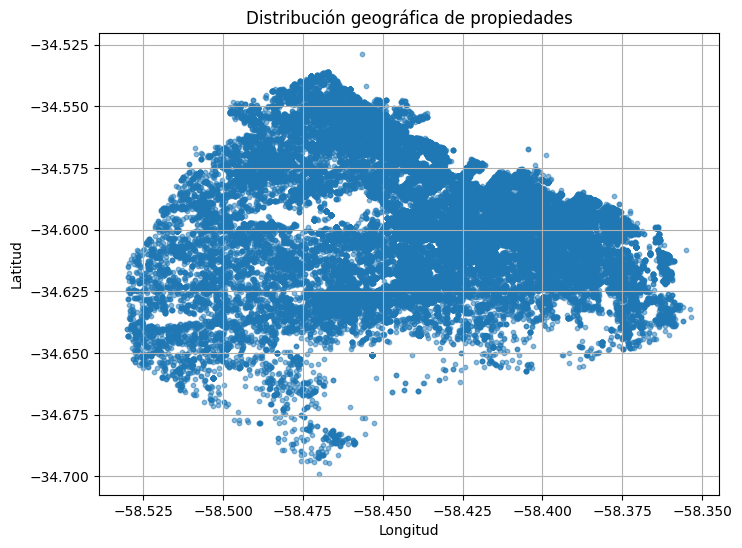

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))

plt.scatter(df_ent['lon'], df_ent['lat'], alpha=0.5, s=10)
plt.title('Distribución geográfica de propiedades')
plt.xlabel('Longitud')
plt.ylabel('Latitud')
plt.grid(True)

plt.show()

In [ ]:
columnas = ['price', 'surface_total', 'surface_covered', 'rooms', 'bedrooms','bathrooms']
df_subset = df_ent[columnas]

estadisticas = df_subset.describe(percentiles=[0.01, 0.05, 0.10, 0.15, 0.20, 0.25, 0.30, 0.40 ,0.50, 0.60, 0.70, 0.75, 0.80, 0.90, 0.95, 0.99]).T

modas = df_subset.mode().iloc[0]
estadisticas['mode'] = modas

estadisticas = estadisticas[['count', 'mean', 'std', 'mode', 'max', 'min', '1%', '5%','10%','15%','20%', '25%', '30%','40%','50%','60%','70%', '75%','80%','90%', '95%', '99%']]

estadisticas_vertical = estadisticas.T

import pandas.io.formats.style
estadisticas_vertical.style.format('{:,.2f}')



,price,surface_total,surface_covered,rooms,bedrooms,bathrooms
count,"66,860.00","66,860.00","66,860.00","66,860.00","66,860.00","66,860.00"
mean,"212,655.58",84.42,73.98,2.67,1.63,1.40
std,"189,515.02",77.81,62.27,1.38,1.25,0.78
mode,"115,000.00",40.00,35.00,2.00,2.00,1.00
max,"3,000,000.00","2,200.00","2,200.00",30.00,29.00,11.00
min,"9,500.00",4.00,1.00,0.00,0.00,0.00
1%,"25,000.00",13.00,13.00,0.00,0.00,0.00
5%,"69,322.00",30.00,27.00,1.00,0.00,1.00
10%,"80,000.00",34.00,32.00,1.00,0.00,1.00
15%,"90,000.00",38.00,35.00,1.00,0.00,1.00


In [ ]:
df_ent.groupby('rooms')['surface_covered'].median()

,surface_covered
rooms,
0.0,12.0
1.0,34.0
2.0,44.0
3.0,66.0
4.0,101.0
5.0,155.0
6.0,205.5
7.0,264.0
8.0,270.0


In [ ]:
df_ent.groupby('rooms')['surface_total'].median()

,surface_total
rooms,
0.0,12.0
1.0,37.0
2.0,48.0
3.0,73.0
4.0,114.0
5.0,174.0
6.0,240.0
7.0,300.0
8.0,360.0


## **Análisis de 'price'**

<Axes: >

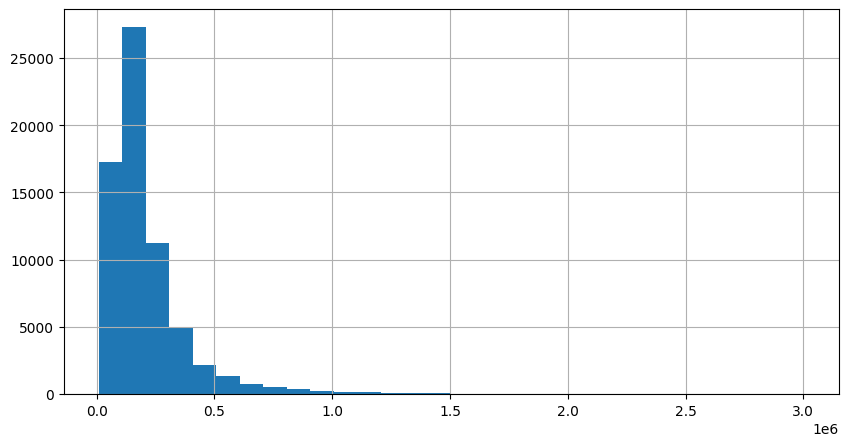

In [ ]:
df_ent['price'].hist(figsize=(10,5),bins=30)

<Axes: >

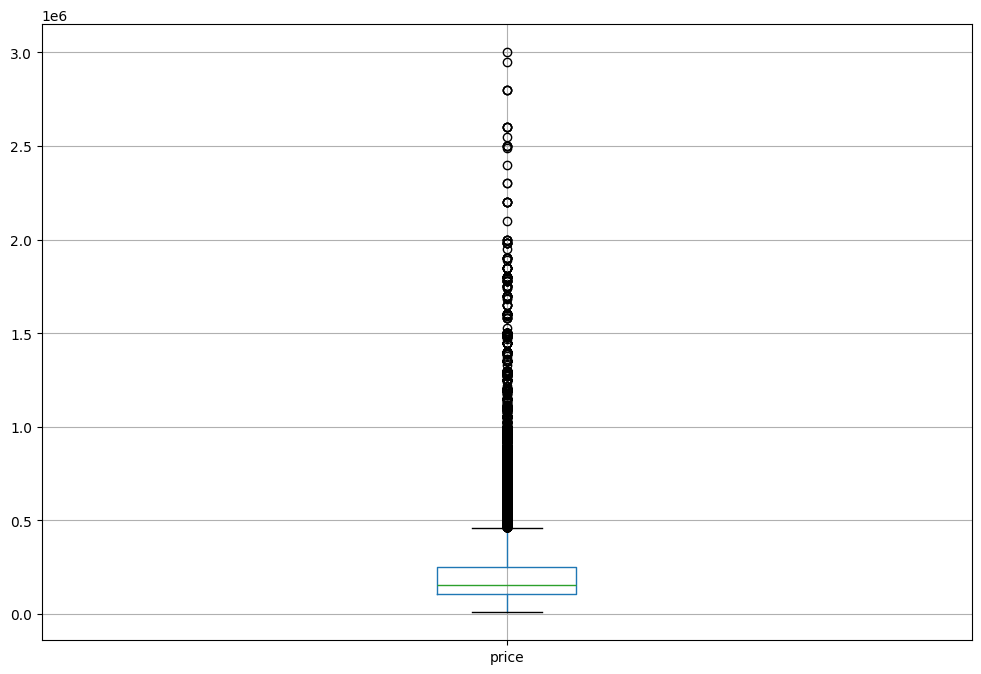

In [ ]:
df_ent.boxplot(column = 'price',figsize=(12,8))

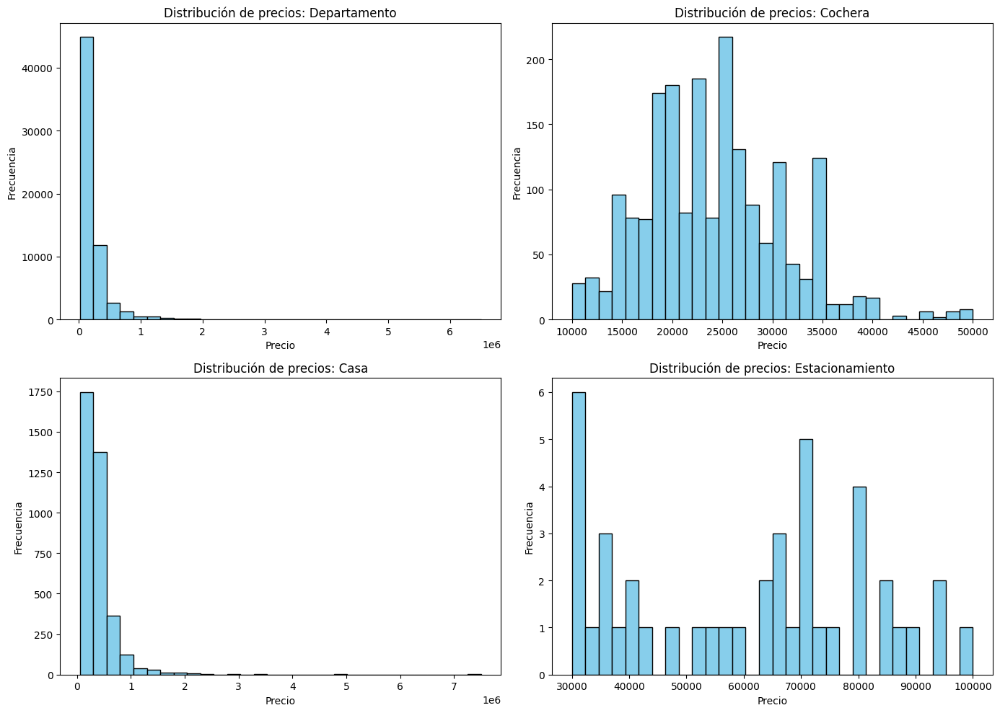

In [ ]:
# Categorías únicas (sin NaNs)
categorias = df_ent['property_type'].dropna().unique()
n = len(categorias)

# Configurar grilla: 2 columnas por fila
cols = 2
rows = int(np.ceil(n / cols))

# Crear subplots
fig, axes = plt.subplots(rows, cols, figsize=(14, 5 * rows))
axes = axes.flatten()  # Aplanar para iterar fácilmente

# Graficar cada histograma
for i, categoria in enumerate(categorias):
    ax = axes[i]
    datos = df_ent.loc[df_ent['property_type'] == categoria, 'price'].dropna()

    ax.hist(datos, bins=30, color='skyblue', edgecolor='black')
    ax.set_title(f'Distribución de precios: {categoria}')
    ax.set_xlabel('Precio')
    ax.set_ylabel('Frecuencia')

# Eliminar ejes vacíos si sobran
for j in range(n, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


<Axes: title={'center': 'price'}, xlabel='property_type'>

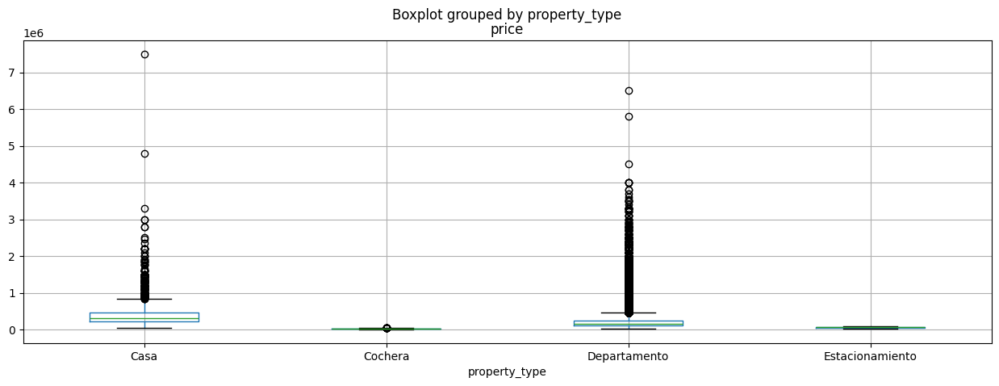

In [ ]:
df_ent.boxplot(by='property_type', column='price',figsize=(15,5))

## **Price vs Estimated Price**

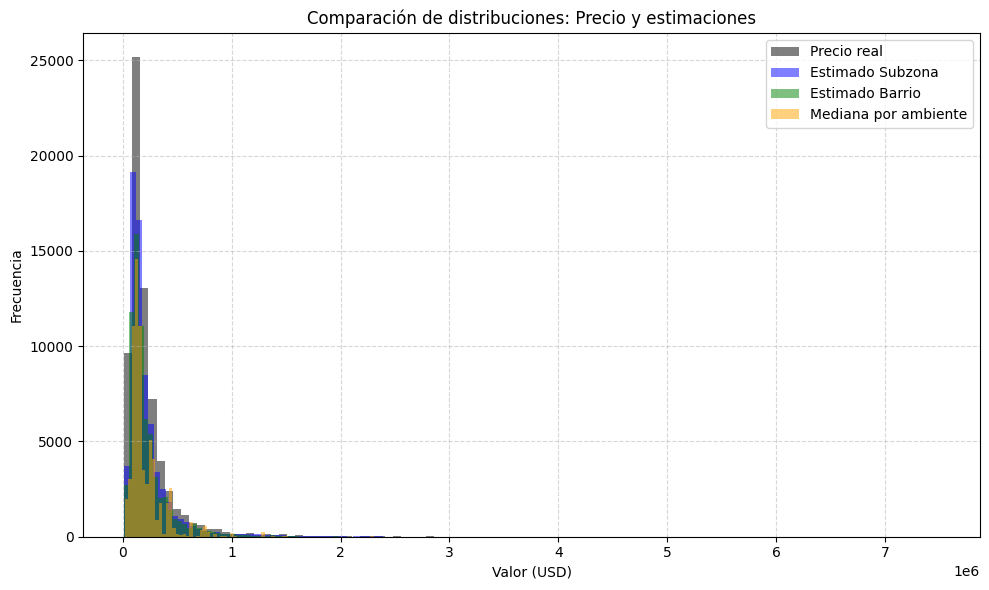

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))

plt.hist(df_ent['price'], bins=100, alpha=0.5, label='Precio real', color='black')
plt.hist(df_ent['price_m2_median_x_surface_total_subzona'], bins=100, alpha=0.5, label='Estimado Subzona', color='blue')
plt.hist(df_ent['price_m2_median_x_surface_total'], bins=100, alpha=0.5, label='Estimado Barrio', color='green')
plt.hist(df_ent['rooms_mediana_del_barrio'], bins=100, alpha=0.5, label='Mediana por ambiente', color='orange')

plt.xlabel('Valor (USD)')
plt.ylabel('Frecuencia')
plt.title('Comparación de distribuciones: Precio y estimaciones')
plt.legend()
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

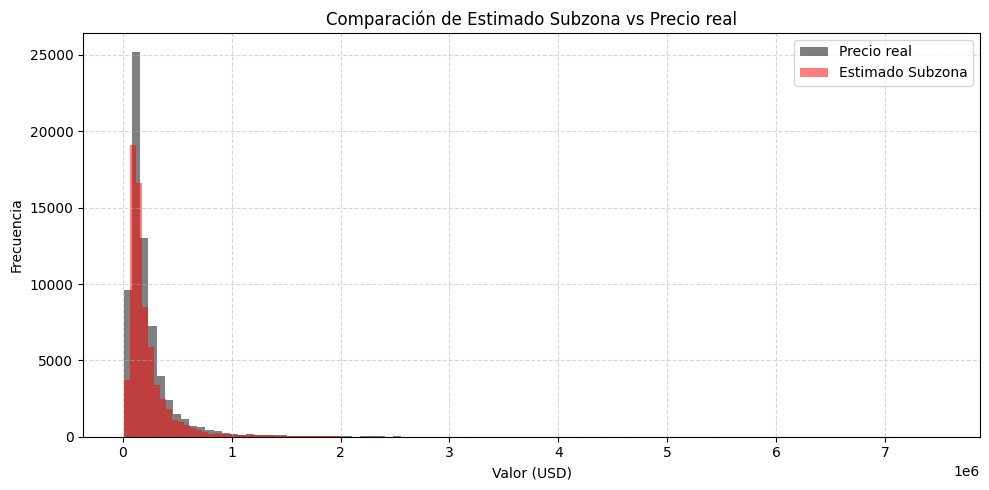

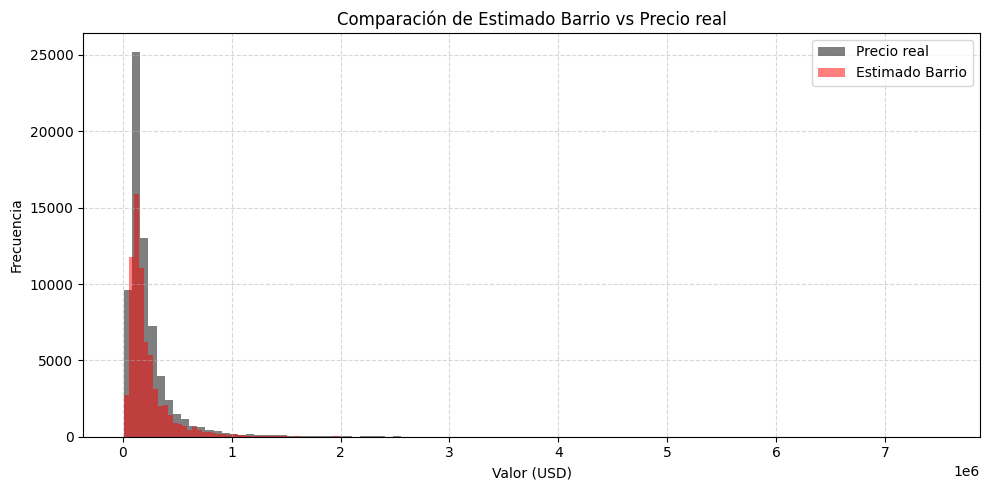

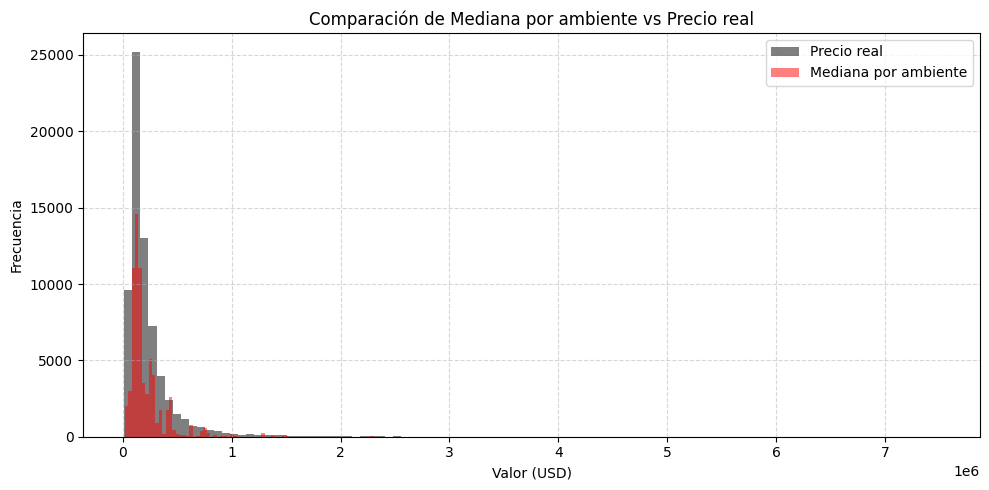

In [ ]:
import matplotlib.pyplot as plt

comparaciones = {
    'price_m2_median_x_surface_total_subzona': 'Estimado Subzona',
    'price_m2_median_x_surface_total': 'Estimado Barrio',
    'rooms_mediana_del_barrio': 'Mediana por ambiente'
}

for col, label in comparaciones.items():
    plt.figure(figsize=(10, 5))
    plt.hist(df_ent['price'], bins=100, alpha=0.5, label='Precio real', color='black')
    plt.hist(df_ent[col], bins=100, alpha=0.5, label=label, color='red')

    plt.xlabel('Valor (USD)')
    plt.ylabel('Frecuencia')
    plt.title(f'Comparación de {label} vs Precio real')
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.5)
    plt.tight_layout()
    plt.show()


In [ ]:
from sklearn.linear_model import LinearRegression

X = df_ent[['price_m2_median_x_surface_total_subzona']]
y = df_ent['price']

model = LinearRegression().fit(X, y)
print(model.score(X, y))  # R²

ValueError: Input X contains NaN.
LinearRegression does not accept missing values encoded as NaN natively. For supervised learning, you might want to consider sklearn.ensemble.HistGradientBoostingClassifier and Regressor which accept missing values encoded as NaNs natively. Alternatively, it is possible to preprocess the data, for instance by using an imputer transformer in a pipeline or drop samples with missing values. See https://scikit-learn.org/stable/modules/impute.html You can find a list of all estimators that handle NaN values at the following page: https://scikit-learn.org/stable/modules/impute.html#estimators-that-handle-nan-values

In [ ]:
from sklearn.linear_model import LinearRegression

X = df_ent[['price_m2_median_x_surface_total']]
y = df_ent['price']

model = LinearRegression().fit(X, y)
print(model.score(X, y))  # R²

In [ ]:
from sklearn.linear_model import LinearRegression

X = df_ent[['rooms_mediana_del_barrio']]
y = df_ent['price']

model = LinearRegression().fit(X, y)
print(model.score(X, y))  # R²

In [ ]:
"""
¿Qué significa este R²?

    Si hicieras una predicción del precio usando solo esa variable, ya estarías haciendo un trabajo excelente.

    El resto del modelo (con 200+ variables) solo puede mejorar el 20% restante... y probablemente con mucho esfuerzo y poco retorno.

    Esto valida que la segmentación por subzona kmeans + tipo + superficie capturó casi toda la señal estructural del mercado.

"""

## **Histogramas de Comunas**

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Categorías únicas (sin NaNs)
categorias = df_ent['comuna'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()  # Aplanar en caso de múltiples filas

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[df_ent['comuna'] == categoria, 'price'].dropna()
    ax = axes[i]
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black')
    ax.set_title(f'{categoria}')
    ax.set_xlabel('Precio')
    ax.set_ylabel('Frecuencia')

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

## **Histogramas de barrios**

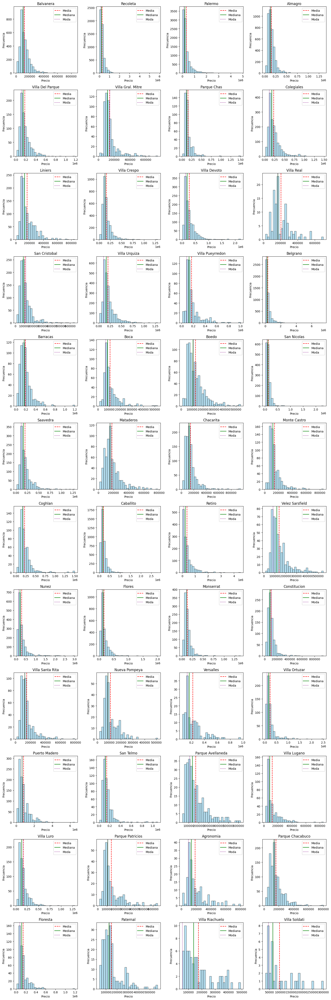

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[df_ent['barrio'] == categoria, 'price'].dropna()
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel('Precio')
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()



## **Matriz de correlaciones**

In [ ]:
matriz_corr = df_ent[['price'] + selected_features].corr()
#price_m2_media_x_surface_total
matriz_corr

,price,lat,lon,rooms,bedrooms,bathrooms,surface_total,surface_covered,pm2_media_del_barrio,price_m2_media_x_surface_total,cochera,pozo,bajas_expensas,es_duplex,es_triplex,es_loft,n_amenities,n_comfort_features,tipo_de_prop_Casa,tipo_de_prop_Cochera,tipo_de_prop_Departamento,antiguedad_estrenar,antiguedad_usado,es__cochera,es__estacionamiento,es__tipo_distinto_de_cochera,es__Abasto,es__Agronomía,es__Almagro,es__Balvanera,es__Barracas,es__Barrio Norte,es__Belgrano,es__Boca,es__Boedo,es__Caballito,es__Centro / Microcentro,es__Chacarita,es__Coghlan,es__Colegiales,es__Congreso,es__Constitución,es__Flores,es__Floresta,es__Las Cañitas,es__Liniers,es__Mataderos,es__Monserrat,es__Monte Castro,es__Nuñez,es__Once,es__Palermo,es__Palermo Chico,es__Palermo Hollywood,es__Palermo Soho,es__Palermo Viejo,es__Parque Avellaneda,es__Parque Centenario,es__Parque Chacabuco,es__Parque Chas,es__Parque Patricios,es__Paternal,es__Pompeya,es__Puerto Madero,es__Recoleta,es__Retiro,es__Saavedra,es__San Cristobal,es__San Nicolás,es__San Telmo,es__Tribunales,es__Velez Sarsfield,es__Versalles,es__Villa Crespo,es__Villa Devoto,es__Villa General Mitre,es__Villa Lugano,es__Villa Luro,es__Villa Ortuzar,es__Villa Pueyrredón,es__Villa Real,es__Villa Riachuelo,es__Villa Santa Rita,es__Villa Soldati,es__Villa Urquiza,es__Villa del Parque,ratio_surface_covered,ratio_surface_total,m2_cubiertos_por_room,m2_totales_por_room,m2_cubiertos_por_dormitorio,porcentaje_dormitorios
price,1.000000,0.203353,0.109955,0.629233,0.591009,0.689897,0.795953,0.826039,0.347808,0.947801,0.349658,-0.019430,-0.088934,0.061492,0.074338,0.003091,0.176160,0.566983,0.266810,-0.122618,-0.168178,-0.054954,0.054954,-0.126315,0.010252,0.122618,-0.021302,-0.010087,-0.081759,-0.075806,-0.019043,0.031883,0.165365,-0.035717,-0.030154,-0.037540,-0.027414,-0.026143,-0.005088,-0.037687,-0.036888,-0.040213,-0.044844,-0.031348,0.052447,-0.028730,-0.019817,-0.052490,-0.023854,0.023535,-0.035342,0.070320,0.197716,-0.011607,0.008100,0.035842,-0.016929,-0.017055,-0.029410,-0.010602,-0.024126,-0.033314,-0.024281,0.253265,0.136253,0.025099,-0.011990,-0.054232,-0.049114,-0.041266,-0.025049,-0.014879,-0.008044,-0.080942,0.011410,-0.022521,-0.035577,-0.029430,-0.008886,-0.021811,-0.002637,-0.005268,-0.018308,-0.007443,-0.028266,-0.029152,-0.139790,0.081235,0.498921,0.473271,0.522813,0.380295
lat,0.203353,1.000000,-0.122479,-0.010772,-0.016716,0.083217,0.023080,0.031443,0.585665,0.193298,0.164944,-0.006332,-0.008187,0.038535,0.027361,-0.006616,0.115434,0.188496,-0.084864,0.001217,0.073140,0.047338,-0.047338,0.001813,-0.003244,-0.001217,-0.020410,0.004877,-0.113217,-0.099404,-0.153703,0.029435,0.431743,-0.108083,-0.130592,-0.219435,-0.016496,0.032720,0.122180,0.123641,-0.040693,-0.081221,-0.224325,-0.143039,0.085002,-0.174717,-0.199977,-0.082448,-0.065464,0.341263,-0.035020,0.175028,0.076444,0.088259,0.046768,0.023671,-0.106920,-0.036587,-0.180255,0.023395,-0.103074,-0.021555,-0.097635,-0.074914,0.054342,0.004995,0.225252,-0.114942,-0.029007,-0.104207,-0.010864,-0.064867,-0.073137,-0.012096,-0.038083,-0.032786,-0.223124,-0.148549,0.040613,0.047457,-0.034830,-0.043338,-0.046041,-0.051098,0.187804,-0.053256,-0.002935,-0.010313,0.044582,0.025144,0.074325,-0.026320
lon,0.109955,-0.122479,1.000000,0.029661,0.024613,0.033209,-0.006208,0.031757,0.234995,0.098667,-0.049873,-0.005920,-0.018080,-0.033675,-0.037468,0.028396,-0.112084,0.014554,-0.173190,0.057902,0.120446,-0.139065,0.139065,0.057355,0.008023,-0.057902,0.044876,-0.070309,0.122563,0.151275,0.160688,0.175012,-0.149237,0.146831,0.053358,-0.047616,0.089460,-0.039259,-0.089013,-0.075414,0.099029,0.098832,-0.131195,-0.150541,0.003371,-0.211081,-0.154679,0.162661,-0.128206,-0.137965,0.080253,0.129948,0.080635,0.001324,0.037061,0.024826,-0.063079,0.003439,-0.002822,-0.052793,0.059397,-0.075249,0.023601,0.230667,0.280864,0.151776,-0.159922,0.109499,0.157442,0.184786,0.067446,-0.073138,-0.128251,-0.040344,-0.274937,-0.057536,-0.071422,-0.159978,-0.059560,-0.168211,-0.085139,

<ipython-input-60-0124ee7f9211>:17: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


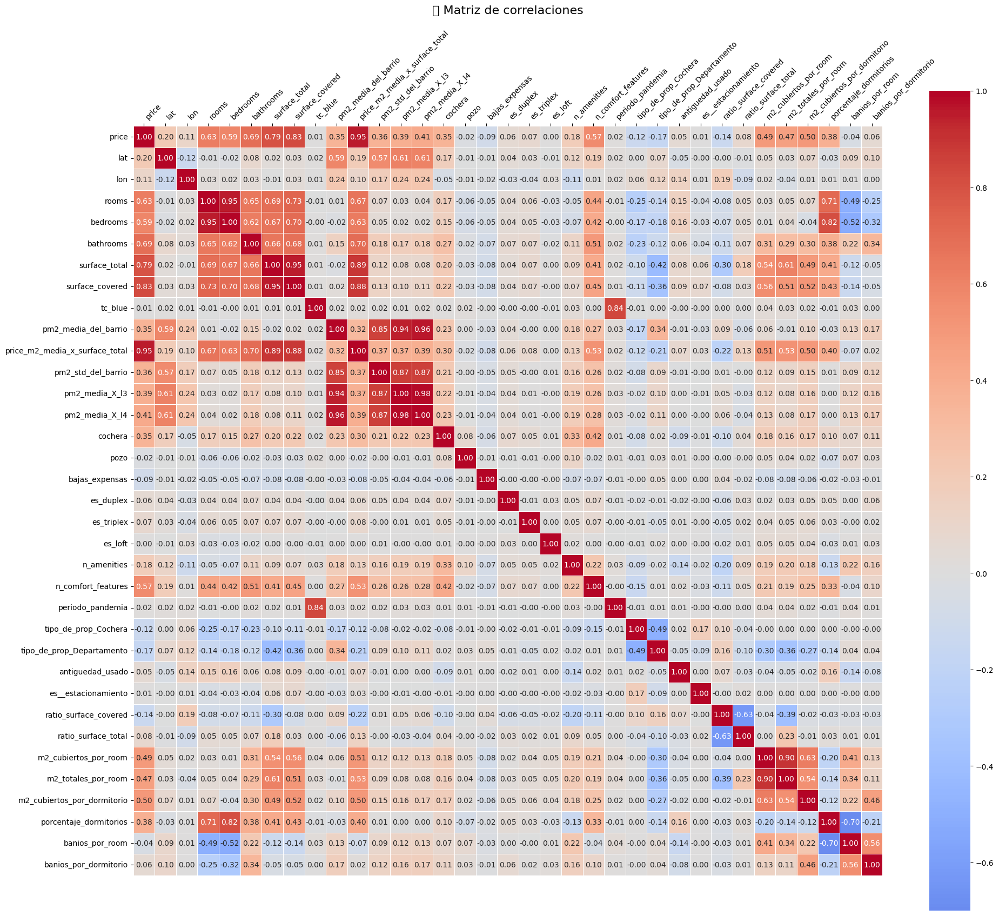

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Crear el heatmap
plt.figure(figsize=(20, 20))
ax = sns.heatmap(matriz_corr, annot=True, fmt=".2f", cmap="coolwarm", center=0,
                 square=True, linewidths=0.5, cbar_kws={"shrink": 0.8})

# Mover etiquetas X hacia arriba
ax.xaxis.set_ticks_position('top')
ax.xaxis.set_label_position('top')

# Ajustes estéticos
plt.title("🔍 Matriz de correlaciones", fontsize=16, pad=20)
plt.xticks(rotation=45, ha='left')  # Cambié ha a 'left' para mejorar legibilidad arriba
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()


## **Analisis de correlación de 'price' y 'pm2**

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats  # para calcular la moda

# Categorías únicas (sin NaNs)
categorias = df_ent['property_type'].dropna().unique()
n = len(categorias)

# Configurar grilla: 2 columnas por fila
cols = 2
rows = int(np.ceil(n / cols))

# Crear subplots
fig, axes = plt.subplots(rows, cols, figsize=(14, 5 * rows))
axes = axes.flatten()  # Aplanar para iterar fácilmente

# Graficar cada histograma con líneas de media, mediana y moda
for i, categoria in enumerate(categorias):
    ax = axes[i]
    datos = df_ent.loc[df_ent['property_type'] == categoria, 'pm2'].dropna()

    if datos.empty:
        ax.set_visible(False)
        continue

    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]  # obtener valor, no la frecuencia

    # Líneas verticales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    ax.set_title(f'Distribución de pm2: {categoria}')
    ax.set_xlabel('pm2')
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar ejes vacíos si sobran
for j in range(n, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()



KeyError: 'property_type'

## **Histogramas de pm2 - Departamento**

KeyError: 'property_type'

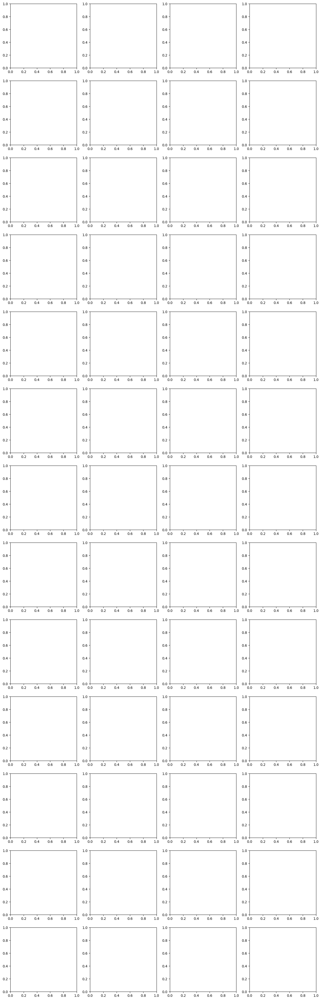

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

tipo_de_propiedad = 'Departamento'

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[(df_ent['property_type'] == tipo_de_propiedad) & (df_ent['barrio'] == categoria), 'pm2'].dropna()
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel('Precio')
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


## **Histogramas pm2 - Casas**

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

tipo_de_propiedad = 'Casa'

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[(df_ent['property_type'] == tipo_de_propiedad) & (df_ent['barrio'] == categoria), 'pm2'].dropna()
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel('Precio')
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


## **Histograma pm2 - Cochera**

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

tipo_de_propiedad = 'Cochera'

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[(df_ent['property_type'] == tipo_de_propiedad) & (df_ent['barrio'] == categoria), 'pm2'].dropna()
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel('Precio')
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


## **Histograma pm2 - Estacionamiento**

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

tipo_de_propiedad = 'Estacionamiento'

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[(df_ent['prperty_type'] == tipo_de_propiedad) & (df_ent['barrio'] == categoria), 'pm2'].dropna()
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel('Precio')
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


In [ ]:
df_ent.loc[df_ent['property_type']=='Estacionamiento',['surface_total','surface_covered','pm2','price_m2_median_x_surface_total','price']].describe(percentiles=[0.01,0.05 ,0.1, 0.25, 0.5, 0.55,0.6,0.65,0.75,0.8,0.85,0.9,0.91,0.92,0.93,0.94,0.95, 0.96, 0.97, 0.98 , 0.99])

In [ ]:
df_ent.loc[(df_ent['property_type']=='Estacionamiento') & (df_ent['price']<35000),['price','price_m2_median_x_surface_total','surface_total','title','description']].sort_values('price',ascending=True)

In [ ]:
orden_columnas = ['Estándar bajo', 'Estándar', 'Estándar medio-alto', 'Estándar Alto','Premium/Lujo']

from pandas.api.types import CategoricalDtype

orden_zonas = CategoricalDtype(categories=orden_columnas, ordered=True)
df_ent['segmentacion_zonas'] = df_ent['segmentacion_zonas'].astype(orden_zonas)


pd.crosstab(df_ent[df_ent['property_type']=='Departamento']['barrio'],df_ent[df_ent['property_type']=='Departamento']['segmentacion_zonas'])

In [ ]:

# Filtrar solo 'Departamento'
df_depto = df_ent[df_ent['property_type'] == 'Departamento'].copy()

# Barrios únicos
barrios = df_depto['barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(20, 5 * rows))
axes = axes.flatten()

# Graficar de a uno por subplot
for i, barrio in enumerate(barrios):
    ax = axes[i]
    df_b = df_depto[df_depto['barrio'] == barrio]

    # Boxplot individual
    df_b.boxplot(column='pm2', ax=ax)
    ax.set_title(barrio)
    ax.set_xlabel('')
    ax.set_ylabel('pm2')

# Eliminar ejes vacíos si sobran
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


In [ ]:
import matplotlib.pyplot as plt

# Agrupación y pivot con unstack para barras acumuladas
df_plot = df_ent[df_ent['property_type']=='Departamento'].groupby(['l3', 'property_type'])['pm2'].median().unstack()

# Ordenar por la suma total de pm2 descendente
df_plot = df_plot.loc[df_plot.sum(axis=1).sort_values(ascending=True).index]

# Plot horizontal acumulado
ax = df_plot.plot.barh(stacked=True, figsize=(15, 10))

# Mejorar presentación del gráfico
plt.title('Mediana de pm2 por Zona (l3) y Tipo de Propiedad (property_type)', fontsize=16)
plt.xlabel('Mediana de pm2', fontsize=14)
plt.ylabel('Zona (l3)', fontsize=14)
plt.legend(title='Tipo de Propiedad', fontsize=12, title_fontsize=12, bbox_to_anchor=(1,1))
plt.tight_layout()

plt.show()



In [ ]:
import matplotlib.pyplot as plt

# Agrupación y pivot con unstack para barras acumuladas
df_plot = df_ent[df_ent['property_type']=='Casa'].groupby(['l3', 'property_type'])['pm2'].median().unstack()

# Ordenar por la suma total de pm2 descendente
df_plot = df_plot.loc[df_plot.sum(axis=1).sort_values(ascending=True).index]

# Plot horizontal acumulado
ax = df_plot.plot.barh(stacked=True, figsize=(15, 10))

# Mejorar presentación del gráfico
plt.title('Mediana de pm2 por Zona (l3) y Tipo de Propiedad (property_type)', fontsize=16)
plt.xlabel('Mediana de pm2', fontsize=14)
plt.ylabel('Zona (l3)', fontsize=14)
plt.legend(title='Tipo de Propiedad', fontsize=12, title_fontsize=12, bbox_to_anchor=(1,1))
plt.tight_layout()

plt.show()

In [ ]:
df_ent[df_ent['property_type']=='Departamento'].plot.scatter(
    x='surface_total', y='surface_covered',
    title="Correlación",
    alpha=0.5, figsize=(12,8)
)
plt.ylabel("Superficie cubierta")
plt.xlabel("Superficie total")
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()

In [ ]:
import matplotlib.pyplot as plt

# Agrupación y pivot con unstack para barras acumuladas
df_plot = df_ent[df_ent['property_type']=='Cochera'].groupby(['l3', 'property_type'])['pm2'].median().unstack()

# Ordenar por la suma total de pm2 descendente
df_plot = df_plot.loc[df_plot.sum(axis=1).sort_values(ascending=True).index]

# Plot horizontal acumulado
ax = df_plot.plot.barh(stacked=True, figsize=(15, 10))

# Mejorar presentación del gráfico
plt.title('Mediana de pm2 por Zona (l3) y Tipo de Propiedad (property_type)', fontsize=16)
plt.xlabel('Mediana de pm2', fontsize=14)
plt.ylabel('Zona (l3)', fontsize=14)
plt.legend(title='Tipo de Propiedad', fontsize=12, title_fontsize=12, bbox_to_anchor=(1,1))
plt.tight_layout()

plt.show()

In [ ]:
df_ent.plot.scatter(
    x='pm2', y='price',
    title="Correlación entre Precio y Precio por m²",
    alpha=0.5, figsize=(12,8)
)
plt.ylabel("Precio de la propiedad")
plt.xlabel("Precio por metro cuadrado (pm2)")
plt.grid(True, linestyle='--', alpha=0.6)
plt.show()


In [ ]:
df_ent[(df_ent['property_type']=='Casa')].boxplot(by='segmentacion_zonas', column='pm2', figsize=(20,10))

In [ ]:
df_ent.groupby(['l3','rooms'])["price"].agg(
    mean="mean",
    std="std",
    median="median",
    min="min",
    max="max",
    q5=lambda x: x.quantile(0.05),
    q10=lambda x: x.quantile(0.10),
    q20=lambda x: x.quantile(0.20),
    q25=lambda x: x.quantile(0.25),
    q50=lambda x: x.quantile(0.5),
    q75=lambda x: x.quantile(0.75),
    q90=lambda x: x.quantile(0.9),
    q95=lambda x: x.quantile(0.95),
    q99=lambda x: x.quantile(0.99)
).applymap(lambda x: f"{x:,.2f}".replace(",", "X").replace(".", ",").replace("X", "."))


In [ ]:
df_ent[df_ent['property_type']=='Cochera'].groupby(['l3','property_type'])["price"].agg(
    min="min",
    max="max",
    median="median",
    mean="mean",
    std="std",
    q5=lambda x: x.quantile(0.05),
    q10=lambda x: x.quantile(0.10),
    q20=lambda x: x.quantile(0.20),
    q25=lambda x: x.quantile(0.25),
    q50=lambda x: x.quantile(0.5),
    q75=lambda x: x.quantile(0.75),
    q90=lambda x: x.quantile(0.9),
    q95=lambda x: x.quantile(0.95),
    q99=lambda x: x.quantile(0.99)
).applymap(lambda x: f"{x:,.2f}".replace(",", "X").replace(".", ",").replace("X", "."))

In [ ]:
df_ent[df_ent['property_type']=='Departamento'].groupby(['l3','property_type'])["price"].agg(
    min="min",
    max="max",
    median="median",
    mean="mean",
    std="std",
    q5=lambda x: x.quantile(0.05),
    q10=lambda x: x.quantile(0.10),
    q20=lambda x: x.quantile(0.20),
    q25=lambda x: x.quantile(0.25),
    q50=lambda x: x.quantile(0.5),
    q75=lambda x: x.quantile(0.75),
    q90=lambda x: x.quantile(0.9),
    q95=lambda x: x.quantile(0.95),
    q99=lambda x: x.quantile(0.99)
).applymap(lambda x: f"{x:,.2f}".replace(",", "X").replace(".", ",").replace("X", "."))

In [ ]:
df_ent.plot.scatter(x='price',y="pm2", title = "Correlacion price vs pm2", alpha=0.5)

In [ ]:
df_ent.plot.scatter('price','surface_covered', title = "Correlacion price vs surface_covered")

In [ ]:
variables = ['rooms', 'bedrooms', 'bathrooms']

for var in variables:
    ax = df_ent.plot.scatter(x=var, y='price', title=f"Correlación price vs {var}", alpha=0.5)

    promedios = df_ent.groupby(var)['price'].mean()

    promedios.plot(
        ax=ax,
        kind='line',
        color='red',
        marker='o',
        linewidth=2,
        label='Precio promedio'
    )

    ax.set_ylabel("price")
    ax.legend()
    plt.show()


In [ ]:
df_ent.plot.scatter(x='price',y='surface_total', title = "Correlacion price vs surface_total", alpha=0.5)

In [ ]:
#Precio promedio por cantidad de ambientes

df_ent[df_ent['property_type']=='Departamento'].groupby('rooms')['price'].mean().reset_index(name="promedio")


In [ ]:
#Frecuncia de rooms
df_ent.groupby('bathrooms').size().reset_index(name="cantidad").sort_values('cantidad',ascending=False)

In [ ]:

variables = ['rooms', 'bedrooms', 'bathrooms']

tipo = 'Departamento'

for var in variables:
    ax = df_ent[df_ent['property_type']==tipo].groupby(var)['price'].mean().plot(title=f"{tipo} - Price vs {var}",marker='o')

    ax.set_ylabel("price")
    ax.legend()
    plt.show()



In [ ]:
variables = ['rooms', 'bedrooms', 'bathrooms']

tipo = 'Casa'

for var in variables:
    ax = df_ent[df_ent['property_type']==tipo].groupby(var)['price'].mean().plot(title=f"{tipo} - Price vs {var}",marker='o')

    ax.set_ylabel("price")
    ax.legend()
    plt.show()

In [ ]:
variables = ['rooms', 'bedrooms', 'bathrooms']

tipo = 'PH'

for var in variables:
    ax = df_ent[df_ent['property_type']==tipo].groupby(var)['price'].mean().plot(title=f"{tipo} - Price vs {var}",marker='o')

    ax.set_ylabel("price")
    ax.legend()
    plt.show()

In [ ]:
df_ent[df_ent['property_type']=='Casa'].groupby('rooms')['price'].mean().reset_index(name='promedio').sort_values('promedio',ascending=True)

In [ ]:
df_ent[df_ent['property_type']=='Casa'].groupby('rooms').size().reset_index(name='cantidad').sort_values('cantidad',ascending=False)

In [ ]:
df_ent.groupby('bedrooms')['price'].mean().reset_index()


In [ ]:
df_ent.groupby('bedrooms')['price'].size().reset_index()

In [ ]:
df_ent[df_ent['property_type']=='PH'].groupby('bedrooms')['price'].mean().reset_index()

In [ ]:
df_ent[df_ent['property_type']=='Departamento'].groupby('bedrooms').size().reset_index()

## **Tabla de doble entrada Precio vs Tipo de propiedad**

In [ ]:
# Crear bins para agrupar los precios
df_ent['price_bin'] = pd.cut(
    df_ent['price'],
    bins=[0, 100_000, 200_000, 300_000, 500_000, 1_000_000, float('inf')],
    labels=['0-100k', '100-200k', '200-300k', '300-500k', '500k-1M', '1M+']
)

df_ent['pm2_bin'] = pd.cut(
    df_ent['pm2'],
    bins=[0, 1000, 2000, 3000, 4000, 5000, 6000, 7000, 8000,float('inf')],
    labels=['0-1k', '1-2k', '2-3k', '3-4k', '4-5k', '5-6k','6-7k','7-8k','8k+']
)


In [ ]:
pd.crosstab(
    df_ent['barrio'],
    df_ent['price_bin'],
    margins=True,
    normalize='index'  # opcional: proporciones por fila
).style.format('{:.1%}')


In [ ]:
mask_depto = (df_ent['property_type']=='Departamento') & (df_ent['rooms']>2)

pd.crosstab(
    df_ent.loc[mask_depto,'barrio'],
    df_ent.loc[mask_depto,'pm2_bin'],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
df_ent['year'] = pd.to_datetime(df_ent['start_date'],errors='coerce' ).dt.year
df_ent['month'] = pd.to_datetime(df_ent['start_date'],errors='coerce' ).dt.month

In [ ]:
df_ent.groupby(['year','month']).size().reset_index(name='cantidad').sort_values(['year','month'],ascending=[True,True]).astype({'year':'int','month':'int'}).style.format({'cantidad':'{:,.0f}'})

In [ ]:
df_ent['bedrooms'].value_counts().reset_index()

# **AID - Rooms**

## 1. Departamentos

### Estadistica de Departamentos

In [ ]:
import pandas.io.formats.style

df_ent.loc[df_ent['property_type_Departamento']==1].groupby('rooms')[['price','surface_total','surface_covered','surface_descubierta','bedrooms','bathrooms']].median().style.format('{:,.2f}')



,price,surface_total,surface_covered,surface_descubierta,bedrooms,bathrooms
rooms,,,,,,
1.000000,"98,000.00",37.00,34.00,3.00,0.00,1.00
2.000000,"125,000.00",48.00,43.00,3.00,1.00,1.00
3.000000,"187,000.00",73.00,65.00,5.00,2.00,1.00
4.000000,"280,000.00",110.00,99.00,8.00,3.00,2.00
5.000000,"430,000.00",171.00,149.00,9.00,4.00,3.00
6.000000,"690,000.00",236.00,216.00,10.00,4.00,3.00
7.000000,"750,000.00",261.00,243.00,12.00,4.00,3.00
8.000000,"637,000.00",258.50,236.50,0.00,6.00,3.00
9.000000,"360,000.00",360.00,360.00,0.00,6.00,4.00


### rooms = 1

#### a.1) Análisis General

In [ ]:
property_type = 'Departamento'

rooms = 1

mask = (df_ent['property_type']==property_type) & (df_ent['rooms']==rooms)

columnas = ['price', 'pm2','surface_total', 'surface_covered', 'surface_descubierta','rooms', 'bedrooms','bathrooms']

df_subset = df_ent.loc[mask, columnas]

percentiles = [
    0.00, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09,
    0.10, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19,
    0.20, 0.25, 0.30, 0.35, 0.40,0.45, 0.50,  0.55, 0.60, 0.65, 0.70, 0.75,
    0.80, 0.85,
    0.90, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99,
    1.00
]


estadisticas = df_subset.describe(percentiles).T

modas = df_subset.mode().iloc[0]
estadisticas['mode'] = modas

valores = [
'count', 'mean', 'std', 'mode', 'max', 'min', '1%', '2%', '3%', '4%', '5%', '6%', '7%', '8%', '9%',
    '10%', '11%', '12%', '13%', '14%', '15%', '16%', '17%', '18%', '19%',
    '20%',  '25%', '30%',  '35%', '40%',  '45%', '50%', '55%', '60%',  '65%',
    '70%', '75%', '80%',  '85%', '90%', '91%', '92%', '93%', '94%', '95%', '96%', '97%', '98%', '99%',
    '100%'
]
estadisticas = estadisticas[valores]

estadisticas_vertical = estadisticas.T

import pandas.io.formats.style
estadisticas_vertical.style.format('{:,.2f}')

KeyError: 'property_type'

In [ ]:
df_ent.loc[mask & (df_ent['bedrooms']>1),['title','description','price','bedrooms']]


,title,description,price,bedrooms
__original_index__,,,,
260488,NO OFERTAR - Departamento en venta de 2 dormitorios c/ cochera en Caballito,"NO OFERTAR - Hermoso departamento ubicado en la calle Av. Rivadavia a estrenar con de expensas, apto profesional. APTO CRÉDITO. En su totalidad mide 230 m2, de los cuales 200 m2 son cubiertos y 30 m2 descubiertos. Cuenta con tres ambientes: dos dormitorios, un baño, cocina y balcón. Posee garage cubierto. También cuenta con piscina, dormitorio en suite y ascensor. Con respecto al transporte público se encuentra cerca de la estación de subte Acoyte. También está cerca del Centro Medico Hospital Alemán Caballito. El Parque Rivadavia permite aprovechar de su espacio verde. Esta ubicado cerca de diferentes escuelas. Además, a unas cuadras tiene el Caballito Shopping Center. Al ser una ubicación céntrica hay diferentes bancos, supermercados, cafés, bares y restaurantes aledaños. A tan solo unas cuadras está el Village Caballito.","175,000.00",2.00
467538,"Departamento en Venta ubicado en Villa Devoto, Capital Federal","Forma de pago: 35% de anticipo, saldo en cuotas en pesos ajustables por indice CAC hasta la posesión. La tranquilidad de Devoto se respira en el aire. La gente. El verde que lo rodea todo. Sumale a eso un lugar que combina la sensación de una casa con el confort y la seguridad de un departamento. Con balcones amplios y aterrazados, donde se disfruta del sol y de un barrio como pocos. Unidades de 1, 2 y 3 dormitorios + 2 penthouses con terraza. Moderno diseño en doble frente y gran calidad constructiva. Un entorno dominado por el verde, sumamente tranquilo y arbolado. Excelente ubicación con rápidos accesos a avenidas San Martín y General Paz. Próximo a la estación del tren Urquiza y a solo dos cuadras del Metrobus.","109,500.00",3.00
467533,"Departamento en Venta ubicado en Villa Devoto, Capital Federal","Forma de pago: 35% de anticipo, saldo en cuotas en pesos ajustables por indice CAC hasta la posesión. La tranquilidad de Devoto se respira en el aire. La gente. El verde que lo rodea todo. Sumale a eso un lugar que combina la sensación de una casa con el confort y la seguridad de un departamento. Con balcones amplios y aterrazados, donde se disfruta del sol y de un barrio como pocos. Unidades de 1, 2 y 3 dormitorios + 2 penthouses con terraza. Moderno diseño en doble frente y gran calidad constructiva. Un entorno dominado por el verde, sumamente tranquilo y arbolado. Excelente ubicación con rápidos accesos a avenidas San Martín y General Paz. Próximo a la estación del tren Urquiza y a solo dos cuadras del Metrobus.","113,500.00",3.00
467529,"Departamento en Venta ubicado en Villa Devoto, Capital Federal","Forma de pago: 35% de anticipo, saldo en cuotas en pesos ajustables por indice CAC hasta la posesión. La tranquilidad de Devoto se respira en el aire. La gente. El verde que lo rodea todo. Sumale a eso un lugar que combina la sensación de una casa con el confort y la seguridad de un departamento. Con balcones amplios y aterrazados, donde se disfruta del sol y de un barrio como pocos. Unidades de 1, 2 y 3 dormitorios + 2 penthouses con terraza. Moderno diseño en doble frente y gran calidad constructiva. Un entorno dominado por el verde, sumamente tranquilo y arbolado. Excelente ubicación con rápidos accesos a avenidas San Martín y General Paz. Próximo a la estación del tren Urquiza y a solo dos cuadras del Metrobus.","98,900.00",3.00
467528,"Departamento Monoambiente en Venta ubicado en Villa Devoto, Capital Federal","Forma de pago: 35% de anticipo, saldo en cuotas en pesos ajustables por indice CAC hasta la posesión. La tranquilidad de Devoto se respira en el aire. La gente. El verde que lo rodea todo. Sumale a eso un lugar que combina la sensación de una casa con el confort y la seguridad de un departamento. Con balcones amplios y aterrazados, donde se disfruta del sol y de un barrio como pocos. Unidades de 1, 2 y 3 dormitorios + 2 penthouses con terraza. Moderno diseño en do

#### a.2) Price

In [ ]:
col_obj = 'price'

bins_obj = 'price_bin'

In [ ]:
#Matriz de doble entrada por barrio-------------------------------------------------
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Histograma por barrio------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()
    ax.tick_params(axis='x', rotation=45)

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()
    ax.tick_params(axis='x', rotation=45)

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

bins_obj = 'price_bin'

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.3) pm2

In [ ]:
col_obj = 'pm2'

bins_obj ='pm2_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

pm2_bin,0-1k,1-2k,2-3k,3-4k,4-5k,5-6k,6-7k,7-8k
barrio,,,,,,,,
Agronomia,0.0%,8.6%,74.3%,17.1%,0.0%,0.0%,0.0%,0.0%
Almagro,0.0%,14.8%,68.8%,15.6%,0.8%,0.0%,0.0%,0.0%
Balvanera,0.1%,29.0%,62.1%,7.4%,1.4%,0.0%,0.0%,0.0%
Barracas,1.2%,30.6%,57.6%,8.2%,2.4%,0.0%,0.0%,0.0%
Belgrano,0.0%,2.0%,28.4%,62.9%,6.6%,0.1%,0.0%,0.0%
Boca,0.0%,75.8%,18.2%,1.5%,3.8%,0.8%,0.0%,0.0%
Boedo,0.0%,49.0%,42.4%,3.7%,4.1%,0.8%,0.0%,0.0%
Caballito,0.3%,17.2%,60.5%,20.9%,1.0%,0.2%,0.0%,0.0%
Chacarita,0.3%,7.1%,76.4%,13.9%,1.7%,0.3%,0.3%,0.0%


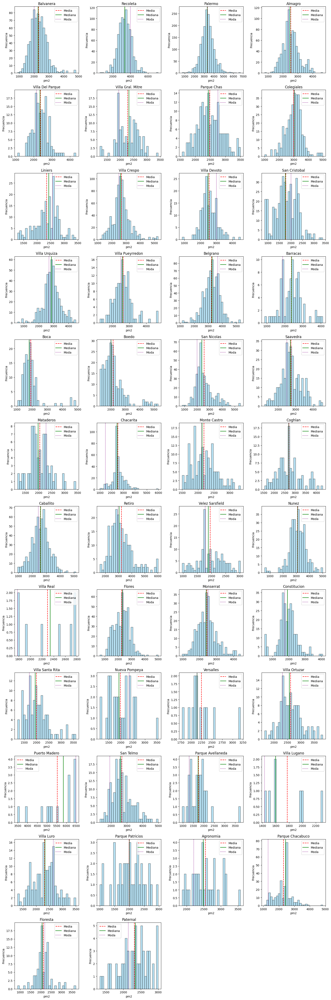

In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

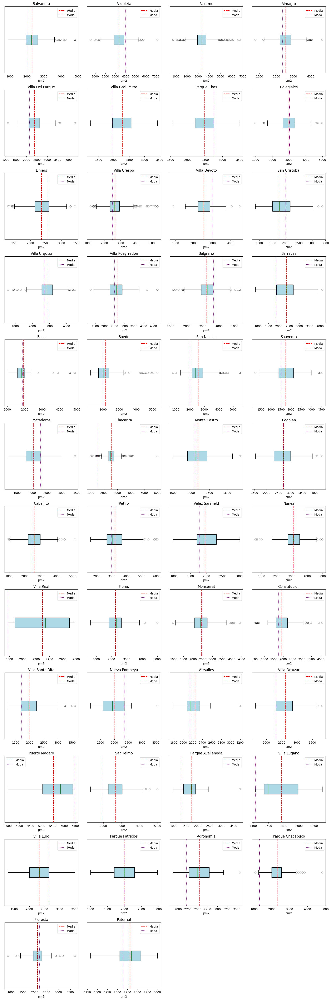

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

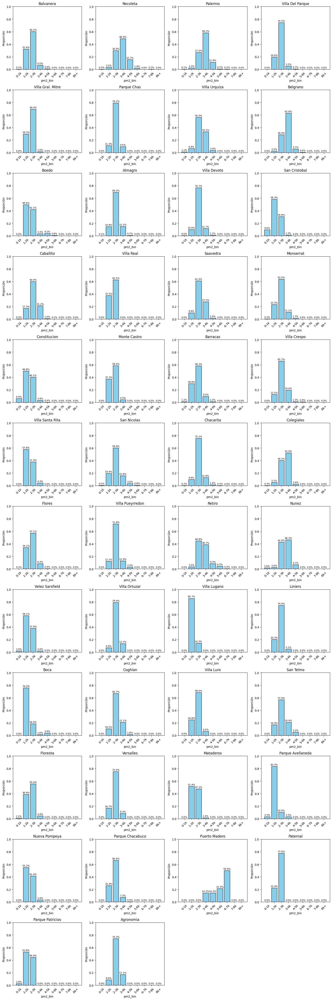

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.4) Superficie Total

In [ ]:
col_obj = 'surface_total'

bins_obj = 'surface_total_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

surface_total_bin,13-37m2,37-49m2,49-74m2,74-120m2,120-202m2
barrio,,,,,
Agronomia,31.4%,57.1%,11.4%,0.0%,0.0%
Almagro,65.1%,28.3%,6.3%,0.4%,0.0%
Balvanera,84.9%,10.9%,4.2%,0.0%,0.0%
Barracas,28.4%,38.3%,23.5%,9.9%,0.0%
Belgrano,38.7%,53.2%,7.6%,0.4%,0.0%
Boca,34.8%,56.1%,6.8%,2.3%,0.0%
Boedo,77.8%,18.1%,4.1%,0.0%,0.0%
Caballito,30.4%,59.4%,8.9%,1.3%,0.0%
Chacarita,69.2%,21.1%,7.1%,2.6%,0.0%


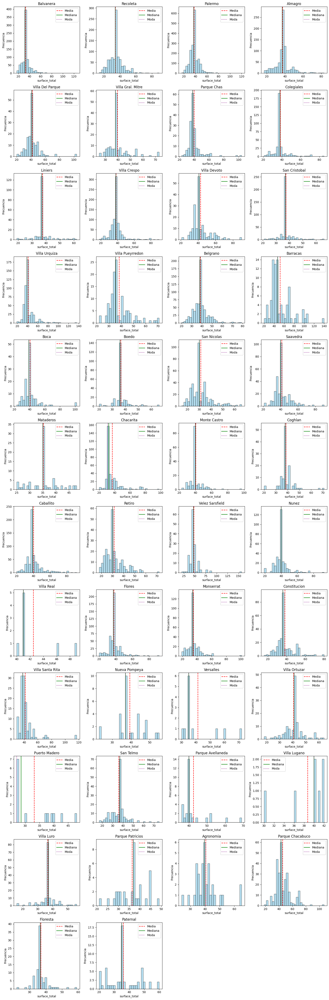

In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

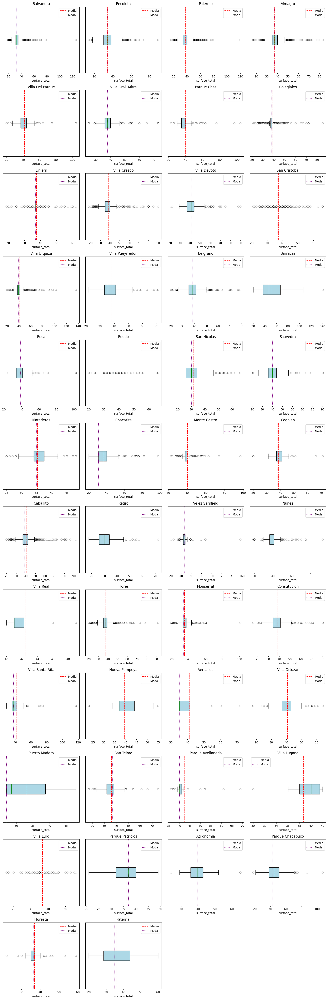

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

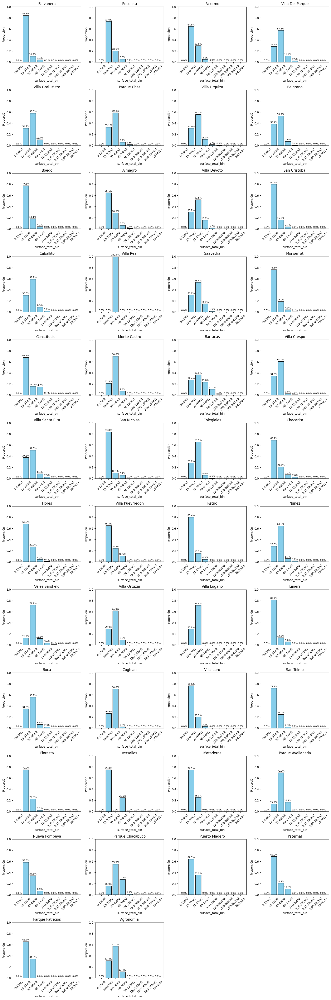

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.5) Superficie Cubierta

In [ ]:
col_obj = 'surface_covered'

bins_obj = 'surface_covered_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

surface_covered_bin,12-34m2,34-44m2,44-65m2
barrio,,,
Agronomia,40.0%,60.0%,0.0%
Almagro,67.1%,26.5%,6.4%
Balvanera,85.3%,11.9%,2.8%
Barracas,27.2%,46.9%,25.9%
Belgrano,62.9%,31.4%,5.7%
Boca,34.1%,56.1%,9.8%
Boedo,75.7%,20.2%,4.1%
Caballito,64.7%,27.3%,7.9%
Chacarita,72.9%,22.8%,4.3%


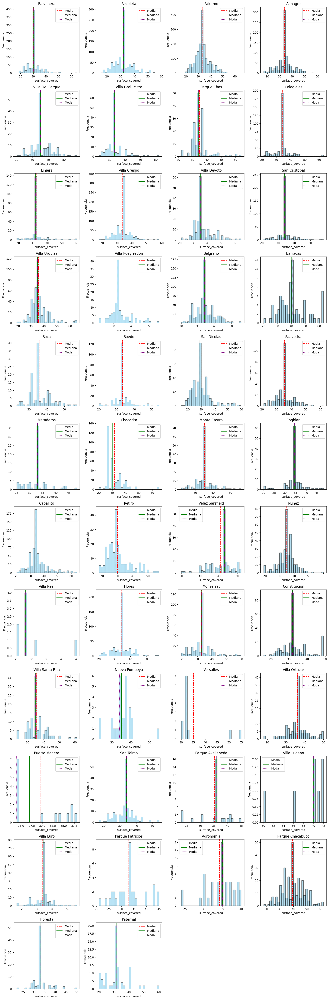

In [ ]:
#Hitograma por barrio-----------------------------------------------------------
# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

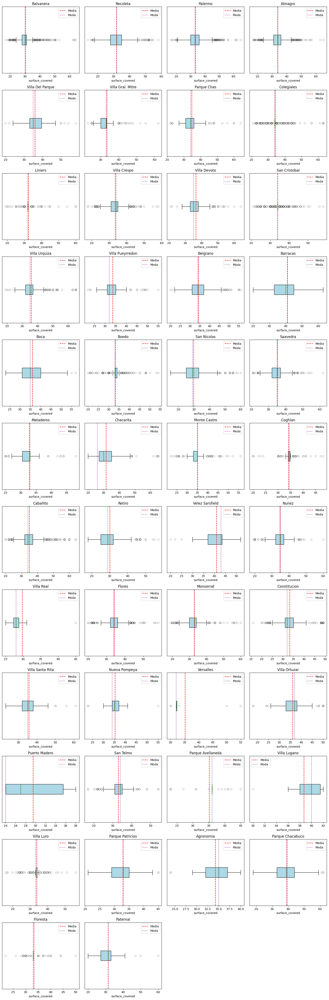

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

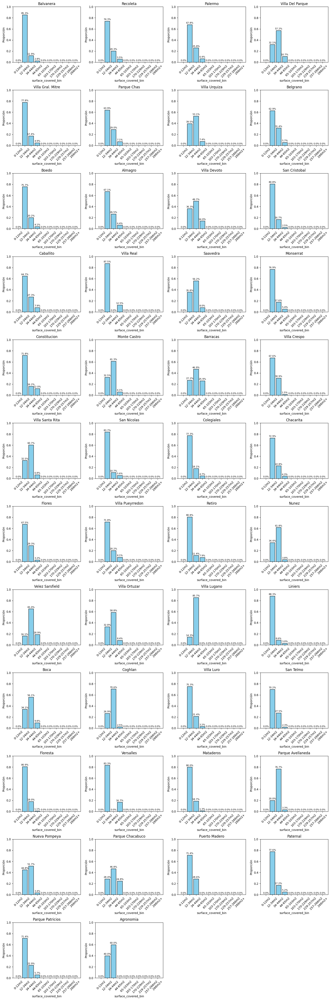

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

#### Filtro rooms = 1

In [ ]:
df_ent = df_ent.loc[mask & (df_ent['price_bin'].isin(['0-100k','100-200k']))]
print(f'Los posibles outliers suman {len(outliers)}')
from IPython.display import display, HTML
pd.options.display.float_format = '{:,.2f}'.format
display(HTML(outliers.to_html(index=False)))


In [ ]:
outliers_2 = df_ent.loc[mask & (df_ent['price']<42000),['title','description','price','pm2','surface_total']]

print(f'Los posibles outliers suman {len(outliers_2)}')

Los posibles outliers suman 0


In [ ]:
outliers_3 = df_ent.loc[mask & (df_ent['price_bin'].isin(['0-100k','100-200k'])),['title','description','barrio','price','pm2','surface_total','surface_covered','bedrooms','surface_descubierta']].sort_values('surface_descubierta',ascending=False)

print(f'Los posibles outliers suman {len(outliers_3)}')

pd.options.display.float_format = '{:,.2f}'.format
display(HTML(outliers_3.to_html(index=False)))



In [ ]:
outliers_4 = df_ent.loc[mask & (df_ent['surface_covered_bin'].isin(['65-103m2', '103-170m2'])),['title','description','barrio','price','pm2','surface_total','surface_covered','bedrooms','surface_descubierta']].sort_values('surface_descubierta',ascending=False)

print(f'Los posibles outliers suman {len(outliers_4)}')

pd.options.display.float_format = '{:,.2f}'.format
display(HTML(outliers_4.to_html(index=False)))



In [ ]:
outliers_5 = df_ent.loc[mask & (df_ent['surface_covered']>45),['title','description','barrio','price','pm2','surface_total','surface_covered','bedrooms','bathrooms']].sort_values('bedrooms',ascending=False)

print(f'Los posibles outliers suman {len(outliers_5)}')

pd.options.display.float_format = '{:,.2f}'.format
display(HTML(outliers_5.to_html(index=False)))

Los posibles outliers suman 667


title,description,barrio,price,pm2,surface_total,surface_covered,bedrooms,bathrooms
Hermoso 3 Ambientes Al Frente con Balcn Corrido! a m Av de,"Hermoso 3 ambientes reciclado, con balcn corrido al frente.<br>Living comedor con cocina integrada. Lavadero incorporado.<br>Amplio balcn de 8m2. Super luminoso!<br>Dormitorios con placard e interiores.<br>Pisos de madera natural.<br>Superficie total 57 m2<br>Excelente zona: a 100 mts Av. Congreso y 300m Av. del Libertador. A pocas cuadras del ferrocarril Est. Nuez y subte D Congreso de Tucumn. .Publicado por Plus Develop a traves INMOMAP",Nunez,"179,000.00","3,140.35",57.00,49.00,2.00,1.00
Departamento - Belgrano - Tres ambientes en Gran Oportunidad de Inversion!,"<br>LIBRE YA! lo maneja Agus<br><br>Belgrano, 3 amb, 55m, Juramento 2800, <br><br>Descripción:<br><br>Situado a cuatro cuadras de Av. Cabildo donde pasa el metro bus y línea de subte D.<br><br>Tres ambientes muy luminosos y con buena distribución. Living comedor de buenas medias, dos dormitorios con mucho placard y entrada de luz. Baño con ducha refaccionado.<br>Cocina espaciosa con horno a gas.<br><br><br>Expensas: (noviembre 2019)<br><br>",Belgrano,"180,000.00","3,272.73",55.00,55.00,2.00,1.00
Excelente Departamento en Palermo,"Enorme monoambiente de 56 mts ubicado en la frontera entre palermo, recoleta y almagro, a una cuadra de la Universidad de Palermo, en este momento ha sido dividido con paredes de durlock acústico para convertirlo en dos habitaciones que están siendo alquiladas temporalmente. se encuentra en piso 11, es super luminoso y al estar en el último pisos no hay vecinos tras la medianera ni arriba, se tienen solo un vecino de lado derecho. Con balcón a la calle y baño completo. Cocina independiente con lavadero separado. Baulera propia en el sótano de 2 x 2 mts.Av Córdoba entre Mario Bravo y Billinghurst. a 1 cuadra de la Universidad de Palermo. Cercanía con el Subte C, Estación Carlos Gardel y Subte D, Estación Bulnes.Todas las propiedades que figuran en mi perfil se encuentran a cargo del profesional matriculado de la oficina, la intermediación y la conclusión de las operaciones serán llevadas exclusivamente por él. Matrícula N° 7437 CUCICBA",Almagro,"140,000.00","2,500.00",56.00,53.00,2.00,1.00
Simbron 4600 100 - - Departamento en Venta,"Excelentes unidades en Villa Devoto: Simbron y Allende Emprendimiento ya terminado con posesión.Venta Departamentos 1, 2 ,3 y 4 ambientes Cocheras y Bauleras50 unidades totales, distribuidas en 4 plantas• 8 unidades con terraza propia y parrilla• Instalaciones de primer nivel• 2 cuerpos de ascensores• Cocheras fijas (opcional )• Bauleras (opcional)• 2 Salón de usos múltiples (SUM) equipados• Piscina, Solárium• Parrillas en terraza• Salón Fitness con equipos de última generación• Laundry• Grupo Electrógeno- Accesos y ascensores codificados-SEGURIDAD 24 HSMATERIALES E INSTALACIONESCarpintería de Aluminio A30 con vidrios laminadosPisos de Porcelanato simil madera PAMESA (español)Modernos Cielorrasos de hormigón vistosInstalaciones para Split frío/calor previstasGriferías mono-comando. Cocina Atma Campana SparSistemas de seguridad.Unidades a la Venta 2 amb frente : Living comedor con cocina integrada. Dormitorio con ventana al exterior Baño completo. Muy luminoso Exc terminaciones Amenities SUM Laundry Gym Pileta Solárium Seguridad Grupo Electrógeno Opción Cochera Baulera Exc Ubicación.3 amb: Balcón a Pulmón con vegetación. Amplio Living Comedor con cocina integrada 2 Dormitorios Baño completo Exc terminaciones Amenities SUM Laundry Gym Pileta Solárium Seguridad Grupo Electrógeno Opción Cochera Baulera Exc UbicaciónMonoambiente: divisible luminoso Cocina Baño completo Exc terminaciones Amenities SUM Laundry Gym Pileta Solárium Seguridad Grupo Electrógeno Opción Cochera Baulera Exc Ubicación3 amb: Lateral Gran Living Comedor Cocina integrada 2 Dormitorios con placard con interiores Baño completo y Toilette Exc terminaciones Amenities SUM Laundry Gym Pileta Solárium Seguridad G

In [ ]:
filtro_eliminar = (
    (df_ent['property_type'] == 'Departamento') &
    (df_ent['rooms'] == 1) &
    (
        ~df_ent['price_bin'].isin(['0-100k', '100-200k']) |
        (df_ent['price'] < 42000)
    )
)

df_ent = df_ent[~filtro_eliminar]


In [ ]:
filtro_eliminar_2 = (
    (df_ent['property_type'] == 'Departamento') &
    (df_ent['rooms'] == 1) &
    (
        df_ent['pm2_bin'] =='0-1k'
    )
)

df_ent = df_ent[~filtro_eliminar_2]


In [ ]:
filtro_eliminar_3 = (
    (df_ent['property_type'] == 'Departamento') &
    (df_ent['rooms'] == 1) &
    (
        df_ent['surface_covered_bin'].isin(['65-103m2', '103-170m2'])
    )
)

df_ent = df_ent[~filtro_eliminar_3]

### rooms = 2

#### a.1) Análisis General

In [ ]:
property_type = 'Departamento'

rooms = 2

mask = (df_ent['property_type']==property_type) & (df_ent['rooms']==rooms)

columnas = ['price', 'pm2','surface_total', 'surface_covered', 'rooms', 'bedrooms','bathrooms']

df_subset = df_ent.loc[mask, columnas]

percentiles = [
    0.00, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09,
    0.10, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19,
    0.20, 0.25, 0.30, 0.35, 0.40,0.45, 0.50,  0.55, 0.60, 0.65, 0.70, 0.75,
    0.80, 0.85,
    0.90, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99,
    1.00
]


estadisticas = df_subset.describe(percentiles).T

modas = df_subset.mode().iloc[0]
estadisticas['mode'] = modas

valores = [
'count', 'mean', 'std', 'mode', 'max', 'min', '1%', '2%', '3%', '4%', '5%', '6%', '7%', '8%', '9%',
    '10%', '11%', '12%', '13%', '14%', '15%', '16%', '17%', '18%', '19%',
    '20%',  '25%', '30%',  '35%', '40%',  '45%', '50%', '55%', '60%',  '65%',
    '70%', '75%', '80%',  '85%', '90%', '91%', '92%', '93%', '94%', '95%', '96%', '97%', '98%', '99%',
    '100%'
]
estadisticas = estadisticas[valores]

estadisticas_vertical = estadisticas.T

import pandas.io.formats.style
estadisticas_vertical.style.format('{:,.2f}')

,price,pm2,surface_total,surface_covered,rooms,bedrooms,bathrooms
count,"16,292.00","16,292.00","16,292.00","16,292.00","16,292.00","16,292.00","16,292.00"
mean,"136,280.56","2,787.64",48.72,43.46,2.00,1.02,1.08
std,"55,061.69",883.20,10.40,6.98,0.00,0.13,0.28
mode,"115,000.00","2,500.00",50.00,45.00,2.00,1.00,1.00
max,"440,000.00","9,800.00",189.00,74.00,2.00,4.00,4.00
min,"59,900.00",529.10,20.00,20.00,2.00,0.00,1.00
1%,"65,000.00","1,393.02",30.00,30.00,2.00,1.00,1.00
2%,"68,000.00","1,490.20",32.00,30.00,2.00,1.00,1.00
3%,"69,900.00","1,558.14",33.00,32.00,2.00,1.00,1.00
4%,"72,000.00","1,605.87",34.00,32.00,2.00,1.00,1.00


#### a.2) Price

In [ ]:
col_obj = 'price'

bins_obj = 'price_bin'

In [ ]:
#Matriz de doble entrada por barrio-------------------------------------------------
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

price_bin,0-100k,100-200k,200-300k,300-500k,500k-1M,1M+
barrio,,,,,,
Agronomia,36.4%,63.6%,0.0%,0.0%,0.0%,0.0%
Almagro,36.3%,62.0%,1.7%,0.0%,0.0%,0.0%
Balvanera,74.7%,25.2%,0.1%,0.0%,0.0%,0.0%
Barracas,34.3%,60.6%,5.1%,0.0%,0.0%,0.0%
Belgrano,10.7%,64.0%,21.1%,3.8%,0.2%,0.1%
Boca,67.6%,28.2%,4.2%,0.0%,0.0%,0.0%
Boedo,45.3%,54.2%,0.5%,0.0%,0.0%,0.0%
Caballito,29.1%,68.6%,2.4%,0.0%,0.0%,0.0%
Chacarita,21.5%,76.3%,2.2%,0.0%,0.0%,0.0%


In [ ]:
#Histograma por barrio------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


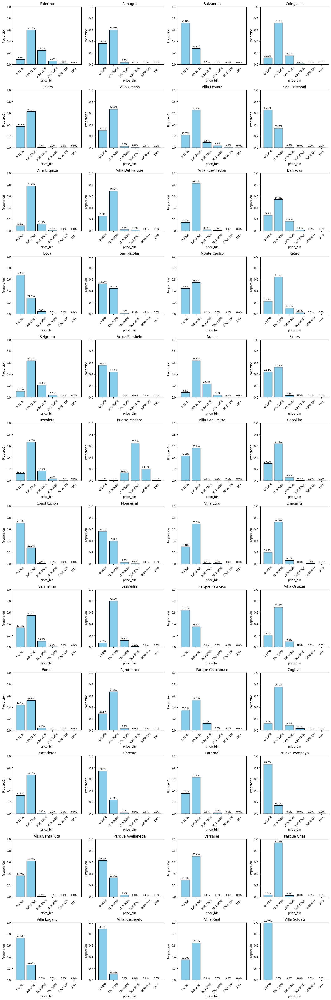

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.3) pm2

In [ ]:
col_obj = 'pm2'

bins_obj = 'pm2_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


#### a.4) Superficie Total

In [ ]:
col_obj = 'surface_total'

bins_obj = 'surface_total_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

surface_total_bin,0-13m2,13-37m2,37-49m2,49-74m2,74-120m2,120-202m2,202-260m2,287m2+
barrio,,,,,,,,
Agronomia,0.0%,34.3%,54.3%,11.4%,0.0%,0.0%,0.0%,0.0%
Almagro,0.0%,63.6%,29.3%,6.6%,0.4%,0.0%,0.1%,0.0%
Balvanera,0.0%,82.0%,13.2%,4.5%,0.1%,0.1%,0.0%,0.0%
Barracas,0.0%,24.0%,34.4%,25.0%,15.6%,1.0%,0.0%,0.0%
Belgrano,0.0%,40.2%,48.5%,9.9%,1.1%,0.3%,0.0%,0.0%
Boca,0.0%,35.0%,50.3%,6.3%,4.2%,2.8%,1.4%,0.0%
Boedo,0.0%,77.0%,18.4%,4.1%,0.4%,0.0%,0.0%,0.0%
Caballito,0.0%,32.8%,55.8%,9.2%,2.1%,0.2%,0.0%,0.0%
Chacarita,0.0%,64.3%,23.0%,9.8%,2.8%,0.0%,0.0%,0.0%


In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.5) Superficie Cubierta

In [ ]:
col_obj = 'surface_covered'

bins_obj = 'surface_covered_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------
# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

#### a.6)Filtro

In [ ]:
filtro_eliminar_11 = (
    (df_ent['property_type'] == 'Departamento') &
    (df_ent['rooms'] == 2) &
    (
        (df_ent['price'] < 59900)
    )
)

df_ent = df_ent[~filtro_eliminar_11]

filtro_eliminar_12 = (
    (df_ent['property_type'] == 'Departamento') &
    (df_ent['rooms'] == 2) &
    (
        (df_ent['price'] > 440000)
    )
)

df_ent = df_ent[~filtro_eliminar_12]

filtro_eliminar_13 = (
    (df_ent['property_type'] == 'Departamento') &
    (df_ent['rooms'] == 2) &
    (
        (df_ent['surface_covered'] > 74)
    )
)

df_ent = df_ent[~filtro_eliminar_13]

### rooms = 3

#### a.1) Análisis General

In [ ]:
property_type = 'Departamento'

rooms = 3

mask = (df_ent['property_type']==property_type) & (df_ent['rooms']==rooms)

columnas = ['price', 'pm2','surface_total', 'surface_covered', 'rooms', 'bedrooms','bathrooms']

df_subset = df_ent.loc[mask, columnas]

percentiles = [
    0.00, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09,
    0.10, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19,
    0.20, 0.25, 0.30, 0.35, 0.40,0.45, 0.50,  0.55, 0.60, 0.65, 0.70, 0.75,
    0.80, 0.85,
    0.90, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99,
    1.00
]


estadisticas = df_subset.describe(percentiles).T

modas = df_subset.mode().iloc[0]
estadisticas['mode'] = modas

valores = [
'count', 'mean', 'std', 'mode', 'max', 'min', '1%', '2%', '3%', '4%', '5%', '6%', '7%', '8%', '9%',
    '10%', '11%', '12%', '13%', '14%', '15%', '16%', '17%', '18%', '19%',
    '20%',  '25%', '30%',  '35%', '40%',  '45%', '50%', '55%', '60%',  '65%',
    '70%', '75%', '80%',  '85%', '90%', '91%', '92%', '93%', '94%', '95%', '96%', '97%', '98%', '99%',
    '100%'
]
estadisticas = estadisticas[valores]

estadisticas_vertical = estadisticas.T

import pandas.io.formats.style
estadisticas_vertical.style.format('{:,.2f}')

,price,pm2,surface_total,surface_covered,rooms,bedrooms,bathrooms
count,"16,038.00","16,038.00","16,038.00","16,038.00","16,038.00","16,038.00","16,038.00"
mean,"226,012.18","2,841.69",76.40,68.78,3.00,2.00,1.42
std,"149,111.82","1,075.94",23.27,19.66,0.00,0.18,0.60
mode,"135,000.00","2,500.00",68.00,62.00,3.00,2.00,1.00
max,"1,800,000.00","10,000.00",430.00,294.00,3.00,4.00,5.00
min,"22,000.00",525.00,15.00,15.00,3.00,0.00,1.00
1%,"69,185.00","1,140.00",45.00,43.00,3.00,1.00,1.00
2%,"80,000.00","1,283.73",48.00,45.00,3.00,2.00,1.00
3%,"88,000.00","1,388.89",50.00,47.00,3.00,2.00,1.00
4%,"92,000.00","1,465.43",50.00,48.00,3.00,2.00,1.00


#### a.2) Price

In [ ]:
col_obj = 'price'

bins_obj = 'price_bin'

In [ ]:
#Matriz de doble entrada por barrio-------------------------------------------------
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Histograma por barrio------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


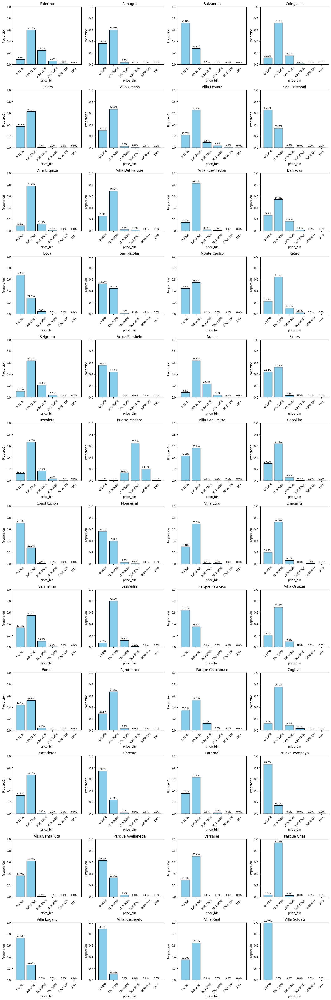

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.3) pm2

In [ ]:
col_obj = 'pm2'

bins_obj = 'pm2_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


#### a.4) Superficie Total

In [ ]:
col_obj = 'surface_total'

bins_obj = 'surface_total_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

surface_total_bin,0-13m2,13-37m2,37-49m2,49-74m2,74-120m2,120-202m2,202-260m2,287m2+
barrio,,,,,,,,
Agronomia,0.0%,34.3%,54.3%,11.4%,0.0%,0.0%,0.0%,0.0%
Almagro,0.0%,63.6%,29.3%,6.6%,0.4%,0.0%,0.1%,0.0%
Balvanera,0.0%,82.0%,13.2%,4.5%,0.1%,0.1%,0.0%,0.0%
Barracas,0.0%,24.0%,34.4%,25.0%,15.6%,1.0%,0.0%,0.0%
Belgrano,0.0%,40.2%,48.5%,9.9%,1.1%,0.3%,0.0%,0.0%
Boca,0.0%,35.0%,50.3%,6.3%,4.2%,2.8%,1.4%,0.0%
Boedo,0.0%,77.0%,18.4%,4.1%,0.4%,0.0%,0.0%,0.0%
Caballito,0.0%,32.8%,55.8%,9.2%,2.1%,0.2%,0.0%,0.0%
Chacarita,0.0%,64.3%,23.0%,9.8%,2.8%,0.0%,0.0%,0.0%


In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.5) Superficie Cubierta

In [ ]:
col_obj = 'surface_covered'

bins_obj = 'surface_covered_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------
# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

### rooms = 4

#### a.1) Análisis General

In [ ]:
property_type = 'Departamento'

rooms = 4

mask = (df_ent['property_type']==property_type) & (df_ent['rooms']==rooms)

columnas = ['price', 'pm2','surface_total', 'surface_covered', 'rooms', 'bedrooms','bathrooms']

df_subset = df_ent.loc[mask, columnas]

percentiles = [
    0.00, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09,
    0.10, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19,
    0.20, 0.25, 0.30, 0.35, 0.40,0.45, 0.50,  0.55, 0.60, 0.65, 0.70, 0.75,
    0.80, 0.85,
    0.90, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99,
    1.00
]


estadisticas = df_subset.describe(percentiles).T

modas = df_subset.mode().iloc[0]
estadisticas['mode'] = modas

valores = [
'count', 'mean', 'std', 'mode', 'max', 'min', '1%', '2%', '3%', '4%', '5%', '6%', '7%', '8%', '9%',
    '10%', '11%', '12%', '13%', '14%', '15%', '16%', '17%', '18%', '19%',
    '20%',  '25%', '30%',  '35%', '40%',  '45%', '50%', '55%', '60%',  '65%',
    '70%', '75%', '80%',  '85%', '90%', '91%', '92%', '93%', '94%', '95%', '96%', '97%', '98%', '99%',
    '100%'
]
estadisticas = estadisticas[valores]

estadisticas_vertical = estadisticas.T

import pandas.io.formats.style
estadisticas_vertical.style.format('{:,.2f}')

#### a.2) Price

In [ ]:
col_obj = 'price'

bins_obj = 'price_bin'

In [ ]:
#Matriz de doble entrada por barrio-------------------------------------------------
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Histograma por barrio------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


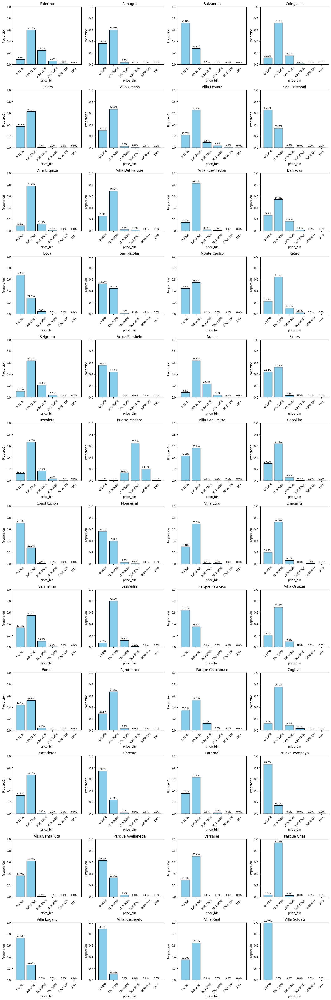

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.3) pm2

In [ ]:
col_obj = 'pm2'

bins_obj = 'pm2_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


#### a.4) Superficie Total

In [ ]:
col_obj = 'surface_total'

bins_obj = 'surface_total_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

surface_total_bin,0-13m2,13-37m2,37-49m2,49-74m2,74-120m2,120-202m2,202-260m2,287m2+
barrio,,,,,,,,
Agronomia,0.0%,34.3%,54.3%,11.4%,0.0%,0.0%,0.0%,0.0%
Almagro,0.0%,63.6%,29.3%,6.6%,0.4%,0.0%,0.1%,0.0%
Balvanera,0.0%,82.0%,13.2%,4.5%,0.1%,0.1%,0.0%,0.0%
Barracas,0.0%,24.0%,34.4%,25.0%,15.6%,1.0%,0.0%,0.0%
Belgrano,0.0%,40.2%,48.5%,9.9%,1.1%,0.3%,0.0%,0.0%
Boca,0.0%,35.0%,50.3%,6.3%,4.2%,2.8%,1.4%,0.0%
Boedo,0.0%,77.0%,18.4%,4.1%,0.4%,0.0%,0.0%,0.0%
Caballito,0.0%,32.8%,55.8%,9.2%,2.1%,0.2%,0.0%,0.0%
Chacarita,0.0%,64.3%,23.0%,9.8%,2.8%,0.0%,0.0%,0.0%


In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.5) Superficie Cubierta

In [ ]:
col_obj = 'surface_covered'

bins_obj = 'surface_covered_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------
# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

### rooms = 5

#### a.1) Análisis General

In [ ]:
property_type = 'Departamento'

rooms = 5

mask = (df_ent['property_type']==property_type) & (df_ent['rooms']==rooms)

columnas = ['price', 'pm2','surface_total', 'surface_covered', 'rooms', 'bedrooms','bathrooms']

df_subset = df_ent.loc[mask, columnas]

percentiles = [
    0.00, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09,
    0.10, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19,
    0.20, 0.25, 0.30, 0.35, 0.40,0.45, 0.50,  0.55, 0.60, 0.65, 0.70, 0.75,
    0.80, 0.85,
    0.90, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99,
    1.00
]


estadisticas = df_subset.describe(percentiles).T

modas = df_subset.mode().iloc[0]
estadisticas['mode'] = modas

valores = [
'count', 'mean', 'std', 'mode', 'max', 'min', '1%', '2%', '3%', '4%', '5%', '6%', '7%', '8%', '9%',
    '10%', '11%', '12%', '13%', '14%', '15%', '16%', '17%', '18%', '19%',
    '20%',  '25%', '30%',  '35%', '40%',  '45%', '50%', '55%', '60%',  '65%',
    '70%', '75%', '80%',  '85%', '90%', '91%', '92%', '93%', '94%', '95%', '96%', '97%', '98%', '99%',
    '100%'
]
estadisticas = estadisticas[valores]

estadisticas_vertical = estadisticas.T

import pandas.io.formats.style
estadisticas_vertical.style.format('{:,.2f}')

#### a.2) Price

In [ ]:
col_obj = 'price'

bins_obj = 'price_bin'

In [ ]:
#Matriz de doble entrada por barrio-------------------------------------------------
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Histograma por barrio------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


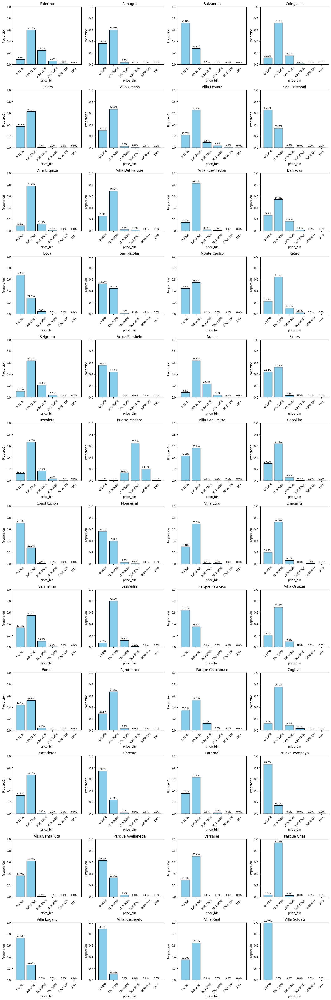

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.3) pm2

In [ ]:
col_obj = 'pm2'

bins_obj = 'pm2_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


#### a.4) Superficie Total

In [ ]:
col_obj = 'surface_total'

bins_obj = 'surface_total_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

surface_total_bin,0-13m2,13-37m2,37-49m2,49-74m2,74-120m2,120-202m2,202-260m2,287m2+
barrio,,,,,,,,
Agronomia,0.0%,34.3%,54.3%,11.4%,0.0%,0.0%,0.0%,0.0%
Almagro,0.0%,63.6%,29.3%,6.6%,0.4%,0.0%,0.1%,0.0%
Balvanera,0.0%,82.0%,13.2%,4.5%,0.1%,0.1%,0.0%,0.0%
Barracas,0.0%,24.0%,34.4%,25.0%,15.6%,1.0%,0.0%,0.0%
Belgrano,0.0%,40.2%,48.5%,9.9%,1.1%,0.3%,0.0%,0.0%
Boca,0.0%,35.0%,50.3%,6.3%,4.2%,2.8%,1.4%,0.0%
Boedo,0.0%,77.0%,18.4%,4.1%,0.4%,0.0%,0.0%,0.0%
Caballito,0.0%,32.8%,55.8%,9.2%,2.1%,0.2%,0.0%,0.0%
Chacarita,0.0%,64.3%,23.0%,9.8%,2.8%,0.0%,0.0%,0.0%


In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.5) Superficie Cubierta

In [ ]:
col_obj = 'surface_covered'

bins_obj = 'surface_covered_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------
# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

### rooms = 6

#### a.1) Análisis General

In [ ]:
property_type = 'Departamento'

rooms = 6

mask = (df_ent['property_type']==property_type) & (df_ent['rooms']==rooms)

columnas = ['price', 'pm2','surface_total', 'surface_covered', 'rooms', 'bedrooms','bathrooms']

df_subset = df_ent.loc[mask, columnas]

percentiles = [
    0.00, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09,
    0.10, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19,
    0.20, 0.25, 0.30, 0.35, 0.40,0.45, 0.50,  0.55, 0.60, 0.65, 0.70, 0.75,
    0.80, 0.85,
    0.90, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99,
    1.00
]


estadisticas = df_subset.describe(percentiles).T

modas = df_subset.mode().iloc[0]
estadisticas['mode'] = modas

valores = [
'count', 'mean', 'std', 'mode', 'max', 'min', '1%', '2%', '3%', '4%', '5%', '6%', '7%', '8%', '9%',
    '10%', '11%', '12%', '13%', '14%', '15%', '16%', '17%', '18%', '19%',
    '20%',  '25%', '30%',  '35%', '40%',  '45%', '50%', '55%', '60%',  '65%',
    '70%', '75%', '80%',  '85%', '90%', '91%', '92%', '93%', '94%', '95%', '96%', '97%', '98%', '99%',
    '100%'
]
estadisticas = estadisticas[valores]

estadisticas_vertical = estadisticas.T

import pandas.io.formats.style
estadisticas_vertical.style.format('{:,.2f}')

#### a.2) Price

In [ ]:
col_obj = 'price'

bins_obj = 'price_bin'

In [ ]:
#Matriz de doble entrada por barrio-------------------------------------------------
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Histograma por barrio------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


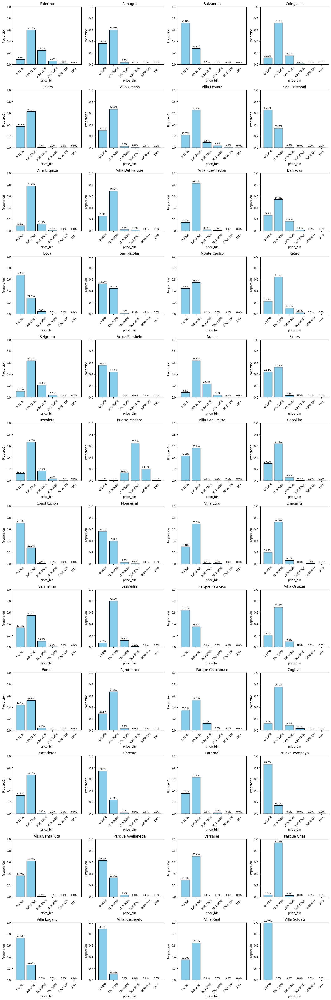

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.3) pm2

In [ ]:
col_obj = 'pm2'

bins_obj = 'pm2_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


#### a.4) Superficie Total

In [ ]:
col_obj = 'surface_total'

bins_obj = 'surface_total_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

surface_total_bin,0-13m2,13-37m2,37-49m2,49-74m2,74-120m2,120-202m2,202-260m2,287m2+
barrio,,,,,,,,
Agronomia,0.0%,34.3%,54.3%,11.4%,0.0%,0.0%,0.0%,0.0%
Almagro,0.0%,63.6%,29.3%,6.6%,0.4%,0.0%,0.1%,0.0%
Balvanera,0.0%,82.0%,13.2%,4.5%,0.1%,0.1%,0.0%,0.0%
Barracas,0.0%,24.0%,34.4%,25.0%,15.6%,1.0%,0.0%,0.0%
Belgrano,0.0%,40.2%,48.5%,9.9%,1.1%,0.3%,0.0%,0.0%
Boca,0.0%,35.0%,50.3%,6.3%,4.2%,2.8%,1.4%,0.0%
Boedo,0.0%,77.0%,18.4%,4.1%,0.4%,0.0%,0.0%,0.0%
Caballito,0.0%,32.8%,55.8%,9.2%,2.1%,0.2%,0.0%,0.0%
Chacarita,0.0%,64.3%,23.0%,9.8%,2.8%,0.0%,0.0%,0.0%


In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.5) Superficie Cubierta

In [ ]:
col_obj = 'surface_covered'

bins_obj = 'surface_covered_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------
# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

### rooms = 7

#### a.1) Análisis General

In [ ]:
property_type = 'Departamento'

rooms = 7

mask = (df_ent['property_type']==property_type) & (df_ent['rooms']==rooms)

columnas = ['price', 'pm2','surface_total', 'surface_covered', 'rooms', 'bedrooms','bathrooms']

df_subset = df_ent.loc[mask, columnas]

percentiles = [
    0.00, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09,
    0.10, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19,
    0.20, 0.25, 0.30, 0.35, 0.40,0.45, 0.50,  0.55, 0.60, 0.65, 0.70, 0.75,
    0.80, 0.85,
    0.90, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99,
    1.00
]


estadisticas = df_subset.describe(percentiles).T

modas = df_subset.mode().iloc[0]
estadisticas['mode'] = modas

valores = [
'count', 'mean', 'std', 'mode', 'max', 'min', '1%', '2%', '3%', '4%', '5%', '6%', '7%', '8%', '9%',
    '10%', '11%', '12%', '13%', '14%', '15%', '16%', '17%', '18%', '19%',
    '20%',  '25%', '30%',  '35%', '40%',  '45%', '50%', '55%', '60%',  '65%',
    '70%', '75%', '80%',  '85%', '90%', '91%', '92%', '93%', '94%', '95%', '96%', '97%', '98%', '99%',
    '100%'
]
estadisticas = estadisticas[valores]

estadisticas_vertical = estadisticas.T

import pandas.io.formats.style
estadisticas_vertical.style.format('{:,.2f}')

#### a.2) Price

In [ ]:
col_obj = 'price'

bins_obj = 'price_bin'

In [ ]:
#Matriz de doble entrada por barrio-------------------------------------------------
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Histograma por barrio------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


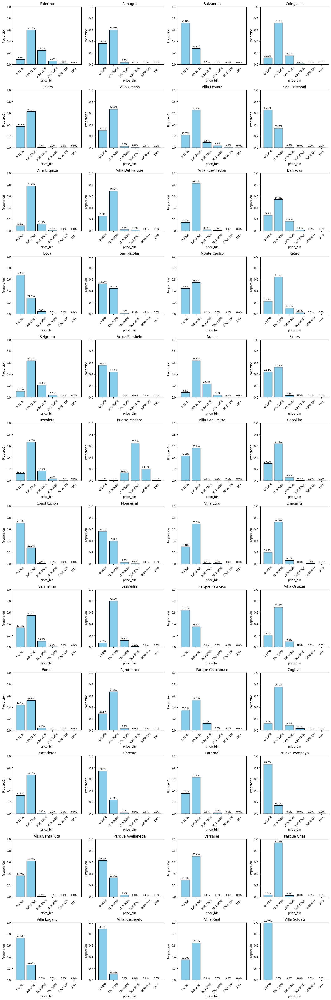

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.3) pm2

In [ ]:
col_obj = 'pm2'

bins_obj = 'pm2_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


#### a.4) Superficie Total

In [ ]:
col_obj = 'surface_total'

bins_obj = 'surface_total_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

surface_total_bin,0-13m2,13-37m2,37-49m2,49-74m2,74-120m2,120-202m2,202-260m2,287m2+
barrio,,,,,,,,
Agronomia,0.0%,34.3%,54.3%,11.4%,0.0%,0.0%,0.0%,0.0%
Almagro,0.0%,63.6%,29.3%,6.6%,0.4%,0.0%,0.1%,0.0%
Balvanera,0.0%,82.0%,13.2%,4.5%,0.1%,0.1%,0.0%,0.0%
Barracas,0.0%,24.0%,34.4%,25.0%,15.6%,1.0%,0.0%,0.0%
Belgrano,0.0%,40.2%,48.5%,9.9%,1.1%,0.3%,0.0%,0.0%
Boca,0.0%,35.0%,50.3%,6.3%,4.2%,2.8%,1.4%,0.0%
Boedo,0.0%,77.0%,18.4%,4.1%,0.4%,0.0%,0.0%,0.0%
Caballito,0.0%,32.8%,55.8%,9.2%,2.1%,0.2%,0.0%,0.0%
Chacarita,0.0%,64.3%,23.0%,9.8%,2.8%,0.0%,0.0%,0.0%


In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.5) Superficie Cubierta

In [ ]:
col_obj = 'surface_covered'

bins_obj = 'surface_covered_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------
# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

### rooms = 8

#### a.1) Análisis General

In [ ]:
property_type = 'Departamento'

rooms = 8

mask = (df_ent['property_type']==property_type) & (df_ent['rooms']==rooms)

columnas = ['price', 'pm2','surface_total', 'surface_covered', 'rooms', 'bedrooms','bathrooms']

df_subset = df_ent.loc[mask, columnas]

percentiles = [
    0.00, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09,
    0.10, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19,
    0.20, 0.25, 0.30, 0.35, 0.40,0.45, 0.50,  0.55, 0.60, 0.65, 0.70, 0.75,
    0.80, 0.85,
    0.90, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99,
    1.00
]


estadisticas = df_subset.describe(percentiles).T

modas = df_subset.mode().iloc[0]
estadisticas['mode'] = modas

valores = [
'count', 'mean', 'std', 'mode', 'max', 'min', '1%', '2%', '3%', '4%', '5%', '6%', '7%', '8%', '9%',
    '10%', '11%', '12%', '13%', '14%', '15%', '16%', '17%', '18%', '19%',
    '20%',  '25%', '30%',  '35%', '40%',  '45%', '50%', '55%', '60%',  '65%',
    '70%', '75%', '80%',  '85%', '90%', '91%', '92%', '93%', '94%', '95%', '96%', '97%', '98%', '99%',
    '100%'
]
estadisticas = estadisticas[valores]

estadisticas_vertical = estadisticas.T

import pandas.io.formats.style
estadisticas_vertical.style.format('{:,.2f}')

#### a.2) Price

In [ ]:
col_obj = 'price'

bins_obj = 'price_bin'

In [ ]:
#Matriz de doble entrada por barrio-------------------------------------------------
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Histograma por barrio------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


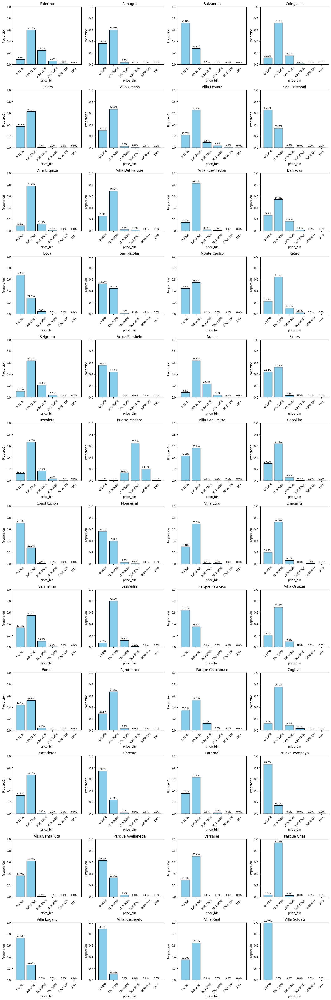

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.3) pm2

In [ ]:
col_obj = 'pm2'

bins_obj = 'pm2_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


#### a.4) Superficie Total

In [ ]:
col_obj = 'surface_total'

bins_obj = 'surface_total_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

surface_total_bin,0-13m2,13-37m2,37-49m2,49-74m2,74-120m2,120-202m2,202-260m2,287m2+
barrio,,,,,,,,
Agronomia,0.0%,34.3%,54.3%,11.4%,0.0%,0.0%,0.0%,0.0%
Almagro,0.0%,63.6%,29.3%,6.6%,0.4%,0.0%,0.1%,0.0%
Balvanera,0.0%,82.0%,13.2%,4.5%,0.1%,0.1%,0.0%,0.0%
Barracas,0.0%,24.0%,34.4%,25.0%,15.6%,1.0%,0.0%,0.0%
Belgrano,0.0%,40.2%,48.5%,9.9%,1.1%,0.3%,0.0%,0.0%
Boca,0.0%,35.0%,50.3%,6.3%,4.2%,2.8%,1.4%,0.0%
Boedo,0.0%,77.0%,18.4%,4.1%,0.4%,0.0%,0.0%,0.0%
Caballito,0.0%,32.8%,55.8%,9.2%,2.1%,0.2%,0.0%,0.0%
Chacarita,0.0%,64.3%,23.0%,9.8%,2.8%,0.0%,0.0%,0.0%


In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.5) Superficie Cubierta

In [ ]:
col_obj = 'surface_covered'

bins_obj = 'surface_covered_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------
# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

## 2. Casas

### Estadistica de Casas

In [ ]:
df_ent.loc[df_ent['property_type']=='Casa'].groupby('rooms')[['surface_total','surface_covered','surface_descubierta','bedrooms','bathrooms','price']].median()

,surface_total,surface_covered,surface_descubierta,bedrooms,bathrooms,price
rooms,,,,,,
2.0,100.00,75.0,20.0,1.0,1.0,180000.0
3.0,154.25,112.0,35.0,2.0,1.0,240000.0
4.0,204.50,150.0,44.0,3.0,2.0,320000.0
5.0,260.00,183.0,52.0,4.0,2.0,375000.0
6.0,304.00,240.0,60.0,4.0,3.0,460000.0
7.0,338.00,270.0,60.0,4.0,3.0,510000.0
8.0,345.50,257.0,52.0,4.0,3.0,568500.0


### rooms = 2

#### a.1) Análisis General

In [ ]:
property_type = 'Casa'

rooms = 2

mask = (df_ent['property_type']==property_type) & (df_ent['rooms']==rooms)

columnas = ['price', 'pm2','surface_total', 'surface_covered', 'rooms', 'bedrooms','bathrooms']

df_subset = df_ent.loc[mask, columnas]

percentiles = [
    0.00, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09,
    0.10, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19,
    0.20, 0.25, 0.30, 0.35, 0.40,0.45, 0.50,  0.55, 0.60, 0.65, 0.70, 0.75,
    0.80, 0.85,
    0.90, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99,
    1.00
]


estadisticas = df_subset.describe(percentiles).T

modas = df_subset.mode().iloc[0]
estadisticas['mode'] = modas

valores = [
'count', 'mean', 'std', 'mode', 'max', 'min', '1%', '2%', '3%', '4%', '5%', '6%', '7%', '8%', '9%',
    '10%', '11%', '12%', '13%', '14%', '15%', '16%', '17%', '18%', '19%',
    '20%',  '25%', '30%',  '35%', '40%',  '45%', '50%', '55%', '60%',  '65%',
    '70%', '75%', '80%',  '85%', '90%', '91%', '92%', '93%', '94%', '95%', '96%', '97%', '98%', '99%',
    '100%'
]
estadisticas = estadisticas[valores]

estadisticas_vertical = estadisticas.T

import pandas.io.formats.style
estadisticas_vertical.style.format('{:,.2f}')

#### a.2) Price

In [ ]:
col_obj = 'price'

bins_obj = 'price_bin'

In [ ]:
#Matriz de doble entrada por barrio-------------------------------------------------
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Histograma por barrio------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


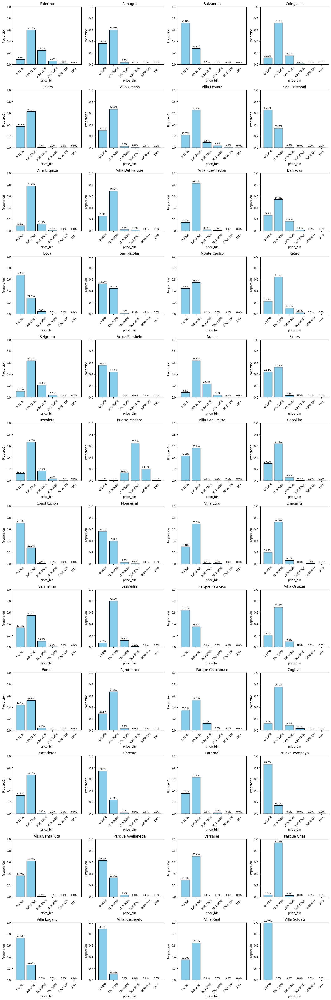

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.3) pm2

In [ ]:
col_obj = 'pm2'

bins_obj = 'pm2_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


#### a.4) Superficie Total

In [ ]:
col_obj = 'surface_total'

bins_obj = 'surface_total_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

surface_total_bin,0-13m2,13-37m2,37-49m2,49-74m2,74-120m2,120-202m2,202-260m2,287m2+
barrio,,,,,,,,
Agronomia,0.0%,34.3%,54.3%,11.4%,0.0%,0.0%,0.0%,0.0%
Almagro,0.0%,63.6%,29.3%,6.6%,0.4%,0.0%,0.1%,0.0%
Balvanera,0.0%,82.0%,13.2%,4.5%,0.1%,0.1%,0.0%,0.0%
Barracas,0.0%,24.0%,34.4%,25.0%,15.6%,1.0%,0.0%,0.0%
Belgrano,0.0%,40.2%,48.5%,9.9%,1.1%,0.3%,0.0%,0.0%
Boca,0.0%,35.0%,50.3%,6.3%,4.2%,2.8%,1.4%,0.0%
Boedo,0.0%,77.0%,18.4%,4.1%,0.4%,0.0%,0.0%,0.0%
Caballito,0.0%,32.8%,55.8%,9.2%,2.1%,0.2%,0.0%,0.0%
Chacarita,0.0%,64.3%,23.0%,9.8%,2.8%,0.0%,0.0%,0.0%


In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.5) Superficie Cubierta

In [ ]:
col_obj = 'surface_covered'

bins_obj = 'surface_covered_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------
# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

### rooms = 3

#### a.1) Análisis General

In [ ]:
property_type = 'Casa'

rooms = 3

mask = (df_ent['property_type']==property_type) & (df_ent['rooms']==rooms)

columnas = ['price', 'pm2','surface_total', 'surface_covered', 'rooms', 'bedrooms','bathrooms']

df_subset = df_ent.loc[mask, columnas]

percentiles = [
    0.00, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09,
    0.10, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19,
    0.20, 0.25, 0.30, 0.35, 0.40,0.45, 0.50,  0.55, 0.60, 0.65, 0.70, 0.75,
    0.80, 0.85,
    0.90, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99,
    1.00
]


estadisticas = df_subset.describe(percentiles).T

modas = df_subset.mode().iloc[0]
estadisticas['mode'] = modas

valores = [
'count', 'mean', 'std', 'mode', 'max', 'min', '1%', '2%', '3%', '4%', '5%', '6%', '7%', '8%', '9%',
    '10%', '11%', '12%', '13%', '14%', '15%', '16%', '17%', '18%', '19%',
    '20%',  '25%', '30%',  '35%', '40%',  '45%', '50%', '55%', '60%',  '65%',
    '70%', '75%', '80%',  '85%', '90%', '91%', '92%', '93%', '94%', '95%', '96%', '97%', '98%', '99%',
    '100%'
]
estadisticas = estadisticas[valores]

estadisticas_vertical = estadisticas.T

import pandas.io.formats.style
estadisticas_vertical.style.format('{:,.2f}')

#### a.2) Price

In [ ]:
col_obj = 'price'

bins_obj = 'price_bin'

In [ ]:
#Matriz de doble entrada por barrio-------------------------------------------------
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Histograma por barrio------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


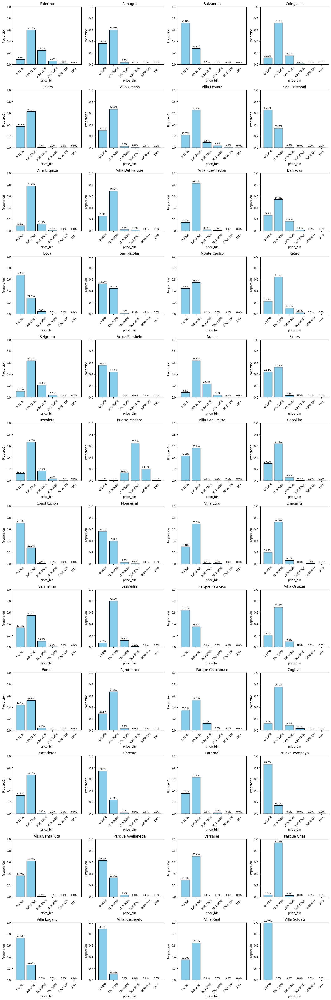

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.3) pm2

In [ ]:
col_obj = 'pm2'

bins_obj = 'pm2_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


#### a.4) Superficie Total

In [ ]:
col_obj = 'surface_total'

bins_obj = 'surface_total_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

surface_total_bin,0-13m2,13-37m2,37-49m2,49-74m2,74-120m2,120-202m2,202-260m2,287m2+
barrio,,,,,,,,
Agronomia,0.0%,34.3%,54.3%,11.4%,0.0%,0.0%,0.0%,0.0%
Almagro,0.0%,63.6%,29.3%,6.6%,0.4%,0.0%,0.1%,0.0%
Balvanera,0.0%,82.0%,13.2%,4.5%,0.1%,0.1%,0.0%,0.0%
Barracas,0.0%,24.0%,34.4%,25.0%,15.6%,1.0%,0.0%,0.0%
Belgrano,0.0%,40.2%,48.5%,9.9%,1.1%,0.3%,0.0%,0.0%
Boca,0.0%,35.0%,50.3%,6.3%,4.2%,2.8%,1.4%,0.0%
Boedo,0.0%,77.0%,18.4%,4.1%,0.4%,0.0%,0.0%,0.0%
Caballito,0.0%,32.8%,55.8%,9.2%,2.1%,0.2%,0.0%,0.0%
Chacarita,0.0%,64.3%,23.0%,9.8%,2.8%,0.0%,0.0%,0.0%


In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.5) Superficie Cubierta

In [ ]:
col_obj = 'surface_covered'

bins_obj = 'surface_covered_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------
# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

### rooms = 4

#### a.1) Análisis General

In [ ]:
property_type = 'Casa'

rooms = 4

mask = (df_ent['property_type']==property_type) & (df_ent['rooms']==rooms)

columnas = ['price', 'pm2','surface_total', 'surface_covered', 'rooms', 'bedrooms','bathrooms']

df_subset = df_ent.loc[mask, columnas]

percentiles = [
    0.00, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09,
    0.10, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19,
    0.20, 0.25, 0.30, 0.35, 0.40,0.45, 0.50,  0.55, 0.60, 0.65, 0.70, 0.75,
    0.80, 0.85,
    0.90, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99,
    1.00
]


estadisticas = df_subset.describe(percentiles).T

modas = df_subset.mode().iloc[0]
estadisticas['mode'] = modas

valores = [
'count', 'mean', 'std', 'mode', 'max', 'min', '1%', '2%', '3%', '4%', '5%', '6%', '7%', '8%', '9%',
    '10%', '11%', '12%', '13%', '14%', '15%', '16%', '17%', '18%', '19%',
    '20%',  '25%', '30%',  '35%', '40%',  '45%', '50%', '55%', '60%',  '65%',
    '70%', '75%', '80%',  '85%', '90%', '91%', '92%', '93%', '94%', '95%', '96%', '97%', '98%', '99%',
    '100%'
]
estadisticas = estadisticas[valores]

estadisticas_vertical = estadisticas.T

import pandas.io.formats.style
estadisticas_vertical.style.format('{:,.2f}')

#### a.2) Price

In [ ]:
col_obj = 'price'

bins_obj = 'price_bin'

In [ ]:
#Matriz de doble entrada por barrio-------------------------------------------------
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Histograma por barrio------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


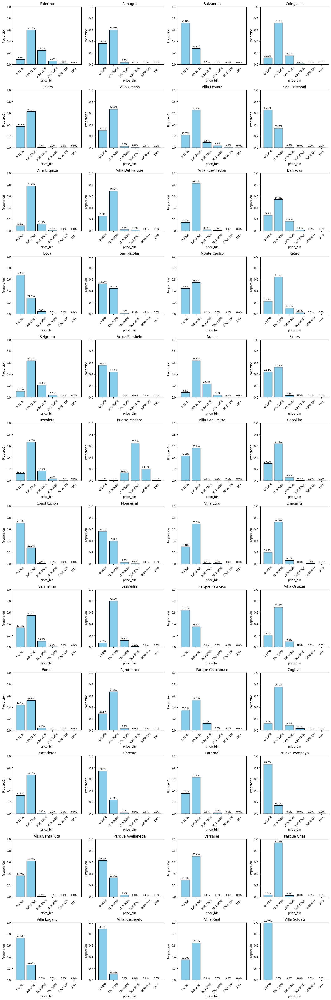

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.3) pm2

In [ ]:
col_obj = 'pm2'

bins_obj = 'pm2_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


#### a.4) Superficie Total

In [ ]:
col_obj = 'surface_total'

bins_obj = 'surface_total_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

surface_total_bin,0-13m2,13-37m2,37-49m2,49-74m2,74-120m2,120-202m2,202-260m2,287m2+
barrio,,,,,,,,
Agronomia,0.0%,34.3%,54.3%,11.4%,0.0%,0.0%,0.0%,0.0%
Almagro,0.0%,63.6%,29.3%,6.6%,0.4%,0.0%,0.1%,0.0%
Balvanera,0.0%,82.0%,13.2%,4.5%,0.1%,0.1%,0.0%,0.0%
Barracas,0.0%,24.0%,34.4%,25.0%,15.6%,1.0%,0.0%,0.0%
Belgrano,0.0%,40.2%,48.5%,9.9%,1.1%,0.3%,0.0%,0.0%
Boca,0.0%,35.0%,50.3%,6.3%,4.2%,2.8%,1.4%,0.0%
Boedo,0.0%,77.0%,18.4%,4.1%,0.4%,0.0%,0.0%,0.0%
Caballito,0.0%,32.8%,55.8%,9.2%,2.1%,0.2%,0.0%,0.0%
Chacarita,0.0%,64.3%,23.0%,9.8%,2.8%,0.0%,0.0%,0.0%


In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.5) Superficie Cubierta

In [ ]:
col_obj = 'surface_covered'

bins_obj = 'surface_covered_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------
# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

### rooms = 5

#### a.1) Análisis General

In [ ]:
property_type = 'Casa'

rooms = 5

mask = (df_ent['property_type']==property_type) & (df_ent['rooms']==rooms)

columnas = ['price', 'pm2','surface_total', 'surface_covered', 'rooms', 'bedrooms','bathrooms']

df_subset = df_ent.loc[mask, columnas]

percentiles = [
    0.00, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09,
    0.10, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19,
    0.20, 0.25, 0.30, 0.35, 0.40,0.45, 0.50,  0.55, 0.60, 0.65, 0.70, 0.75,
    0.80, 0.85,
    0.90, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99,
    1.00
]


estadisticas = df_subset.describe(percentiles).T

modas = df_subset.mode().iloc[0]
estadisticas['mode'] = modas

valores = [
'count', 'mean', 'std', 'mode', 'max', 'min', '1%', '2%', '3%', '4%', '5%', '6%', '7%', '8%', '9%',
    '10%', '11%', '12%', '13%', '14%', '15%', '16%', '17%', '18%', '19%',
    '20%',  '25%', '30%',  '35%', '40%',  '45%', '50%', '55%', '60%',  '65%',
    '70%', '75%', '80%',  '85%', '90%', '91%', '92%', '93%', '94%', '95%', '96%', '97%', '98%', '99%',
    '100%'
]
estadisticas = estadisticas[valores]

estadisticas_vertical = estadisticas.T

import pandas.io.formats.style
estadisticas_vertical.style.format('{:,.2f}')

#### a.2) Price

In [ ]:
col_obj = 'price'

bins_obj = 'price_bin'

In [ ]:
#Matriz de doble entrada por barrio-------------------------------------------------
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Histograma por barrio------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


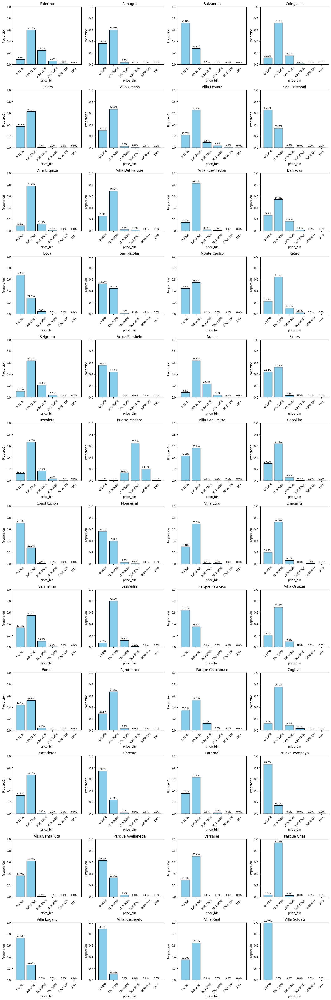

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.3) pm2

In [ ]:
col_obj = 'pm2'

bins_obj = 'pm2_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


#### a.4) Superficie Total

In [ ]:
col_obj = 'surface_total'

bins_obj = 'surface_total_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

surface_total_bin,0-13m2,13-37m2,37-49m2,49-74m2,74-120m2,120-202m2,202-260m2,287m2+
barrio,,,,,,,,
Agronomia,0.0%,34.3%,54.3%,11.4%,0.0%,0.0%,0.0%,0.0%
Almagro,0.0%,63.6%,29.3%,6.6%,0.4%,0.0%,0.1%,0.0%
Balvanera,0.0%,82.0%,13.2%,4.5%,0.1%,0.1%,0.0%,0.0%
Barracas,0.0%,24.0%,34.4%,25.0%,15.6%,1.0%,0.0%,0.0%
Belgrano,0.0%,40.2%,48.5%,9.9%,1.1%,0.3%,0.0%,0.0%
Boca,0.0%,35.0%,50.3%,6.3%,4.2%,2.8%,1.4%,0.0%
Boedo,0.0%,77.0%,18.4%,4.1%,0.4%,0.0%,0.0%,0.0%
Caballito,0.0%,32.8%,55.8%,9.2%,2.1%,0.2%,0.0%,0.0%
Chacarita,0.0%,64.3%,23.0%,9.8%,2.8%,0.0%,0.0%,0.0%


In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.5) Superficie Cubierta

In [ ]:
col_obj = 'surface_covered'

bins_obj = 'surface_covered_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------
# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

### rooms = 6

#### a.1) Análisis General

In [ ]:
property_type = 'Casa'

rooms = 6

mask = (df_ent['property_type']==property_type) & (df_ent['rooms']==rooms)

columnas = ['price', 'pm2','surface_total', 'surface_covered', 'rooms', 'bedrooms','bathrooms']

df_subset = df_ent.loc[mask, columnas]

percentiles = [
    0.00, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09,
    0.10, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19,
    0.20, 0.25, 0.30, 0.35, 0.40,0.45, 0.50,  0.55, 0.60, 0.65, 0.70, 0.75,
    0.80, 0.85,
    0.90, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99,
    1.00
]


estadisticas = df_subset.describe(percentiles).T

modas = df_subset.mode().iloc[0]
estadisticas['mode'] = modas

valores = [
'count', 'mean', 'std', 'mode', 'max', 'min', '1%', '2%', '3%', '4%', '5%', '6%', '7%', '8%', '9%',
    '10%', '11%', '12%', '13%', '14%', '15%', '16%', '17%', '18%', '19%',
    '20%',  '25%', '30%',  '35%', '40%',  '45%', '50%', '55%', '60%',  '65%',
    '70%', '75%', '80%',  '85%', '90%', '91%', '92%', '93%', '94%', '95%', '96%', '97%', '98%', '99%',
    '100%'
]
estadisticas = estadisticas[valores]

estadisticas_vertical = estadisticas.T

import pandas.io.formats.style
estadisticas_vertical.style.format('{:,.2f}')

#### a.2) Price

In [ ]:
col_obj = 'price'

bins_obj = 'price_bin'

In [ ]:
#Matriz de doble entrada por barrio-------------------------------------------------
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Histograma por barrio------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


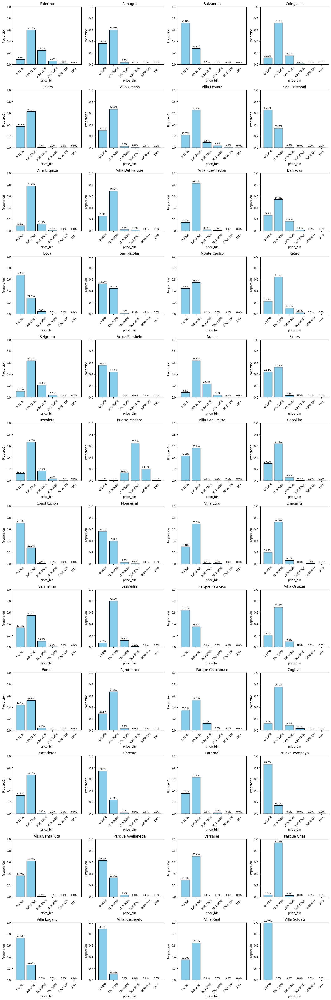

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.3) pm2

In [ ]:
col_obj = 'pm2'

bins_obj = 'pm2_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


#### a.4) Superficie Total

In [ ]:
col_obj = 'surface_total'

bins_obj = 'surface_total_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

surface_total_bin,0-13m2,13-37m2,37-49m2,49-74m2,74-120m2,120-202m2,202-260m2,287m2+
barrio,,,,,,,,
Agronomia,0.0%,34.3%,54.3%,11.4%,0.0%,0.0%,0.0%,0.0%
Almagro,0.0%,63.6%,29.3%,6.6%,0.4%,0.0%,0.1%,0.0%
Balvanera,0.0%,82.0%,13.2%,4.5%,0.1%,0.1%,0.0%,0.0%
Barracas,0.0%,24.0%,34.4%,25.0%,15.6%,1.0%,0.0%,0.0%
Belgrano,0.0%,40.2%,48.5%,9.9%,1.1%,0.3%,0.0%,0.0%
Boca,0.0%,35.0%,50.3%,6.3%,4.2%,2.8%,1.4%,0.0%
Boedo,0.0%,77.0%,18.4%,4.1%,0.4%,0.0%,0.0%,0.0%
Caballito,0.0%,32.8%,55.8%,9.2%,2.1%,0.2%,0.0%,0.0%
Chacarita,0.0%,64.3%,23.0%,9.8%,2.8%,0.0%,0.0%,0.0%


In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.5) Superficie Cubierta

In [ ]:
col_obj = 'surface_covered'

bins_obj = 'surface_covered_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------
# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

### rooms = 7

#### a.1) Análisis General

In [ ]:
property_type = 'Casa'

rooms = 7

mask = (df_ent['property_type']==property_type) & (df_ent['rooms']==rooms)

columnas = ['price', 'pm2','surface_total', 'surface_covered', 'rooms', 'bedrooms','bathrooms']

df_subset = df_ent.loc[mask, columnas]

percentiles = [
    0.00, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09,
    0.10, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19,
    0.20, 0.25, 0.30, 0.35, 0.40,0.45, 0.50,  0.55, 0.60, 0.65, 0.70, 0.75,
    0.80, 0.85,
    0.90, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99,
    1.00
]


estadisticas = df_subset.describe(percentiles).T

modas = df_subset.mode().iloc[0]
estadisticas['mode'] = modas

valores = [
'count', 'mean', 'std', 'mode', 'max', 'min', '1%', '2%', '3%', '4%', '5%', '6%', '7%', '8%', '9%',
    '10%', '11%', '12%', '13%', '14%', '15%', '16%', '17%', '18%', '19%',
    '20%',  '25%', '30%',  '35%', '40%',  '45%', '50%', '55%', '60%',  '65%',
    '70%', '75%', '80%',  '85%', '90%', '91%', '92%', '93%', '94%', '95%', '96%', '97%', '98%', '99%',
    '100%'
]
estadisticas = estadisticas[valores]

estadisticas_vertical = estadisticas.T

import pandas.io.formats.style
estadisticas_vertical.style.format('{:,.2f}')

#### a.2) Price

In [ ]:
col_obj = 'price'

bins_obj = 'price_bin'

In [ ]:
#Matriz de doble entrada por barrio-------------------------------------------------
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Histograma por barrio------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


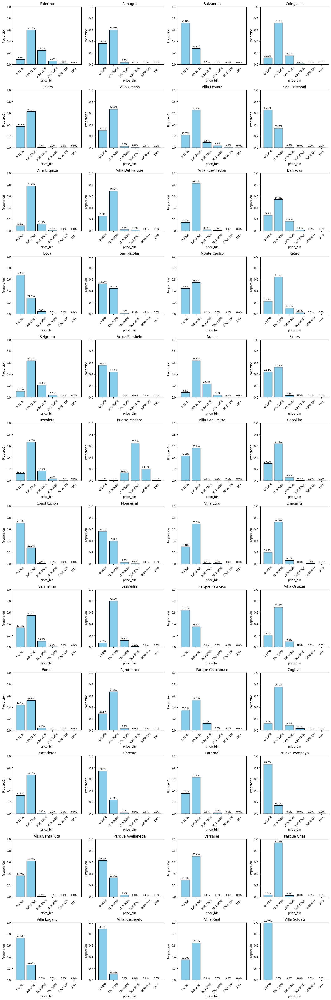

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.3) pm2

In [ ]:
col_obj = 'pm2'

bins_obj = 'pm2_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


#### a.4) Superficie Total

In [ ]:
col_obj = 'surface_total'

bins_obj = 'surface_total_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

surface_total_bin,0-13m2,13-37m2,37-49m2,49-74m2,74-120m2,120-202m2,202-260m2,287m2+
barrio,,,,,,,,
Agronomia,0.0%,34.3%,54.3%,11.4%,0.0%,0.0%,0.0%,0.0%
Almagro,0.0%,63.6%,29.3%,6.6%,0.4%,0.0%,0.1%,0.0%
Balvanera,0.0%,82.0%,13.2%,4.5%,0.1%,0.1%,0.0%,0.0%
Barracas,0.0%,24.0%,34.4%,25.0%,15.6%,1.0%,0.0%,0.0%
Belgrano,0.0%,40.2%,48.5%,9.9%,1.1%,0.3%,0.0%,0.0%
Boca,0.0%,35.0%,50.3%,6.3%,4.2%,2.8%,1.4%,0.0%
Boedo,0.0%,77.0%,18.4%,4.1%,0.4%,0.0%,0.0%,0.0%
Caballito,0.0%,32.8%,55.8%,9.2%,2.1%,0.2%,0.0%,0.0%
Chacarita,0.0%,64.3%,23.0%,9.8%,2.8%,0.0%,0.0%,0.0%


In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.5) Superficie Cubierta

In [ ]:
col_obj = 'surface_covered'

bins_obj = 'surface_covered_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------
# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

### rooms = 8

#### a.1) Análisis General

In [ ]:
property_type = 'Casa'

rooms = 8

mask = (df_ent['property_type']==property_type) & (df_ent['rooms']==rooms)

columnas = ['price', 'pm2','surface_total', 'surface_covered', 'rooms', 'bedrooms','bathrooms']

df_subset = df_ent.loc[mask, columnas]

percentiles = [
    0.00, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09,
    0.10, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19,
    0.20, 0.25, 0.30, 0.35, 0.40,0.45, 0.50,  0.55, 0.60, 0.65, 0.70, 0.75,
    0.80, 0.85,
    0.90, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99,
    1.00
]


estadisticas = df_subset.describe(percentiles).T

modas = df_subset.mode().iloc[0]
estadisticas['mode'] = modas

valores = [
'count', 'mean', 'std', 'mode', 'max', 'min', '1%', '2%', '3%', '4%', '5%', '6%', '7%', '8%', '9%',
    '10%', '11%', '12%', '13%', '14%', '15%', '16%', '17%', '18%', '19%',
    '20%',  '25%', '30%',  '35%', '40%',  '45%', '50%', '55%', '60%',  '65%',
    '70%', '75%', '80%',  '85%', '90%', '91%', '92%', '93%', '94%', '95%', '96%', '97%', '98%', '99%',
    '100%'
]
estadisticas = estadisticas[valores]

estadisticas_vertical = estadisticas.T

import pandas.io.formats.style
estadisticas_vertical.style.format('{:,.2f}')

#### a.2) Price

In [ ]:
col_obj = 'price'

bins_obj = 'price_bin'

In [ ]:
#Matriz de doble entrada por barrio-------------------------------------------------
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Histograma por barrio------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


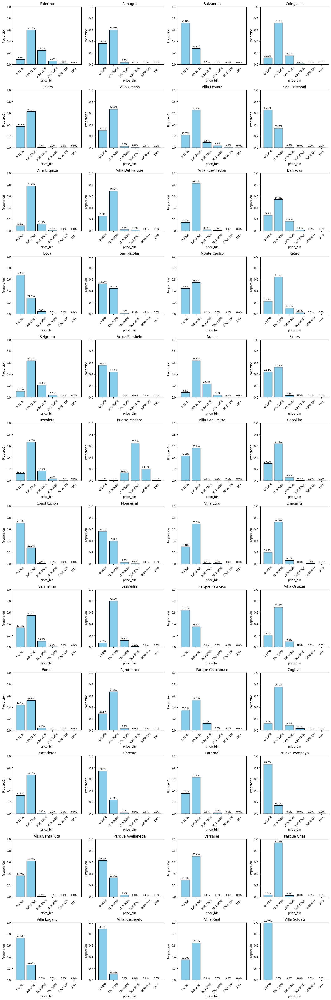

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.3) pm2

In [ ]:
col_obj = 'pm2'

bins_obj = 'pm2_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


#### a.4) Superficie Total

In [ ]:
col_obj = 'surface_total'

bins_obj = 'surface_total_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

surface_total_bin,0-13m2,13-37m2,37-49m2,49-74m2,74-120m2,120-202m2,202-260m2,287m2+
barrio,,,,,,,,
Agronomia,0.0%,34.3%,54.3%,11.4%,0.0%,0.0%,0.0%,0.0%
Almagro,0.0%,63.6%,29.3%,6.6%,0.4%,0.0%,0.1%,0.0%
Balvanera,0.0%,82.0%,13.2%,4.5%,0.1%,0.1%,0.0%,0.0%
Barracas,0.0%,24.0%,34.4%,25.0%,15.6%,1.0%,0.0%,0.0%
Belgrano,0.0%,40.2%,48.5%,9.9%,1.1%,0.3%,0.0%,0.0%
Boca,0.0%,35.0%,50.3%,6.3%,4.2%,2.8%,1.4%,0.0%
Boedo,0.0%,77.0%,18.4%,4.1%,0.4%,0.0%,0.0%,0.0%
Caballito,0.0%,32.8%,55.8%,9.2%,2.1%,0.2%,0.0%,0.0%
Chacarita,0.0%,64.3%,23.0%,9.8%,2.8%,0.0%,0.0%,0.0%


In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.5) Superficie Cubierta

In [ ]:
col_obj = 'surface_covered'

bins_obj = 'surface_covered_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------
# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

## 3. Cocheras

### Estadistica de Cocheras

In [ ]:
df_ent.loc[df_ent['property_type']=='Cochera'].groupby('rooms')[['surface_total','surface_covered','surface_descubierta','bedrooms','bathrooms','price']].median()

### rooms = 0

#### a.1) Análisis General

In [ ]:
property_type = 'Cochera'

rooms = 0

mask = (df_ent['property_type']==property_type) & (df_ent['rooms']==rooms)

columnas = ['price', 'pm2','surface_total', 'surface_covered', 'rooms', 'bedrooms','bathrooms']

df_subset = df_ent.loc[mask, columnas]

percentiles = [
    0.00, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09,
    0.10, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19,
    0.20, 0.25, 0.30, 0.35, 0.40,0.45, 0.50,  0.55, 0.60, 0.65, 0.70, 0.75,
    0.80, 0.85,
    0.90, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99,
    1.00
]


estadisticas = df_subset.describe(percentiles).T

modas = df_subset.mode().iloc[0]
estadisticas['mode'] = modas

valores = [
'count', 'mean', 'std', 'mode', 'max', 'min', '1%', '2%', '3%', '4%', '5%', '6%', '7%', '8%', '9%',
    '10%', '11%', '12%', '13%', '14%', '15%', '16%', '17%', '18%', '19%',
    '20%',  '25%', '30%',  '35%', '40%',  '45%', '50%', '55%', '60%',  '65%',
    '70%', '75%', '80%',  '85%', '90%', '91%', '92%', '93%', '94%', '95%', '96%', '97%', '98%', '99%',
    '100%'
]
estadisticas = estadisticas[valores]

estadisticas_vertical = estadisticas.T

import pandas.io.formats.style
estadisticas_vertical.style.format('{:,.2f}')

,price,pm2,surface_total,surface_covered,rooms,bedrooms,bathrooms
count,"1,956.00","1,956.00","1,956.00","1,956.00","1,956.00","1,956.00","1,956.00"
mean,"23,928.56","1,822.20",13.42,13.23,0.00,0.00,0.00
std,"6,874.94",567.34,2.50,2.57,0.00,0.00,0.00
mode,"25,000.00","2,083.33",12.00,12.00,0.00,0.00,0.00
max,"50,000.00","4,166.67",33.00,33.00,0.00,0.00,0.00
min,"10,000.00",545.45,12.00,1.00,0.00,0.00,0.00
1%,"10,500.00",750.00,12.00,10.00,0.00,0.00,0.00
2%,"12,000.00",806.58,12.00,12.00,0.00,0.00,0.00
3%,"12,500.00",833.33,12.00,12.00,0.00,0.00,0.00
4%,"13,500.00",911.89,12.00,12.00,0.00,0.00,0.00


#### a.2) Price

In [ ]:
col_obj = 'price'

bins_obj = 'price_bins'

In [ ]:
#Matriz de doble entrada por barrio-------------------------------------------------
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Histograma por barrio------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

bins_obj = 'price_bin'

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.3) pm2

In [ ]:
col_obj = 'pm2'

bins_obj ='pm2_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.4) Superficie Total

In [ ]:
col_obj = 'surface_total'

bins_obj = 'surface_total_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

surface_total_bin,0-13m2,13-37m2,37-49m2,49-74m2,74-120m2,120-202m2,202-260m2,287m2+
barrio,,,,,,,,
Agronomia,0.0%,34.3%,54.3%,11.4%,0.0%,0.0%,0.0%,0.0%
Almagro,0.0%,63.6%,29.3%,6.6%,0.4%,0.0%,0.1%,0.0%
Balvanera,0.0%,82.0%,13.2%,4.5%,0.1%,0.1%,0.0%,0.0%
Barracas,0.0%,24.0%,34.4%,25.0%,15.6%,1.0%,0.0%,0.0%
Belgrano,0.0%,40.2%,48.5%,9.9%,1.1%,0.3%,0.0%,0.0%
Boca,0.0%,35.0%,50.3%,6.3%,4.2%,2.8%,1.4%,0.0%
Boedo,0.0%,77.0%,18.4%,4.1%,0.4%,0.0%,0.0%,0.0%
Caballito,0.0%,32.8%,55.8%,9.2%,2.1%,0.2%,0.0%,0.0%
Chacarita,0.0%,64.3%,23.0%,9.8%,2.8%,0.0%,0.0%,0.0%


In [ ]:
#Hitograma por barrio-----------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




#### a.5) Superficie Cubierta

In [ ]:
col_obj = 'surface_covered'

bins_obj = 'surface_covered_bin'

In [ ]:
pd.crosstab(
    df_ent.loc[mask,'barrio'],
    df_ent.loc[mask,bins_obj],
    margins=True,
    normalize='index'
).style.format('{:.1%}')

In [ ]:
#Hitograma por barrio-----------------------------------------------------------
# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Histograma
    ax.hist(datos, bins=30, color='skyblue', edgecolor='black', alpha=0.6)

    # Calcular estadísticas
    media = datos.mean()
    mediana = datos.median()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Dibujar líneas
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(mediana, color='green', linestyle='-', label='Mediana')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_ylabel('Frecuencia')
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Boxplot por barrio--------------------------------------------------------------------

# Categorías únicas (sin NaNs)
categorias = df_ent['barrio'].dropna().unique()
n = len(categorias)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por categoría
for i, categoria in enumerate(categorias):
    datos = df_ent.loc[mask & (df_ent['barrio'] == categoria), col_obj]
    ax = axes[i]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Boxplot
    ax.boxplot(datos, vert=False, patch_artist=True,
               boxprops=dict(facecolor='lightblue', color='black'),
               medianprops=dict(color='green'),
               whiskerprops=dict(color='black'),
               capprops=dict(color='black'),
               flierprops=dict(marker='o', color='red', alpha=0.3))

    # Calcular estadísticas
    media = datos.mean()
    moda = stats.mode(datos, keepdims=True)[0][0]

    # Líneas adicionales
    ax.axvline(media, color='red', linestyle='--', label='Media')
    ax.axvline(moda, color='purple', linestyle=':', label='Moda')

    # Títulos y ejes
    ax.set_title(f'{categoria}')
    ax.set_xlabel(col_obj)
    ax.set_yticks([])  # Ocultar eje Y porque solo hay una categoría
    ax.legend()

# Eliminar subplots vacíos si sobran
for j in range(len(categorias), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
#Histograma por barrios del pd.crosstab----------------------------------------------------------

# Obtener barrios únicos
barrios = df_ent.loc[mask, 'barrio'].dropna().unique()
n = len(barrios)

# Parámetros de grilla
cols = 4
rows = int(np.ceil(n / cols))

# Crear figura y ejes
fig, axes = plt.subplots(rows, cols, figsize=(16, 4 * rows))
axes = axes.flatten()

# Graficar por barrio
for i, barrio in enumerate(barrios):
    ax = axes[i]

    # Filtrar datos
    datos = df_ent.loc[mask & (df_ent['barrio'] == barrio), bins_obj]

    if datos.empty:
        ax.set_visible(False)
        continue

    # Calcular proporciones
    proporciones = datos.value_counts(normalize=True).sort_index()

    # Graficar barras
    barras = ax.bar(proporciones.index.astype(str), proporciones.values, color='skyblue', edgecolor='black')

    # Agregar texto arriba de cada barra
    for bar in barras:
        height = bar.get_height()
        ax.text(
            bar.get_x() + bar.get_width() / 2,
            height + 0.01,
            f'{height:.1%}',
            ha='center',
            va='bottom',
            fontsize=8
        )

    ax.set_title(barrio)
    ax.set_xlabel(bins_obj)
    ax.set_ylabel('Proporción')
    ax.set_ylim(0, 1)
    ax.tick_params(axis='x', rotation=45)
# Eliminar ejes vacíos
for j in range(len(barrios), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

# **Limpieza a_predecir**

In [ ]:
(df_ent.loc[df_ent['property_type_Cochera'] == 1, ['surface_total', 'surface_covered', 'bedrooms', 'bathrooms']]
 .mean()
 .to_frame(name='mean')  # Convert Series to DataFrame
 .T  # Transpose so the means are in a single row
 .style.format('{:,.2f}')
)




,surface_total,surface_covered,bedrooms,bathrooms
mean,29.70,31.17,0.00,0.00


In [ ]:
#property_type = 'Departamento'
tipo=1

mask = (df_ap['property_type_Casa']==tipo)

columnas = ['surface_total', 'surface_covered','rooms', 'bedrooms','bathrooms']

df_subset = df_ap.loc[mask, columnas]

percentiles = [
    0.00, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09,
    0.10, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19,
    0.20, 0.25, 0.30, 0.35, 0.40,0.45, 0.50,  0.55, 0.60, 0.65, 0.70, 0.75,
    0.80, 0.85,
    0.90, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99,
    1.00
]


estadisticas = df_subset.describe(percentiles).T

modas = df_subset.mode().iloc[0]
estadisticas['mode'] = modas

valores = [
'count', 'mean', 'std', 'mode', 'max', 'min', '1%', '2%', '3%', '4%', '5%', '6%', '7%', '8%', '9%',
    '10%', '11%', '12%', '13%', '14%', '15%', '16%', '17%', '18%', '19%',
    '20%',  '25%', '30%',  '35%', '40%',  '45%', '50%', '55%', '60%',  '65%',
    '70%', '75%', '80%',  '85%', '90%', '91%', '92%', '93%', '94%', '95%', '96%', '97%', '98%', '99%',
    '100%'
]
estadisticas = estadisticas[valores]

estadisticas_vertical = estadisticas.T

import pandas.io.formats.style
estadisticas_vertical.style.format('{:,.2f}')

,surface_total,surface_covered,rooms,bedrooms,bathrooms
count,327.00,327.00,327.00,327.00,327.00
mean,274.53,184.56,3.99,2.88,2.24
std,202.54,130.94,1.98,1.81,1.39
mode,286.00,160.00,4.00,3.00,1.00
max,"1,515.00","1,115.00",16.00,12.00,8.00
min,32.00,30.00,1.00,0.00,1.00
1%,40.00,40.00,1.00,0.00,1.00
2%,50.00,45.00,1.00,0.00,1.00
3%,57.34,49.56,1.00,0.00,1.00
4%,65.00,53.04,1.00,0.00,1.00


In [ ]:
property_type_Cochera = 1

columnas = ['surface_total', 'surface_covered','rooms', 'bedrooms','bathrooms']

#mask = (df_ap['property_type']==property_type)

#df_subset = df_ap.loc[mask, columnas]

mask = (df_ent['property_type_Cochera']==property_type_Cochera)

df_subset = df_ent.loc[mask, columnas]



percentiles = [
    0.00, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09,
    0.10, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19,
    0.20, 0.25, 0.30, 0.35, 0.40,0.45, 0.50,  0.55, 0.60, 0.65, 0.70, 0.75,
    0.80, 0.85,
    0.90, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99,
    1.00
]


estadisticas = df_subset.describe(percentiles).T

modas = df_subset.mode().iloc[0]
estadisticas['mode'] = modas

valores = [
'count', 'mean', 'std', 'mode', 'max', 'min', '1%', '2%', '3%', '4%', '5%', '6%', '7%', '8%', '9%',
    '10%', '11%', '12%', '13%', '14%', '15%', '16%', '17%', '18%', '19%',
    '20%',  '25%', '30%',  '35%', '40%',  '45%', '50%', '55%', '60%',  '65%',
    '70%', '75%', '80%',  '85%', '90%', '91%', '92%', '93%', '94%', '95%', '96%', '97%', '98%', '99%',
    '100%'
]
estadisticas = estadisticas[valores]

estadisticas_vertical = estadisticas.T

import pandas.io.formats.style
estadisticas_vertical.style.format('{:,.2f}')

,surface_total,surface_covered,rooms,bedrooms,bathrooms
count,"1,371.00",882.00,"1,371.00","1,371.00","1,371.00"
mean,29.70,31.17,0.00,0.00,0.00
std,146.82,165.55,0.00,0.00,0.00
mode,12.00,12.00,0.00,0.00,0.00
max,"2,200.00","2,200.00",0.00,0.00,0.00
min,2.00,1.00,0.00,0.00,0.00
1%,8.70,6.00,0.00,0.00,0.00
2%,10.00,9.00,0.00,0.00,0.00
3%,10.00,9.00,0.00,0.00,0.00
4%,10.00,10.00,0.00,0.00,0.00


In [ ]:
df_ent[df_ent['rooms']==0].to_csv(f"{DIR}/mi_archivo.csv", index=False)


In [ ]:
df_ap_analisis.groupby('rooms')[['price','surface_total','surface_covered','bedrooms','bathrooms']].mean().style.format('{:,.2f}')


,price,surface_total,surface_covered,bedrooms,bathrooms
rooms,,,,,
0.000000,"24,696.60",15.38,15.34,0.00,0.00
1.000000,"109,749.65",41.21,36.47,0.26,1.03
2.000000,"142,060.71",53.40,47.01,1.05,1.15
3.000000,"225,803.95",84.87,74.56,2.02,1.49
4.000000,"327,640.81",133.45,112.35,2.97,2.14
5.000000,"505,198.19",204.82,171.00,3.74,2.90
6.000000,"666,504.89",300.64,227.53,4.02,3.11
7.000000,"938,935.38",530.47,418.84,5.05,3.79
8.000000,"807,822.17",538.00,355.81,6.54,4.77


In [ ]:
df_ent.groupby('rooms')[['price','surface_total','surface_covered','bedrooms','bathrooms']].mean().style.format('{:,.2f}')

,price,surface_total,surface_covered,bedrooms,bathrooms
rooms,,,,,
0.000000,"23,464.19",14.23,14.20,0.00,0.00
1.000000,"103,953.33",39.22,34.82,0.25,1.01
2.000000,"135,038.57",52.39,45.88,1.00,1.08
3.000000,"207,571.15",83.07,71.67,2.00,1.37
4.000000,"318,651.29",134.00,113.84,2.96,1.93
5.000000,"442,064.22",198.34,167.40,3.75,2.41
6.000000,"545,776.78",242.16,205.38,4.30,2.77
7.000000,"554,949.79",290.62,252.10,5.17,2.87
8.000000,"610,489.44",394.21,291.33,6.42,3.61


In [ ]:
rooms = 1

mask = (df_ap_analisis['rooms']==rooms)

columnas = ['price','price_m2_x_surface_total','price_mean_X_rooms','surface_total', 'surface_covered','rooms', 'bedrooms','bathrooms']

df_subset = df_ap_analisis.loc[mask, columnas]

percentiles = [
    0.00, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09,
    0.10, 0.11, 0.12, 0.13, 0.14, 0.15, 0.16, 0.17, 0.18, 0.19,
    0.20, 0.25, 0.30, 0.35, 0.40,0.45, 0.50,  0.55, 0.60, 0.65, 0.70, 0.75,
    0.80, 0.85,
    0.90, 0.91, 0.92, 0.93, 0.94, 0.95, 0.96, 0.97, 0.98, 0.99,
    1.00
]


estadisticas = df_subset.describe(percentiles).T

modas = df_subset.mode().iloc[0]
estadisticas['mode'] = modas

valores = [
'count', 'mean', 'std', 'mode', 'max', 'min', '1%', '2%', '3%', '4%', '5%', '6%', '7%', '8%', '9%',
    '10%', '11%', '12%', '13%', '14%', '15%', '16%', '17%', '18%', '19%',
    '20%',  '25%', '30%',  '35%', '40%',  '45%', '50%', '55%', '60%',  '65%',
    '70%', '75%', '80%',  '85%', '90%', '91%', '92%', '93%', '94%', '95%', '96%', '97%', '98%', '99%',
    '100%'
]
estadisticas = estadisticas[valores]

estadisticas_vertical = estadisticas.T

import pandas.io.formats.style
estadisticas_vertical.style.format('{:,.2f}')

,price,price_m2_x_surface_total,price_mean_X_rooms,surface_total,surface_covered,rooms,bedrooms,bathrooms
count,"1,809.00","1,809.00","1,806.00","1,809.00","1,809.00","1,809.00","1,809.00","1,809.00"
mean,"109,749.65","112,051.84","103,582.92",41.21,36.47,1.00,0.26,1.03
std,"37,969.74","52,816.26","21,482.03",24.02,15.40,0.00,0.47,0.19
mode,"86,660.63","77,702.69","97,941.94",40.00,34.00,1.00,0.00,1.00
max,"548,670.03","780,885.42","299,360.59",502.00,360.00,1.00,8.00,4.00
min,"44,452.20","35,300.20","64,000.00",14.00,14.00,1.00,0.00,1.00
1%,"59,873.88","47,574.03","67,774.19",19.00,18.00,1.00,0.00,1.00
2%,"63,290.79","51,499.51","67,774.19",22.00,21.00,1.00,0.00,1.00
3%,"64,107.50","54,777.64","67,774.19",23.00,23.00,1.00,0.00,1.00
4%,"67,942.31","57,175.60","67,774.19",25.00,23.00,1.00,0.00,1.00


In [ ]:
df_ap.loc[(df_ap['property_type_Departamento']==1),['title','description']]

,title,description
id,,
287176,marta lynch 500 - .000 - departamento en venta,"departamanto de 3 ambientes tipología rio 2 dormitorios en suite. amplio living comedor, 1 cochera. con una inmejorable vista al río de la plata, frente a la reserva ecológica en puerto madero, “renoir, residencias de altura” nace para darle otra dimensión al concepto de calidad de vida. dos torres de 41 y 49 pisos, inspiradas en la naturaleza.“renoir, residencias de altura”, se encuentra emplazado en una inmejorable ubicación en la ciudad de buenos aires, en puerto madero este, frente al parque mujeres argentinas de diez hectáreas, la reserva ecológica, y al río de la plata, su entorno estratégico lo encuentra en el medio de la zona más segura y pintoresca de la ciudad. las vistas, literalmente. no tienen límite y no lo tendrán jamás.piletas de natación climatizadas in/out doorgym, spa con snack bar y sectores de tratamiento individuales por sexo; sauna, baño turco, baño finlandés, ducha escocesa, hidromasaje, ducha vichy, boxes de masaje.salon de usos múltiples con sector de juegos para niños, cocina y toilettes.jaula de golf.canchas de tenis.playón polideportivo.guardería para niños.servicios de conserjería.hotel de mucamas.laundry.lavadero de mascotas.sala de choferes.no dudes en consultar!!!!"
64597,"excelente 3 ambientes, torre le parc, con cochera","excelente departamento de 3 ambientes, originalmente de 2 ambientes refaccionado a 3.departamento unico en piso intermedio con hermosa vista a la ciudad y al rio.la unidad está conformada por tres ambientes luminosos como se puede observar en las imagenes: palier privado, living comedor, balcón, cocina independiente, lavadero, ingreso de servicio, toilette, dos dormitorios uno en suite con vestidor y baño privado, calefacción individual por piso radiante. el ascensor principal cuenta con clave personalizada para acceder al departamento. seguridad 24 hs.las torres le parc, son una de las mas solicitadas de puerto madero por su prestigiosa seguridad, calidad de construcción y confort de sus amenities, entre ellos:* sum con vistas al jardín del complejo y terrazas propias* sauna* gimnasio* piscina para adultos 3 climatizadas* piscina para niños* solarium con espejo de agua y barra-bar* juegos para niños* laundry* estacionamiento de cortesíael valor publicado incluye la cochera"
332336,departamento 3 ambientes - puerto madero c/cochera,"excelente tres ambientes en el complejo torres mulieris ubicado en el dique 2, en el corazón de puerto madero, uno de los barrios más exclusivo de buenos aires, en altura, y con la major vista de puerto madero, a la ciudad y al río. cuenta con dos torres de 44 pisos habitables, terrazas de uso exclusivo en el piso 44 y exclusivos amenities de la más alta calidad. departamento residencial, de categoría aaa, de 2 dormitorios en suite con vestidor, living, comedor, lavadero, baño de servicio y toilette, refrigeración y calefacción por sistema multisplit, piso radiante en todos los baños de los dormitoritos, entrada de servicio y palieres privados con acceso a dos ascensores principales. cocina completamente equipada con muebles de diseño italianos occhipinti, con balcón. impecable. con balcón. baño de servicio."
13567,"venta retasado !! oficina aa o depto apto prof: - dock tradicional de ladrillos - reciclado - piso alto con vista al dique!! - opcion alquiler: , mas gastos, sin mobiliario, con cochera","oficina aa o depto apto prof:o vivienda, con cochera !! bajos gastos: expensas, abl, luz y agua: aprox. (expensas fluctuantes porque incluye luz) - opcion alquiler: mas gastos sin mueblesrecepción, sala de trabajo, baño de personal 2 despachos, baño de gerencia, cocina, comedor diario, 1 cochera fija, seg. 24 hs, amenities, laundry - planta super soleada - antigüedad: 12 años - orientación: este -superficie total: 87 m2 aprox. - palier compartido con 4 lofts - gran ascensor montacargas - recepción y secretariado 4 x 3 - zona de trabajo 8 x 4 con escritorios - 1 baño de per

# **Textming**

## **1-Title**

In [ ]:
cond = df_ap['property_type']=='Casa'
#cond = df_ap['property_type']=='Cochera'
#cond = df_ap['property_type']=='Departamento'

df = df_ap.loc[cond,['property_type','title']]

df['title'] = df['title'].str.lower()

df.head(10)

In [ ]:
doc = nlp(df.iloc[3].title)
print(doc.text)
for token in doc:
    print(token.text, token.pos_)

In [ ]:
df['title_tok_text'] = df['title'].apply(lambda texto: [token.text for token in nlp(texto)])
df.head()

In [ ]:
doc = nlp(df.iloc[2].title)
print(doc.text)
for token in doc:
    print(token.text, "-->", token.lemma_)

In [ ]:
df['title_tok_lema']= df['title'].apply(lambda texto: [token.lemma_ for token in nlp(texto)])
df[['property_type','title','title_tok_text','title_tok_lema']].head()

In [ ]:
m = {'amb': 'ambiente', 'un': '1', 'dos':'2','tres':'3','cuatro':'4','cinco':'5','seis':'6','siete':'7','ocho':'8','nueve':'9',
     'diez':'10','once':'11','doce':'12','trece':'13','1amb':'1 ambiente','2amb':'2 ambiente','3amb':'3 ambiente','4amb':'4 ambiente'}

df['title_tok_text'] = df['title_tok_text'].apply(lambda texto: [m.get(token, token) for token in texto])
df[['title','title_tok_text']].head(20)

In [ ]:
simbolos_a_remover = {":", ",", ".", "!", "¡", "¿", "?", "--", "-", "", " "}

df['title_tok_text'] = df['title_tok_text'].apply(lambda texto: [token for token in texto if token not in simbolos_a_remover and token.strip() != ''])

df[['title','title_tok_text']].head(20)

In [ ]:
stopwords = nlp.Defaults.stop_words
df['title_tok_text'] = df['title_tok_text'].apply(lambda texto: [token for token in texto if token not in stopwords])
df[['title','title_tok_text','title_tok_text']].head(20)


In [ ]:
df['title_new'] = df['title_tok_text'].str.join(' ')
df[['title','title_tok_text','title_new']].head(20)

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer

vectorizer = CountVectorizer(ngram_range=(2, 3), min_df=0.001, max_df=0.99, strip_accents='ascii', max_features=5000)
vectorized_data = vectorizer.fit_transform(df['title_new'])
vectorized_data.toarray()

vectorizer.get_feature_names_out()

count_df = pd.DataFrame(vectorized_data.toarray(), columns=vectorizer.get_feature_names_out(), index=df_ap.index)
count_df

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer(analyzer='word', ngram_range=(1,3), min_df=0.001, max_df=0.99, strip_accents='ascii', max_features=5000)
vectorized_data = vectorizer.fit_transform(df['title_new'])
vectorizer.get_feature_names_out()

# Convertimos a array y lo mostramos como DataFrame
df_tfidf = pd.DataFrame(vectorized_data.toarray(), columns=vectorizer.get_feature_names_out())

# Opcional: poner los títulos como índice
df_tfidf.index = df['title_new']

df_tfidf.head()

pd.set_option('display.max_rows',2000)
# Calcular la importancia promedio por columna (palabra/ngrama)
importancia_promedio = df_tfidf.mean().sort_values(ascending=False)

# Mostrar las 20 más importantes
importancia_promedio.head(2000)

## **2-Description**

In [ ]:
df_ap = pd.read_csv(f"{DIR}/a_predecir.csv", index_col="id")

#cond = df_ap['property_type']=='Casa'
cond = df_ap['property_type']=='Cochera'
#cond = df_ap['property_type']=='Departamento'

df = df_ap.loc[cond,['property_type','description']]

df['description'] = df['description'].str.lower()

df.head(10)

In [ ]:
doc = nlp(df.iloc[3].description)
print(doc.text)
for token in doc:
    print(token.text, token.pos_)

In [ ]:
df['description_tok_text'] = df['description'].apply(lambda texto: [token.text for token in nlp(texto)])
df.head()

In [ ]:
m = {'amb': 'ambiente', 'un': '1', 'dos':'2','tres':'3','cuatro':'4','cinco':'5','seis':'6','siete':'7','ocho':'8','nueve':'9',
     'diez':'10','once':'11','doce':'12','trece':'13','1amb':'1 ambiente','2amb':'2 ambiente','3amb':'3 ambiente','4amb':'4 ambiente'}

df['description_tok_text'] = df['description_tok_text'].apply(lambda texto: [m.get(token, token) for token in texto])
df[['description','description_tok_text']].head(20)

In [ ]:
simbolos_a_remover = {":", ",", ".", "!", "¡", "¿", "?", "--", "-", "", " "}

df['description_tok_text'] = df['description_tok_text'].apply(lambda texto: [token for token in texto if token not in simbolos_a_remover and token.strip() != ''])

In [ ]:
stopwords = nlp.Defaults.stop_words
df['description_tok_text'] = df['description_tok_text'].apply(lambda texto: [token for token in texto if token not in stopwords])
df[['description','description_tok_text']].head(20)

In [ ]:
df['description_new'] = df['description_tok_text'].str.join(' ')
df[['description','description_tok_text','description_new']].head(20)

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer(analyzer='word', ngram_range=(1,3), min_df=0.005, max_df=0.90, strip_accents='ascii', max_features=2000)
vectorized_data = vectorizer.fit_transform(df['description_new'])
vectorizer.get_feature_names_out()

# Convertimos a array y lo mostramos como DataFrame
df_tfidf = pd.DataFrame(vectorized_data.toarray(), columns=vectorizer.get_feature_names_out())

# Opcional: poner los títulos como índice
df_tfidf.index = df['description_new']

df_tfidf.head()

pd.set_option('display.max_rows',2000)
# Calcular la importancia promedio por columna (palabra/ngrama)
importancia_promedio = df_tfidf.mean().sort_values(ascending=False)

# Mostrar las 20 más importantes
importancia_promedio.head(2000)

# **Regex**

## 1-rooms - imputaciones

In [ ]:
df_ap = pd.read_csv(f"{DIR}/a_predecir.csv", index_col="id")

df_ap.loc[df_ap['property_type']=='Cochera',['rooms','bedrooms','bathrooms']] = 0

df_ap['description'] = df_ap['description'].str.lower()

df_ap['title'] = df_ap['title'].str.lower()

cond = df_ap['property_type']!='Cochera'

df_ap.loc[cond,'title_tok_lema']= df_ap.loc[cond,'title'].apply(lambda texto: [token.lemma_ for token in nlp(texto)])

m = {'amb': 'ambiente', 'un': '1', 'dos':'2','tres':'3','cuatro':'4','cinco':'5','seis':'6','siete':'7','ocho':'8','nueve':'9',
     'diez':'10','once':'11','doce':'12','trece':'13','1amb':'1 ambiente','2amb':'2 ambiente','3amb':'3 ambiente','4amb':'4 ambiente'}

df_ap.loc[cond,'title_tok_lema'] = df_ap.loc[cond,'title_tok_lema'].apply(lambda texto: [m.get(token, token) for token in texto])

simbolos_a_remover = {":", ",", ".", "!", "¡", "¿", "?", "--", "-", "", " "}

df_ap.loc[cond,'title_tok_lema'] = df_ap.loc[cond,'title_tok_lema'].apply(lambda texto: [token for token in texto if token not in simbolos_a_remover and token.strip() != ''])

stopwords = nlp.Defaults.stop_words

df_ap.loc[cond,'title_tok_lema'] = df_ap.loc[cond,'title_tok_lema'].apply(lambda texto: [token for token in texto if token not in stopwords])


df_ap.loc[cond,'title_new'] = df_ap.loc[cond,'title_tok_lema'].str.join(' ')


cantidad_ambientes = range(1,21)

for cantidad_ambiente in cantidad_ambientes:
    df_ap.loc[(cond & df_ap['rooms'].isna() & df_ap["title_new"].str.contains(fr'\b{cantidad_ambiente}\s+ambientes?\b',regex = True,na=False)), "rooms"] = cantidad_ambiente


df_ap.loc[cond,'description_tok_lema']= df_ap.loc[cond,'description'].apply(lambda texto: [token.lemma_ for token in nlp(texto)])


df_ap.loc[cond,'description_tok_lema'] = df_ap.loc[cond,'description_tok_lema'].apply(lambda texto: [m.get(token, token) for token in texto])


df_ap.loc[cond,'description_tok_lema'] = df_ap.loc[cond,'description_tok_lema'].apply(lambda texto: [token for token in texto if token not in simbolos_a_remover and token.strip() != ''])


df_ap.loc[cond,'description_tok_lema'] = df_ap.loc[cond,'description_tok_lema'].apply(lambda texto: [token for token in texto if token not in stopwords])


df_ap.loc[cond,'description_new'] = df_ap.loc[cond,'description_tok_lema'].str.join(' ')

def extraer_ambiente(texto):
    if re.search(r'\b\d(?:[\s,\/\-oyya]+)\d(?:[\s,\/\-oyya]+\d+)?\s+ambientes?\b', texto):
        return None
    elif re.search(r'mono\s*amb(?:i?ante?)?|\b(?:loft)\b', texto):
        return 1

    match = re.search(r'\b([1-9][0-9]?)\s+ambientes?\d?\b', texto)
    return float(match.group(1)) if match else None

df_ap.loc[cond & df_ap['rooms'].isna(), 'rooms'] = df_ap.loc[cond & df_ap['rooms'].isna(), 'description_new'].apply(extraer_ambiente)

df_ap.drop(['description_tok_lema','description_new','title_tok_lema','title_new'])



np.int64(131)

## 2-Flags Departamento

## 3-Flags Casa

## 3-Flags Cochera